In [1]:
import numpy as np
import pandas as pd
pd.get_option("display.max_columns")
pd.set_option('display.max_columns', 1000)
pd.get_option("display.max_rows")
pd.set_option('display.max_rows', 1000)

f=open('aaindex1.dat', 'r')

fragI=0
raw=''
ID=''
ID_array=[]
AAall=[[]]
title=''
title_array=[]


while True:
    data = f.readline()
    data = data.rstrip()
    if data == '':
        break    
    elif data.startswith('I'):
        fragI = 1
    elif data.startswith('H'):
        ID=data[2:]
    elif data.startswith('D'):
        title=data[2:]        
    elif fragI==1 and not data.startswith('//'):
        raw+=data
    elif data.startswith('//'):
        if not 'NA' in raw:
            para = raw.split()
            AAall.append(para)
            ID_array.append(ID)
            title_array.append(title)
            raw=''
            fragI=0
        else:
            raw=''
            fragI=0
            
AAall.remove([])

columns=['A','R','N','D','C','Q','E','G','H','I','L','K','M','F','P','S','T','W','Y','V']

df_index=pd.DataFrame(AAall,index=ID_array,columns=columns)

df_index


,A,R,N,D,C,Q,E,G,H,I,L,K,M,F,P,S,T,W,Y,V
ANDN920101,4.35,4.38,4.75,4.76,4.65,4.37,4.29,3.97,4.63,3.95,4.17,4.36,4.52,4.66,4.44,4.50,4.35,4.70,4.60,3.95
ARGP820101,0.61,0.60,0.06,0.46,1.07,0.,0.47,0.07,0.61,2.22,1.53,1.15,1.18,2.02,1.95,0.05,0.05,2.65,1.88,1.32
ARGP820102,1.18,0.20,0.23,0.05,1.89,0.72,0.11,0.49,0.31,1.45,3.23,0.06,2.67,1.96,0.76,0.97,0.84,0.77,0.39,1.08
ARGP820103,1.56,0.45,0.27,0.14,1.23,0.51,0.23,0.62,0.29,1.67,2.93,0.15,2.96,2.03,0.76,0.81,0.91,1.08,0.68,1.14
BEGF750101,1.,0.52,0.35,0.44,0.06,0.44,0.73,0.35,0.60,0.73,1.,0.60,1.,0.60,0.06,0.35,0.44,0.73,0.44,0.82
BEGF750102,0.77,0.72,0.55,0.65,0.65,0.72,0.55,0.65,0.83,0.98,0.83,0.55,0.98,0.98,0.55,0.55,0.83,0.77,0.83,0.98
BEGF750103,0.37,0.84,0.97,0.97,0.84,0.64,0.53,0.97,0.75,0.37,0.53,0.75,0.64,0.53,0.97,0.84,0.75,0.97,0.84,0.37
BHAR880101,0.357,0.529,0.463,0.511,0.346,0.493,0.497,0.544,0.323,0.462,0.365,0.466,0.295,0.314,0.509,0.507,0.444,0.305,0.420,0.386
BIGC670101,52.6,109.1,75.7,68.4,68.3,89.7,84.7,36.3,91.9,102.0,102.0,105.1,97.7,113.9,73.6,54.9,71.2,135.4,116.2,85.1
BIOV880101,16.,-70.,-74.,-78.,168.,-73.,-106.,-13.,50.,151.,145.,-141.,124.,189.,-20.,-70.,-38.,145.,53.,123.


In [2]:
pm=open('pgol_98_TMR.fas','r')

fas = [[]]

while True:
    reading = pm.readline()
    reading = reading.rstrip()

    if not reading.startswith('>'):
        if reading == '':
            break
        fas.append(list(reading))

fas.remove([])
columns=list(range(-25,26))
df_pm=pd.DataFrame(fas,columns=columns)

df_pm

,-25,-24,-23,-22,-21,-20,-19,-18,-17,-16,-15,-14,-13,-12,-11,-10,-9,-8,-7,-6,-5,-4,-3,-2,-1,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25
0,F,G,L,L,G,L,Y,H,Y,W,F,K,I,F,R,L,F,E,V,F,I,P,M,G,I,C,P,M,A,I,M,P,L,L,K,D,N,F,T,G,V,L,R,H,W,A,R,P,E,V,L
1,X,X,X,X,X,X,X,X,X,X,X,X,K,L,K,L,K,N,V,F,L,A,Y,F,L,V,S,I,A,G,L,L,Y,A,L,V,Q,L,G,Q,P,C,D,C,L,P,P,L,R,A,A
2,X,X,X,X,X,X,X,A,F,P,C,R,R,S,L,T,A,K,T,L,A,C,L,L,V,G,V,S,F,L,A,L,Q,Q,W,F,L,Q,A,P,R,S,P,R,E,E,R,S,P,Q,E
3,X,X,X,X,X,X,X,K,L,L,R,R,A,W,R,R,R,A,A,L,G,L,G,T,L,A,L,C,G,A,A,L,L,Y,L,A,R,C,A,A,E,P,G,D,P,R,A,M,S,G,R
4,X,X,X,X,X,X,Q,M,S,Y,A,I,R,C,A,F,Y,Q,L,L,L,A,A,L,M,L,V,A,M,L,Q,L,L,Y,L,S,L,L,S,G,L,H,G,Q,E,E,Q,D,Q,Y,F
5,A,R,P,P,L,L,L,R,P,V,K,L,L,R,R,R,F,R,L,L,L,A,L,A,V,V,S,V,G,L,W,T,L,Y,L,E,L,V,A,S,A,Q,V,G,G,N,P,L,N,R,R
6,V,L,A,S,M,T,K,A,T,D,P,R,F,R,P,R,W,R,V,I,L,T,S,F,V,G,A,A,L,L,W,L,L,Y,S,H,H,Q,T,P,V,S,G,R,P,P,I,H,N,A,H
7,I,R,Q,L,L,E,K,N,E,P,Q,R,P,P,P,Q,Y,P,L,L,I,V,V,Y,K,V,L,A,T,L,G,L,I,L,L,T,A,Y,F,V,I,Q,P,F,S,P,L,A,P,E,P
8,G,R,R,W,P,A,S,P,L,G,M,K,V,F,R,R,K,A,L,V,L,C,A,G,Y,A,L,L,L,V,L,T,M,L,N,L,L,D,Y,K,W,H,K,E,P,L,Q,Q,C,N,P
9,X,X,X,X,X,X,X,X,X,X,X,L,L,P,K,K,M,K,L,L,L,F,L,V,S,Q,M,A,I,L,A,L,F,F,H,M,Y,S,H,N,I,S,S,L,S,M,K,A,Q,P,E


In [3]:
ALLave=[[]]
ppm_variance=[[]]

k=0
while k<len(df_index.index):
    l=0
    value=[]
    NAcount=0

    while l<len(df_index.columns):
        if df_index.iat[k,l]=="NA":
            NAcount=1
            value.append('NA')
        else:
            value.append(float(df_index.iat[k,l]))
        l=l+1

    if NAcount==0:
        j=0
        AAnum=[[]]
        while j<len(df_pm.index):
            i=0
            AA=[]
            while i<=50:
                AA.append(df_pm.iat[j,i])
                if AA[i]=="A":
                    AA[i]=value[0]
                elif AA[i]=="R":
                    AA[i]=value[1]
                elif AA[i]=="N":
                    AA[i]=value[2]
                elif AA[i]=="D":
                    AA[i]=value[3]
                elif AA[i]=="C":
                    AA[i]=value[4]
                elif AA[i]=="Q":
                    AA[i]=value[5]
                elif AA[i]=="E":
                    AA[i]=value[6]
                elif AA[i]=="G":
                    AA[i]=value[7]
                elif AA[i]=="H":
                    AA[i]=value[8]
                elif AA[i]=="I":
                    AA[i]=value[9]
                elif AA[i]=="L":
                    AA[i]=value[10]
                elif AA[i]=="K":
                    AA[i]=value[11]
                elif AA[i]=="M":
                    AA[i]=value[12]
                elif AA[i]=="F":
                    AA[i]=value[13]
                elif AA[i]=="P":
                    AA[i]=value[14]
                elif AA[i]=="S":
                    AA[i]=value[15]
                elif AA[i]=="T":
                    AA[i]=value[16]
                elif AA[i]=="W":
                    AA[i]=value[17]
                elif AA[i]=="Y":
                    AA[i]=value[18]
                elif AA[i]=="V":
                    AA[i]=value[19]
                elif AA[i]=="X":
                    AA[i]=np.nan
                i=i+1
            AAnum.append(AA)
            j=j+1
    df_AAnum=pd.DataFrame(AAnum)
    sum=df_AAnum.sum()
    ppm_data_number=df_AAnum.count()
    ave=[]
    j=0
    variance=0
    vari_array=[]
    while j<=48:
        temp=sum[j]+sum[j+1]+sum[j+2]
        temp=temp/(ppm_data_number[j]+ppm_data_number[j+1]+ppm_data_number[j+2])
        ave.append(temp)
        i=0
        variance=0
        while i<len(df_AAnum.index):
            l=0
            while l<3:
                if not np.isnan(df_AAnum.iat[i,j+l]):
                    variance = variance+(df_AAnum.iat[i,j+l]-temp)**2
                l=l+1
            i=i+1
        variance=variance/(ppm_data_number[j]+ppm_data_number[j+1]+ppm_data_number[j+2])
        vari_array.append(variance)
        j=j+1
    ALLave.append(ave)
    ppm_variance.append(vari_array)
    k=k+1
ALLave

[[],
 [4.342191780821918,
  4.347820512820513,
  4.333734939759036,
  4.329999999999999,
  4.33989010989011,
  4.3529,
  4.35690909090909,
  4.332231404958677,
  4.339076923076923,
  4.31830985915493,
  4.337243589743589,
  4.340355029585798,
  4.35938202247191,
  4.368388888888888,
  4.3741111111111115,
  4.384833333333334,
  4.315888888888889,
  4.264944444444444,
  4.216277777777777,
  4.247944444444443,
  4.241888888888888,
  4.239111111111111,
  4.248388888888888,
  4.258555555555556,
  4.2668888888888885,
  4.2615,
  4.257555555555554,
  4.272833333333333,
  4.2622222222222215,
  4.265444444444444,
  4.254888888888888,
  4.325611111111111,
  4.364944444444443,
  4.3965,
  4.363888888888888,
  4.370722222222223,
  4.373944444444444,
  4.377222222222223,
  4.3759999999999994,
  4.374555555555554,
  4.377666666666666,
  4.396777777777778,
  4.377944444444444,
  4.3853333333333335,
  4.366555555555555,
  4.375055555555556,
  4.36,
  4.359333333333334,
  4.354833333333334],
 [0.946438

In [4]:

columns=list(range(-24,25))
ID_array.insert(0,'0')
title_array.insert(0,'0')
pmave=pd.DataFrame(ALLave,index=ID_array,columns=columns)

pmave


,-24,-23,-22,-21,-20,-19,-18,-17,-16,-15,-14,-13,-12,-11,-10,-9,-8,-7,-6,-5,-4,-3,-2,-1,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ANDN920101,4.342192,4.347821,4.333735,4.330000,4.339890,4.352900,4.356909,4.332231,4.339077,4.318310,4.337244,4.340355,4.359382,4.368389,4.374111,4.384833,4.315889,4.264944,4.216278,4.247944,4.241889,4.239111e+00,4.248389,4.258556,4.266889,4.261500,4.257556,4.272833,4.262222,4.265444,4.254889,4.325611,4.364944,4.396500,4.363889,4.370722,4.373944,4.377222,4.376000,4.374556,4.377667,4.396778,4.377944,4.385333,4.366556,4.375056,4.360000,4.359333,4.354833
ARGP820101,0.946438,0.958077,0.915663,0.912235,0.951648,0.929300,0.933545,0.964132,1.026308,1.029225,0.936154,0.982012,0.936573,0.936333,0.892167,0.891833,1.075611,1.229556,1.444333,1.354611,1.257333,1.210778e+00,1.227333,1.252444,1.249056,1.250833,1.208778,1.149111,1.156889,1.255944,1.415222,1.447000,1.259944,1.057389,0.961056,0.963889,0.950500,0.892056,0.944167,0.864722,0.836667,0.687722,0.705667,0.732056,0.859778,0.827333,0.810000,0.752278,0.780278
ARGP820102,1.023151,1.115385,1.248072,1.266941,1.339231,1.254600,1.089364,1.056281,1.151692,1.205211,1.110705,1.099172,0.983258,0.938000,0.801556,0.803500,1.197333,1.637556,2.080333,2.002889,1.941944,1.912167e+00,1.867278,1.831778,1.805667,1.832500,1.759444,1.684778,1.683889,1.920056,1.995722,1.828056,1.470500,1.196722,1.157056,1.132556,1.190833,1.093056,1.018889,0.860000,0.820500,0.745444,0.847778,0.943611,0.976111,0.941333,0.912389,0.915000,0.884056
ARGP820103,1.085890,1.150385,1.306265,1.292000,1.331209,1.254400,1.120273,1.120331,1.176231,1.260352,1.173013,1.172012,1.048034,0.989778,0.868722,0.882167,1.245444,1.630667,2.008778,1.955556,1.905111,1.887278e+00,1.835667,1.808111,1.772889,1.795722,1.741556,1.686389,1.694722,1.877722,1.958556,1.825333,1.511944,1.249278,1.182778,1.168222,1.216778,1.133833,1.067444,0.910833,0.877833,0.806611,0.904222,0.977278,1.015667,0.991222,0.961778,0.969944,0.946444
BEGF750101,0.574658,0.575385,0.660602,0.627059,0.607473,0.582300,0.584455,0.601901,0.595923,0.623662,0.610897,0.624675,0.593820,0.579444,0.560167,0.572833,0.664778,0.732722,0.795444,0.784333,0.778167,7.830556e-01,0.757500,0.757056,0.735944,0.739111,0.731000,0.715222,0.723556,0.753889,0.782556,0.752444,0.682722,0.628167,0.607056,0.598667,0.599444,0.580500,0.582111,0.542500,0.548222,0.526167,0.563667,0.572667,0.568111,0.564556,0.549833,0.556611,0.552278
BEGF750102,0.717123,0.725385,0.747470,0.739059,0.746044,0.736500,0.729909,0.725702,0.726154,0.750070,0.742308,0.756686,0.735787,0.726056,0.710889,0.704944,0.765056,0.810000,0.862833,0.842889,0.831556,8.323333e-01,0.840778,0.845222,0.836278,0.836111,0.834722,0.831611,0.829222,0.832667,0.860222,0.847556,0.814889,0.768722,0.758056,0.758722,0.763778,0.750167,0.744222,0.716611,0.712944,0.704778,0.704278,0.699778,0.687556,0.685556,0.678889,0.696333,0.696333
BEGF750103,0.718904,0.726538,0.666627,0.686235,0.685495,0.702600,0.707545,0.711901,0.716538,0.689930,0.699167,0.688521,0.711573,0.719833,0.739056,0.736222,0.653833,0.589056,0.525500,0.530778,0.542389,5.413333e-01,0.561611,0.547722,0.558944,0.554222,0.560611,0.569278,0.575556,0.569833,0.552944,0.603444,0.653000,0.707389,0.695167,0.700000,0.689778,0.709333,0.712556,0.739389,0.733944,0.742833,0.720389,0.710611,0.709222,0.724944,0.728667,0.730111,0.715611
BHAR880101,0.446425,0.444782,0.427843,0.431953,0.426879,0.435330,0.443055,0.450033,0.440777,0.437085,0.440244,0.439882,0.447410,0.450017,0.454317,0.449100,0.424989,0.406233,0.385028,0.384172,0.389383,3.886778e-01,0.391306,0.388800,0.393133,0.392006,0.394567,0.393378,0.396922,0.388339,0.382800,0.378817,0.395689,0.414006,0.428250,0.430250,0.426867,0.435467,0.436439,0.448633,0.449633,0.457394,0.457711,0.452778,0.456506,0.457222,0.460994,0.459261,0.456233
B

In [5]:
npm=open('ngol_98_TMR.fas','r')

fas = [[]]

while True:
    reading = npm.readline()
    reading = reading.rstrip()

    if not reading.startswith('>'):
        if reading == '':
            break
        fas.append(list(reading))

fas.remove([])
columns=list(range(-25,26))
df_npm=pd.DataFrame(fas,columns=columns)

df_npm

,-25,-24,-23,-22,-21,-20,-19,-18,-17,-16,-15,-14,-13,-12,-11,-10,-9,-8,-7,-6,-5,-4,-3,-2,-1,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25
0,A,G,S,P,G,W,V,R,T,R,W,A,L,L,L,L,F,W,L,G,W,L,G,M,L,A,G,A,V,V,I,I,V,R,A,P,R,C,R,E,L,P,A,Q,K,W,W,H,T,G,A
1,A,G,S,P,G,W,V,R,T,R,W,A,L,L,L,L,F,W,L,G,W,L,G,M,L,A,G,A,V,V,I,I,V,R,A,P,R,C,R,E,L,P,V,Q,R,W,W,H,K,G,A
2,A,G,S,P,G,W,V,R,T,R,W,A,L,L,L,L,F,W,L,G,W,I,G,M,L,A,G,A,V,V,I,I,V,R,A,P,R,C,R,E,L,P,V,Q,R,W,W,H,K,G,A
3,A,G,S,P,G,W,V,R,T,R,W,A,L,L,L,L,F,W,L,G,W,L,G,M,L,A,G,A,V,V,I,I,V,R,A,P,R,C,R,E,L,P,V,Q,R,W,W,H,K,G,A
4,X,X,X,X,X,X,X,X,X,X,X,X,X,R,K,K,Y,F,G,F,L,I,L,G,V,L,L,A,G,Y,I,Y,V,P,L,P,D,N,V,E,E,P,W,K,I,M,L,L,N,T,F
5,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,G,K,T,I,S,L,L,I,S,V,V,L,V,A,Y,Y,L,Y,I,P,L,P,D,A,I,E,E,P,W,K,V,V,W,E,T
6,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,G,R,T,I,F,L,L,I,S,V,V,L,V,A,Y,Y,I,Y,I,P,L,P,D,D,I,E,E,P,W,K,I,I,L,G,N
7,X,N,A,M,M,E,T,S,E,L,P,A,V,F,D,G,V,K,L,A,A,V,A,A,V,L,Y,V,I,V,R,C,L,N,L,K,S,P,T,A,P,P,D,L,Y,F,Q,D,S,G,L
8,L,I,P,L,G,P,T,V,V,Q,T,S,M,S,R,S,Q,V,A,L,L,G,L,S,L,L,L,M,L,L,L,Y,V,G,L,P,G,P,P,E,Q,T,S,C,L,W,G,D,P,N,V
9,X,X,X,X,X,X,X,X,V,Q,K,F,M,S,R,Y,Q,A,A,L,L,G,L,G,L,L,L,V,F,L,L,Y,M,G,L,P,G,P,P,E,Q,T,S,R,L,W,R,G,P,N,V


In [6]:
ALLave=[[]]
npm_variance=[[]]

k=0
while k<len(df_index.index):
    l=0
    value=[]
    NAcount=0
    
    while l<len(df_index.columns):
        if df_index.iat[k,l]=="NA":
            NAcount=1
            value.append('NA')
        else:
            value.append(float(df_index.iat[k,l]))
        l=l+1

    if NAcount==0:
        j=0
        AAnum=[[]]
        while j<len(df_npm.index):
            i=0
            AA=[]
            while i<=50:
                AA.append(df_npm.iat[j,i])
                if AA[i]=="A":
                    AA[i]=value[0]
                elif AA[i]=="R":
                    AA[i]=value[1]
                elif AA[i]=="N":
                    AA[i]=value[2]
                elif AA[i]=="D":
                    AA[i]=value[3]
                elif AA[i]=="C":
                    AA[i]=value[4]
                elif AA[i]=="Q":
                    AA[i]=value[5]
                elif AA[i]=="E":
                    AA[i]=value[6]
                elif AA[i]=="G":
                    AA[i]=value[7]
                elif AA[i]=="H":
                    AA[i]=value[8]
                elif AA[i]=="I":
                    AA[i]=value[9]
                elif AA[i]=="L":
                    AA[i]=value[10]
                elif AA[i]=="K":
                    AA[i]=value[11]
                elif AA[i]=="M":
                    AA[i]=value[12]
                elif AA[i]=="F":
                    AA[i]=value[13]
                elif AA[i]=="P":
                    AA[i]=value[14]
                elif AA[i]=="S":
                    AA[i]=value[15]
                elif AA[i]=="T":
                    AA[i]=value[16]
                elif AA[i]=="W":
                    AA[i]=value[17]
                elif AA[i]=="Y":
                    AA[i]=value[18]
                elif AA[i]=="V":
                    AA[i]=value[19]
                elif AA[i]=="X":
                    AA[i]=np.nan
                i=i+1
            AAnum.append(AA)
            j=j+1
    df_AAnum=pd.DataFrame(AAnum)
    sum=df_AAnum.sum()
    npm_data_number=df_AAnum.count()
    ave=[]
    j=0
    variance=0
    vari_array=[]
    while j<=48:
        temp=sum[j]+sum[j+1]+sum[j+2]
        temp=temp/(npm_data_number[j]+npm_data_number[j+1]+npm_data_number[j+2])
        ave.append(temp)
        i=0
        variance=0
        while i<len(df_AAnum.index):
            l=0
            while l<3:
                if not np.isnan(df_AAnum.iat[i,j+l]):
                    variance = variance+(df_AAnum.iat[i,j+l]-temp)**2
                l=l+1
            i=i+1
        variance=variance/(npm_data_number[j]+npm_data_number[j+1]+npm_data_number[j+2])
        vari_array.append(variance)
        j=j+1
    ALLave.append(ave)
    npm_variance.append(vari_array)
    k=k+1
ALLave

[[],
 [4.367321428571429,
  4.365558166862515,
  4.365046403712297,
  4.3561079219288175,
  4.333665158371041,
  4.32635761589404,
  4.333071965628357,
  4.348193277310924,
  4.345797101449275,
  4.35203873598369,
  4.3632429718875505,
  4.373800592300099,
  4.364397299903568,
  4.356123595505618,
  4.352855839416059,
  4.362282120395328,
  4.320625000000001,
  4.272112299465241,
  4.2312466607301875,
  4.236040925266904,
  4.23768,
  4.220862222222223,
  4.215271111111111,
  4.224053333333335,
  4.26048,
  4.2545777777777785,
  4.241848888888889,
  4.219404444444445,
  4.239404444444444,
  4.240337777777778,
  4.2149600000000005,
  4.247777777777777,
  4.285262222222222,
  4.351333333333334,
  4.320338078291815,
  4.335178253119429,
  4.323642857142857,
  4.348953488372093,
  4.353366159355416,
  4.368473967684021,
  4.3685701438848925,
  4.360918918918919,
  4.353068592057762,
  4.360815217391305,
  4.377050228310503,
  4.378288868445262,
  4.371720629047179,
  4.3667469879518075,
  

In [7]:

columns=list(range(-24,25))
npmave=pd.DataFrame(ALLave,index=ID_array,columns=columns)

npmave


,-24,-23,-22,-21,-20,-19,-18,-17,-16,-15,-14,-13,-12,-11,-10,-9,-8,-7,-6,-5,-4,-3,-2,-1,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ANDN920101,4.367321,4.365558,4.365046,4.356108,4.333665,4.326358,4.333072,4.348193,4.345797,4.352039,4.363243,4.373801,4.364397,4.356124,4.352856,4.362282,4.320625,4.272112,4.231247,4.236041,4.237680,4.220862,4.215271,4.224053,4.260480,4.254578,4.241849,4.219404,4.239404,4.240338,4.214960,4.247778,4.285262,4.351333,4.320338,4.335178,4.323643,4.348953,4.353366,4.368474,4.368570,4.360919,4.353069,4.360815,4.377050,4.378289,4.371721,4.366747,4.361503
ARGP820101,0.794512,0.771398,0.739548,0.816808,0.875600,0.932826,0.907143,0.855756,0.879783,0.906748,1.000472,1.000928,0.989981,0.944176,1.009562,0.978176,1.095446,1.161087,1.319528,1.285258,1.234613,1.225004,1.206924,1.222560,1.215644,1.256684,1.265591,1.214418,1.177458,1.220862,1.336400,1.219813,1.116196,0.959813,1.075187,1.097148,1.149232,1.122522,1.040770,0.965745,0.894038,0.898477,0.894675,0.883714,0.907151,0.869816,0.901526,0.853596,0.855213
ARGP820102,0.864119,0.802503,0.815638,0.890344,0.940939,0.946071,0.899066,0.877794,0.946046,0.967931,1.018594,1.054886,1.117946,1.129448,1.187126,1.098086,1.347107,1.579626,1.905850,1.916690,1.851573,1.915422,1.855040,1.862356,1.794364,1.858942,1.846356,1.774098,1.660338,1.670613,1.756400,1.531911,1.394578,1.194240,1.371130,1.241310,1.272143,1.159240,1.141540,1.015889,0.952104,0.948532,0.941561,0.959447,0.950073,0.933027,0.944329,0.929601,0.922245
ARGP820103,0.927226,0.869589,0.877599,0.940321,0.987127,0.984901,0.941321,0.938834,1.010331,1.037299,1.065853,1.084778,1.150887,1.163034,1.228431,1.149982,1.373804,1.579929,1.873019,1.892811,1.841076,1.901804,1.841627,1.841316,1.772507,1.842862,1.840213,1.779991,1.679164,1.696240,1.781680,1.574284,1.434791,1.235618,1.387180,1.265570,1.291786,1.190438,1.159526,1.042397,0.982077,0.984045,0.996643,1.005308,1.003151,0.963717,0.971406,0.951418,0.959453
BEGF750101,0.574738,0.560376,0.564060,0.559472,0.567172,0.559404,0.551740,0.562290,0.566128,0.551794,0.543715,0.536338,0.577985,0.585047,0.619361,0.586550,0.631384,0.689768,0.763722,0.784021,0.777049,0.803227,0.775591,0.764596,0.737858,0.773431,0.780604,0.765849,0.738009,0.735609,0.770124,0.709813,0.674782,0.602053,0.640302,0.597415,0.602500,0.592880,0.595891,0.579013,0.568858,0.570324,0.594314,0.578768,0.576155,0.550285,0.550833,0.549981,0.555148
BEGF750102,0.707083,0.694794,0.695081,0.697738,0.708111,0.712274,0.706380,0.710882,0.719803,0.726952,0.724900,0.722577,0.731996,0.735665,0.747272,0.734061,0.769188,0.802380,0.847257,0.837740,0.829707,0.832827,0.834987,0.837484,0.831422,0.838062,0.835858,0.836089,0.832853,0.843040,0.860862,0.830604,0.805831,0.760916,0.780899,0.771007,0.775018,0.753882,0.744691,0.731436,0.723489,0.718775,0.724693,0.721712,0.716502,0.705639,0.710638,0.709852,0.715603
BEGF750103,0.709786,0.705358,0.705244,0.711160,0.704502,0.712163,0.716874,0.719580,0.721149,0.732559,0.741888,0.742379,0.719788,0.708886,0.693686,0.723890,0.672652,0.612228,0.540151,0.544875,0.555929,0.540258,0.553636,0.552276,0.569458,0.545396,0.542489,0.543733,0.552471,0.556756,0.527627,0.597022,0.628613,0.694436,0.652705,0.674002,0.672071,0.687880,0.687252,0.694408,0.695890,0.694730,0.689106,0.706866,0.711297,0.721058,0.711915,0.715681,0.712913
BHAR880101,0.451110,0.453828,0.454416,0.452977,0.452664,0.451639,0.451715,0.448050,0.445576,0.446486,0.444036,0.444261,0.436990,0.436898,0.426976,0.432901,0.418278,0.406750,0.388168,0.388798,0.393107,0.392720,0.396469,0.396364,0.393528,0.390149,0.392745,0.399130,0.399628,0.398505,0.395217,0.409457,0.414761,0.426098,0.419165,0.423577,0.424935,0.429565,0.434532,0.439233,0.442391,0.443316,0.443273,0.446462,0.446379,0.449852,0.450275,0.452481,0.451768
BIGC670101,81.092262,78.964982,78

In [8]:
columns=list(range(-24,25))
df_ppm_variance=pd.DataFrame(ppm_variance,index=ID_array,columns=columns)
df_ppm_variance

,-24,-23,-22,-21,-20,-19,-18,-17,-16,-15,-14,-13,-12,-11,-10,-9,-8,-7,-6,-5,-4,-3,-2,-1,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ANDN920101,0.056908,0.054217,0.045688,0.042889,0.044348,0.043161,0.038994,0.045247,0.047739,0.051099,0.047567,0.048460,0.041423,0.033774,0.033811,0.034014,0.051553,0.056351,0.058816,0.056815,0.052188,0.051306,0.061602,0.066458,0.066125,0.063928,0.064000,0.067920,0.066590,0.060721,0.063766,0.068814,0.070695,0.061886,0.063207,0.062223,0.057359,0.061650,0.056743,0.059546,0.051985,0.053062,0.050802,0.046834,0.040977,0.043172,0.045513,0.055662,0.053168
ARGP820101,0.495311,0.574333,0.524364,0.519121,0.463926,0.486757,0.478287,0.568277,0.520888,0.519816,0.442595,0.476829,0.466670,0.459533,0.474130,0.491933,0.489765,0.433656,0.303149,0.363277,0.416606,0.422583,0.460746,0.457221,0.498220,0.492173,0.516970,0.515386,0.539844,0.452774,0.369517,0.452337,0.644072,0.708412,0.574453,0.573309,0.551610,0.595013,0.652858,0.655773,0.584798,0.453969,0.468855,0.487550,0.545930,0.489507,0.498870,0.481822,0.526782
ARGP820102,0.953624,1.056092,1.104319,1.135558,1.194642,1.129051,1.086986,1.053990,1.189360,1.111439,1.070973,1.107061,1.016813,1.020929,0.778899,0.788284,1.144940,1.302495,1.033713,0.997037,1.036095,1.032061,1.064909,0.990572,0.967011,0.935035,0.927157,0.883265,0.945174,1.070781,1.082858,1.219791,1.150234,1.093182,1.079280,1.020992,0.990129,0.932427,0.857362,0.641529,0.608105,0.484641,0.727820,0.873479,0.932132,0.925828,0.834596,0.823331,0.660067
ARGP820103,0.792394,0.837878,0.918098,0.918889,0.974817,0.907739,0.841697,0.805324,0.916465,0.875210,0.887826,0.910356,0.854687,0.832737,0.656238,0.663730,0.902139,0.957312,0.718653,0.679869,0.709687,0.704522,0.772665,0.724413,0.720729,0.686662,0.686782,0.660005,0.713908,0.779731,0.785006,0.881886,0.915970,0.890670,0.888973,0.862441,0.847430,0.797417,0.703000,0.515787,0.485115,0.407809,0.604684,0.727650,0.770926,0.785074,0.704726,0.705618,0.568203
BEGF750101,0.089362,0.086858,0.082290,0.093948,0.102447,0.100508,0.086777,0.083133,0.092215,0.090260,0.081252,0.066746,0.060573,0.059611,0.051613,0.058973,0.068637,0.074921,0.065665,0.079470,0.082538,0.078516,0.070819,0.067530,0.075314,0.079779,0.080649,0.084238,0.078860,0.079277,0.061820,0.065166,0.068763,0.067417,0.072021,0.069449,0.077075,0.066645,0.063186,0.059707,0.065488,0.059213,0.064994,0.071465,0.088786,0.087714,0.092506,0.078042,0.082991
BEGF750102,0.023174,0.020835,0.021330,0.019074,0.020740,0.019435,0.018581,0.017431,0.019131,0.019865,0.021899,0.022169,0.023261,0.021439,0.021016,0.019266,0.023255,0.019878,0.012239,0.013467,0.013980,0.014075,0.016217,0.017415,0.019210,0.018499,0.018098,0.017896,0.018636,0.016917,0.014437,0.012242,0.017694,0.018126,0.021870,0.022823,0.022554,0.022383,0.021470,0.020339,0.018409,0.017263,0.018598,0.019908,0.019942,0.018874,0.017552,0.019360,0.019828
BEGF750103,0.049618,0.044384,0.044926,0.041875,0.038370,0.039435,0.038871,0.045953,0.042463,0.047727,0.041933,0.039338,0.033330,0.029498,0.028411,0.032454,0.042786,0.039367,0.024509,0.028384,0.032466,0.033119,0.034516,0.033096,0.035096,0.034623,0.037590,0.041160,0.042775,0.035242,0.028979,0.036620,0.042901,0.040623,0.040863,0.040299,0.040324,0.041341,0.040831,0.041454,0.041561,0.040925,0.042944,0.040901,0.044473,0.043679,0.047168,0.046094,0.050559
BHAR880101,0.006068,0.006211,0.006073,0.006244,0.006215,0.006337,0.005832,0.005891,0.006473,0.006589,0.006728,0.006567,0.006066,0.005382,0.005315,0.005612,0.005463,0.004408,0.002742,0.003004,0.003401,0.003559,0.004233,0.004051,0.004091,0.003808,0.004101,0.004698,0.005231,0.004422,0.003591,0.003812,0.005458,0.006287,0.005476,0.005713,0.005765,0.006537,0.006481,0.006156,0.005688,0.005668,0.005657,0.006275,0.005649,0.006150,0.005654,0.006379,0.005961
BIGC670101,644.405198,655.523328,

In [9]:
columns=list(range(-24,25))
df_npm_variance=pd.DataFrame(npm_variance,index=ID_array,columns=columns)
df_npm_variance

,-24,-23,-22,-21,-20,-19,-18,-17,-16,-15,-14,-13,-12,-11,-10,-9,-8,-7,-6,-5,-4,-3,-2,-1,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ANDN920101,0.046222,0.045604,0.045798,0.046172,0.047617,0.051002,0.048811,0.047770,0.048663,0.057492,0.059297,0.056618,0.053674,0.054618,0.055161,0.054683,0.062618,0.064463,0.060803,0.055934,0.054909,0.049452,0.053362,0.055790,0.063861,0.058749,0.057575,0.056537,0.062221,0.065101,0.062260,0.068109,0.065140,0.060015,0.062254,0.067245,0.066129,0.060083,0.056480,0.053026,0.053351,0.053067,0.053839,0.055323,0.053706,0.052465,0.053027,0.053019,0.058261
ARGP820101,0.464470,0.491045,0.472468,0.508949,0.518028,0.549101,0.542287,0.522011,0.553450,0.614925,0.689793,0.677539,0.640663,0.644057,0.624773,0.642138,0.562636,0.512579,0.413672,0.415018,0.454520,0.433210,0.483275,0.493442,0.527065,0.477880,0.474313,0.488175,0.521265,0.518931,0.461818,0.581395,0.627017,0.659048,0.614605,0.614668,0.595858,0.597940,0.626696,0.632627,0.591716,0.544150,0.520990,0.575946,0.595448,0.583767,0.550352,0.526652,0.523421
ARGP820102,0.743836,0.543337,0.560607,0.702351,0.790516,0.789735,0.678323,0.622480,0.726630,0.714264,0.815449,0.856088,0.969578,0.914683,1.003159,0.915862,1.060378,1.085328,0.946434,1.051935,1.076415,1.092447,1.066131,1.026994,0.997107,1.009620,1.027306,0.997491,0.900812,0.917421,0.936258,1.064038,1.048320,0.932690,1.050144,0.901797,0.996243,0.989232,1.041953,0.895656,0.771116,0.777262,0.808887,0.842865,0.824056,0.788816,0.798895,0.827641,0.793328
ARGP820103,0.627403,0.484299,0.500986,0.598989,0.651046,0.634875,0.556863,0.526267,0.604021,0.593769,0.662584,0.688020,0.771184,0.729470,0.809481,0.752937,0.843732,0.818088,0.677945,0.734975,0.759795,0.755259,0.754317,0.737366,0.720288,0.712477,0.716451,0.708561,0.665344,0.681985,0.671500,0.805597,0.804663,0.739881,0.815510,0.712058,0.777808,0.771242,0.824608,0.728200,0.642228,0.641860,0.672522,0.698447,0.695072,0.663785,0.669281,0.683962,0.664316
BEGF750101,0.076987,0.077271,0.073914,0.081429,0.084339,0.081830,0.077859,0.073088,0.075957,0.076053,0.077358,0.082630,0.084575,0.080808,0.078222,0.074927,0.088964,0.087648,0.082643,0.076210,0.076561,0.067234,0.070712,0.072898,0.076135,0.068170,0.068452,0.072705,0.079093,0.074388,0.062981,0.070025,0.073054,0.079757,0.082272,0.085780,0.087067,0.085319,0.079678,0.071440,0.068357,0.074745,0.072490,0.073075,0.075205,0.076857,0.079091,0.072992,0.073891
BEGF750102,0.018449,0.019494,0.019588,0.020412,0.021170,0.021904,0.022256,0.021013,0.020893,0.020900,0.021585,0.020863,0.020428,0.020899,0.022328,0.021761,0.022747,0.020764,0.014966,0.014735,0.015636,0.015012,0.015679,0.016291,0.017468,0.016453,0.016145,0.016728,0.017538,0.016881,0.014487,0.017680,0.018896,0.019447,0.021592,0.023596,0.023662,0.023077,0.022234,0.023016,0.023375,0.024162,0.022738,0.022417,0.021894,0.021935,0.023154,0.022622,0.023091
BEGF750103,0.044304,0.046798,0.045080,0.045069,0.046413,0.046192,0.044847,0.043807,0.044141,0.046394,0.043830,0.042886,0.044096,0.045226,0.044338,0.040885,0.046237,0.045796,0.033546,0.034353,0.037872,0.034235,0.037627,0.035772,0.038444,0.033226,0.035404,0.038383,0.041154,0.040285,0.033866,0.046973,0.047309,0.046009,0.046188,0.049396,0.048475,0.046836,0.043590,0.041468,0.042023,0.044272,0.045675,0.044738,0.045739,0.043456,0.044525,0.041381,0.045270
BHAR880101,0.005474,0.005063,0.005415,0.005558,0.005365,0.005331,0.005127,0.005725,0.006127,0.006633,0.006689,0.006517,0.006254,0.006262,0.006296,0.006882,0.006355,0.005385,0.003479,0.003564,0.003976,0.003805,0.004415,0.004305,0.004532,0.003808,0.003938,0.004236,0.004378,0.004559,0.003890,0.005166,0.005386,0.006288,0.005875,0.006020,0.005641,0.005667,0.005391,0.005508,0.005551,0.005528,0.005410,0.005395,0.005574,0.005557,0.005248,0.005218,0.005382
BIGC670101,542.647262,527.604767,

In [10]:
ALLtvalue=[[0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0]]
i=1
while i<len(df_ppm_variance.index):
    j=0
    t_value_array=[]
    while j<49:
        datanum1=ppm_data_number[j]+ppm_data_number[j+1]+ppm_data_number[j+2]
        datanum2=npm_data_number[j]+npm_data_number[j+1]+npm_data_number[j+2]
        
        temp1=df_ppm_variance.iat[i,j]*(datanum1-1)+df_npm_variance.iat[i,j]*(datanum2-1)
        variance=temp1/(datanum1+datanum2-2)
        temp2=variance*(1/datanum1+1/datanum2)
        t_value=abs(pmave.iat[i,j]-npmave.iat[i,j])
        
        if temp2!=0:
            t_value=t_value/np.sqrt(temp2)
            t_value_array.append(t_value)
        else :
            t_value_array.append('null')
            
        j=j+1
    ALLtvalue.append(t_value_array)
    i=i+1

In [11]:
print([len(v) for v in ALLtvalue])

[49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49,

In [12]:
ALLtvalue

[[0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0],
 [0.9492816006401759,
  0.6966566185003595,
  1.2732207459761204,
  1.0725972481130757,
  0.2599465589882887,
  1.1238984770186342,
  1.0816101947933048,
  0.7589376092821454,
  0.32645326798562396,
  1.5777741738044981,
  1.2568392738365535,
  1.7092383006897247,
  0.2713821156621286,
  0.6699932855591076,
  1.1572018963104662,
  1.2331527350280487,
  0.2386181538141019,
  0.3546960317922266,
  0.7578092021585751,
  0.6262512765519382,
  0.22451070645355323,
  1.0196186767730282,
  1.767236306744826,
  1.7961631721348055,
  0.31515087585498597,
  0.35362158543312894,
  0.809227528171506,
  2.761172987975209,
  1.1340350785835178,
  1.2314533737126265,
  1.9900798747009791,
  3.7124639159580375,
  3.866485158504773,
  2.2917458462053015,
  2.17

In [13]:
from scipy.stats import t
t_boader_list=[]
i=0
while i<49:
    df_number=ppm_data_number[i]+ppm_data_number[i+1]+ppm_data_number[i+2]+npm_data_number[i]+npm_data_number[i+1]+npm_data_number[i+2]-2
    t_value=t.ppf(q=0.9999,df=df_number)
    t_boader_list.append(t_value)
    i=i+1

t_boader_list

[3.734208155603133,
 3.7339450076932352,
 3.73369082095133,
 3.733521030629701,
 3.7332368296621303,
 3.7327963021522637,
 3.7323306275619177,
 3.731931585317607,
 3.7316592366905454,
 3.73135382551093,
 3.731041811232112,
 3.730735221910764,
 3.73041553736977,
 3.7301128314718346,
 3.7298683198876867,
 3.7297250543286333,
 3.7296671561729484,
 3.729650728659009,
 3.7296425338906194,
 3.7296343517422934,
 3.7296261821849006,
 3.7296261821849006,
 3.7296261821849006,
 3.7296261821849006,
 3.7296261821849006,
 3.7296261821849006,
 3.7296261821849006,
 3.7296261821849006,
 3.7296261821849006,
 3.7296261821849006,
 3.7296261821849006,
 3.7296261821849006,
 3.7296261821849006,
 3.7296261821849006,
 3.7296343517422934,
 3.729650728659009,
 3.7296671561729484,
 3.7296836345189583,
 3.7296918928277774,
 3.7297167446538624,
 3.7297333769197727,
 3.729750060971807,
 3.729766797052203,
 3.729800426274613,
 3.729876866746029,
 3.7299457293508413,
 3.7299979521295823,
 3.730015470803256,
 3.7300242

In [14]:
i=0
deference_array=[[]]
for index_pm, row_pm in pmave.iterrows():
    for index_npm, row_npm in npmave.iterrows():
        if index_pm==index_npm:
            deference=abs(row_pm-row_npm)
            deference_array.append(deference)
            i=i+1

In [15]:
deference_array

[[],
 -24   NaN
 -23   NaN
 -22   NaN
 -21   NaN
 -20   NaN
 -19   NaN
 -18   NaN
 -17   NaN
 -16   NaN
 -15   NaN
 -14   NaN
 -13   NaN
 -12   NaN
 -11   NaN
 -10   NaN
 -9    NaN
 -8    NaN
 -7    NaN
 -6    NaN
 -5    NaN
 -4    NaN
 -3    NaN
 -2    NaN
 -1    NaN
  0    NaN
  1    NaN
  2    NaN
  3    NaN
  4    NaN
  5    NaN
  6    NaN
  7    NaN
  8    NaN
  9    NaN
  10   NaN
  11   NaN
  12   NaN
  13   NaN
  14   NaN
  15   NaN
  16   NaN
  17   NaN
  18   NaN
  19   NaN
  20   NaN
  21   NaN
  22   NaN
  23   NaN
  24   NaN
 Name: 0, dtype: float64,
 -24    0.025130
 -23    0.017738
 -22    0.031311
 -21    0.026108
 -20    0.006225
 -19    0.026542
 -18    0.023837
 -17    0.015962
 -16    0.006720
 -15    0.033729
 -14    0.025999
 -13    0.033446
 -12    0.005015
 -11    0.012265
 -10    0.021255
 -9     0.022551
 -8     0.004736
 -7     0.007168
 -6     0.014969
 -5     0.011904
 -4     0.004209
 -3     0.018249
 -2     0.033118
 -1     0.034502
  0     0.006409
  1  

ANDN920101
alpha-CH chemical shifts (Andersen et al., 1992)


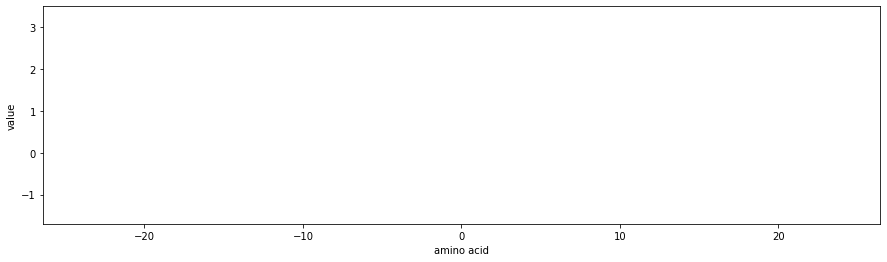

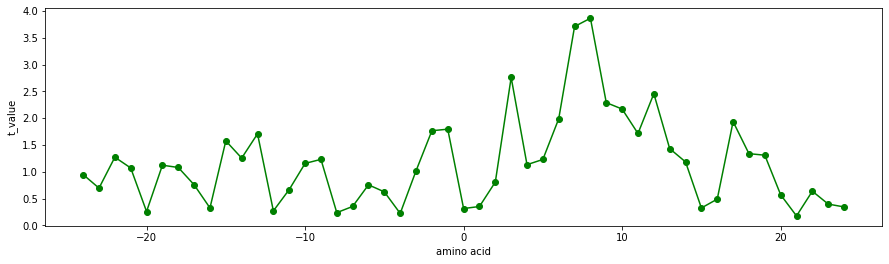

ARGP820101
Hydrophobicity index (Argos et al., 1982)


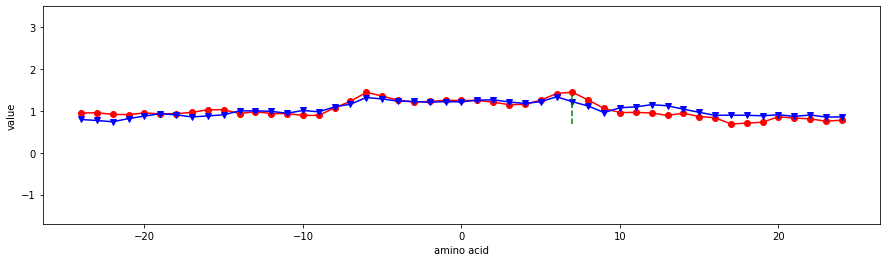

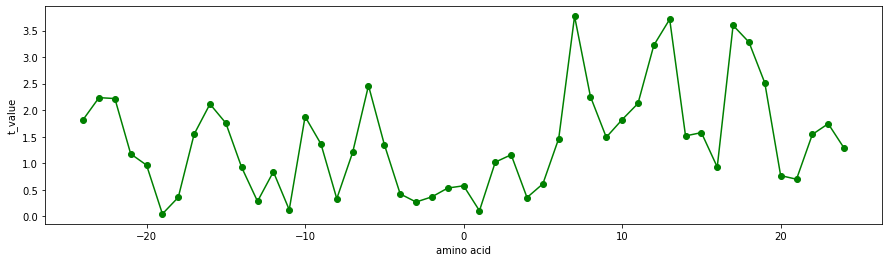

ARGP820102
Signal sequence helical potential (Argos et al., 1982)


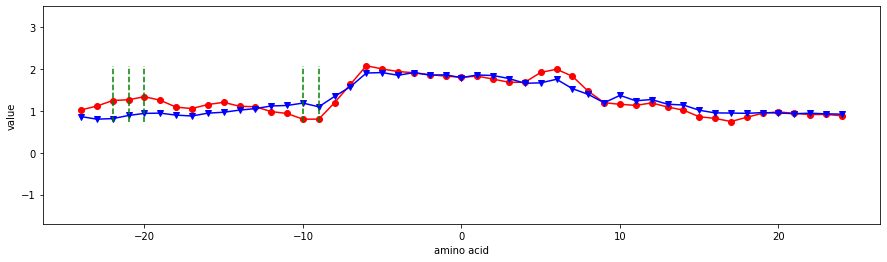

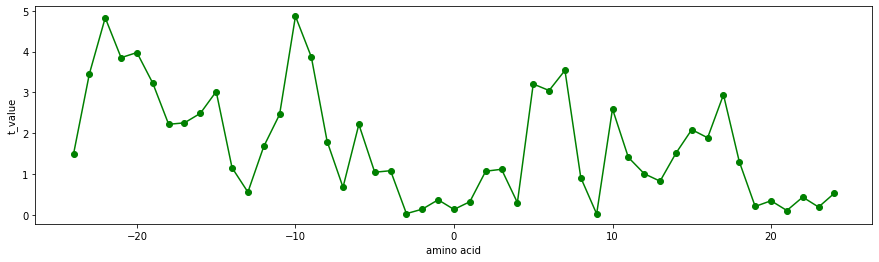

ARGP820103
Membrane-buried preference parameters (Argos et al., 1982)


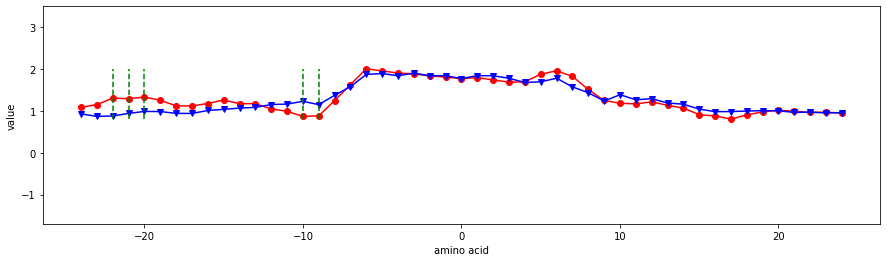

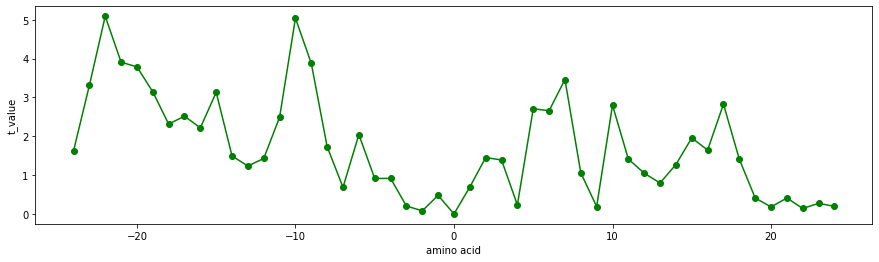

BEGF750101
Conformational parameter of inner helix (Beghin-Dirkx, 1975)


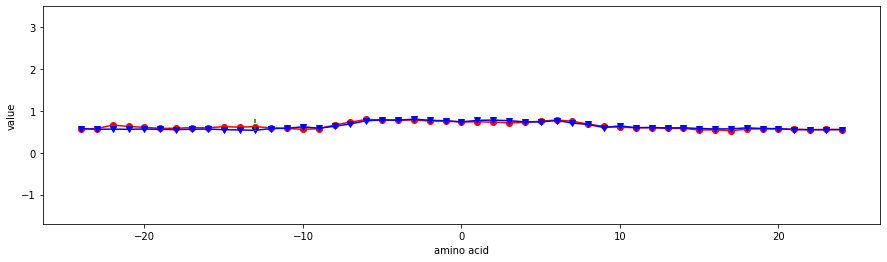

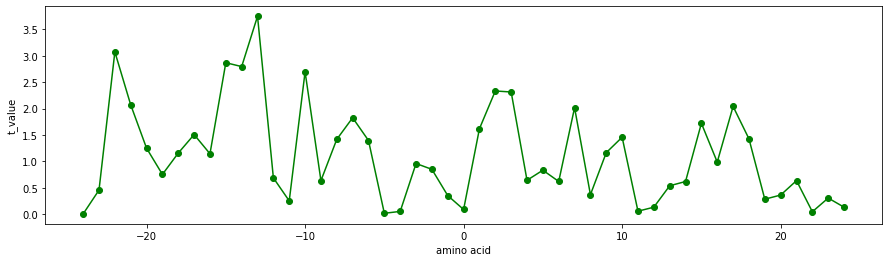

BHAR880101
Average flexibility indices (Bhaskaran-Ponnuswamy, 1988)


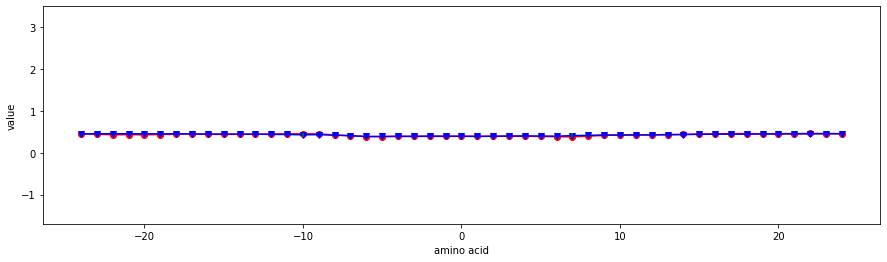

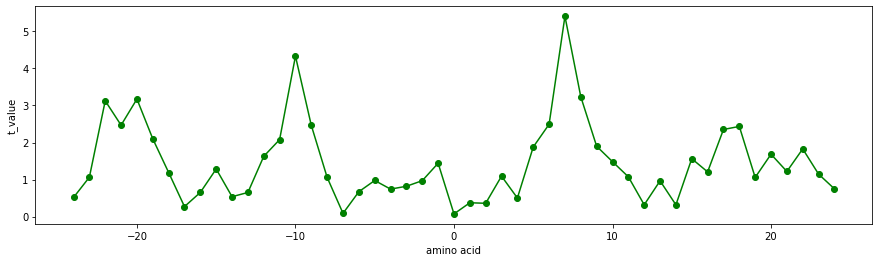

BIGC670101
Residue volume (Bigelow, 1967)


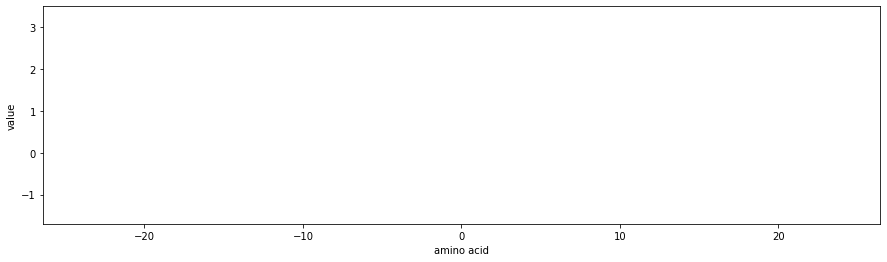

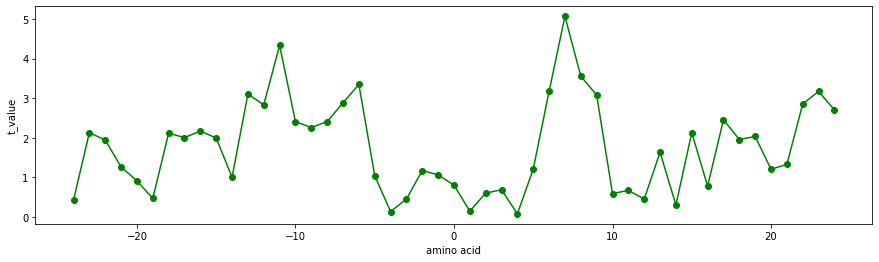

BIOV880101
Information value for accessibility; average fraction 35% (Biou et al., 1988)


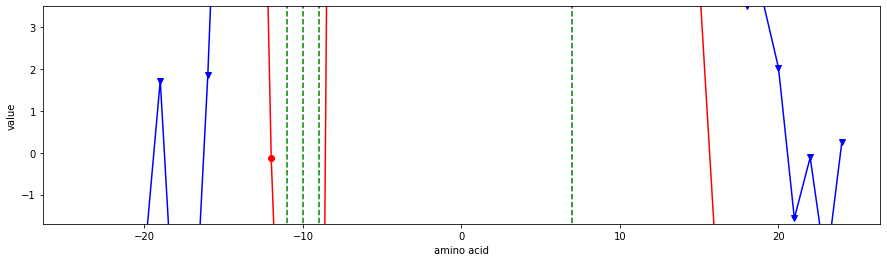

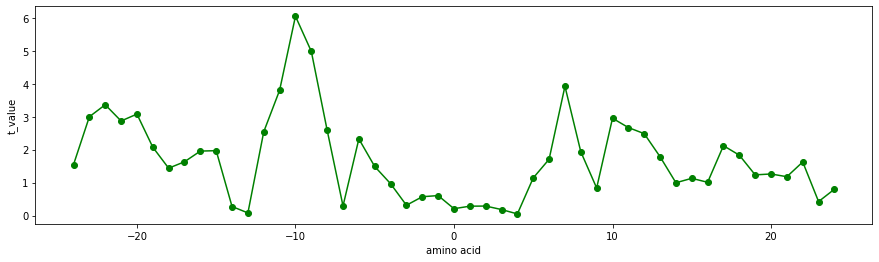

BIOV880102
Information value for accessibility; average fraction 23% (Biou et al., 1988)


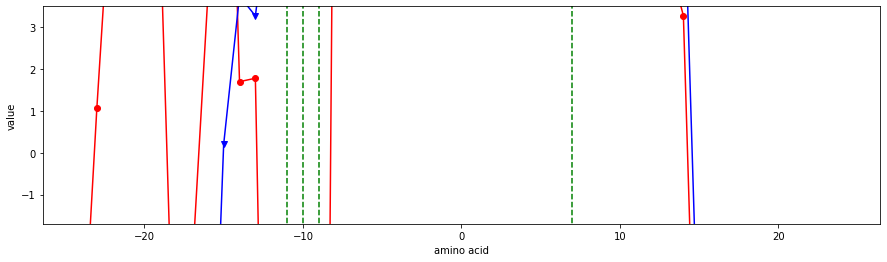

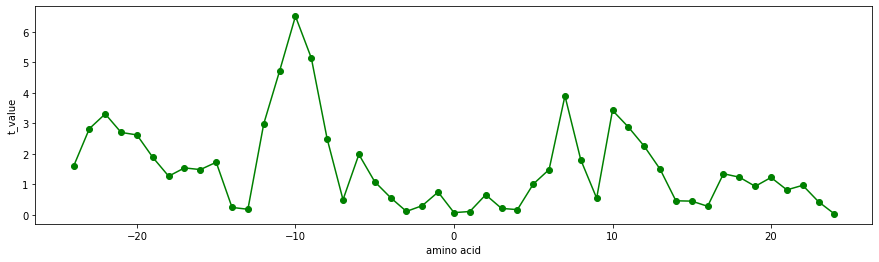

BROC820101
Retention coefficient in TFA (Browne et al., 1982)


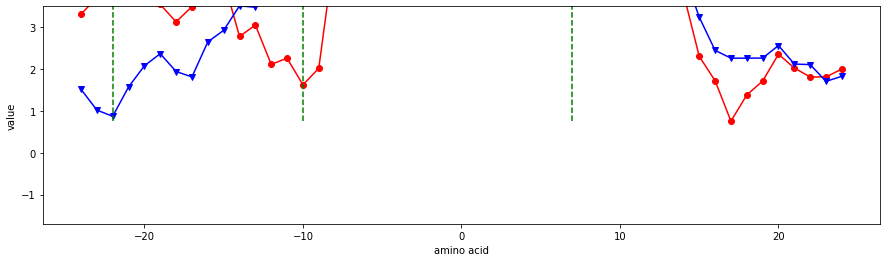

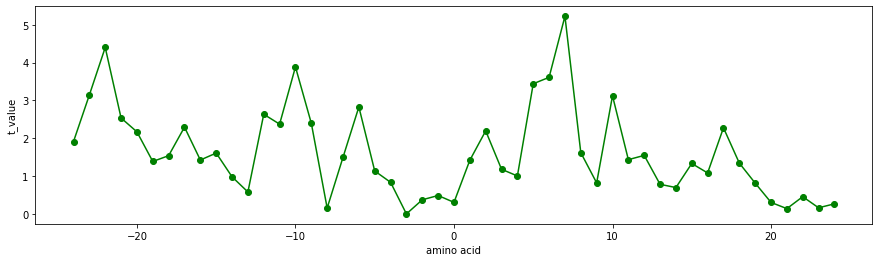

BROC820102
Retention coefficient in HFBA (Browne et al., 1982)


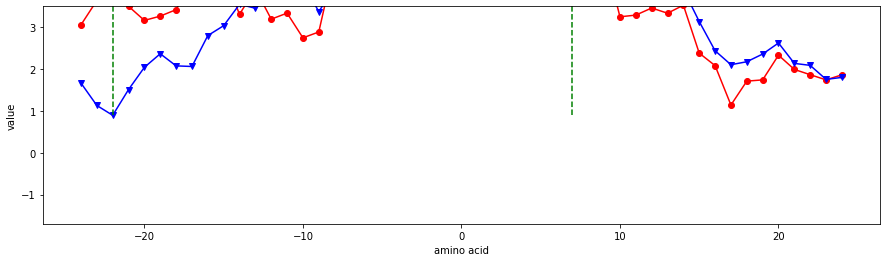

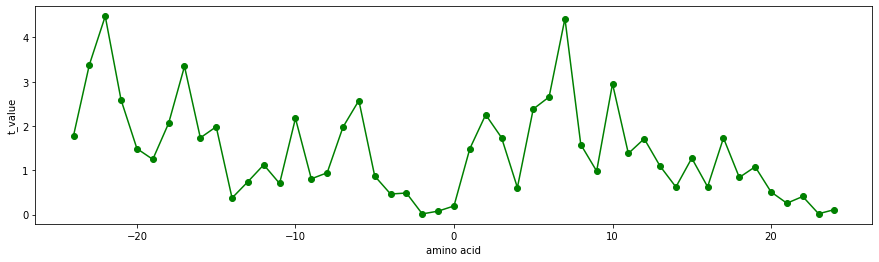

BULH740101
Transfer free energy to surface (Bull-Breese, 1974)


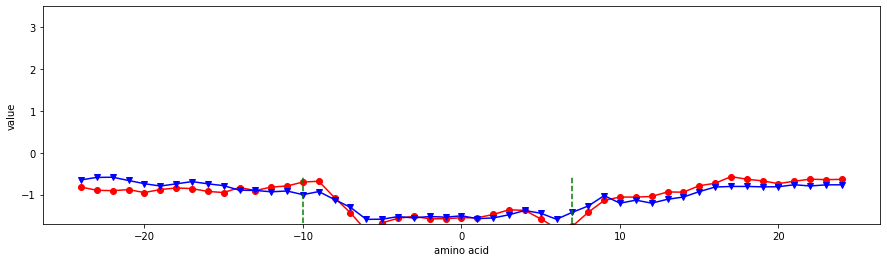

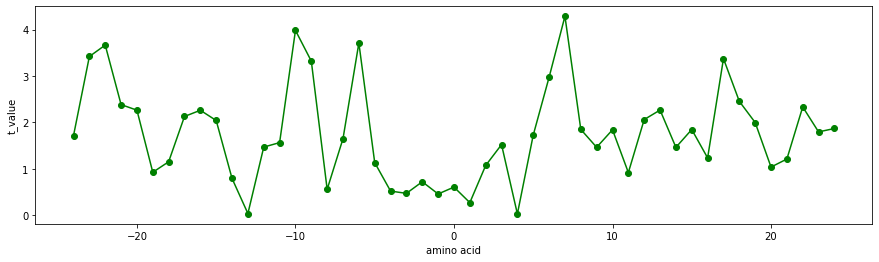

BULH740102
Apparent partial specific volume (Bull-Breese, 1974)


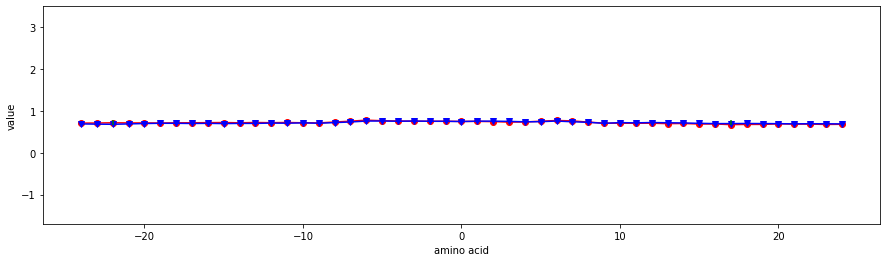

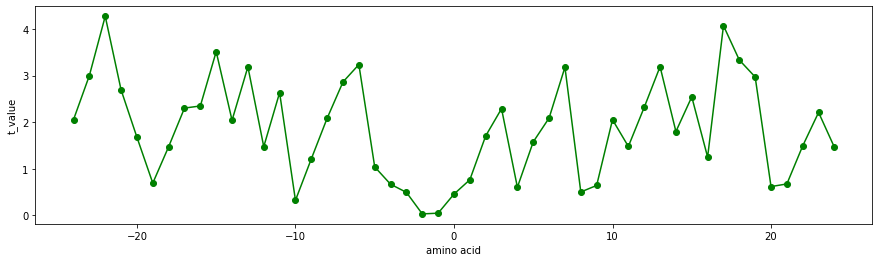

BUNA790102
alpha-CH chemical shifts (Bundi-Wuthrich, 1979)


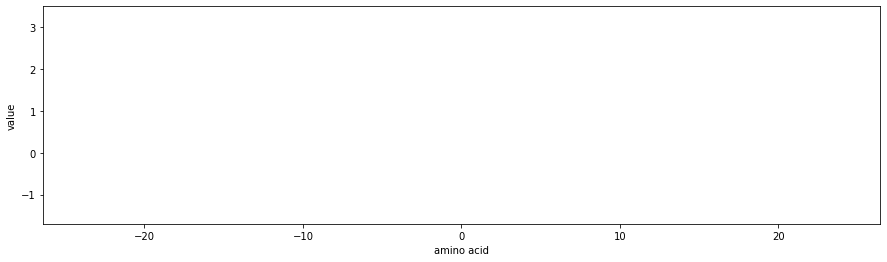

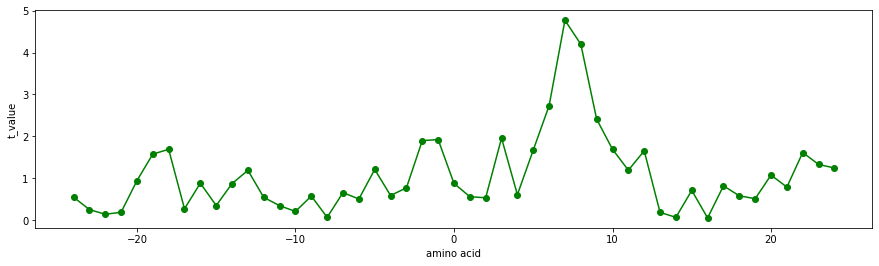

CHAM820101
Polarizability parameter (Charton-Charton, 1982)


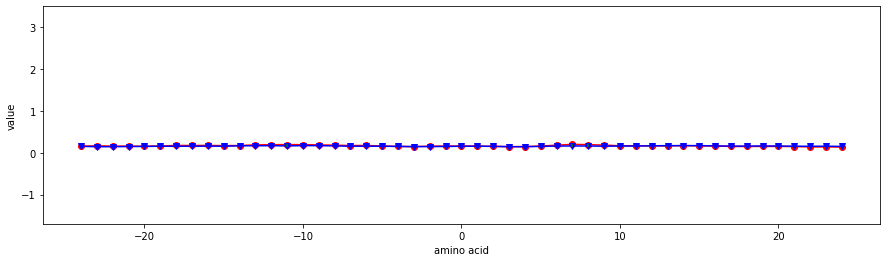

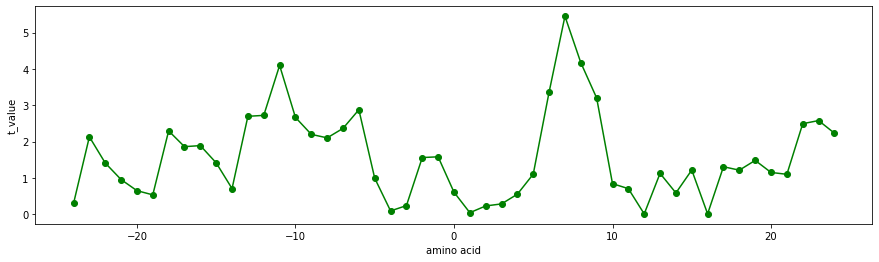

CHAM820102
Free energy of solution in water, kcal/mole (Charton-Charton, 1982)


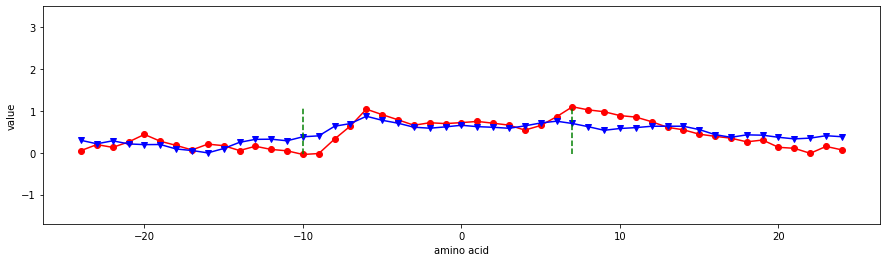

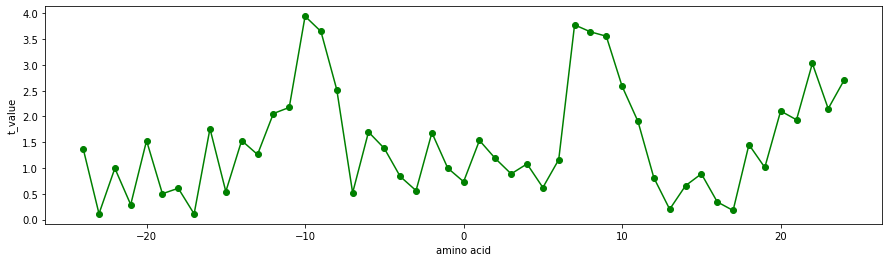

CHAM830103
The number of atoms in the side chain labelled 1+1 (Charton-Charton, 1983)


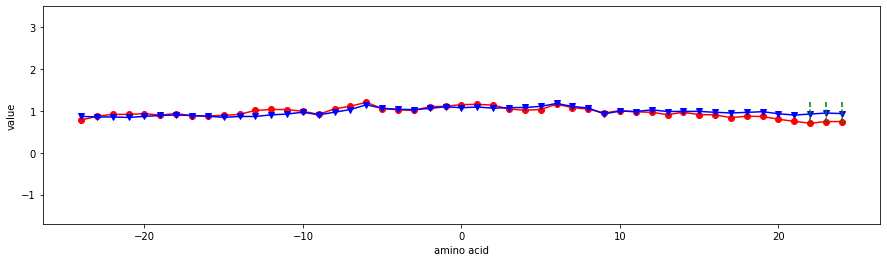

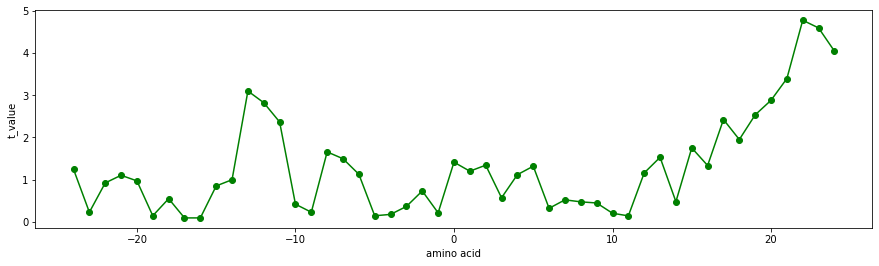

CHAM830104
The number of atoms in the side chain labelled 2+1 (Charton-Charton, 1983)


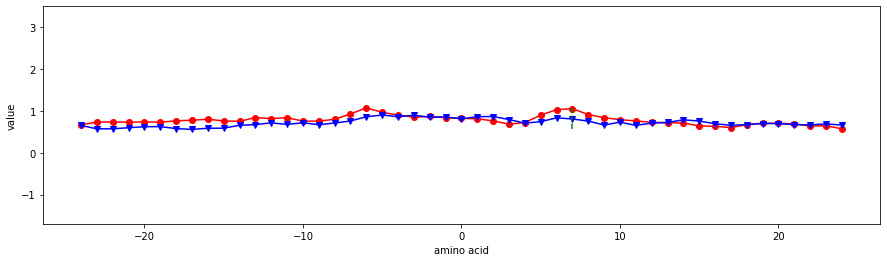

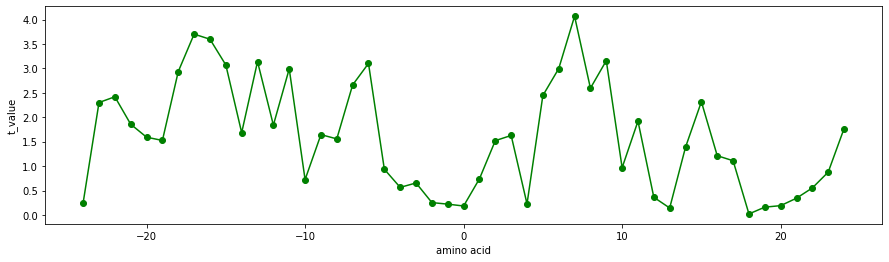

CHAM830105
The number of atoms in the side chain labelled 3+1 (Charton-Charton, 1983)


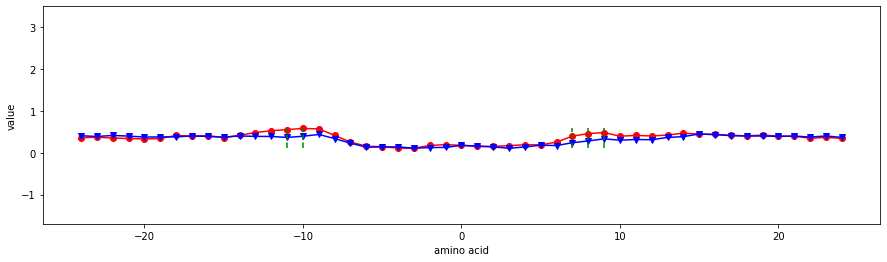

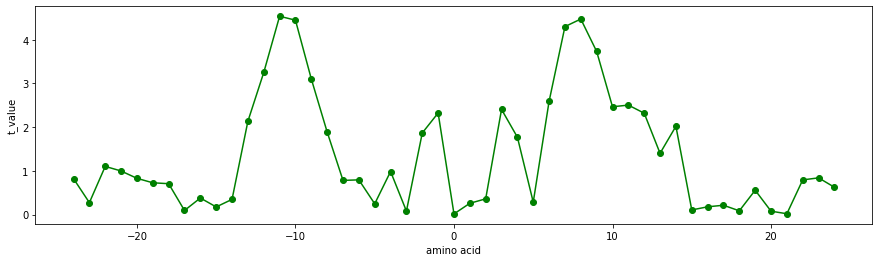

CHAM830106
The number of bonds in the longest chain (Charton-Charton, 1983)


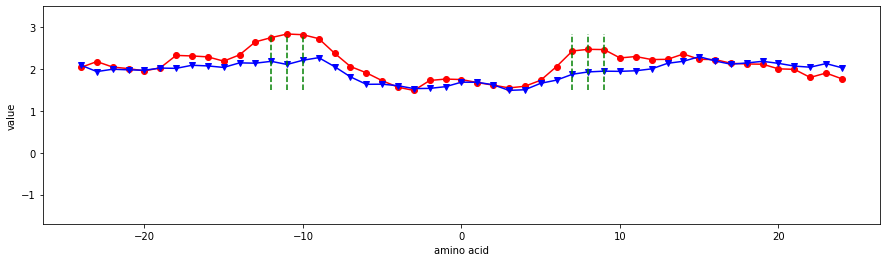

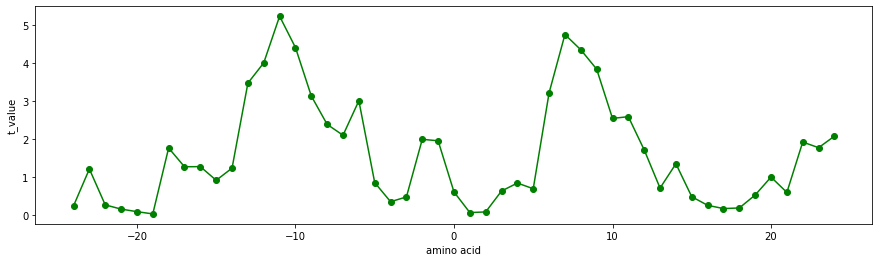

CHAM830108
A parameter of charge transfer donor capability (Charton-Charton, 1983)


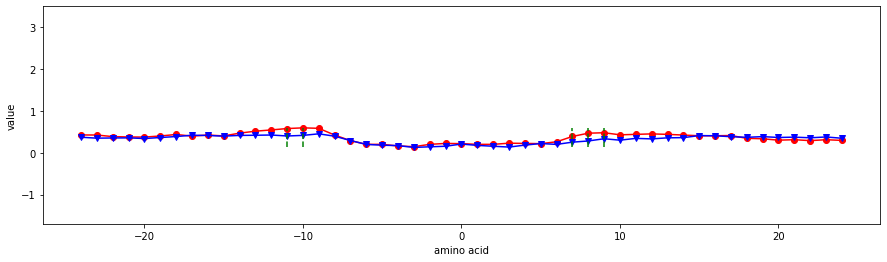

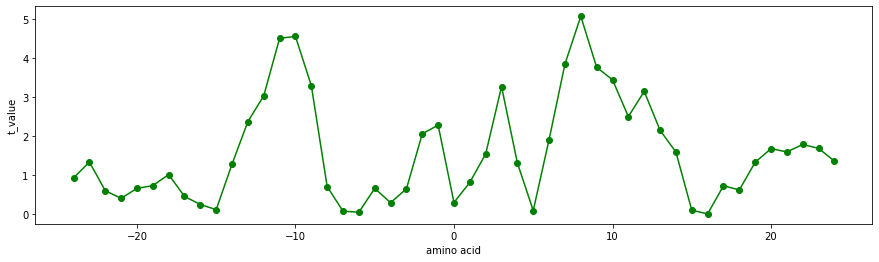

CHOC750101
Average volume of buried residue (Chothia, 1975)


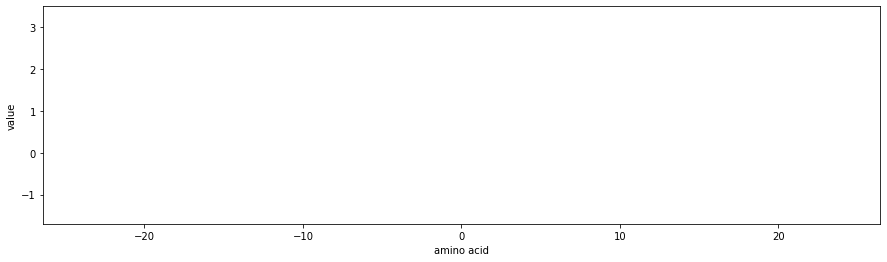

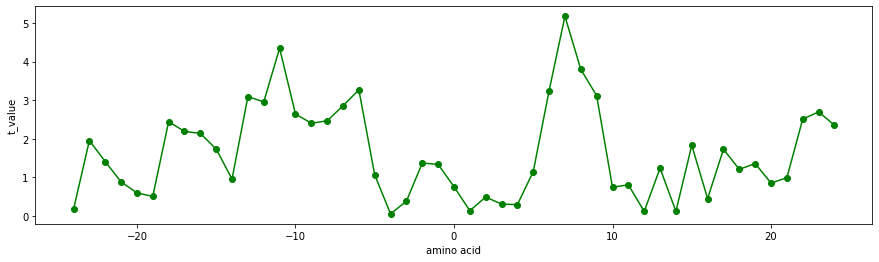

CHOC760101
Residue accessible surface area in tripeptide (Chothia, 1976)


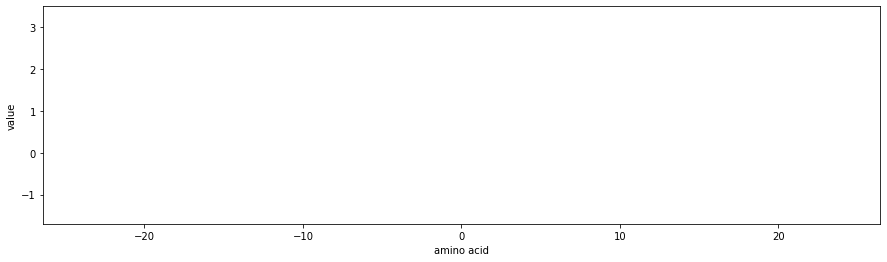

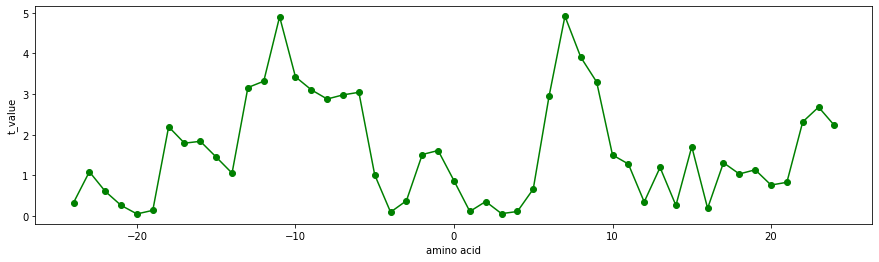

CHOC760102
Residue accessible surface area in folded protein (Chothia, 1976)


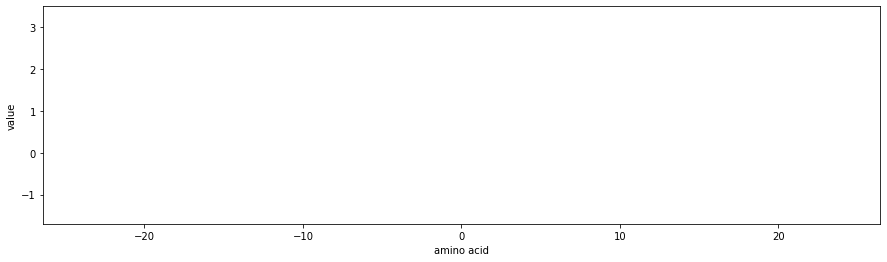

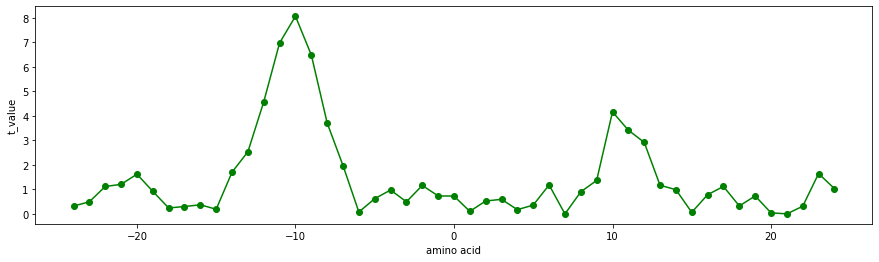

CHOC760103
Proportion of residues 95% buried (Chothia, 1976)


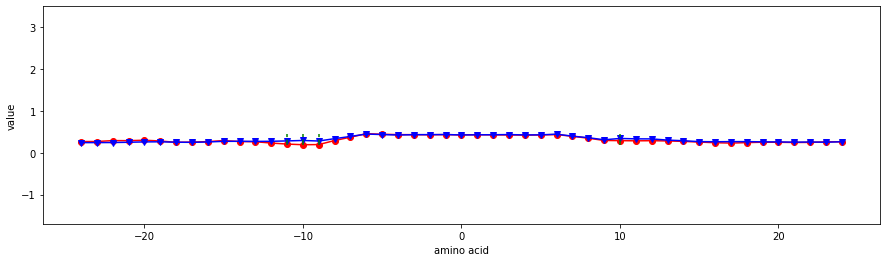

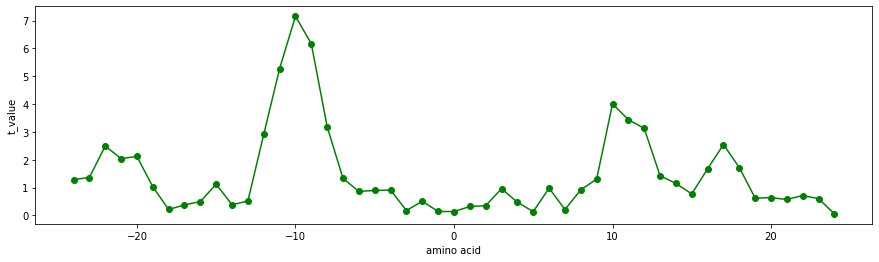

CHOC760104
Proportion of residues 100% buried (Chothia, 1976)


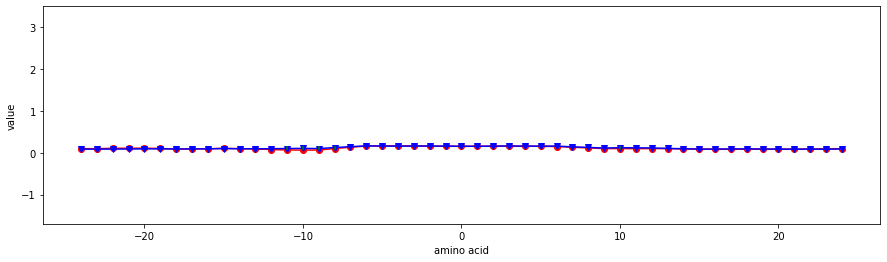

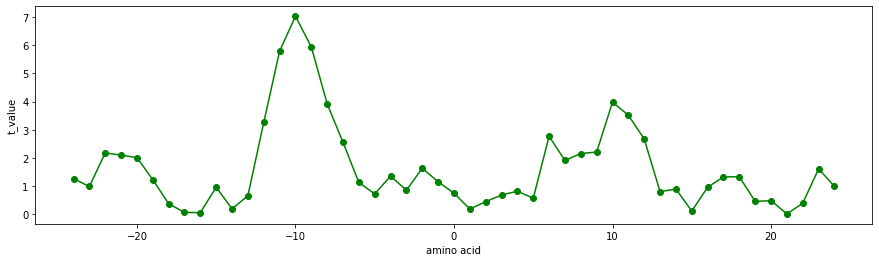

CHOP780101
Normalized frequency of beta-turn (Chou-Fasman, 1978a)


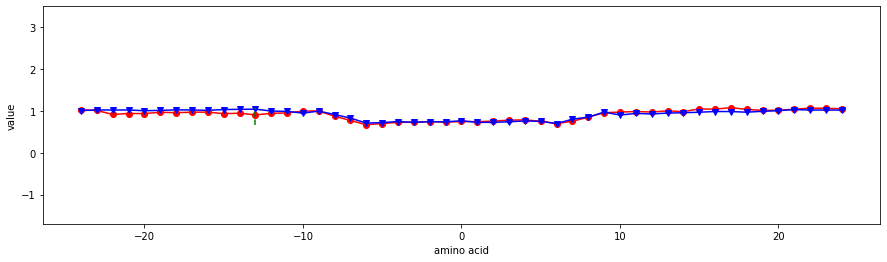

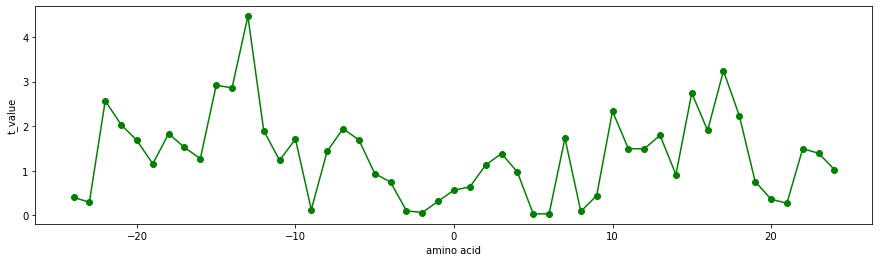

CHOP780201
Normalized frequency of alpha-helix (Chou-Fasman, 1978b)


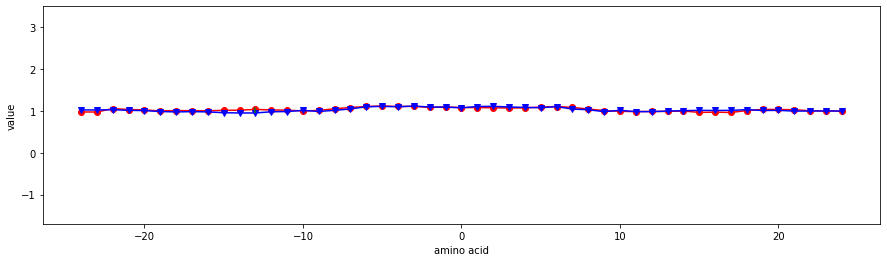

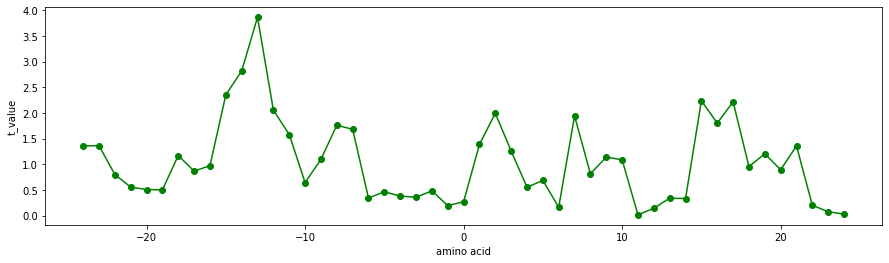

CHOP780202
Normalized frequency of beta-sheet (Chou-Fasman, 1978b)


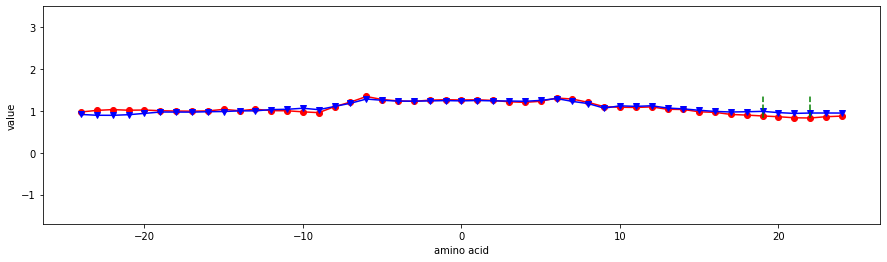

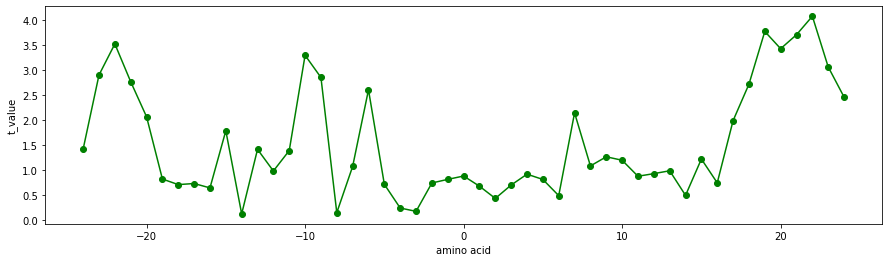

CHOP780204
Normalized frequency of N-terminal helix (Chou-Fasman, 1978b)


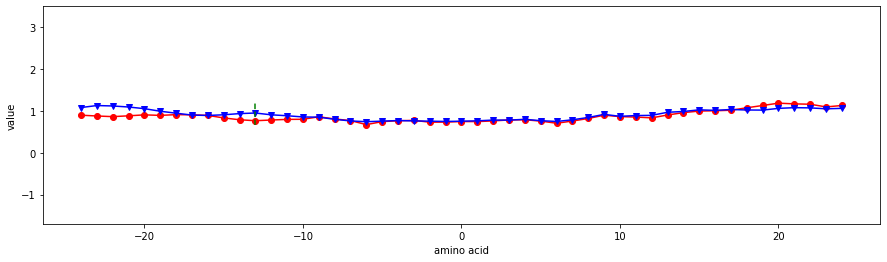

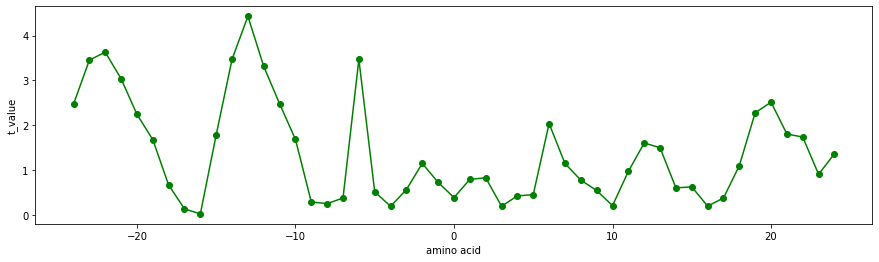

CHOP780205
Normalized frequency of C-terminal helix (Chou-Fasman, 1978b)


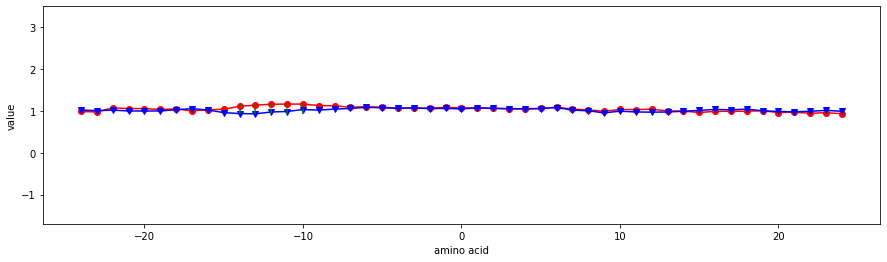

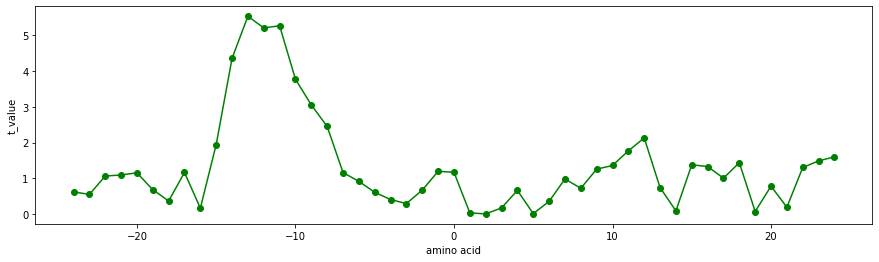

CHOP780206
Normalized frequency of N-terminal non helical region (Chou-Fasman, 1978b)


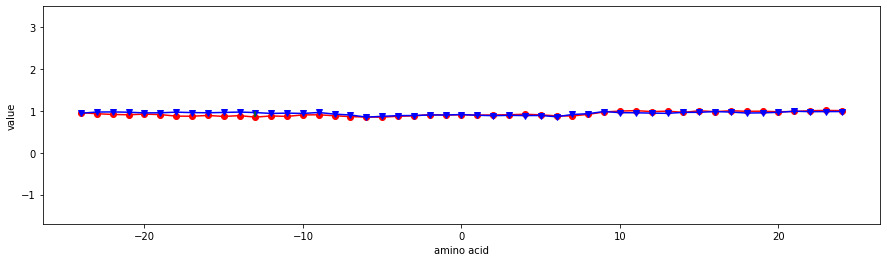

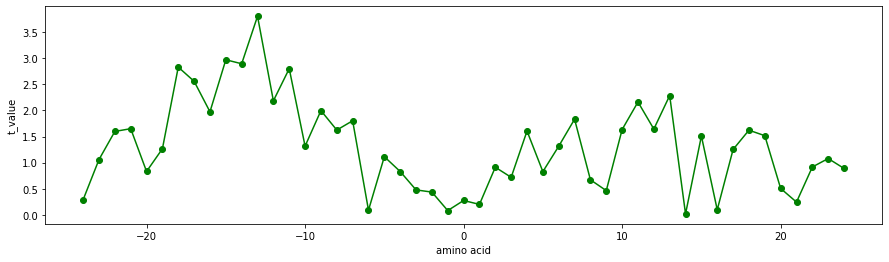

CHOP780207
Normalized frequency of C-terminal non helical region (Chou-Fasman, 1978b)


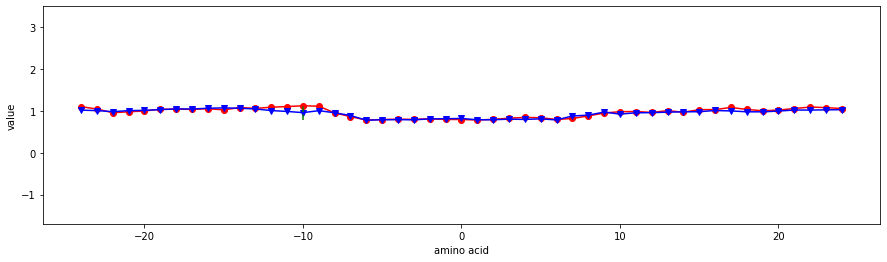

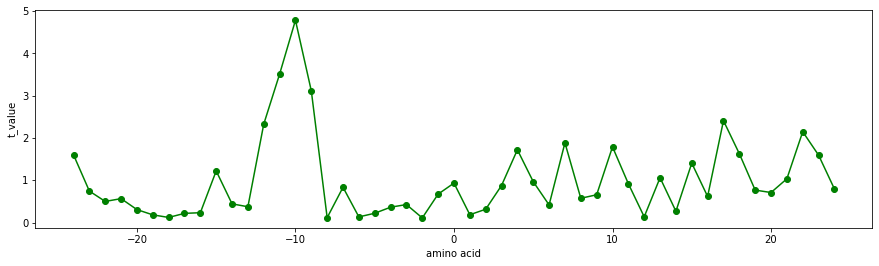

CHOP780208
Normalized frequency of N-terminal beta-sheet (Chou-Fasman, 1978b)


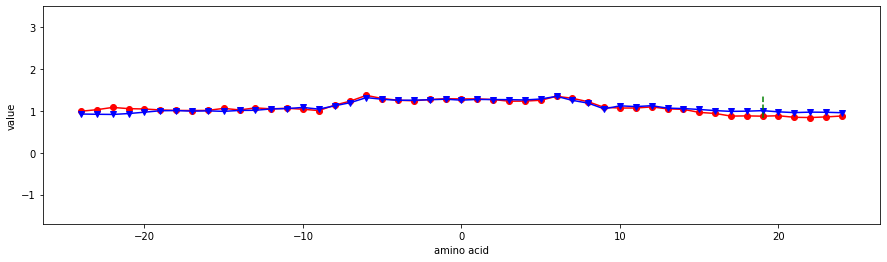

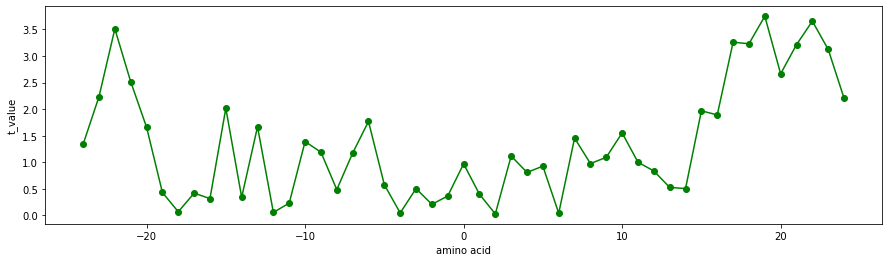

CHOP780209
Normalized frequency of C-terminal beta-sheet (Chou-Fasman, 1978b)


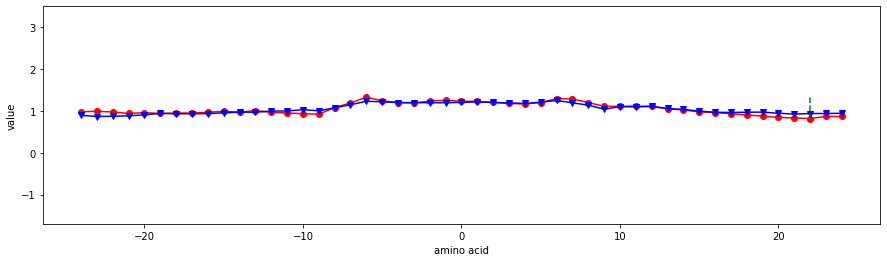

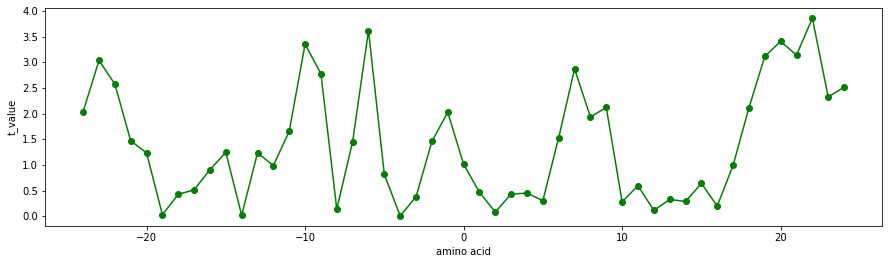

CHOP780211
Normalized frequency of C-terminal non beta region (Chou-Fasman, 1978b)


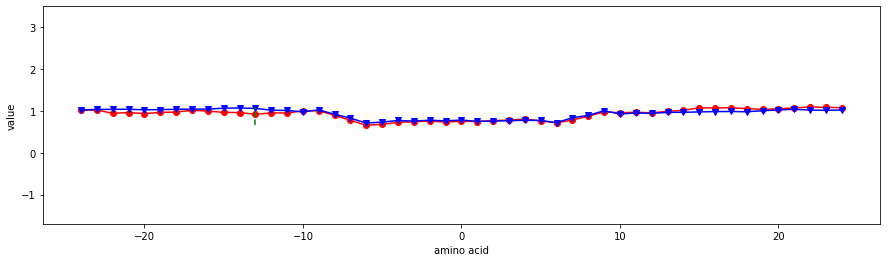

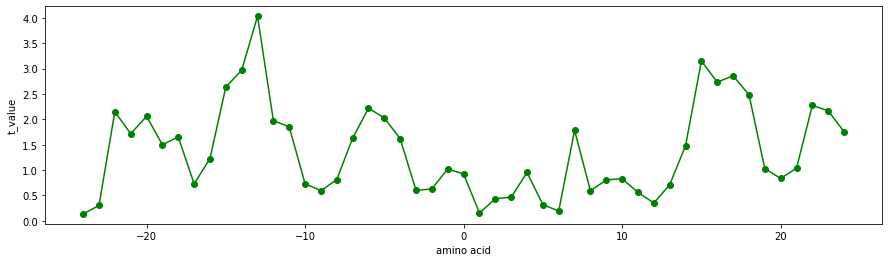

CHOP780213
Frequency of the 2nd residue in turn (Chou-Fasman, 1978b)


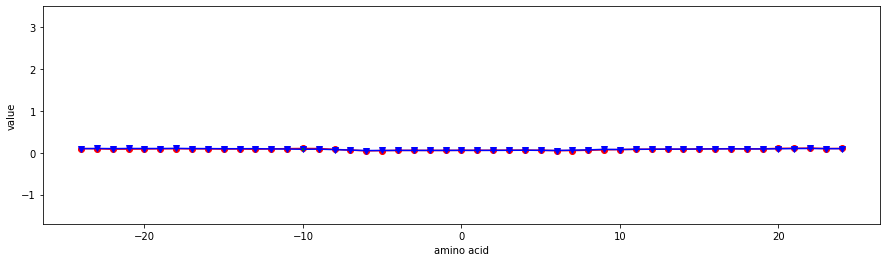

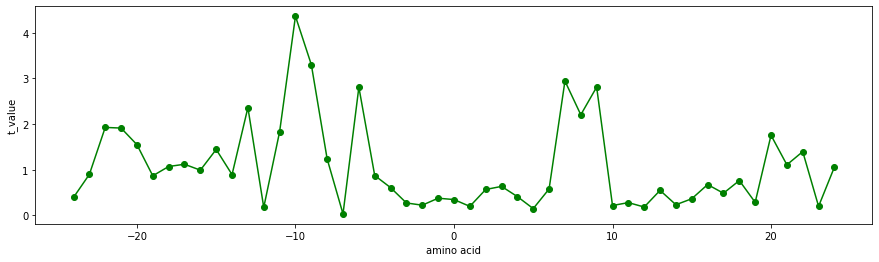

CHOP780214
Frequency of the 3rd residue in turn (Chou-Fasman, 1978b)


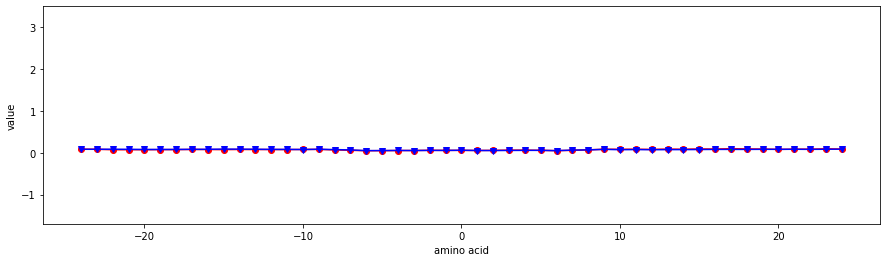

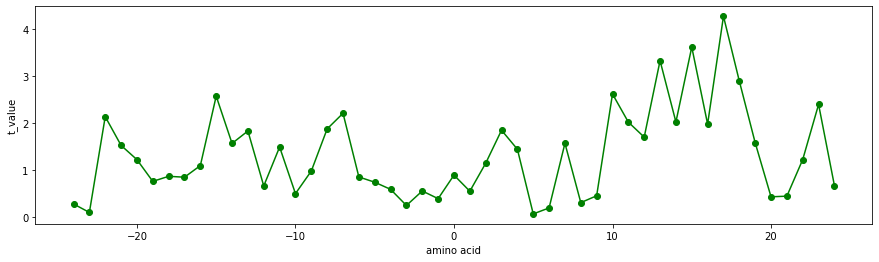

CHOP780215
Frequency of the 4th residue in turn (Chou-Fasman, 1978b)


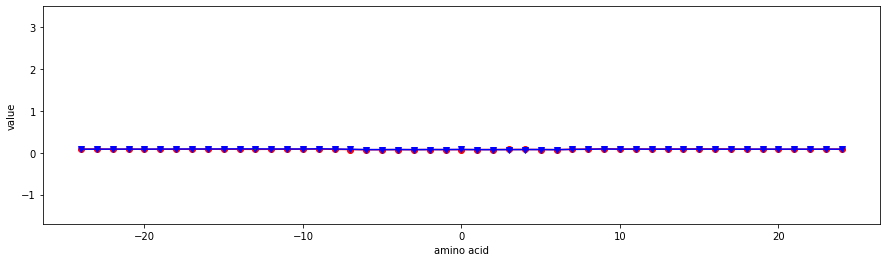

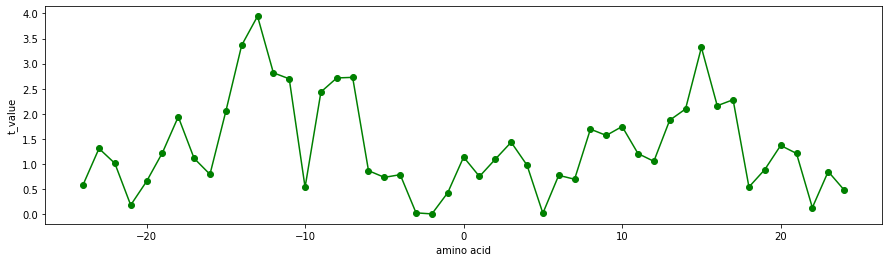

CIDH920101
Normalized hydrophobicity scales for alpha-proteins (Cid et al., 1992)


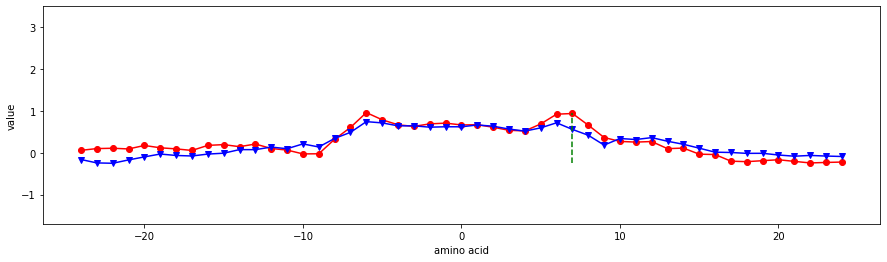

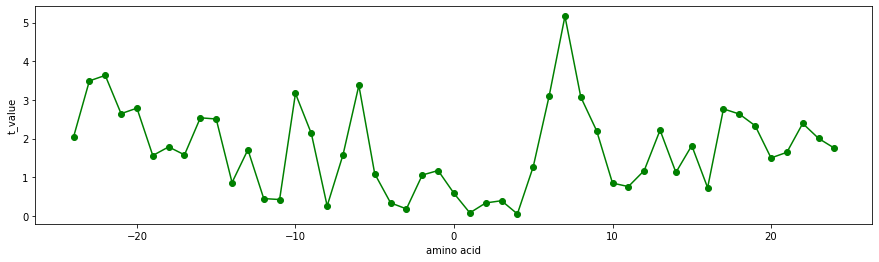

CIDH920102
Normalized hydrophobicity scales for beta-proteins (Cid et al., 1992)


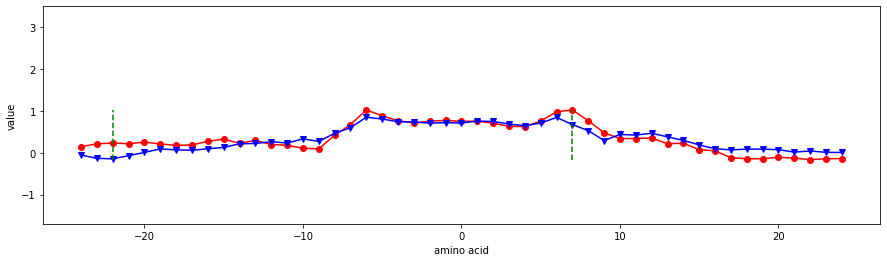

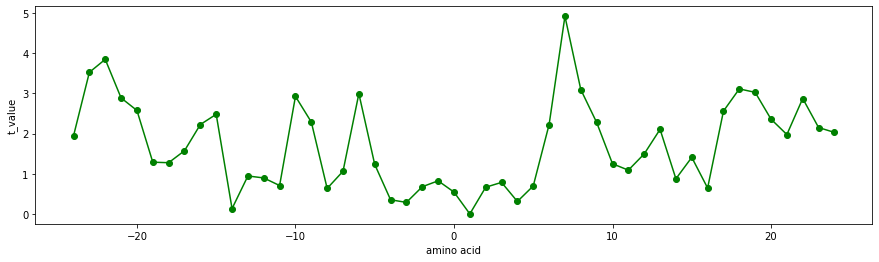

CIDH920103
Normalized hydrophobicity scales for alpha+beta-proteins (Cid et al., 1992)


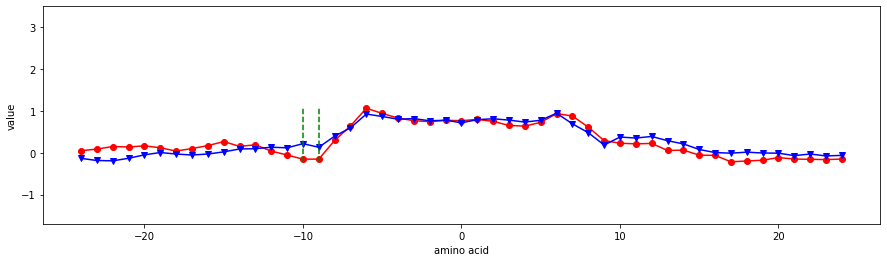

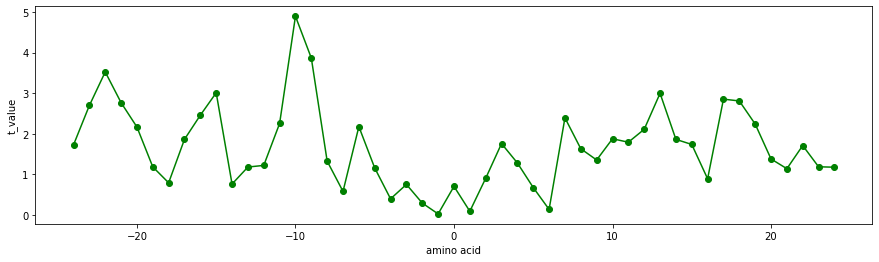

CIDH920104
Normalized hydrophobicity scales for alpha/beta-proteins (Cid et al., 1992)


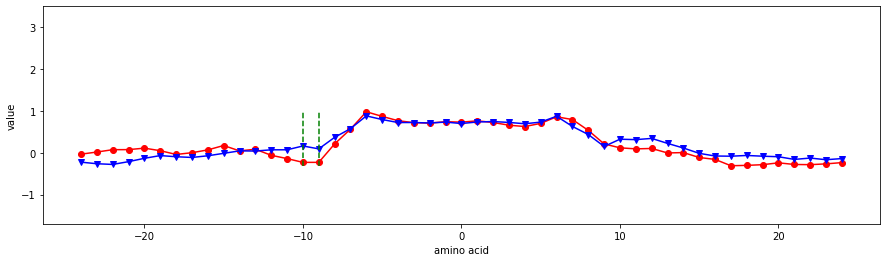

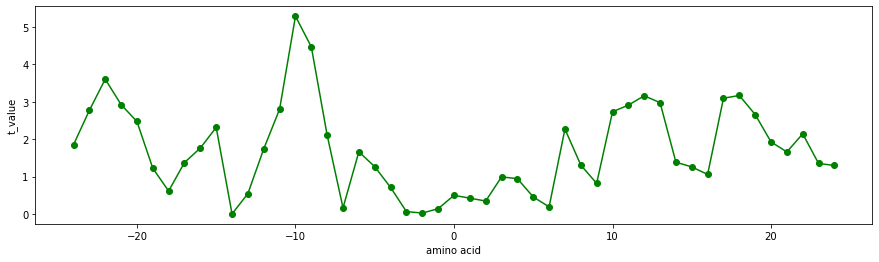

CIDH920105
Normalized average hydrophobicity scales (Cid et al., 1992)


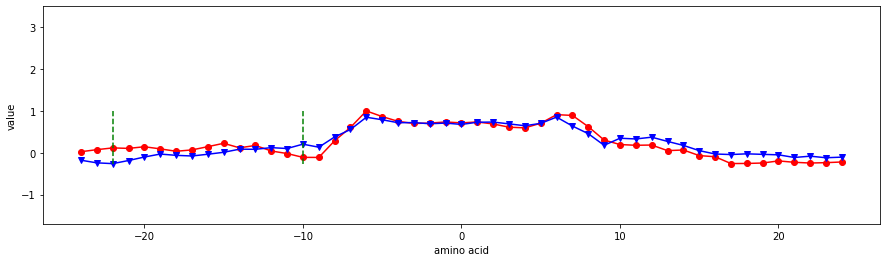

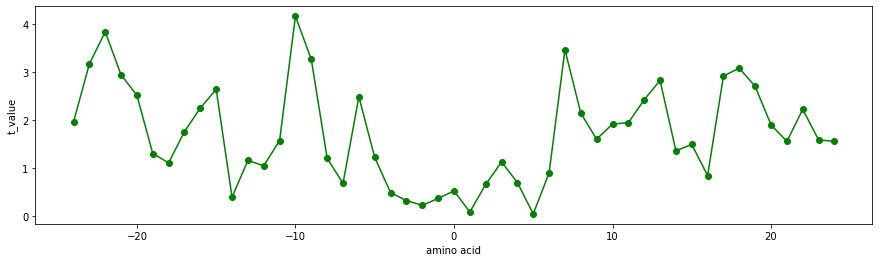

COHE430101
Partial specific volume (Cohn-Edsall, 1943)


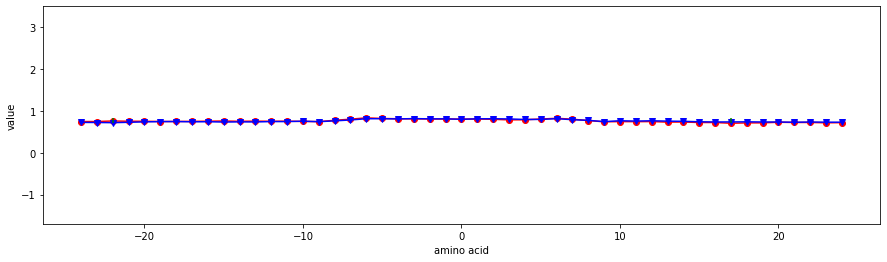

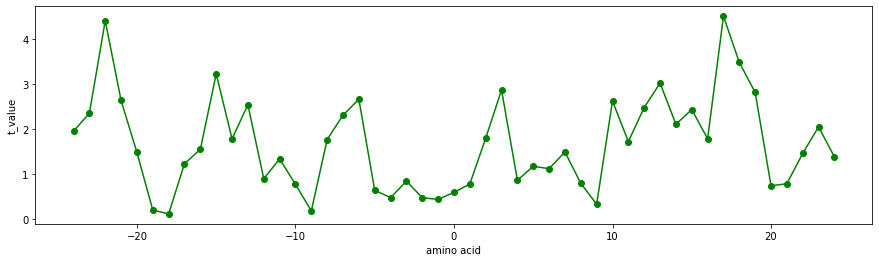

CRAJ730102
Normalized frequency of beta-sheet (Crawford et al., 1973)


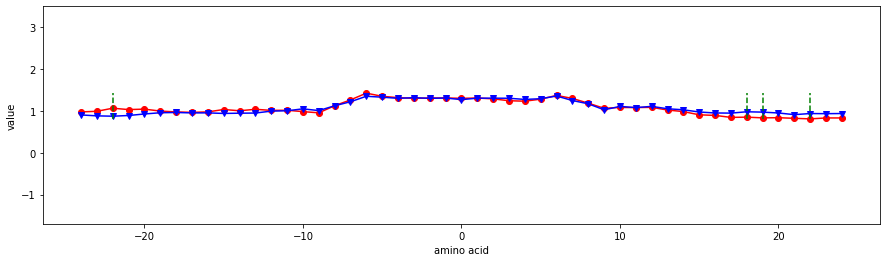

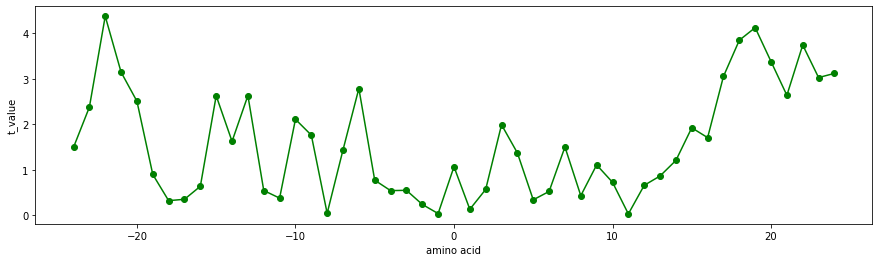

CRAJ730103
Normalized frequency of turn (Crawford et al., 1973)


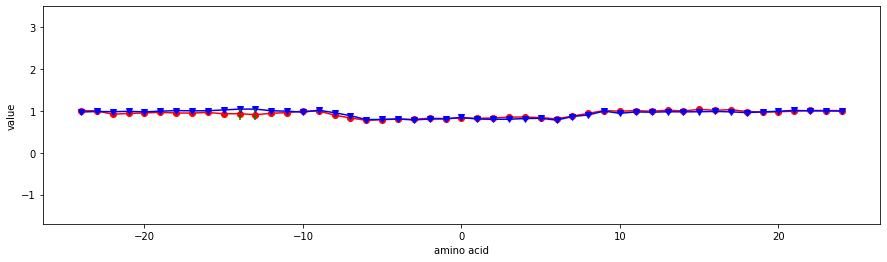

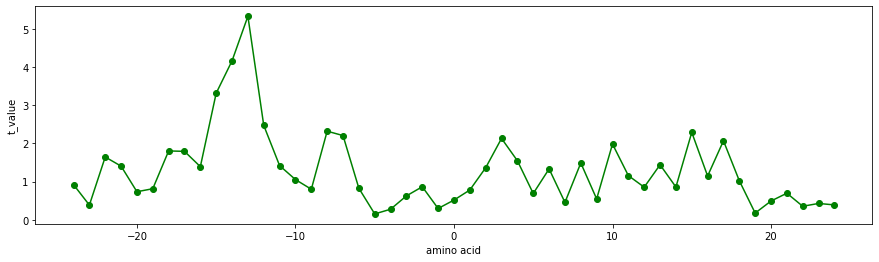

DAWD720101
Size (Dawson, 1972)


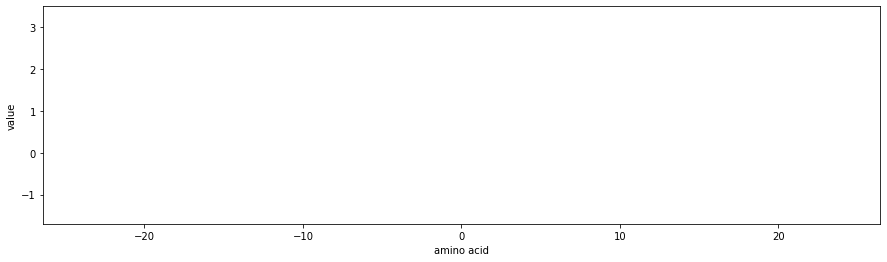

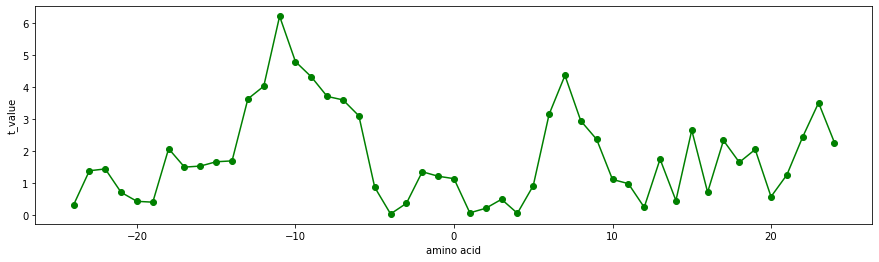

DAYM780101
Amino acid composition (Dayhoff et al., 1978a)


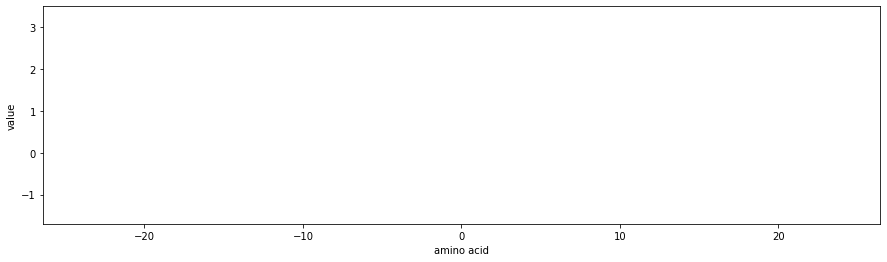

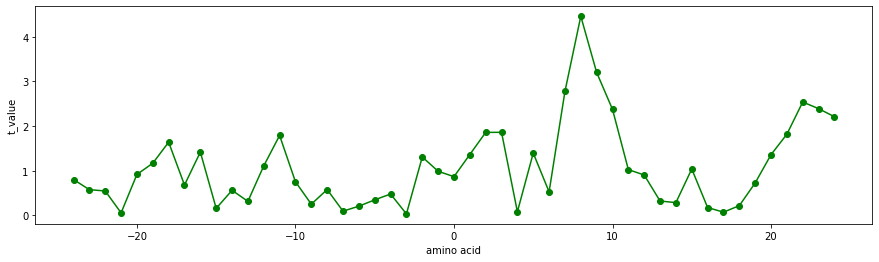

DAYM780201
Relative mutability (Dayhoff et al., 1978b)


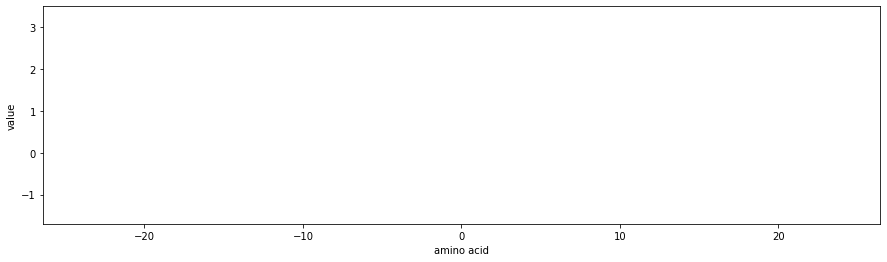

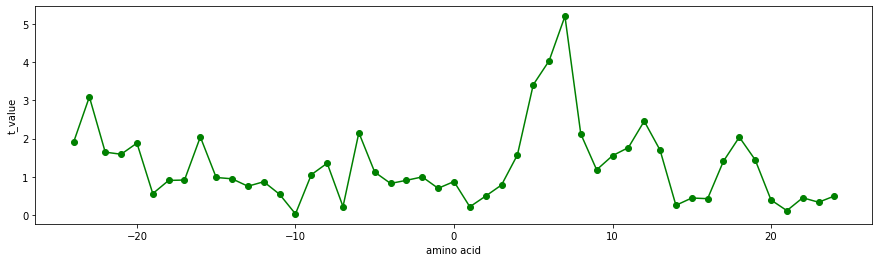

DESM900101
Membrane preference for cytochrome b: MPH89 (Degli Esposti et al., 1990)


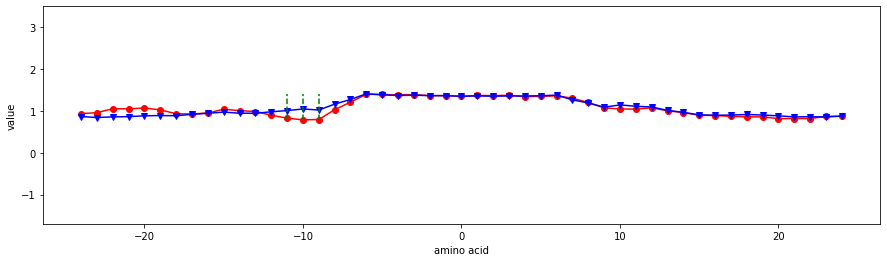

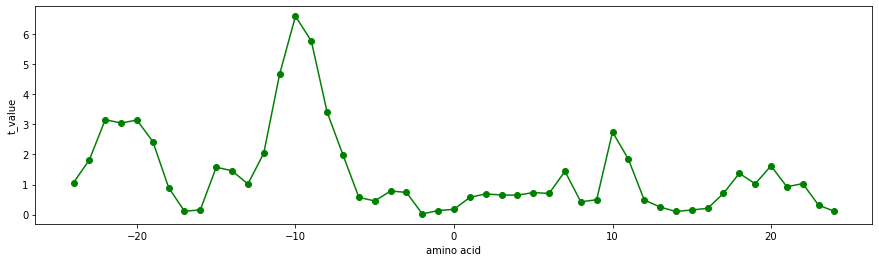

DESM900102
Average membrane preference: AMP07 (Degli Esposti et al., 1990)


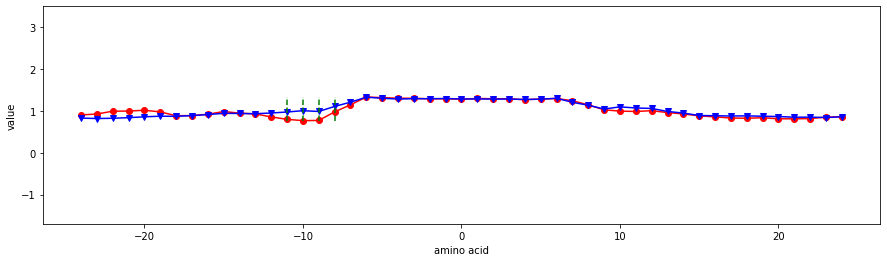

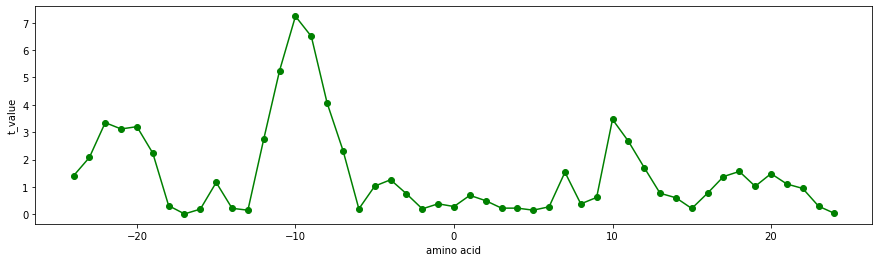

EISD840101
Consensus normalized hydrophobicity scale (Eisenberg, 1984)


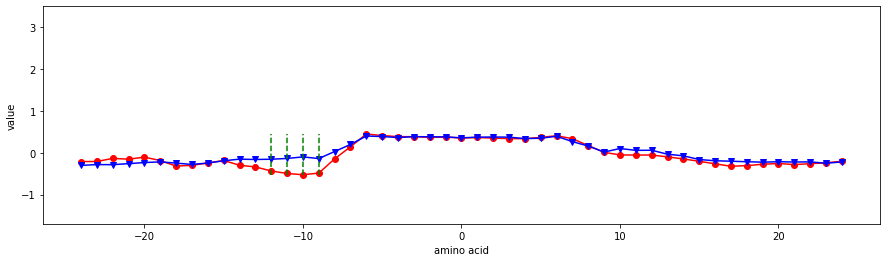

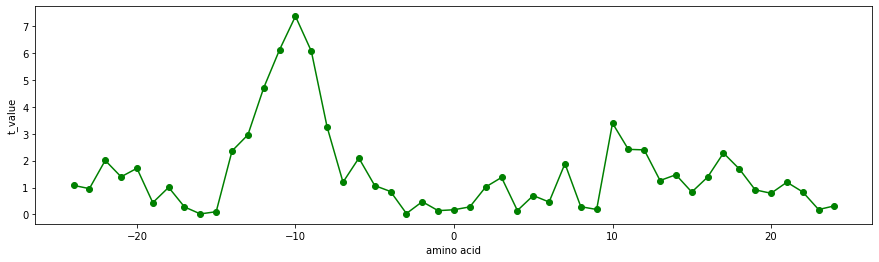

EISD860101
Solvation free energy (Eisenberg-McLachlan, 1986)


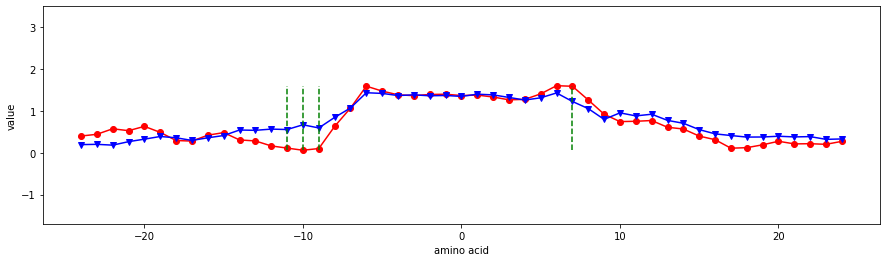

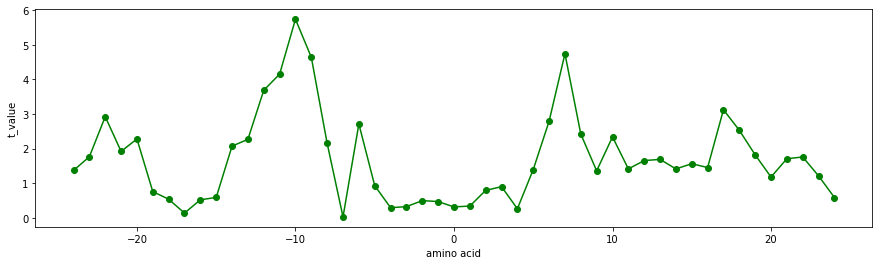

EISD860102
Atom-based hydrophobic moment (Eisenberg-McLachlan, 1986)


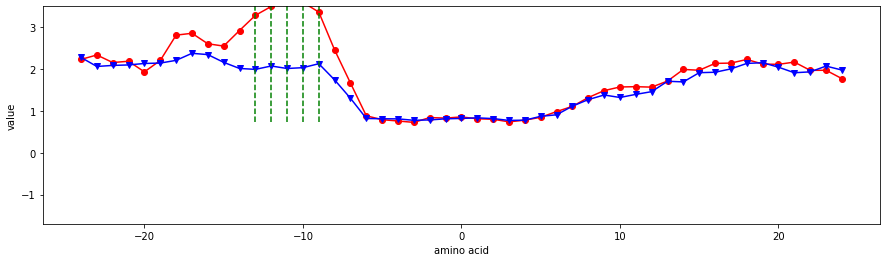

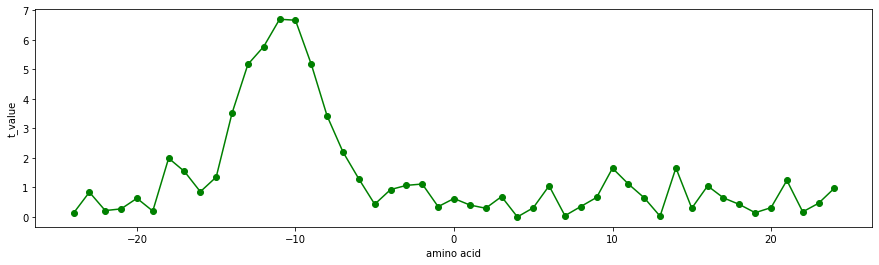

EISD860103
Direction of hydrophobic moment (Eisenberg-McLachlan, 1986)


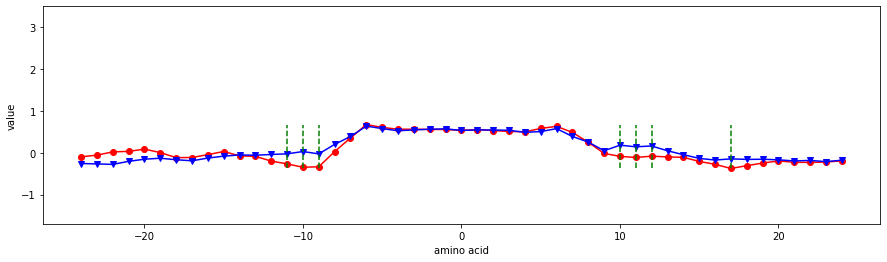

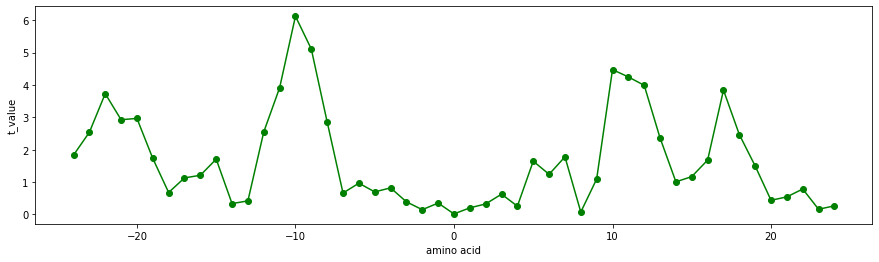

FASG760101
Molecular weight (Fasman, 1976)


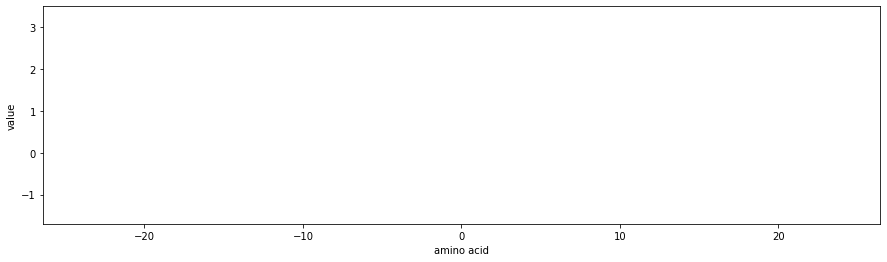

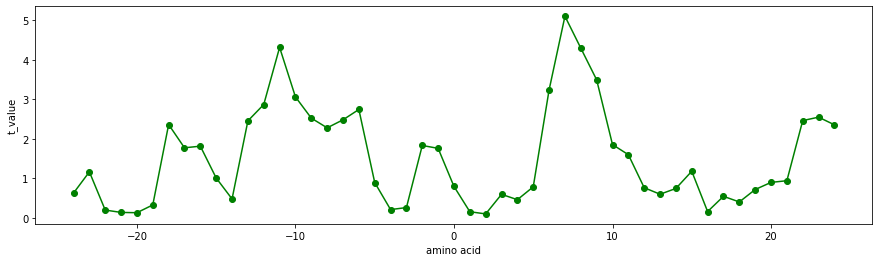

FASG760102
Melting point (Fasman, 1976)


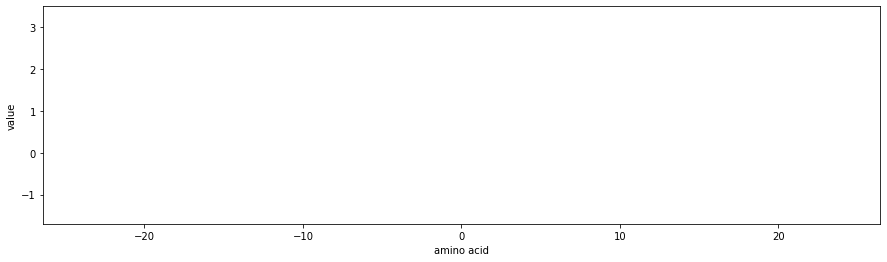

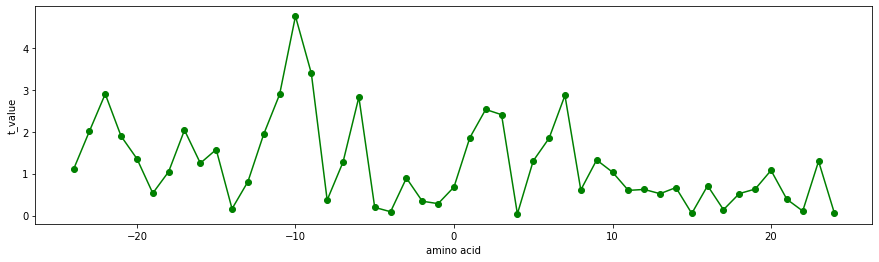

FASG760103
Optical rotation (Fasman, 1976)


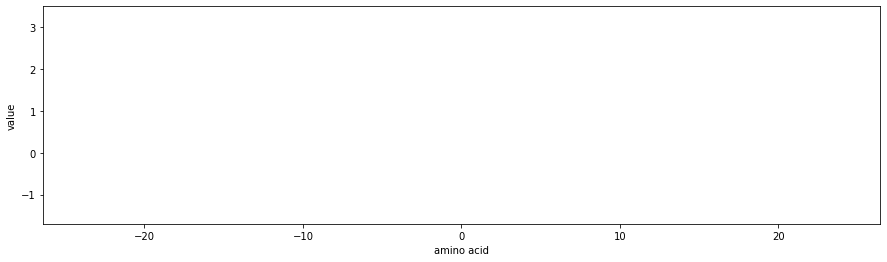

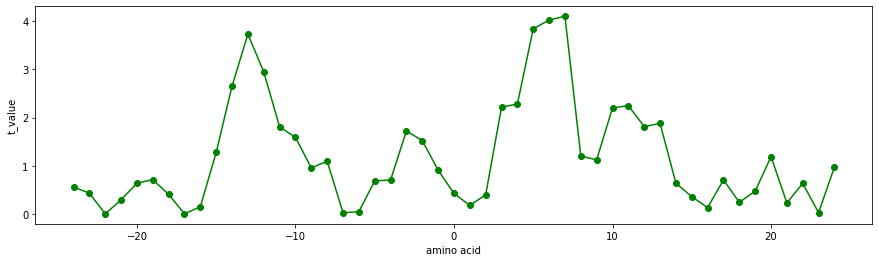

FASG760105
pK-C (Fasman, 1976)


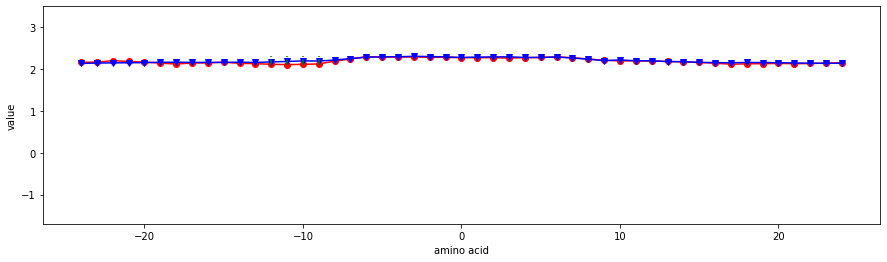

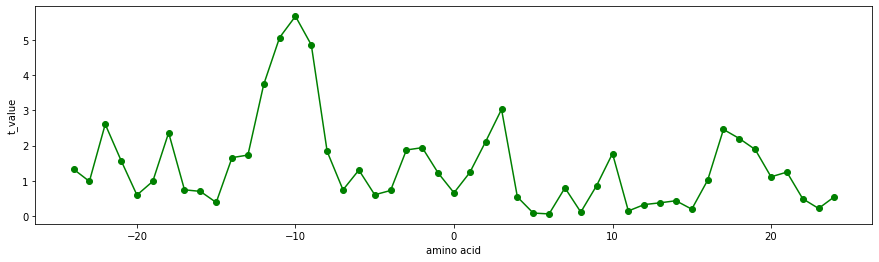

FAUJ830101
Hydrophobic parameter pi (Fauchere-Pliska, 1983)


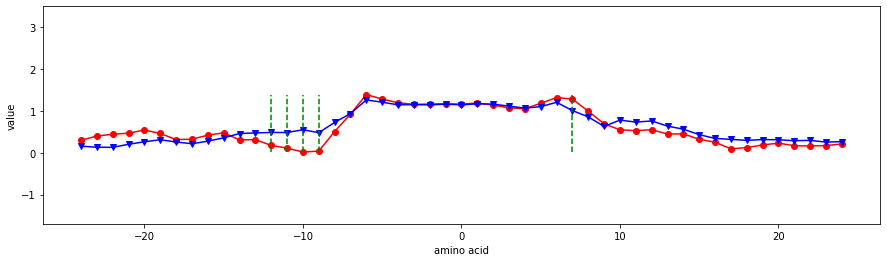

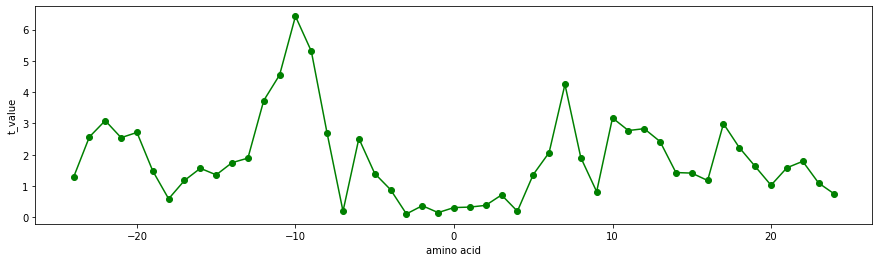

FAUJ880101
Graph shape index (Fauchere et al., 1988)


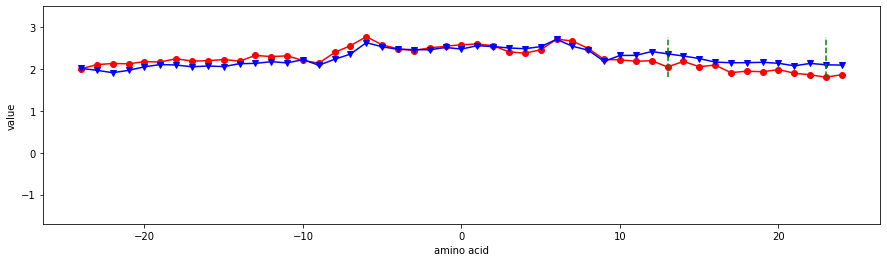

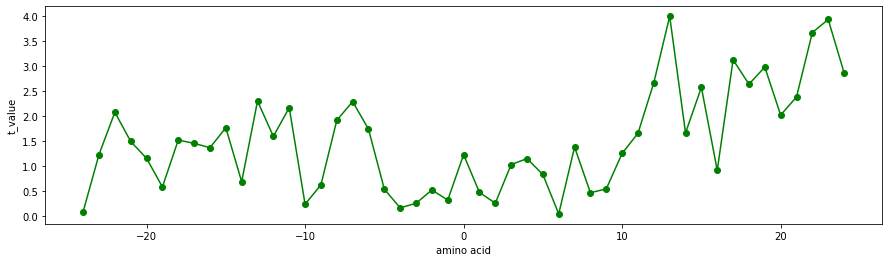

FAUJ880102
Smoothed upsilon steric parameter (Fauchere et al., 1988)


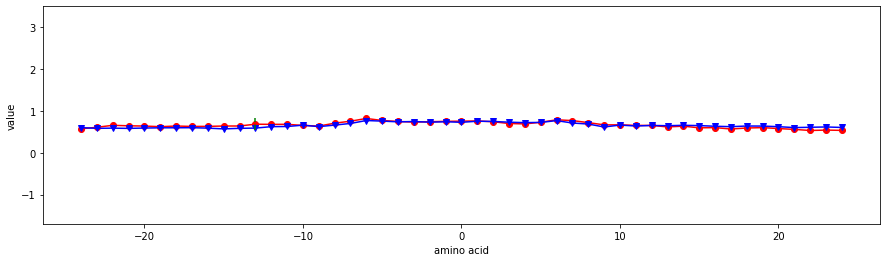

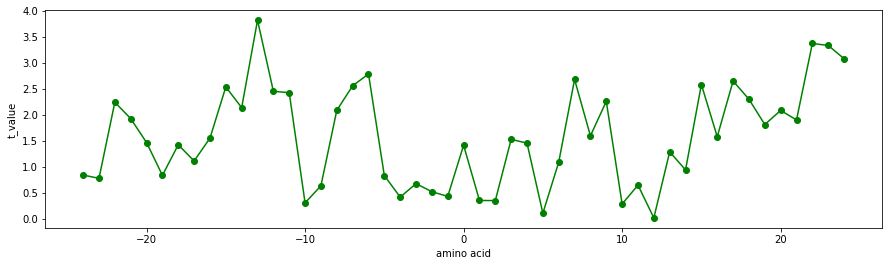

FAUJ880103
Normalized van der Waals volume (Fauchere et al., 1988)


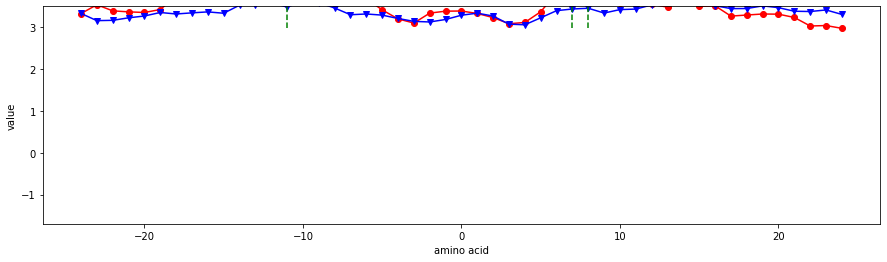

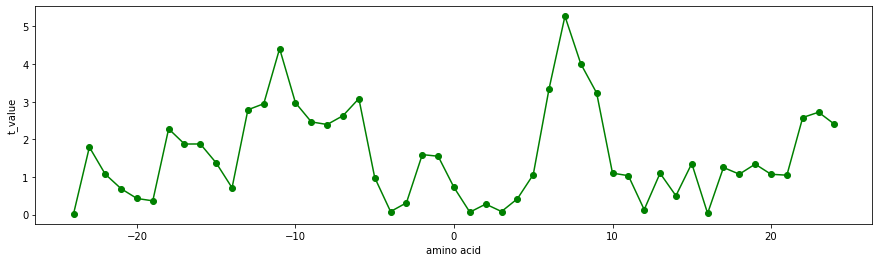

FAUJ880104
STERIMOL length of the side chain (Fauchere et al., 1988)


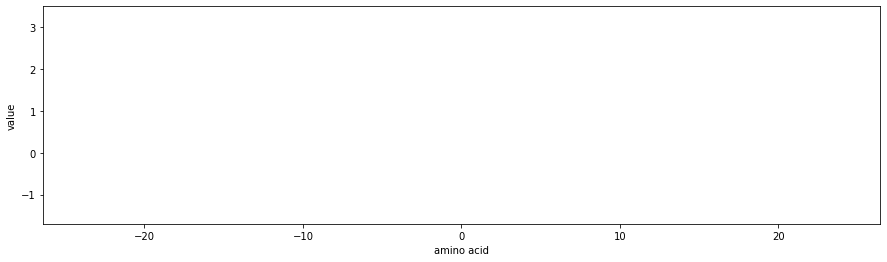

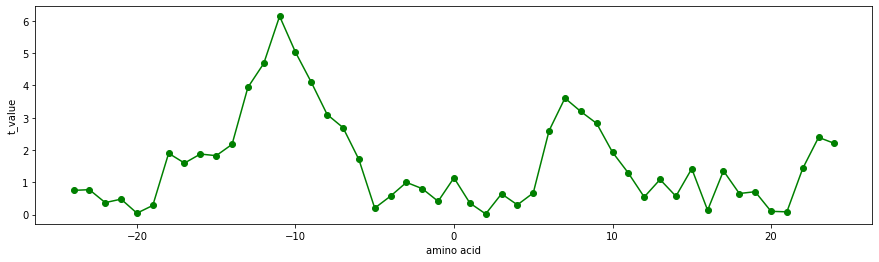

FAUJ880105
STERIMOL minimum width of the side chain (Fauchere et al., 1988)


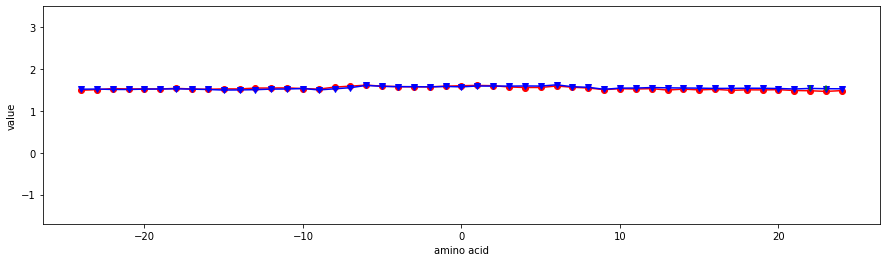

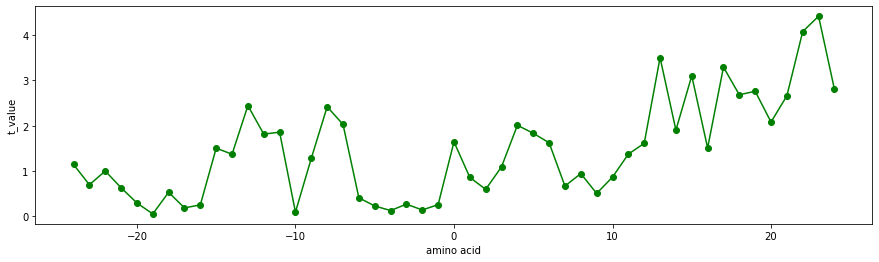

FAUJ880106
STERIMOL maximum width of the side chain (Fauchere et al., 1988)


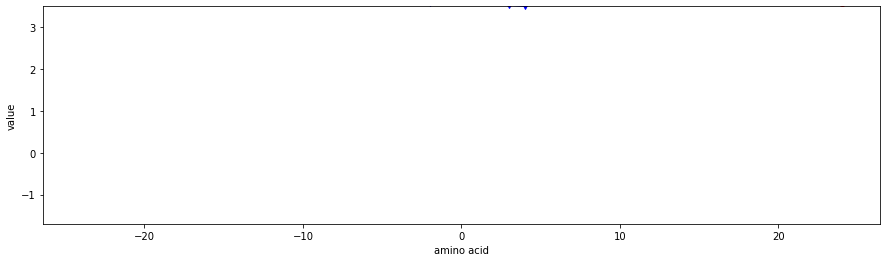

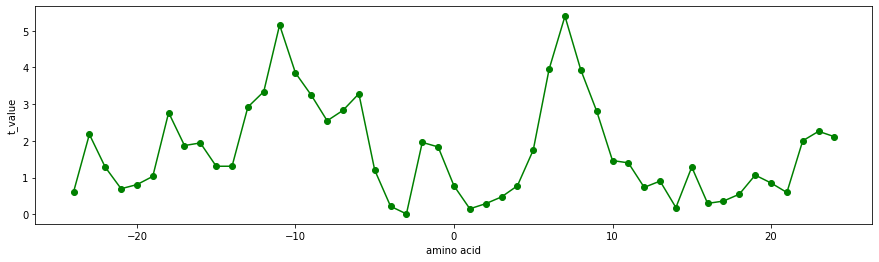

FAUJ880107
N.m.r. chemical shift of alpha-carbon (Fauchere et al., 1988)


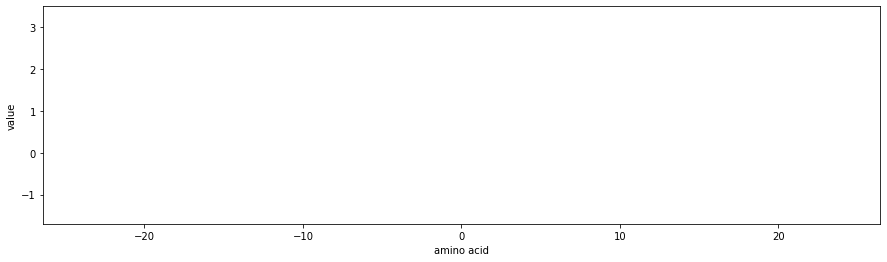

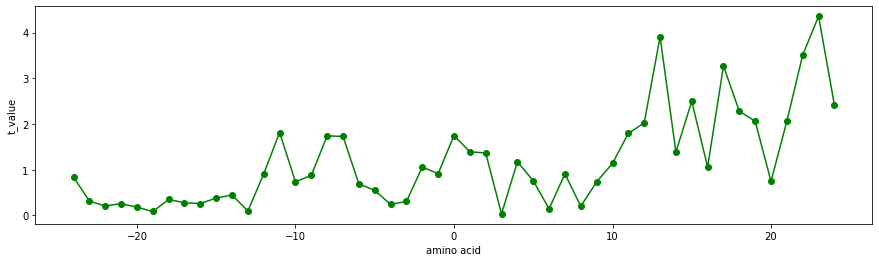

FAUJ880109
Number of hydrogen bond donors (Fauchere et al., 1988)


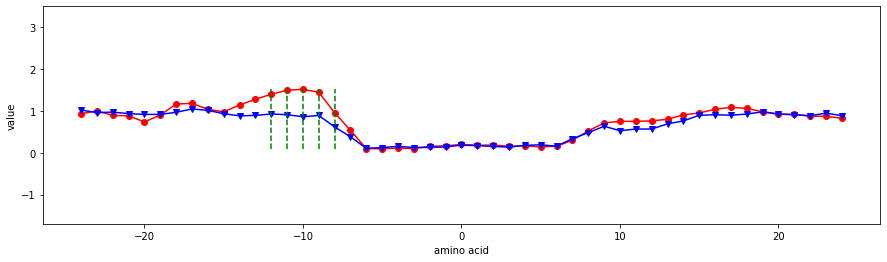

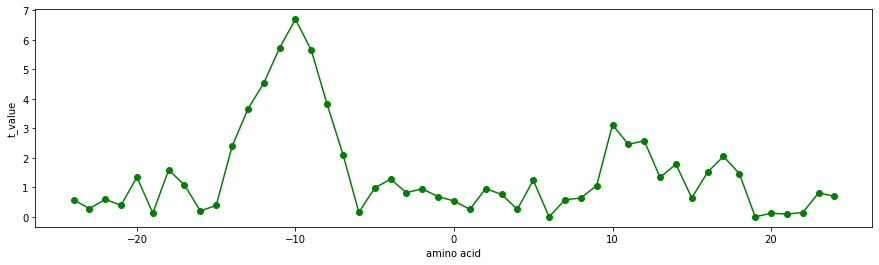

FAUJ880110
Number of full nonbonding orbitals (Fauchere et al., 1988)


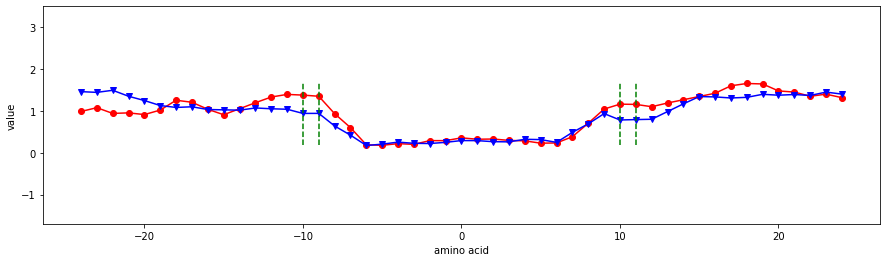

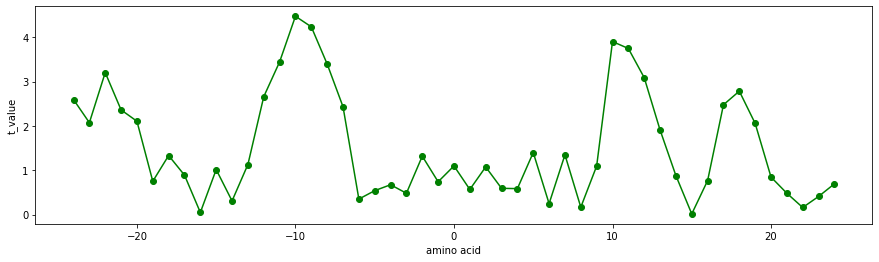

FAUJ880111
Positive charge (Fauchere et al., 1988)


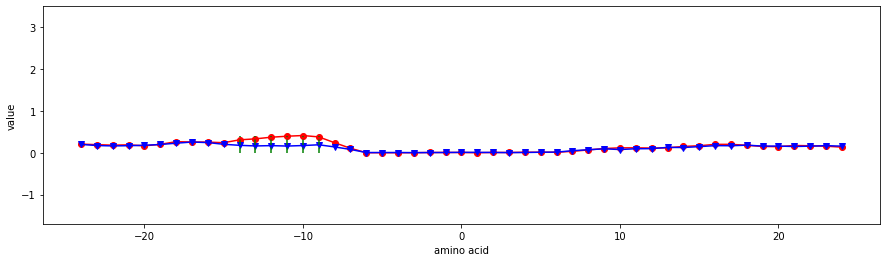

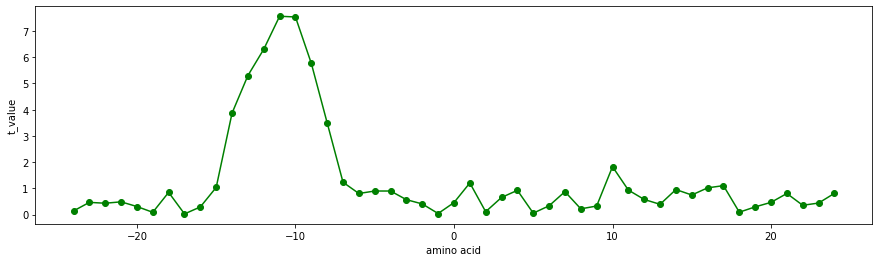

FINA770101
Helix-coil equilibrium constant (Finkelstein-Ptitsyn, 1977)


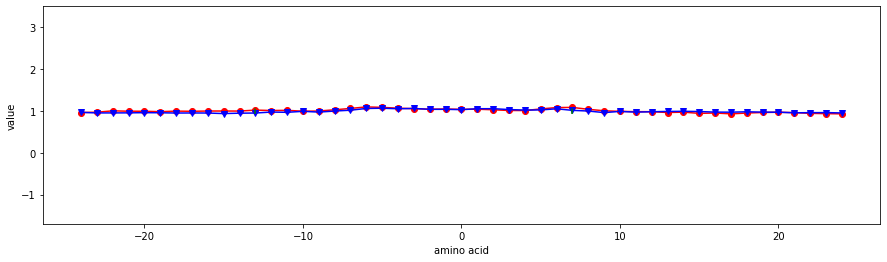

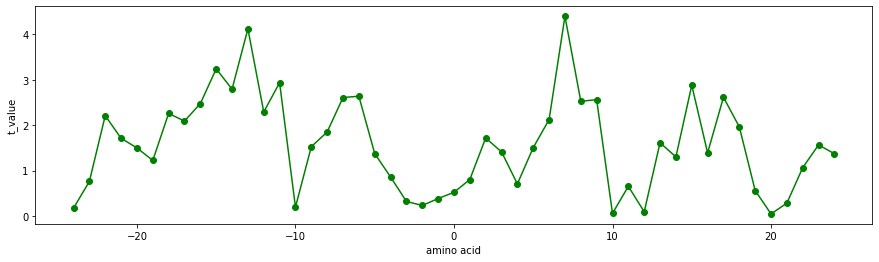

FINA910103
Helix termination parameter at posision j-2,j-1,j (Finkelstein et al., 1991)


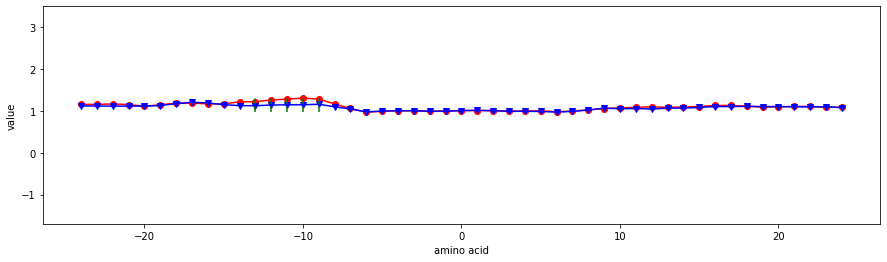

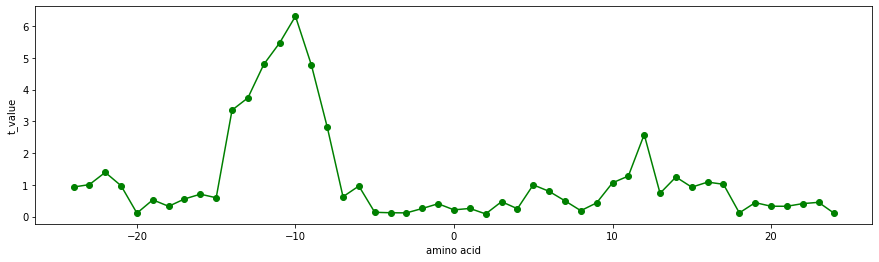

FINA910104
Helix termination parameter at posision j+1 (Finkelstein et al., 1991)


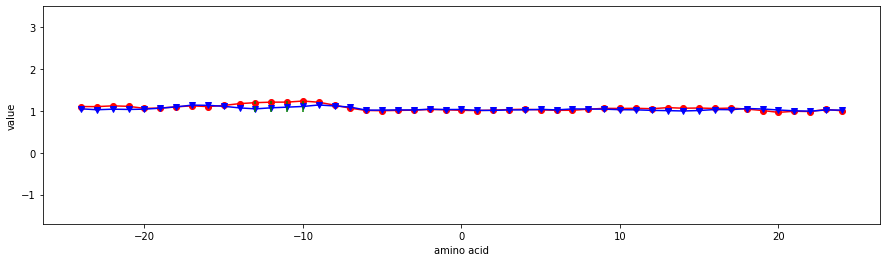

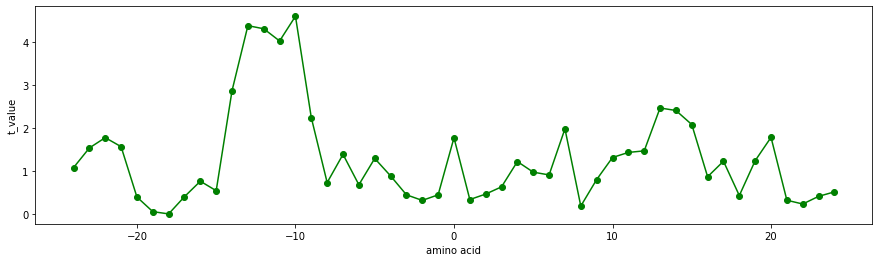

GARJ730101
Partition coefficient (Garel et al., 1973)


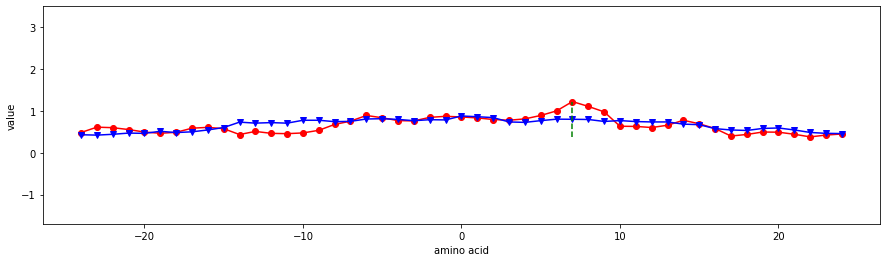

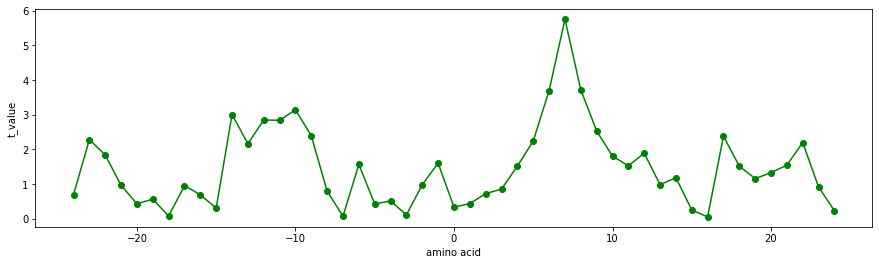

GEIM800101
Alpha-helix indices (Geisow-Roberts, 1980)


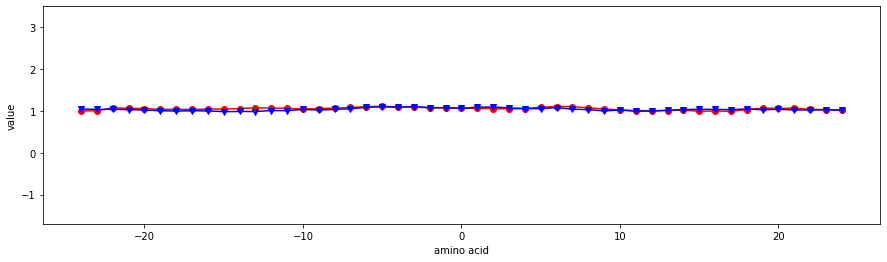

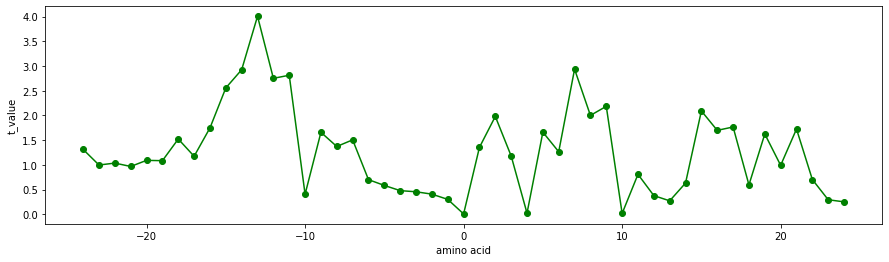

GEIM800103
Alpha-helix indices for beta-proteins (Geisow-Roberts, 1980)


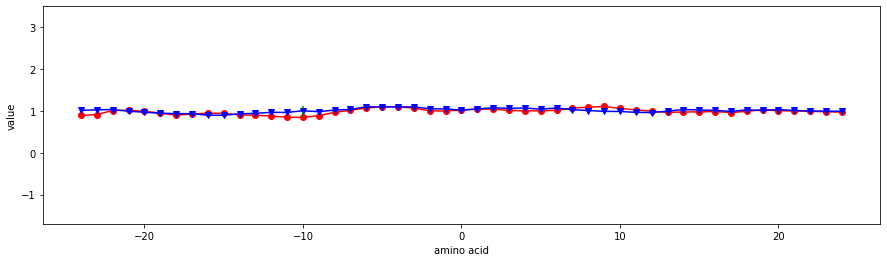

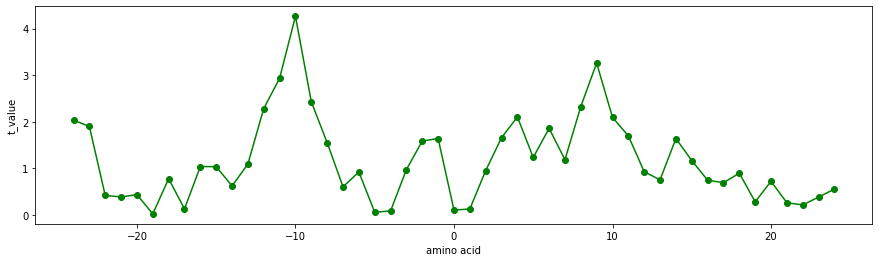

GEIM800105
Beta-strand indices (Geisow-Roberts, 1980)


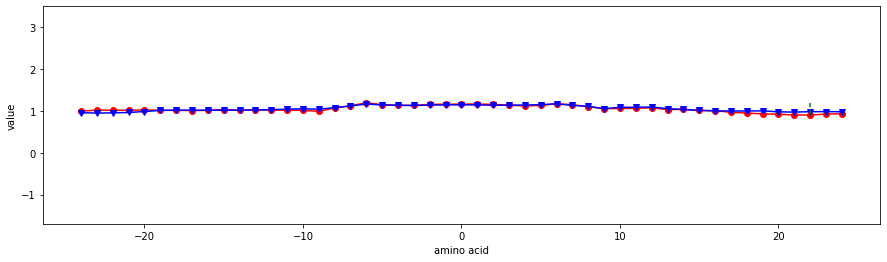

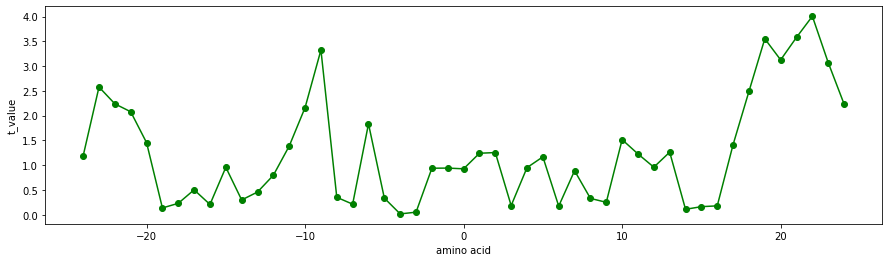

GEIM800106
Beta-strand indices for beta-proteins (Geisow-Roberts, 1980)


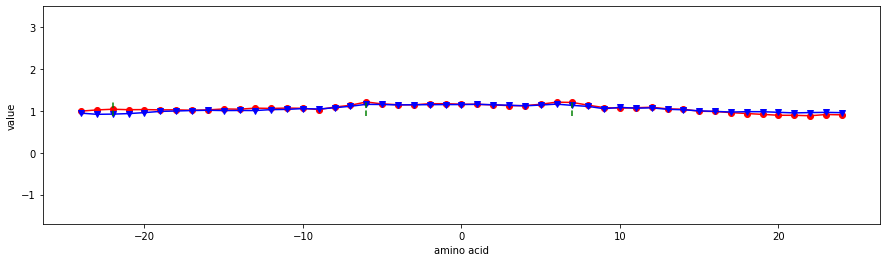

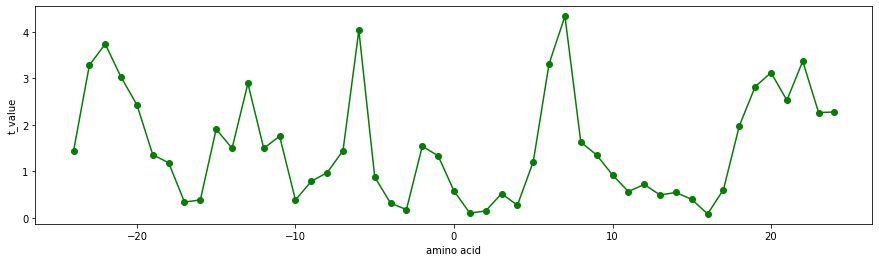

GEIM800110
Aperiodic indices for beta-proteins (Geisow-Roberts, 1980)


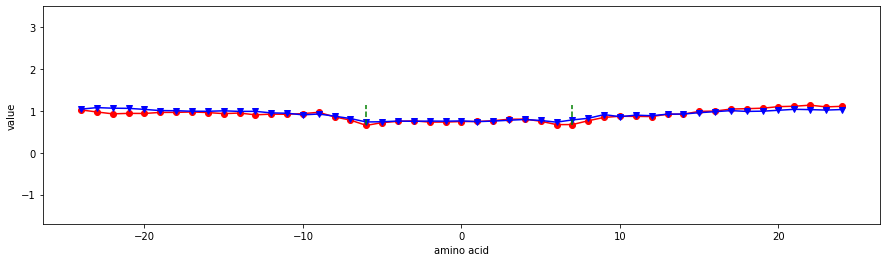

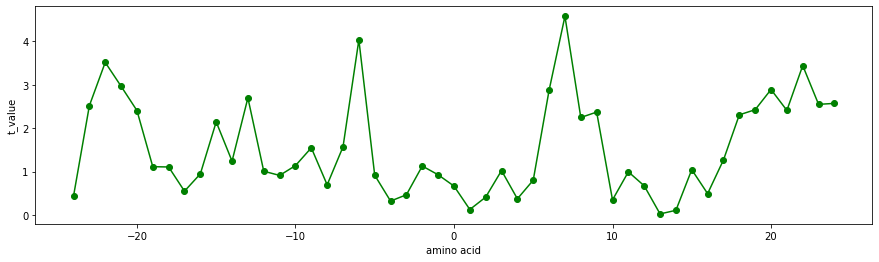

GOLD730101
Hydrophobicity factor (Goldsack-Chalifoux, 1973)


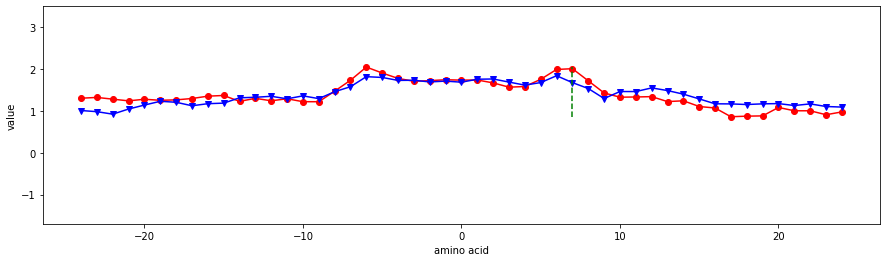

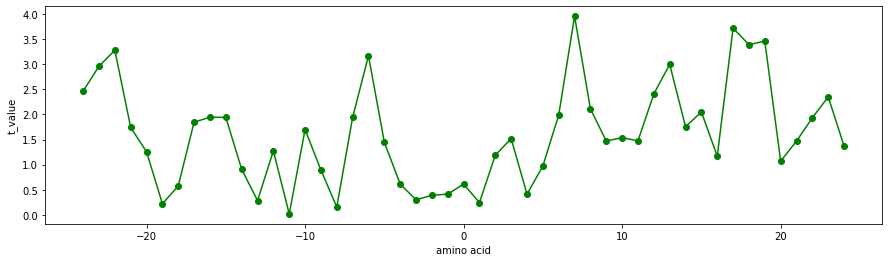

GOLD730102
Residue volume (Goldsack-Chalifoux, 1973)


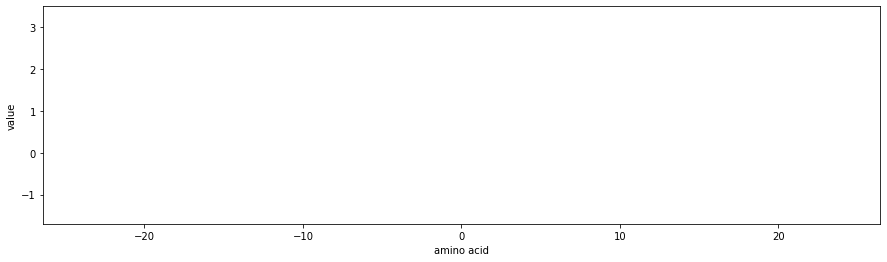

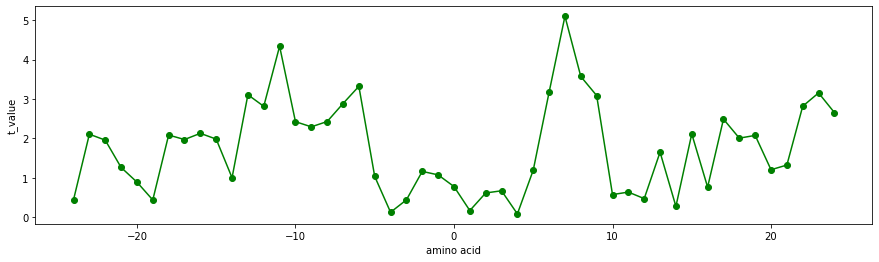

GRAR740102
Polarity (Grantham, 1974)


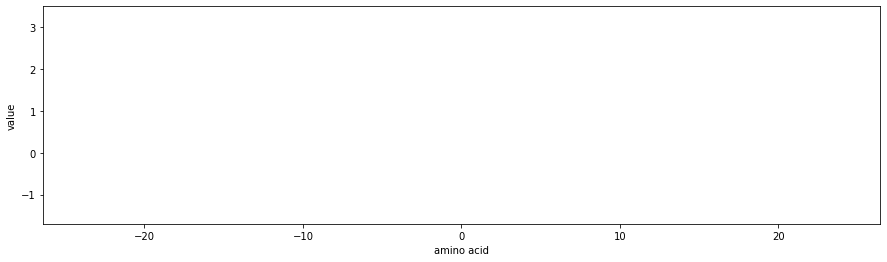

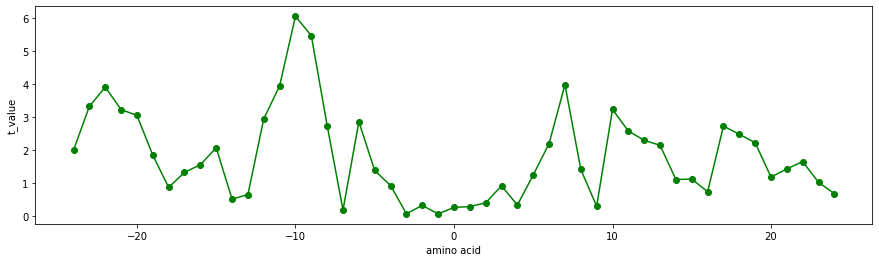

GRAR740103
Volume (Grantham, 1974)


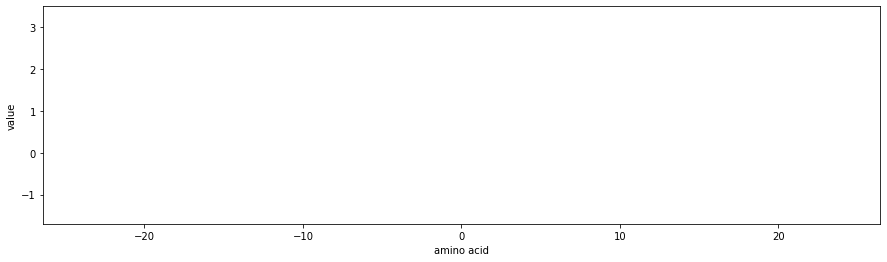

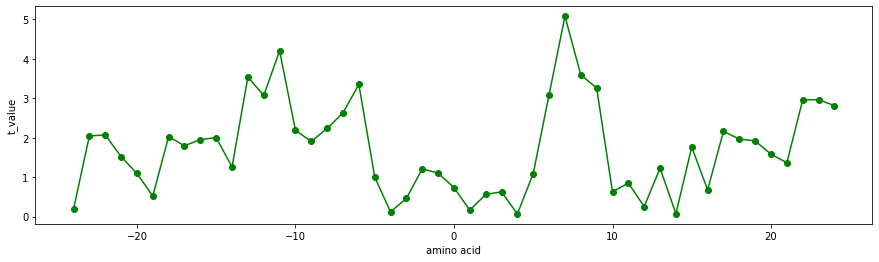

GUYH850101
Partition energy (Guy, 1985)


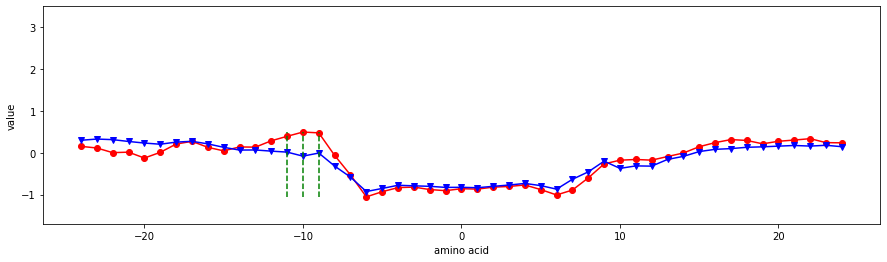

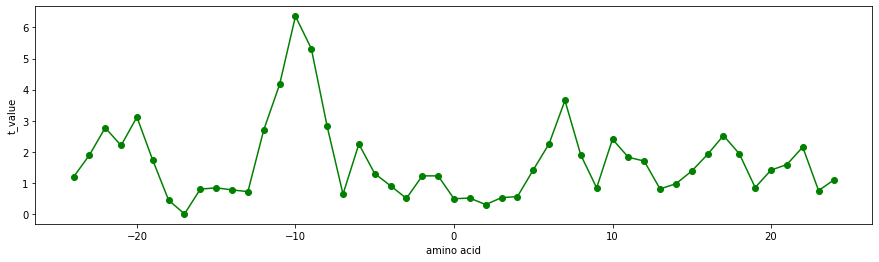

HOPA770101
Hydration number (Hopfinger, 1971), Cited by Charton-Charton (1982)


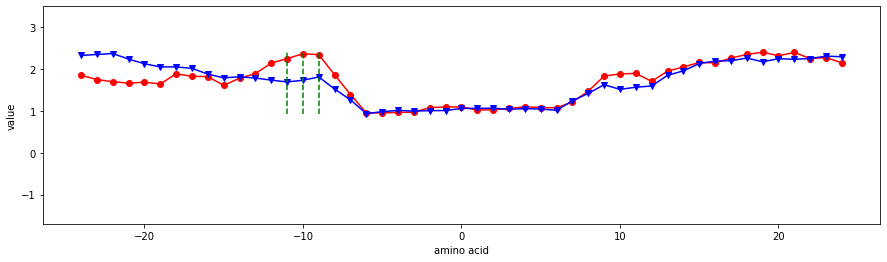

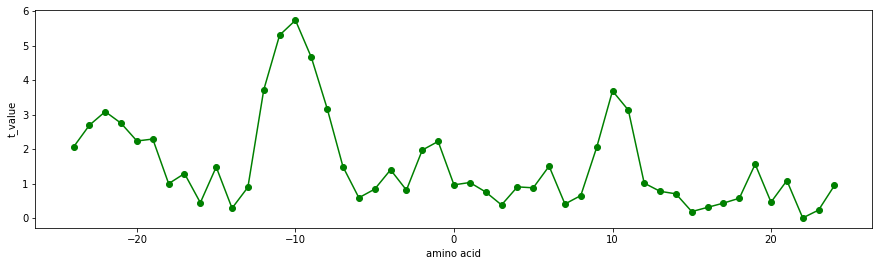

HOPT810101
Hydrophilicity value (Hopp-Woods, 1981)


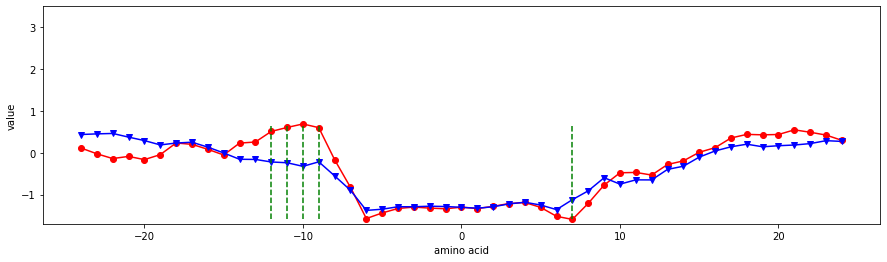

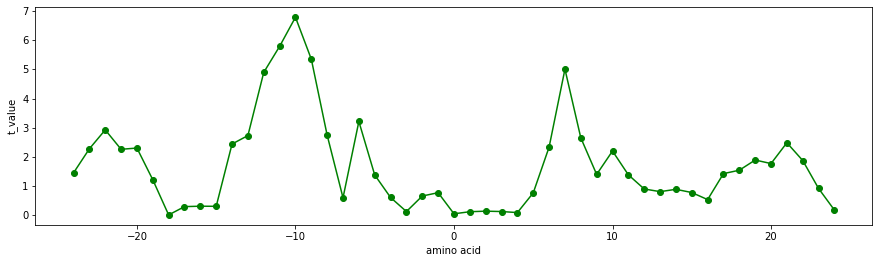

HUTJ700101
Heat capacity (Hutchens, 1970)


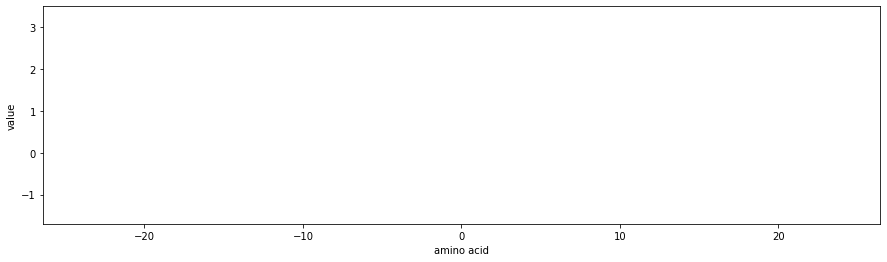

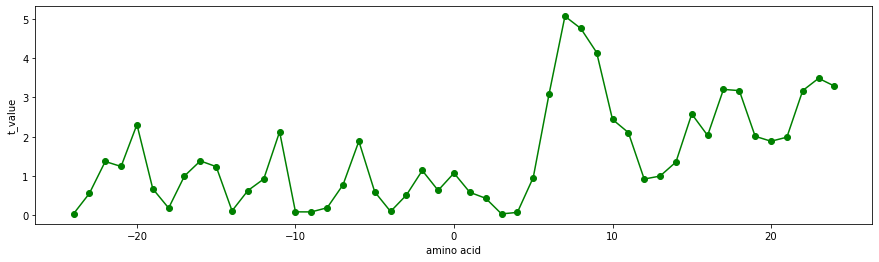

HUTJ700102
Absolute entropy (Hutchens, 1970)


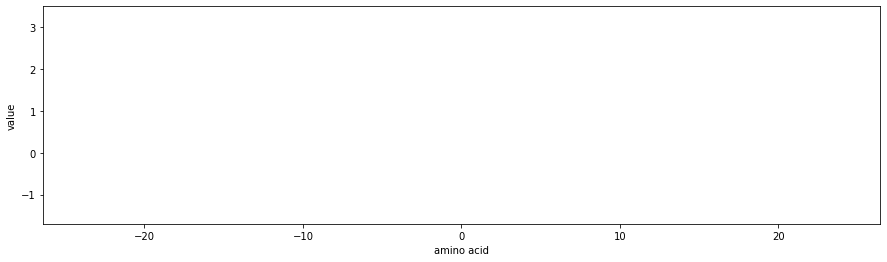

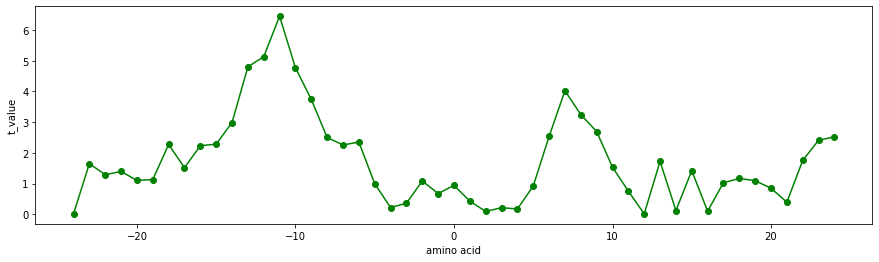

HUTJ700103
Entropy of formation (Hutchens, 1970)


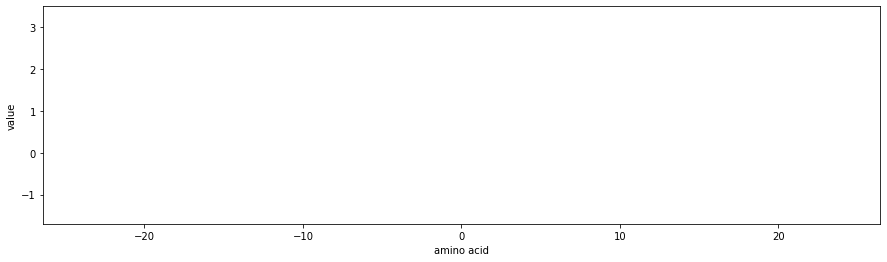

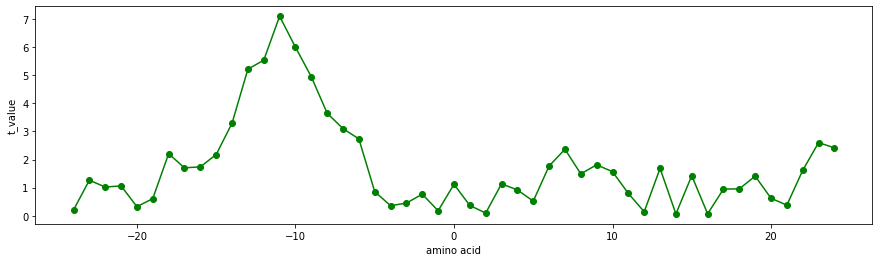

ISOY800101
Normalized relative frequency of alpha-helix (Isogai et al., 1980)


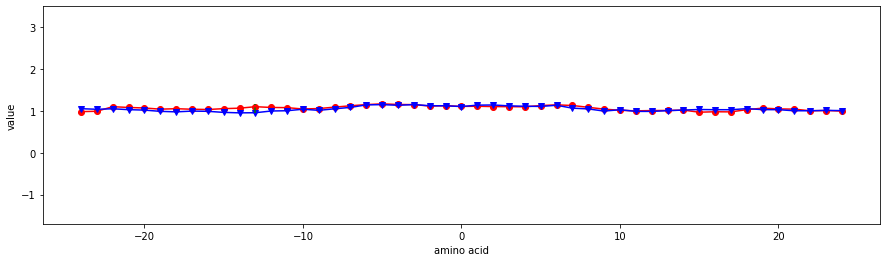

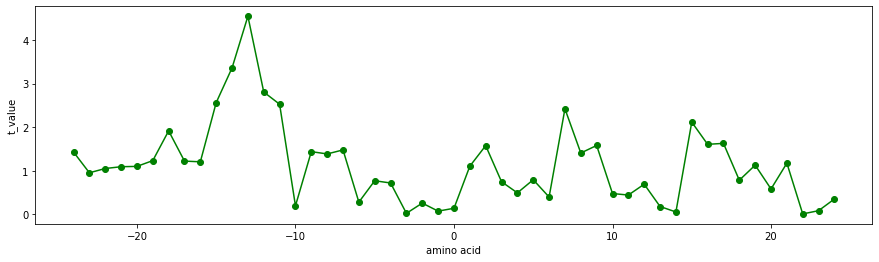

ISOY800105
Normalized relative frequency of bend S (Isogai et al., 1980)


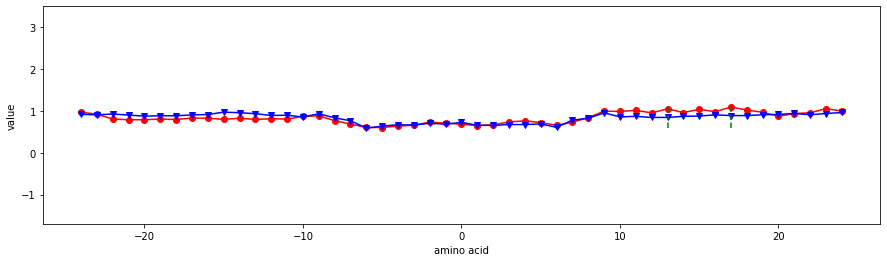

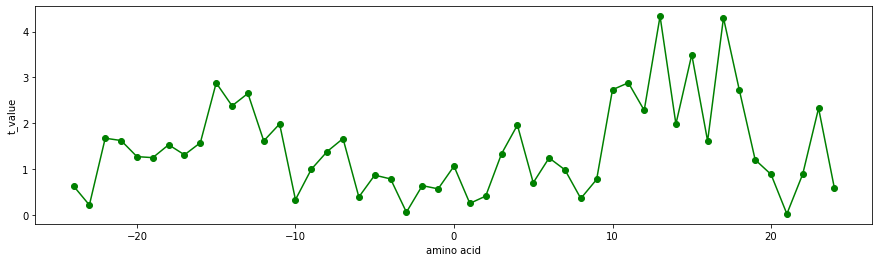

ISOY800108
Normalized relative frequency of coil (Isogai et al., 1980)


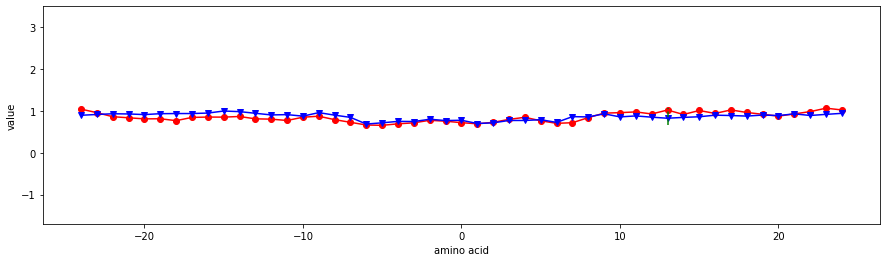

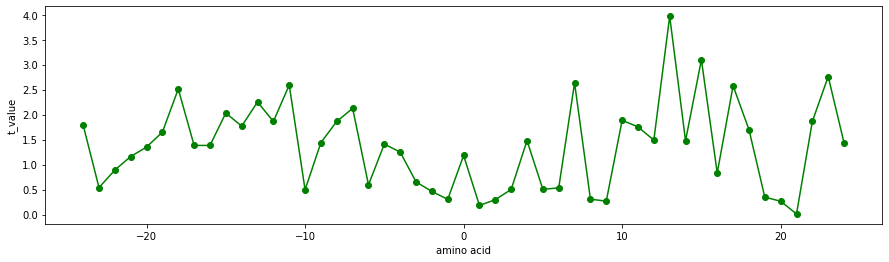

JANJ780101
Average accessible surface area (Janin et al., 1978)


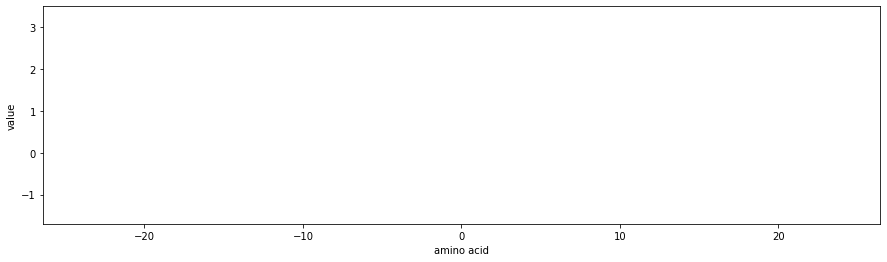

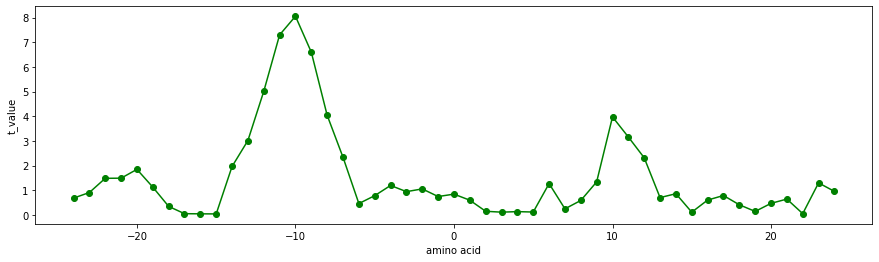

JANJ780102
Percentage of buried residues (Janin et al., 1978)


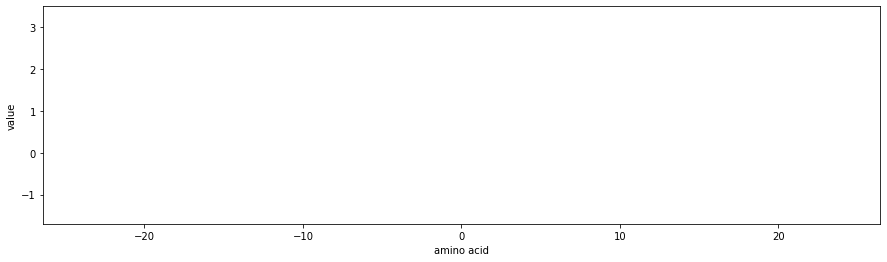

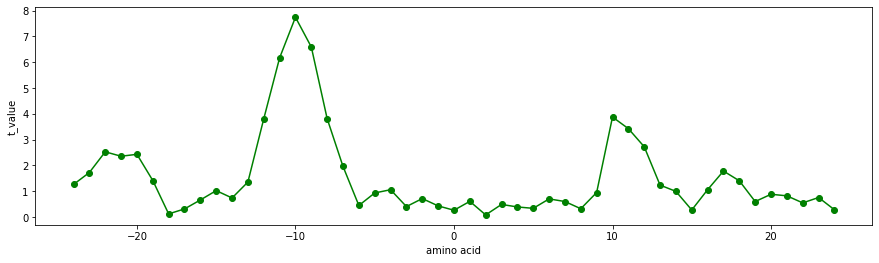

JANJ780103
Percentage of exposed residues (Janin et al., 1978)


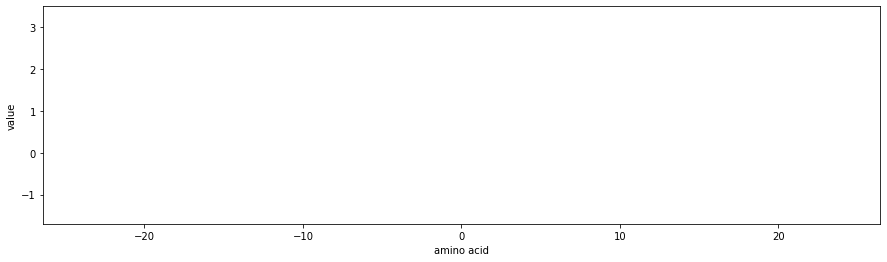

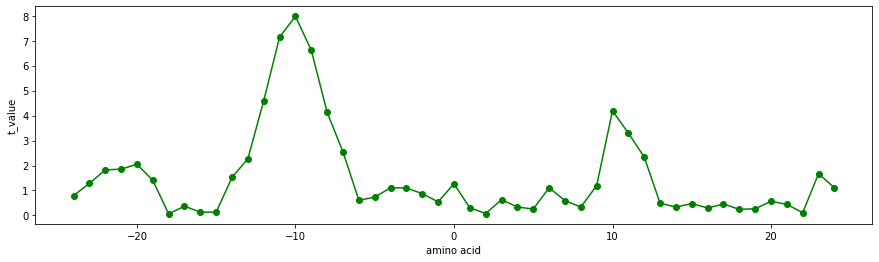

JANJ790101
Ratio of buried and accessible molar fractions (Janin, 1979)


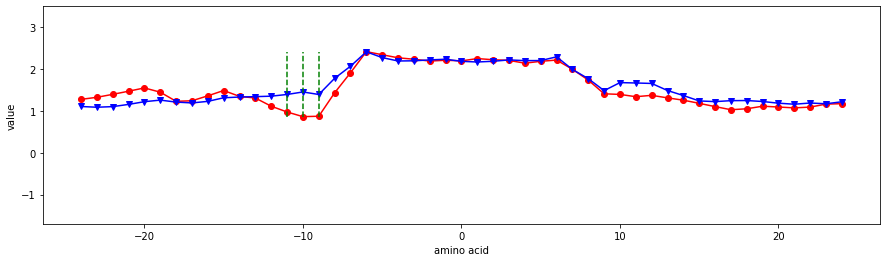

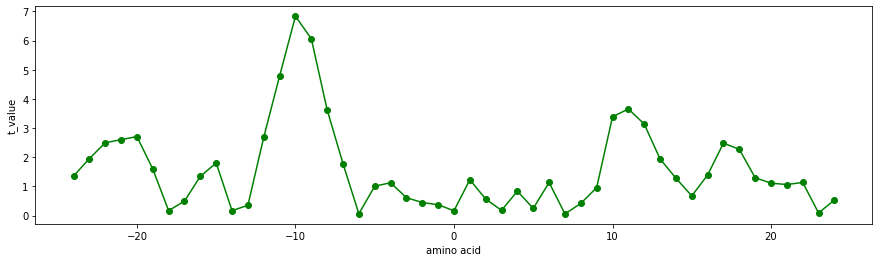

JANJ790102
Transfer free energy (Janin, 1979)


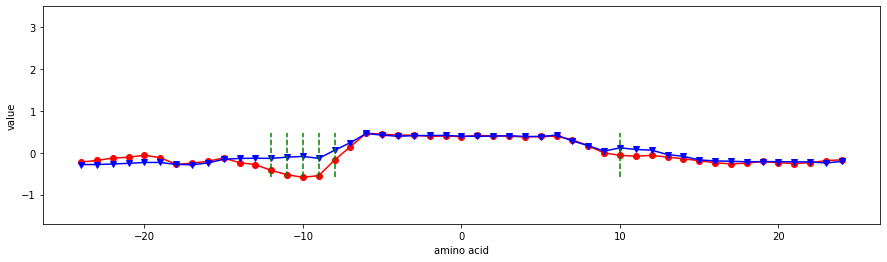

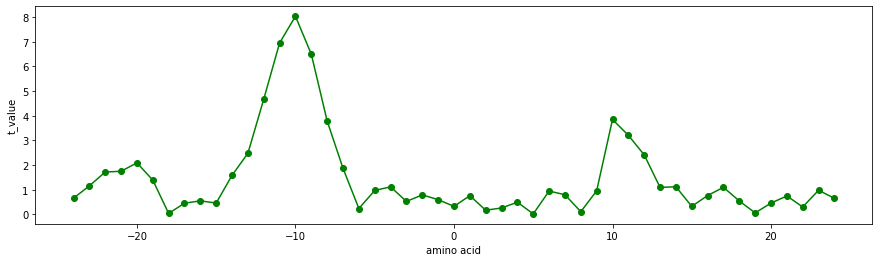

JOND750101
Hydrophobicity (Jones, 1975)


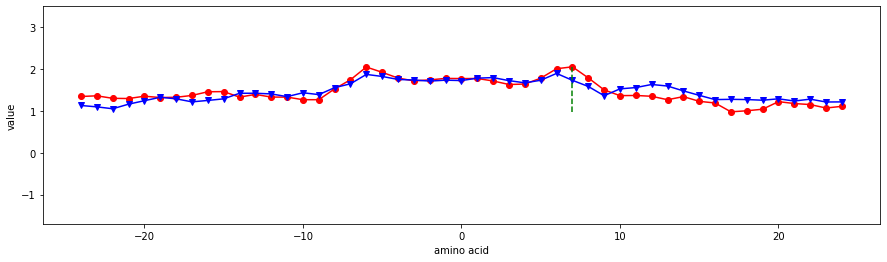

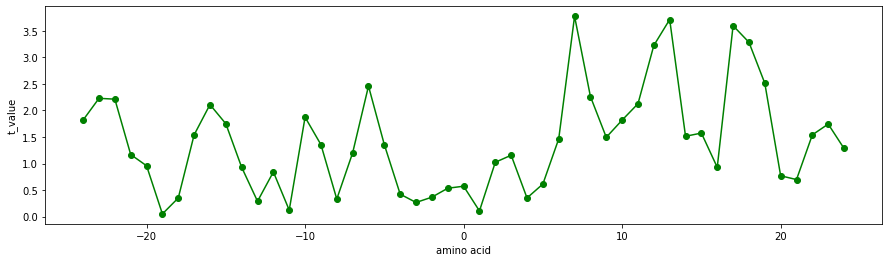

JOND750102
pK (-COOH) (Jones, 1975)


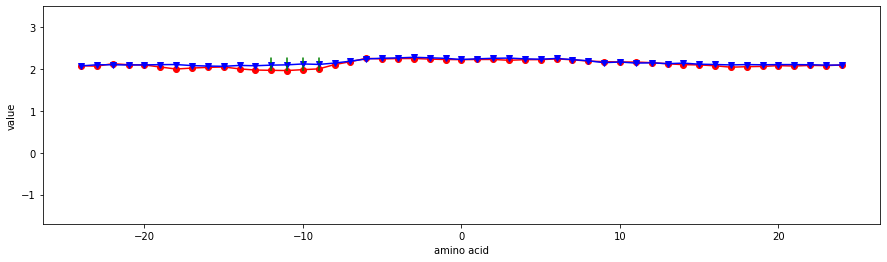

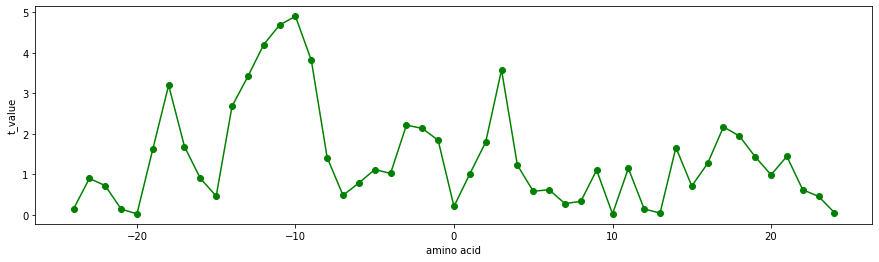

JOND920101
Relative frequency of occurrence (Jones et al., 1992)


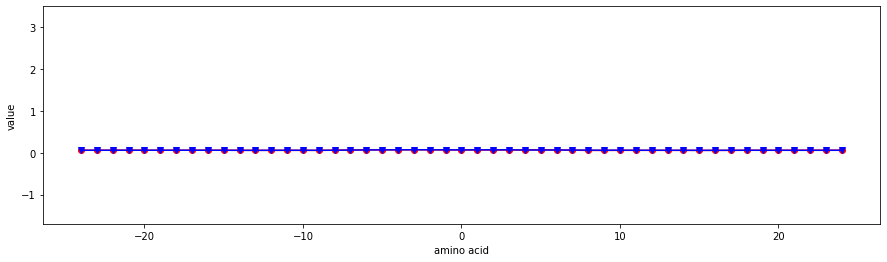

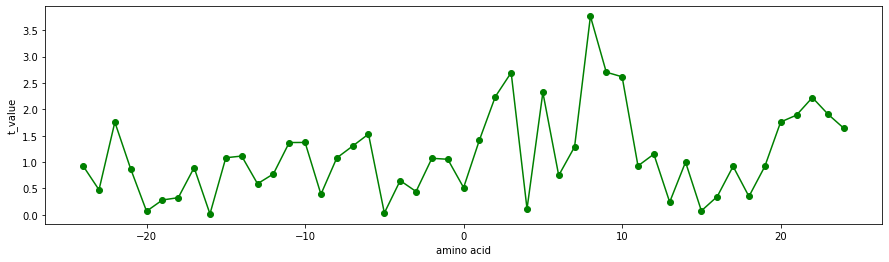

JOND920102
Relative mutability (Jones et al., 1992)


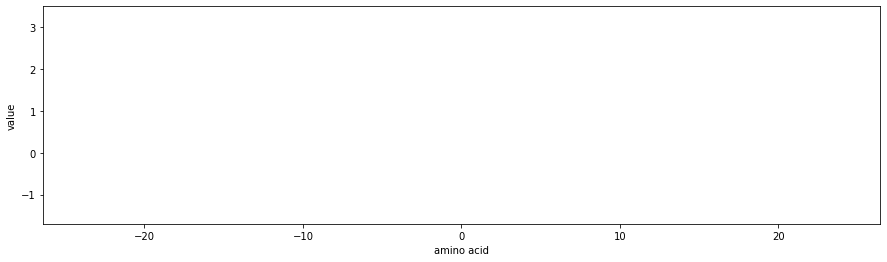

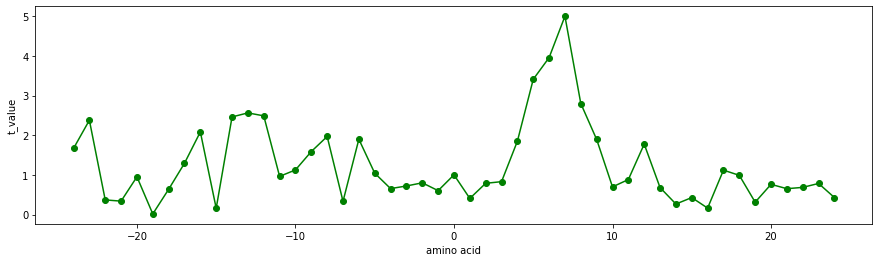

JUKT750101
Amino acid distribution (Jukes et al., 1975)


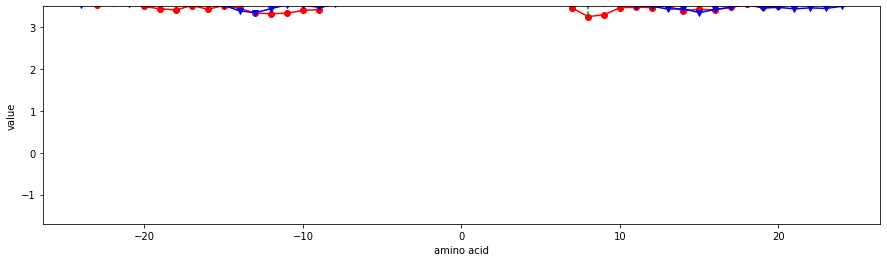

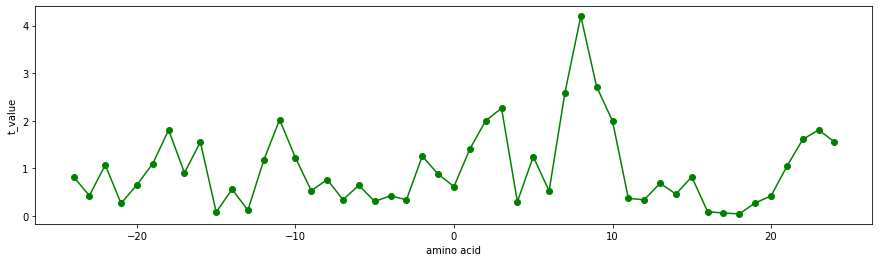

JUNJ780101
Sequence frequency (Jungck, 1978)


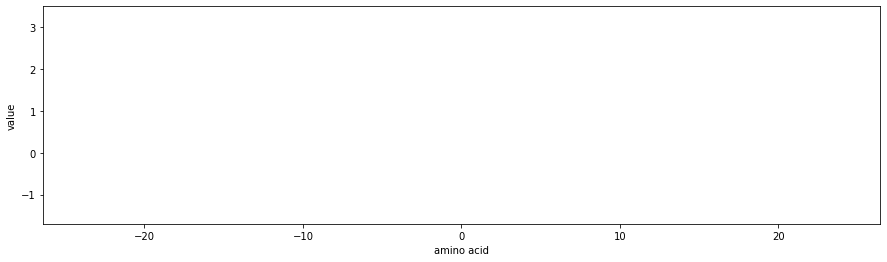

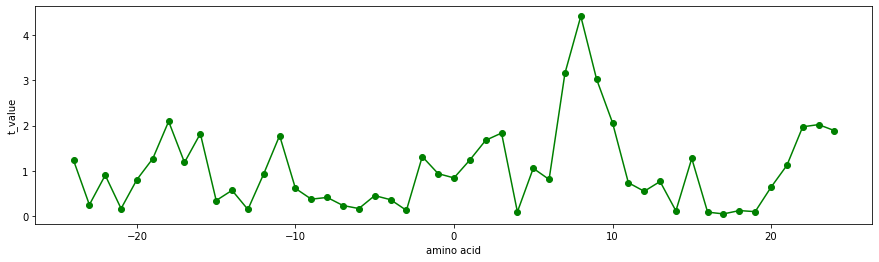

KANM800101
Average relative probability of helix (Kanehisa-Tsong, 1980)


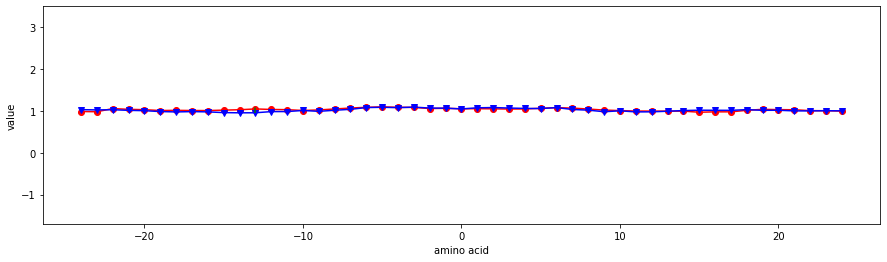

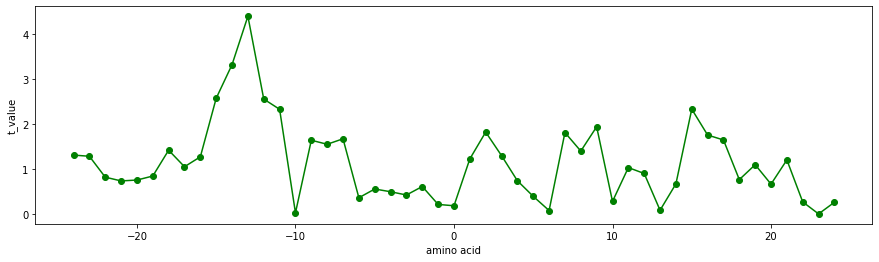

KANM800102
Average relative probability of beta-sheet (Kanehisa-Tsong, 1980)


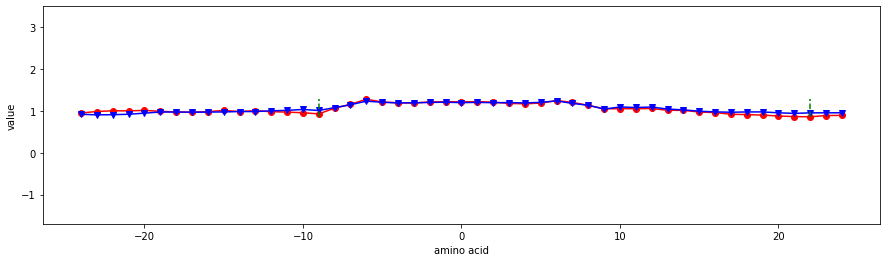

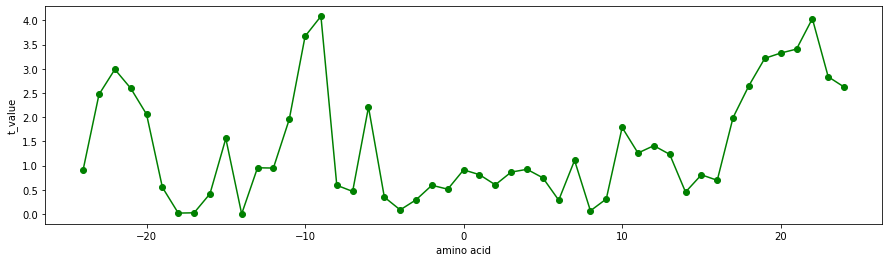

KANM800103
Average relative probability of inner helix (Kanehisa-Tsong, 1980)


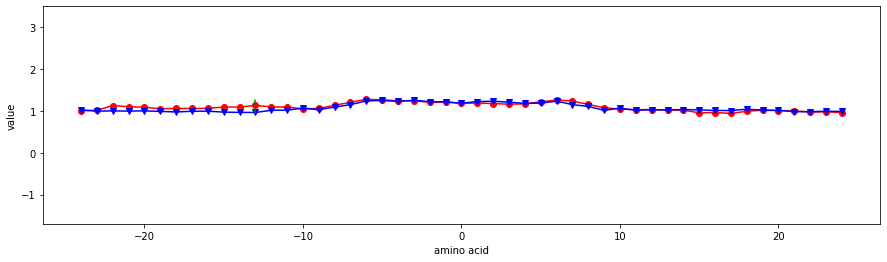

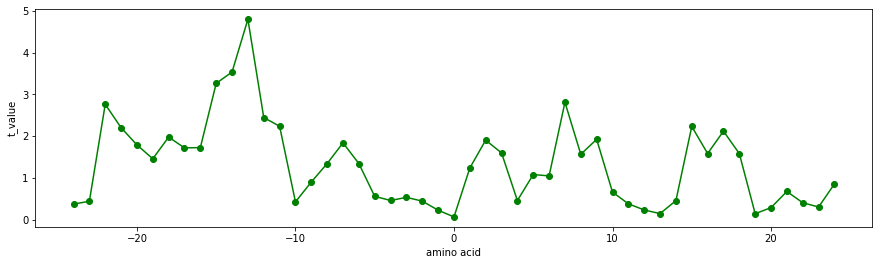

KARP850101
Flexibility parameter for no rigid neighbors (Karplus-Schulz, 1985)


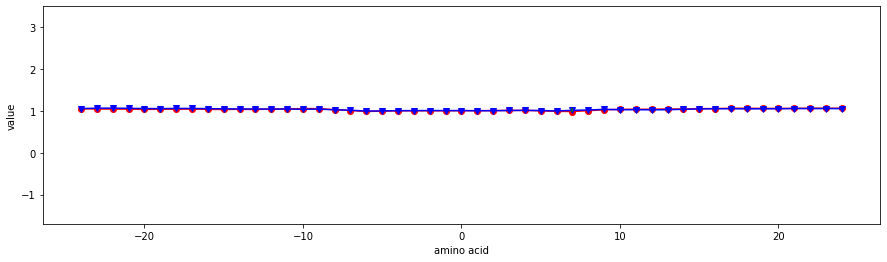

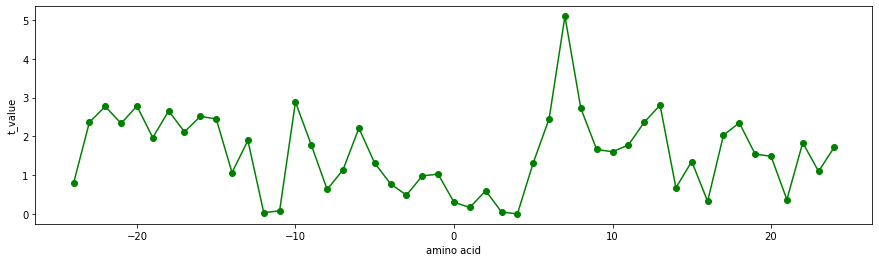

KARP850102
Flexibility parameter for one rigid neighbor (Karplus-Schulz, 1985)


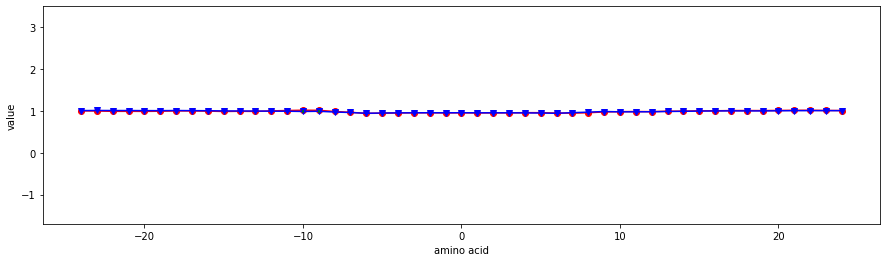

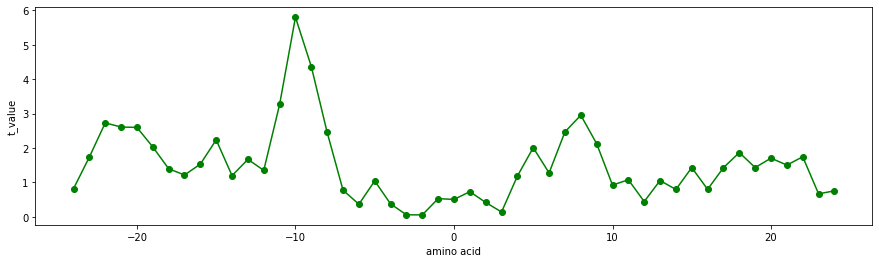

KARP850103
Flexibility parameter for two rigid neighbors (Karplus-Schulz, 1985)


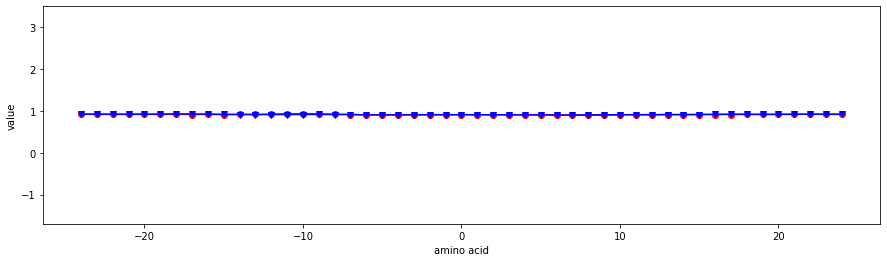

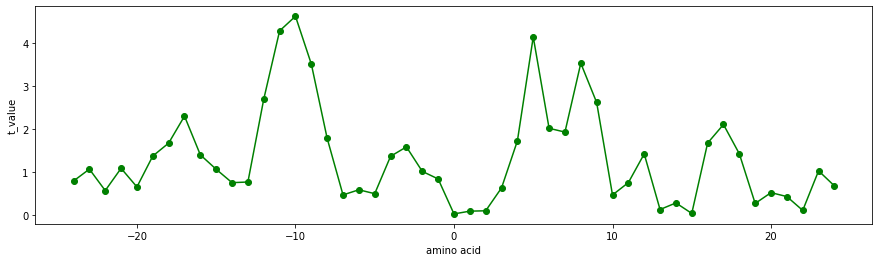

KLEP840101
Net charge (Klein et al., 1984)


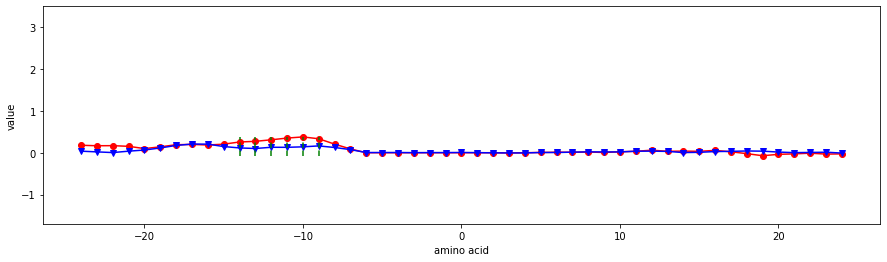

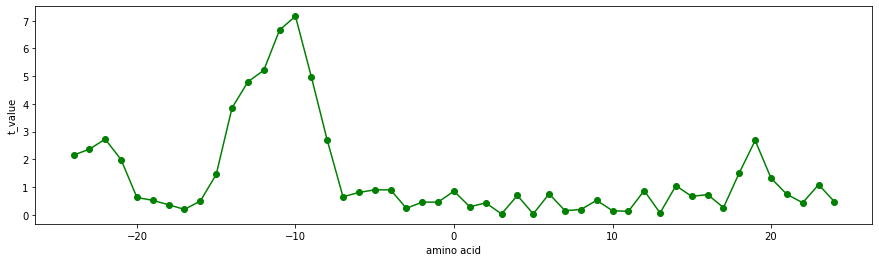

KRIW710101
Side chain interaction parameter (Krigbaum-Rubin, 1971)


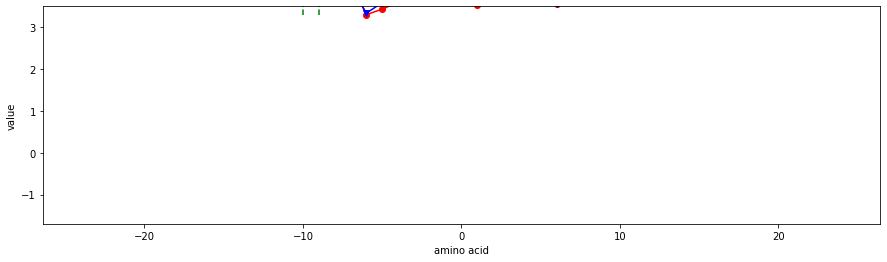

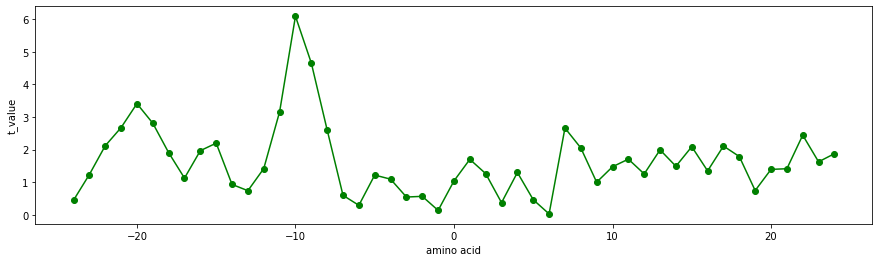

KRIW790101
Side chain interaction parameter (Krigbaum-Komoriya, 1979)


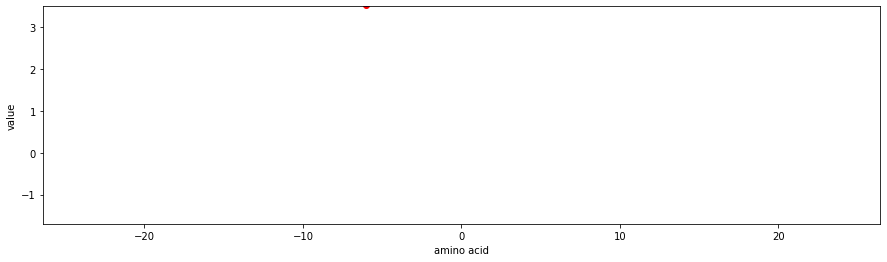

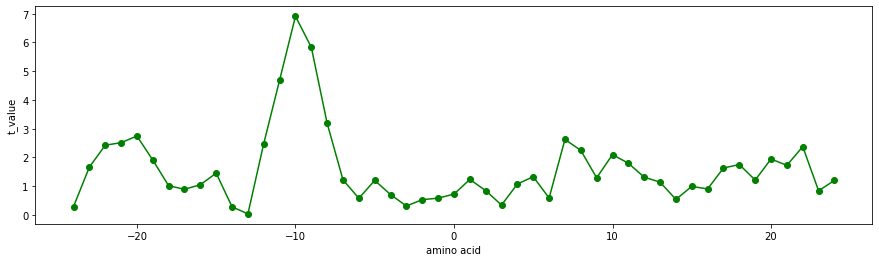

KRIW790102
Fraction of site occupied by water (Krigbaum-Komoriya, 1979)


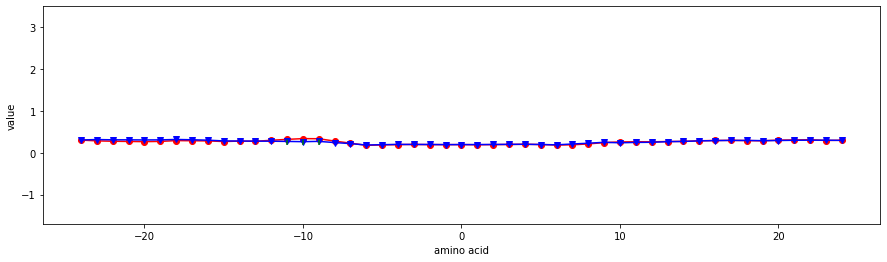

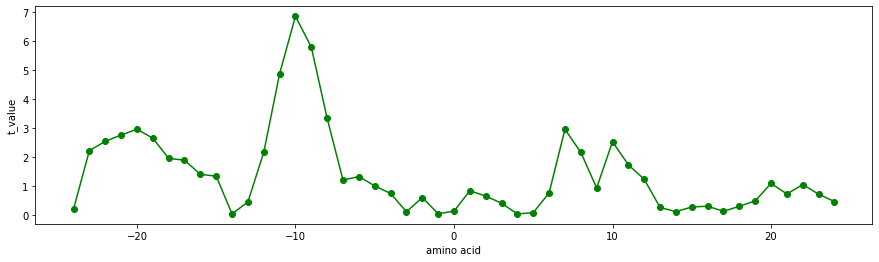

KRIW790103
Side chain volume (Krigbaum-Komoriya, 1979)


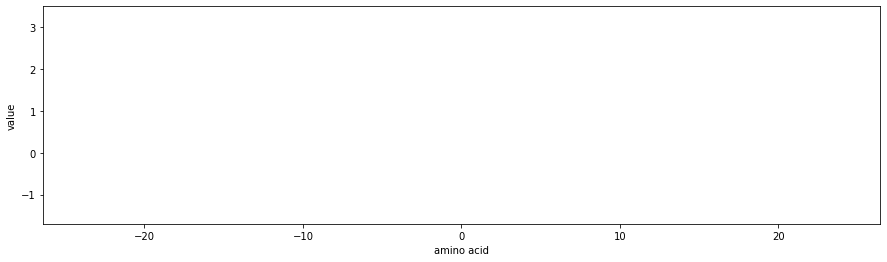

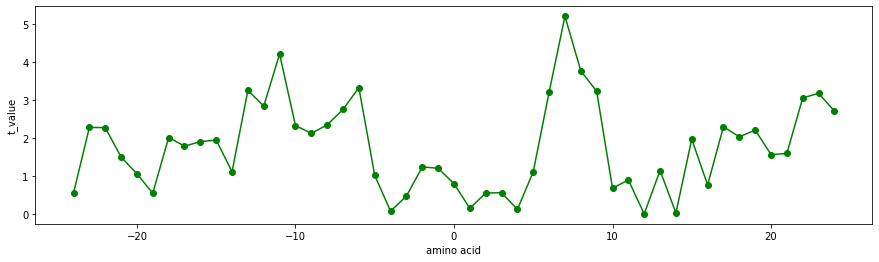

KYTJ820101
Hydropathy index (Kyte-Doolittle, 1982)


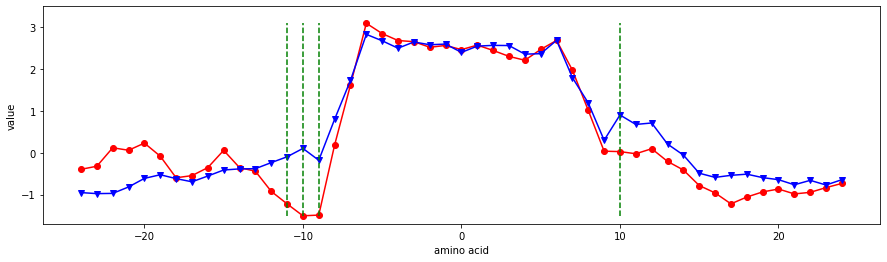

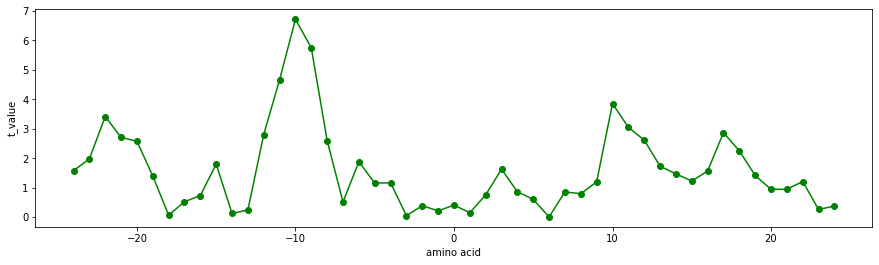

LAWE840101
Transfer free energy, CHP/water (Lawson et al., 1984)


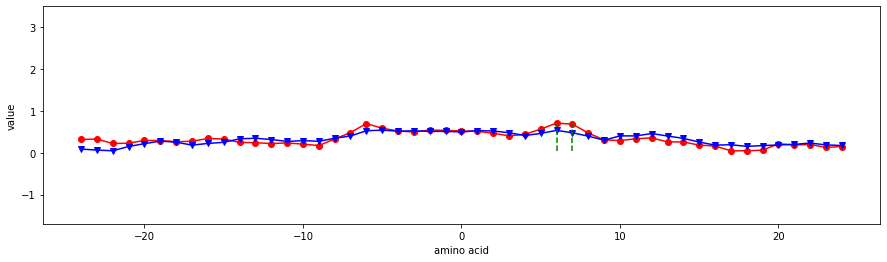

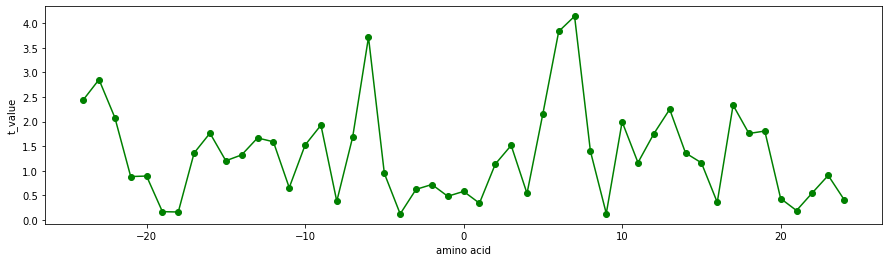

LEVM760101
Hydrophobic parameter (Levitt, 1976)


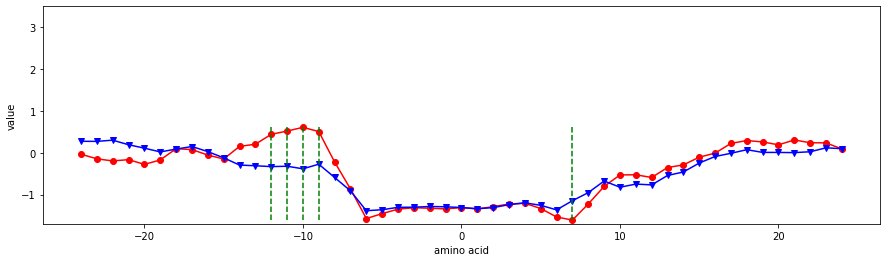

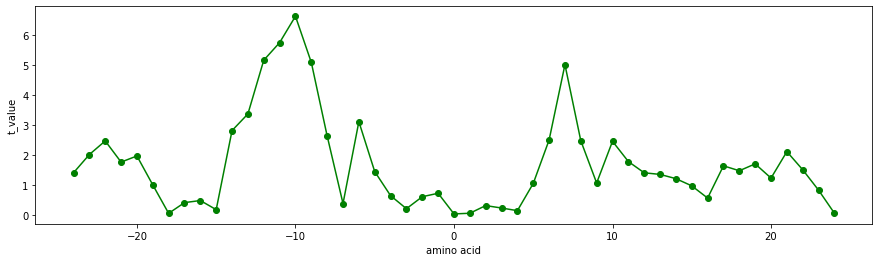

LEVM760102
Distance between C-alpha and centroid of side chain (Levitt, 1976)


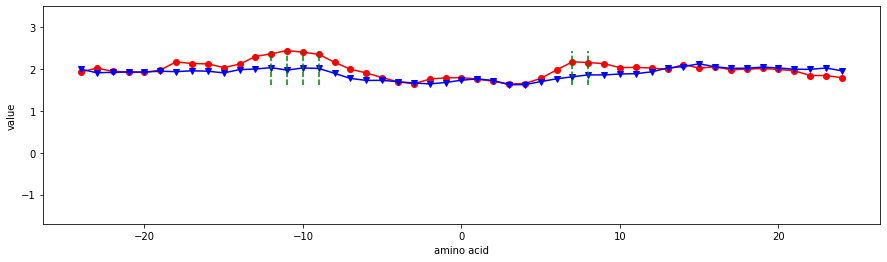

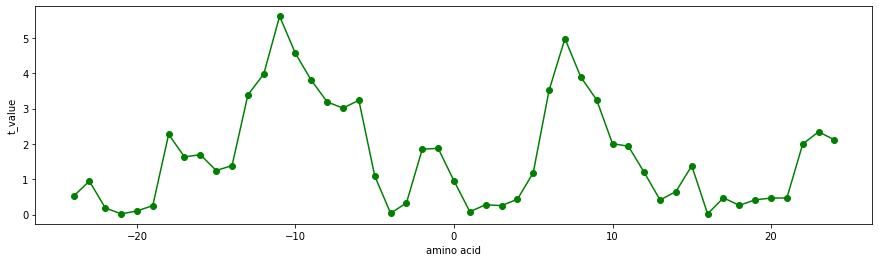

LEVM760104
Side chain torsion angle phi(AAAR) (Levitt, 1976)


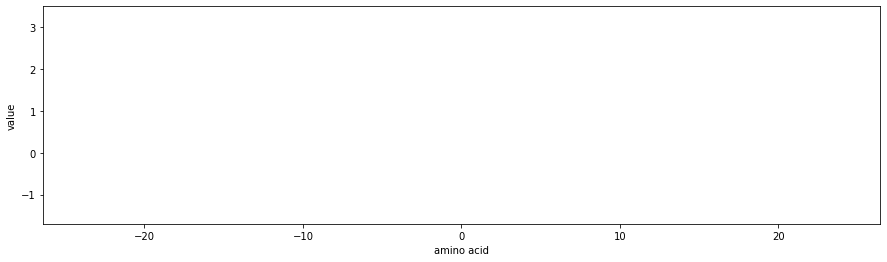

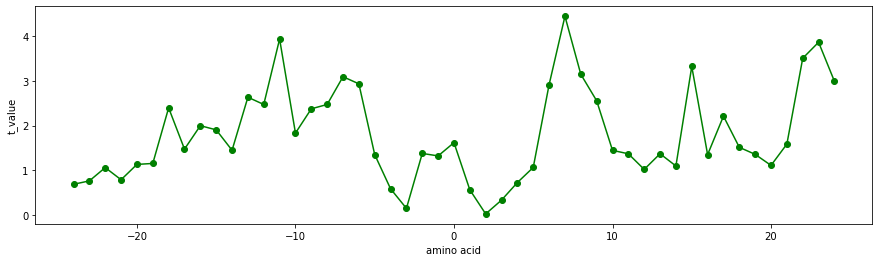

LEVM760105
Radius of gyration of side chain (Levitt, 1976)


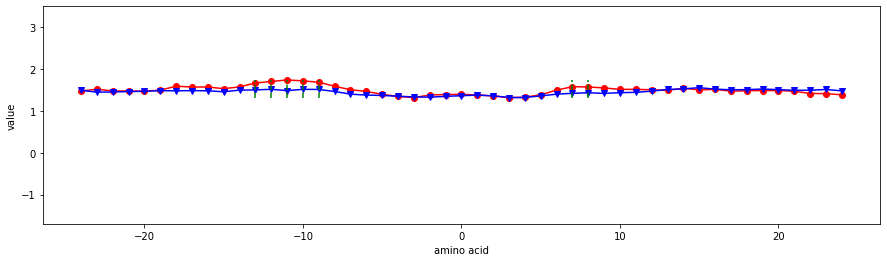

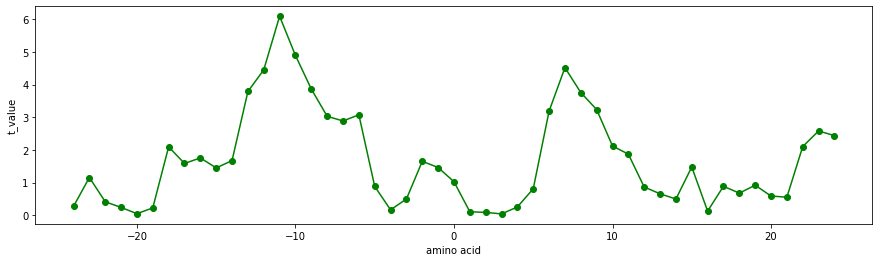

LEVM760106
van der Waals parameter R0 (Levitt, 1976)


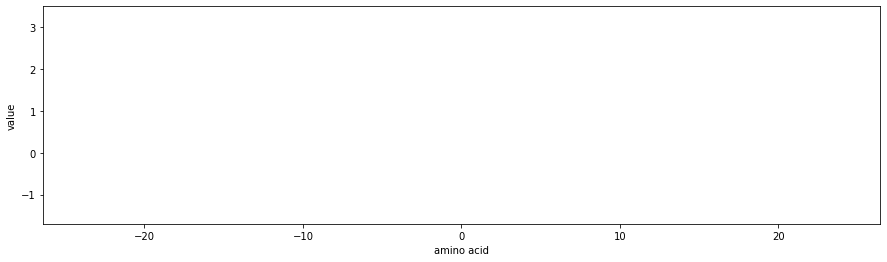

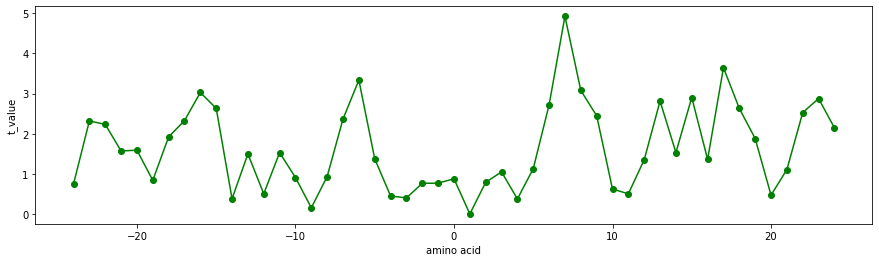

LEVM760107
van der Waals parameter epsilon (Levitt, 1976)


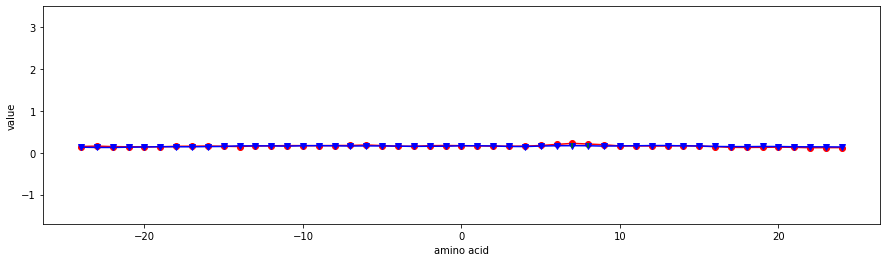

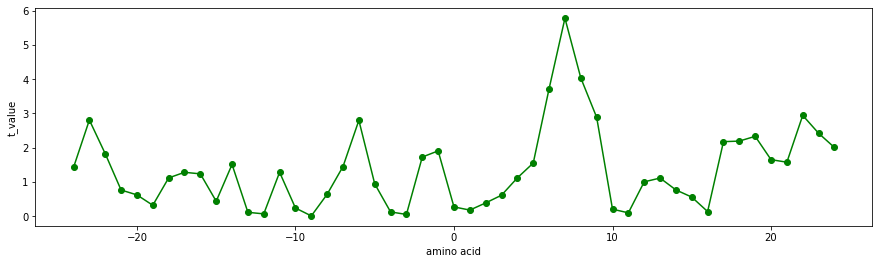

LEVM780103
Normalized frequency of reverse turn, with weights (Levitt, 1978)


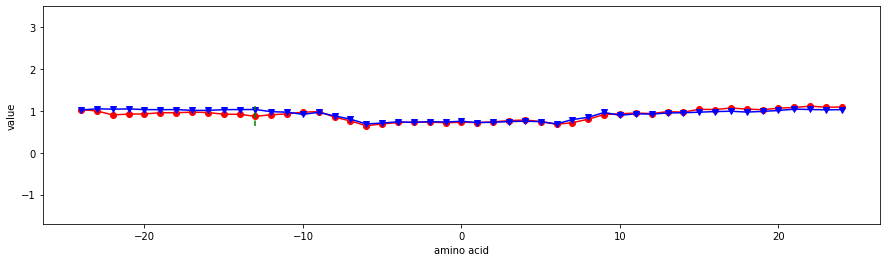

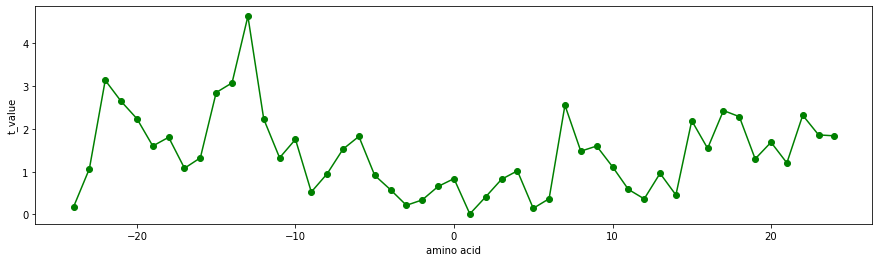

LEVM780104
Normalized frequency of alpha-helix, unweighted (Levitt, 1978)


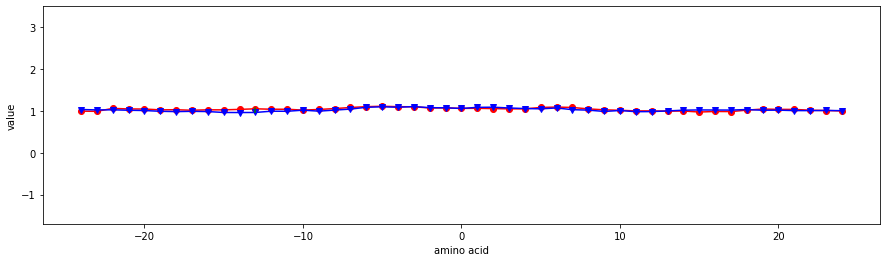

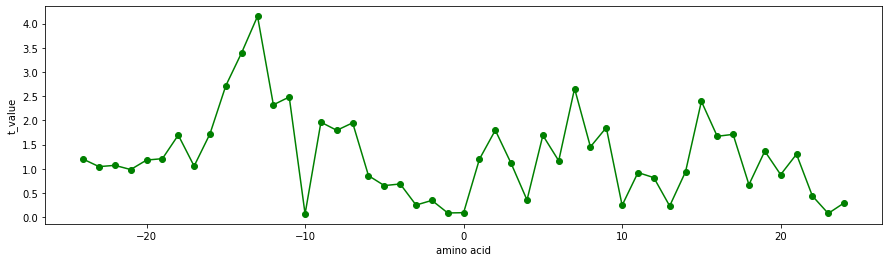

LEVM780105
Normalized frequency of beta-sheet, unweighted (Levitt, 1978)


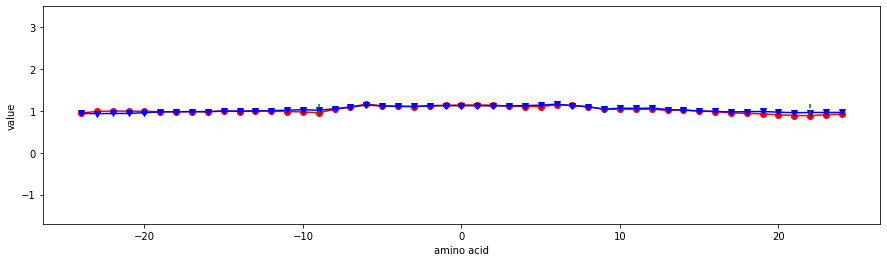

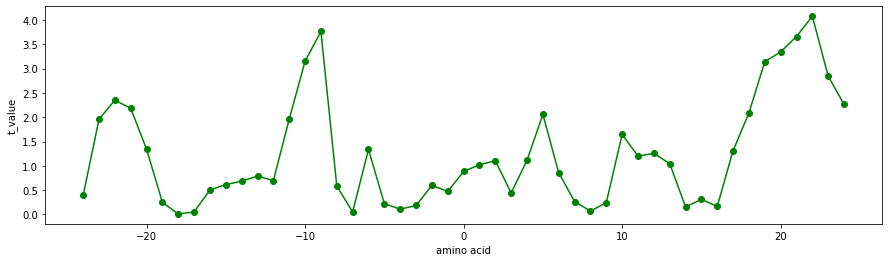

LEVM780106
Normalized frequency of reverse turn, unweighted (Levitt, 1978)


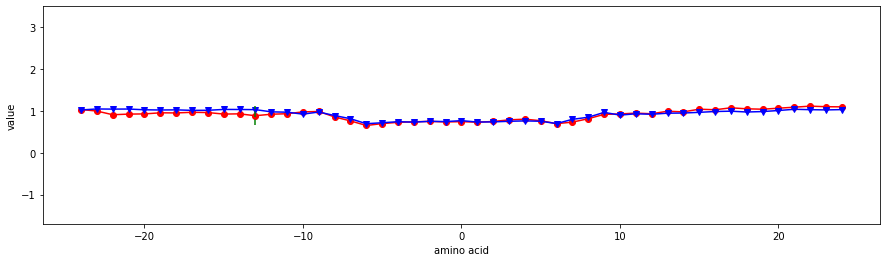

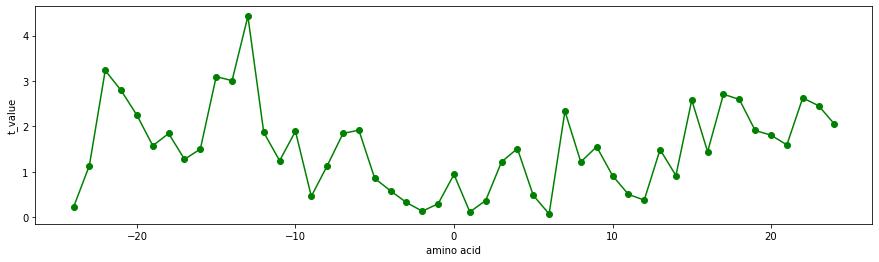

LEWP710101
Frequency of occurrence in beta-bends (Lewis et al., 1971)


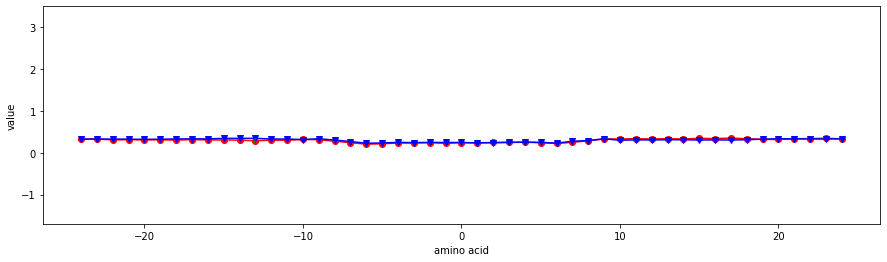

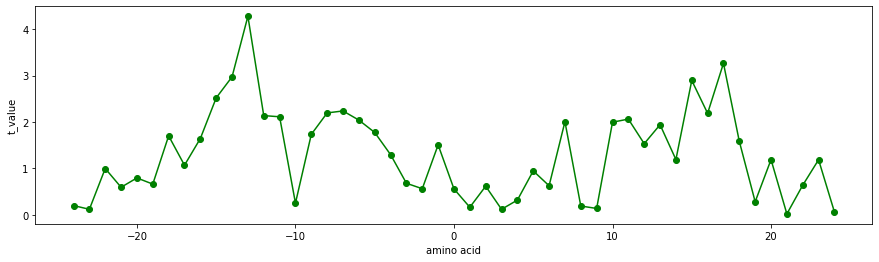

LIFS790101
Conformational preference for all beta-strands (Lifson-Sander, 1979)


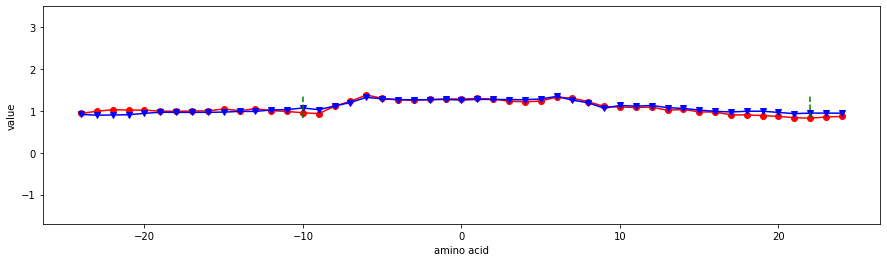

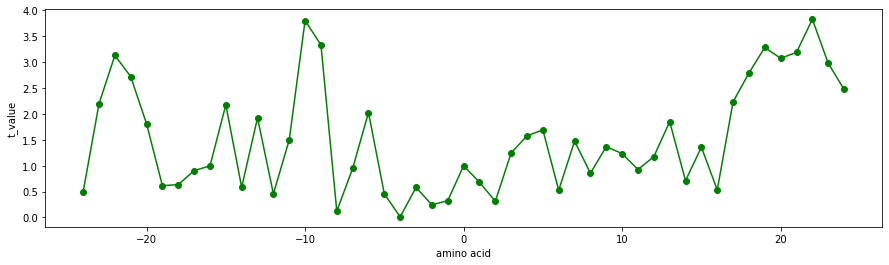

LIFS790102
Conformational preference for parallel beta-strands (Lifson-Sander, 1979)


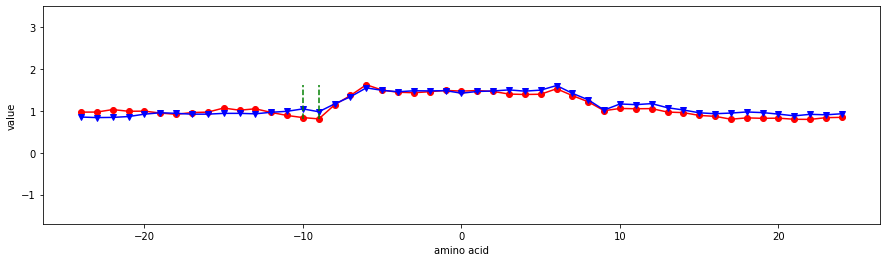

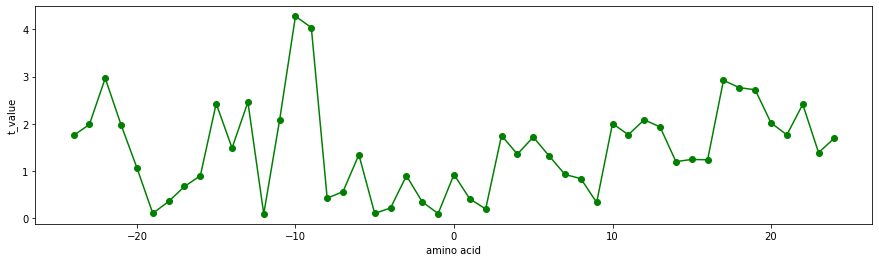

LIFS790103
Conformational preference for antiparallel beta-strands (Lifson-Sander, 1979)


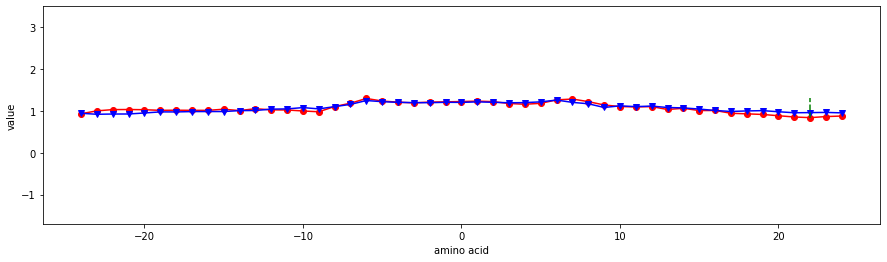

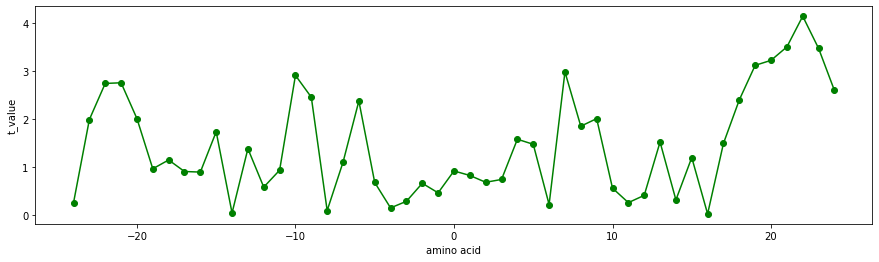

MANP780101
Average surrounding hydrophobicity (Manavalan-Ponnuswamy, 1978)


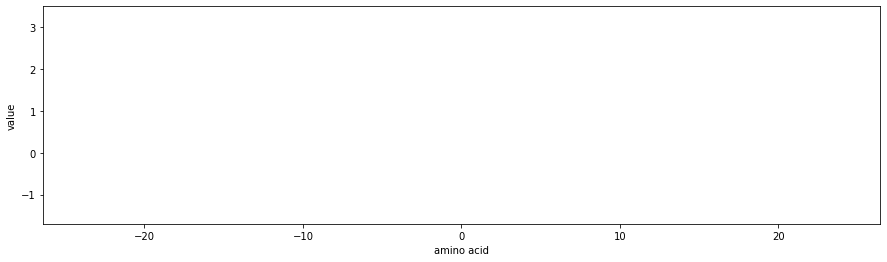

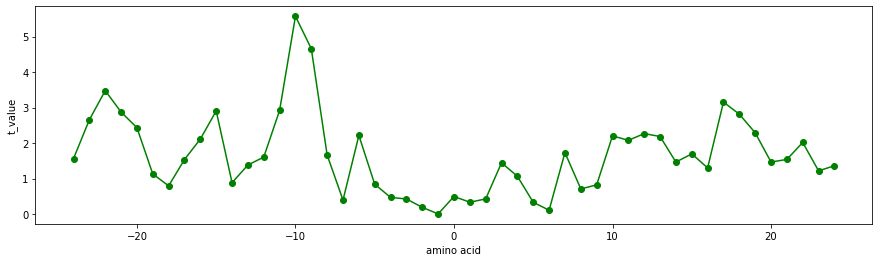

MAXF760101
Normalized frequency of alpha-helix (Maxfield-Scheraga, 1976)


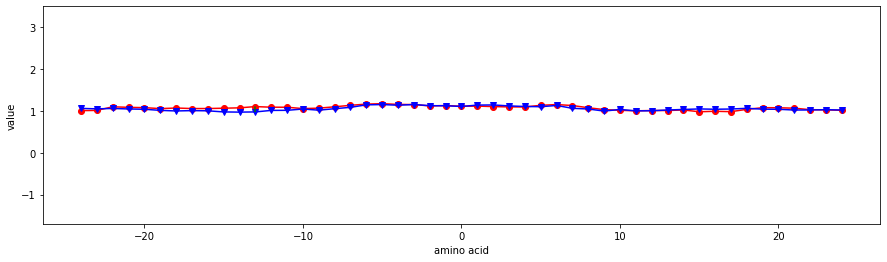

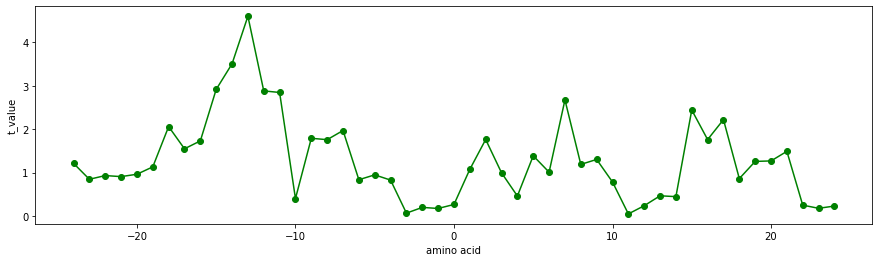

MAXF760103
Normalized frequency of zeta R (Maxfield-Scheraga, 1976)


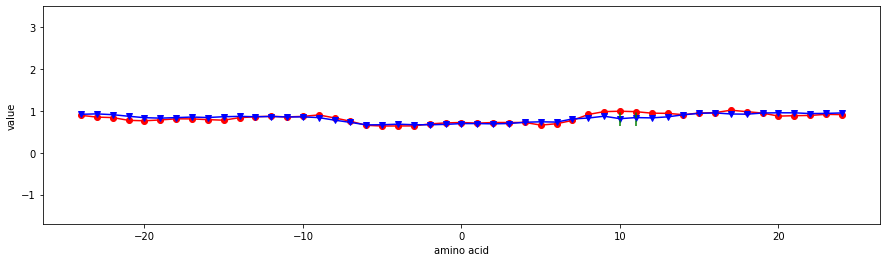

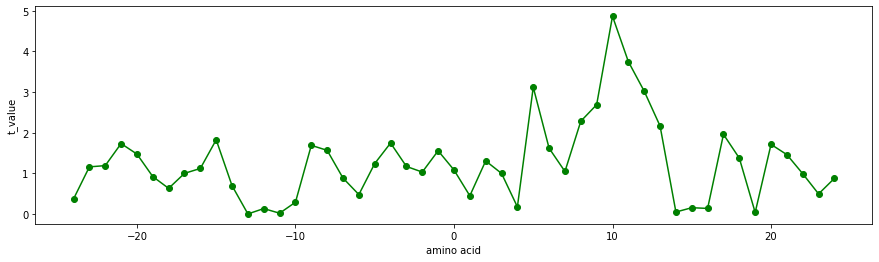

MCMT640101
Refractivity (McMeekin et al., 1964), Cited by Jones (1975)


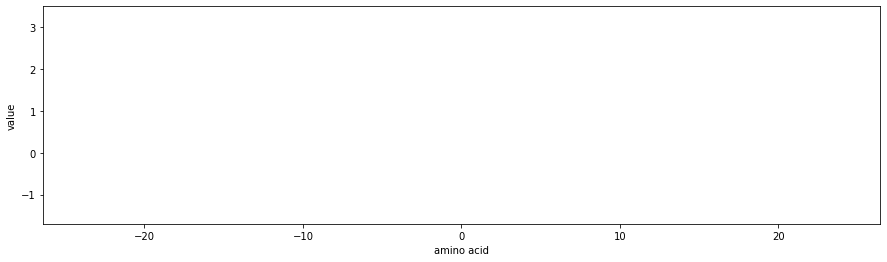

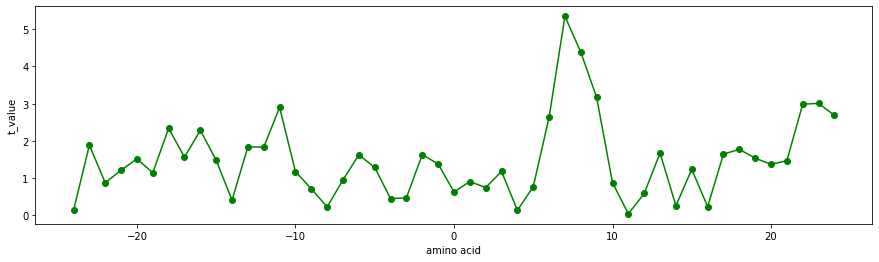

MEEJ800101
Retention coefficient in HPLC, pH7.4 (Meek, 1980)


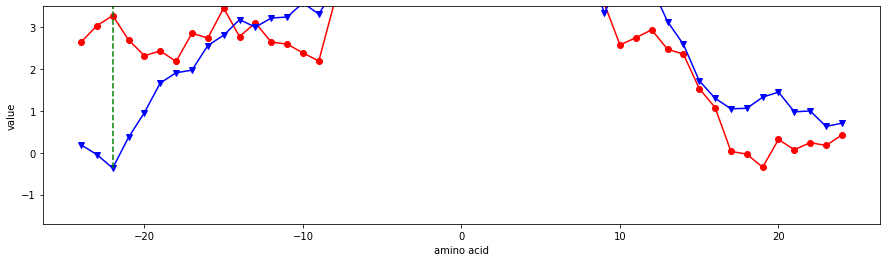

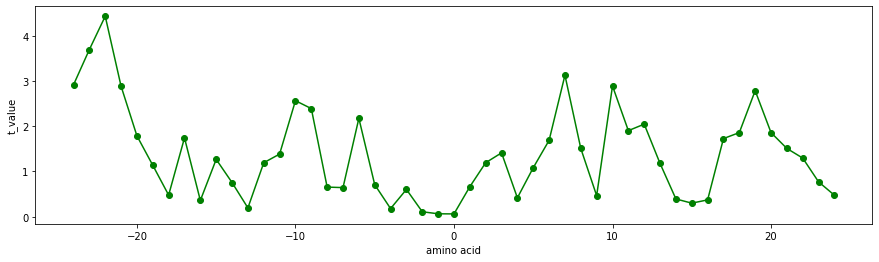

MEEJ800102
Retention coefficient in HPLC, pH2.1 (Meek, 1980)


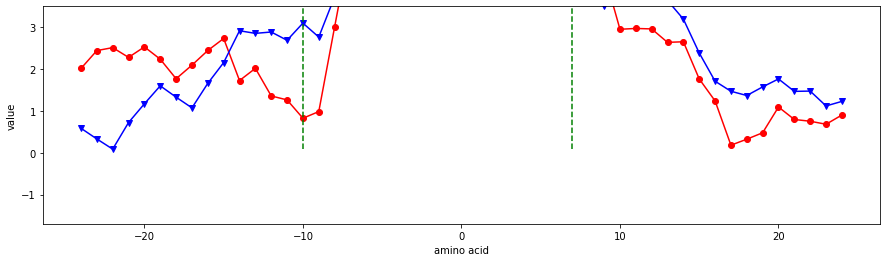

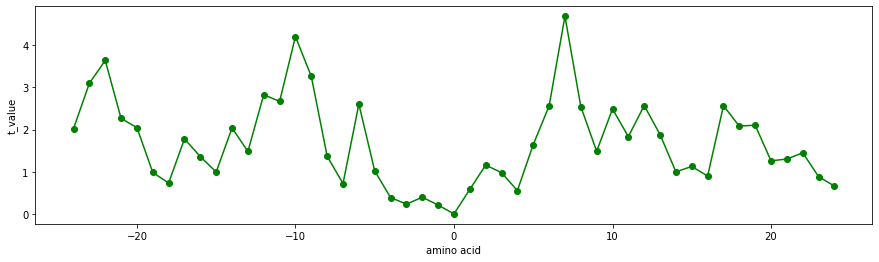

MEEJ810101
Retention coefficient in NaClO4 (Meek-Rossetti, 1981)


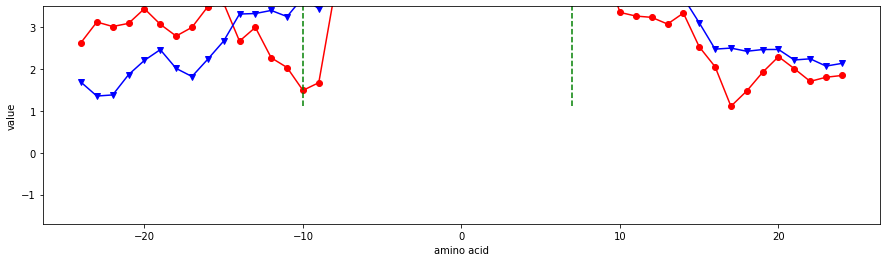

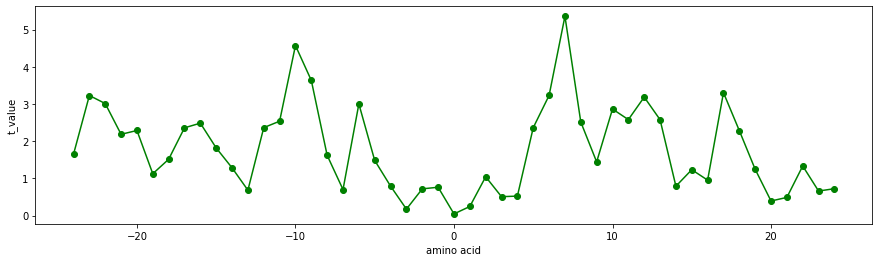

MEEJ810102
Retention coefficient in NaH2PO4 (Meek-Rossetti, 1981)


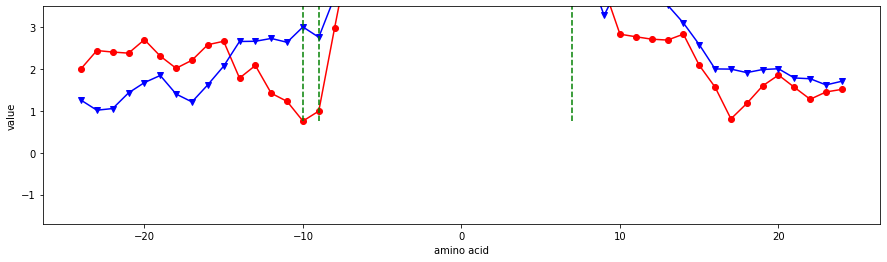

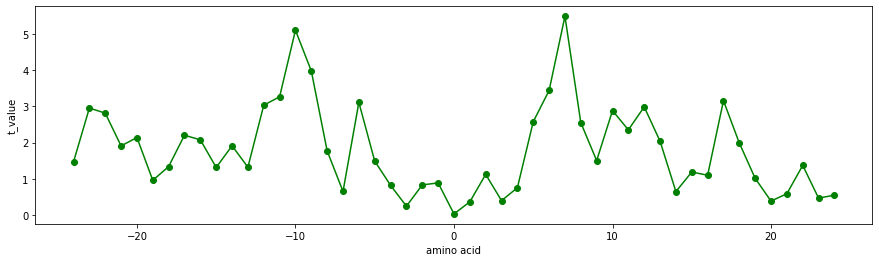

MEIH800101
Average reduced distance for C-alpha (Meirovitch et al., 1980)


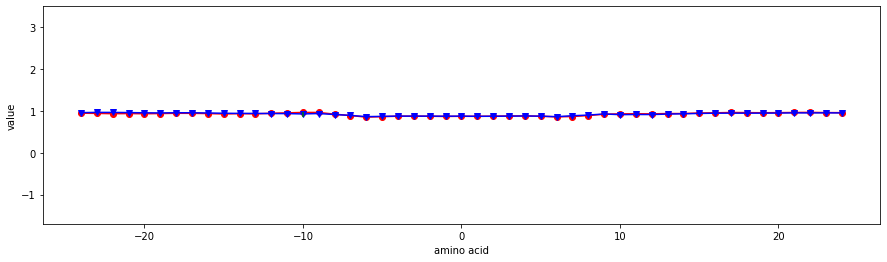

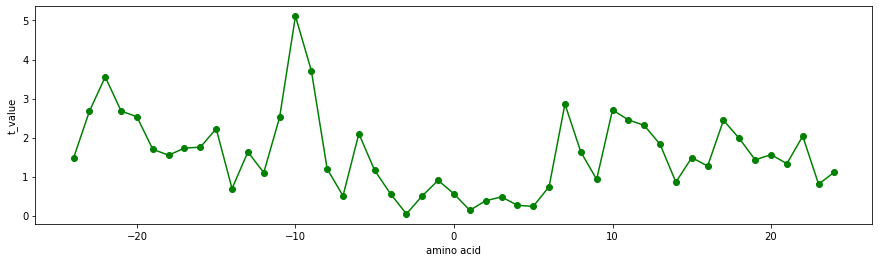

MEIH800102
Average reduced distance for side chain (Meirovitch et al., 1980)


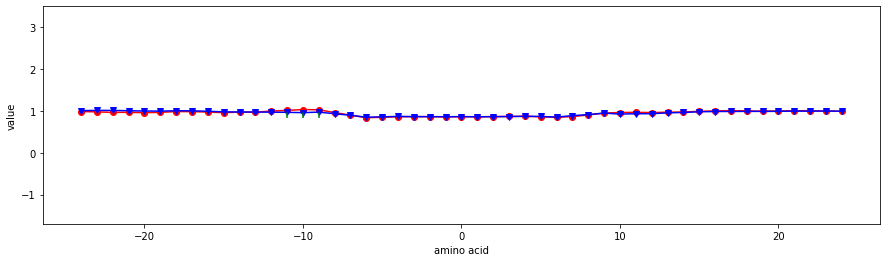

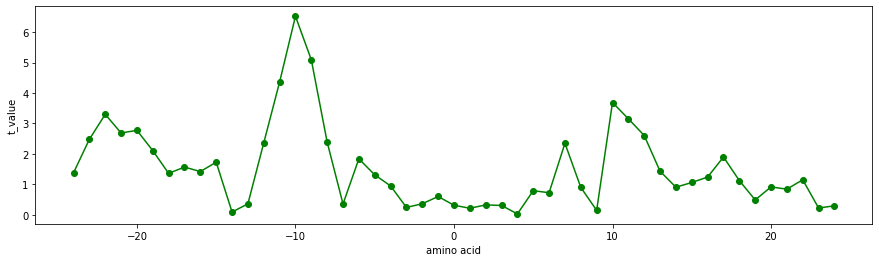

MEIH800103
Average side chain orientation angle (Meirovitch et al., 1980)


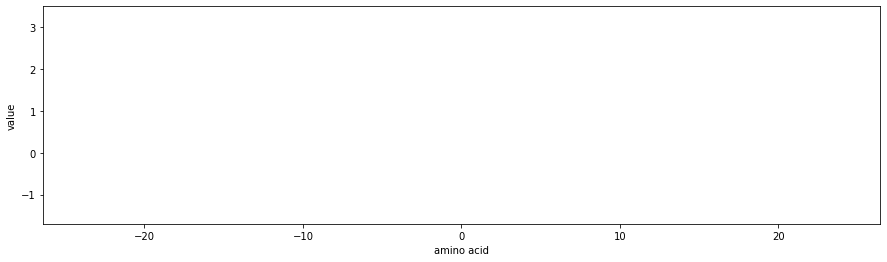

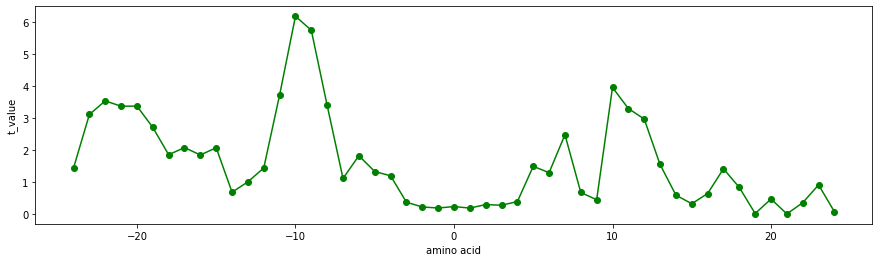

MIYS850101
Effective partition energy (Miyazawa-Jernigan, 1985)


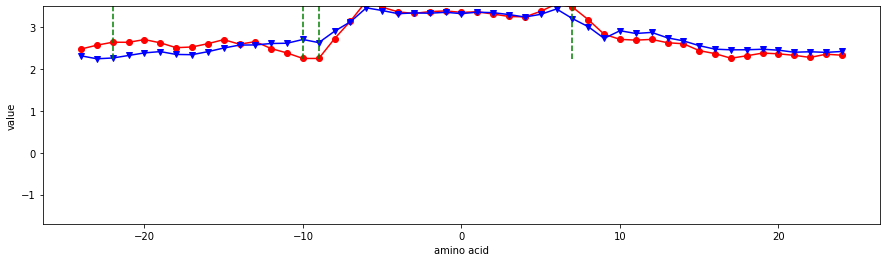

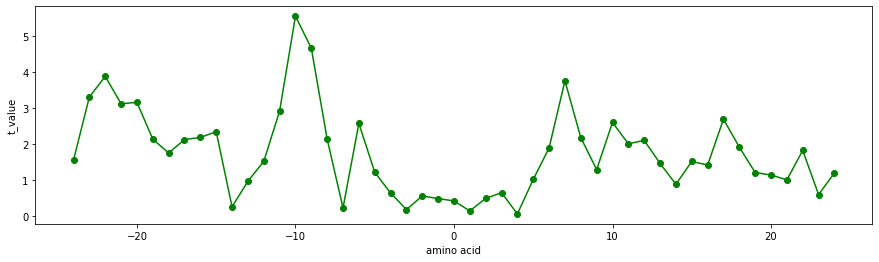

NAGK730102
Normalized frequency of bata-structure (Nagano, 1973)


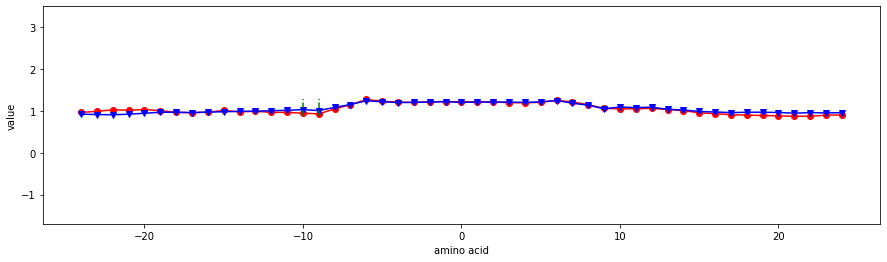

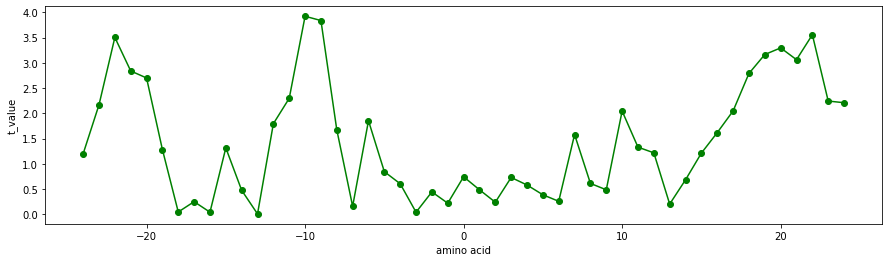

NAKH900101
AA composition of total proteins (Nakashima et al., 1990)


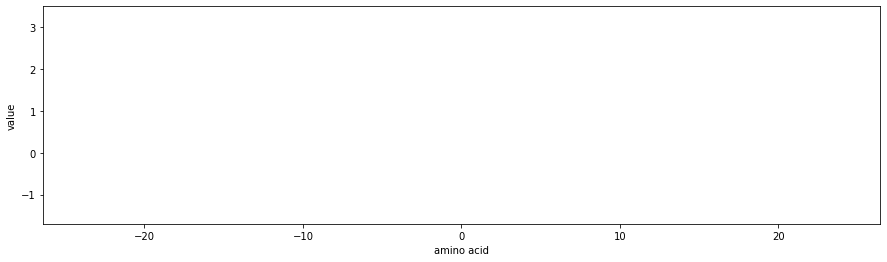

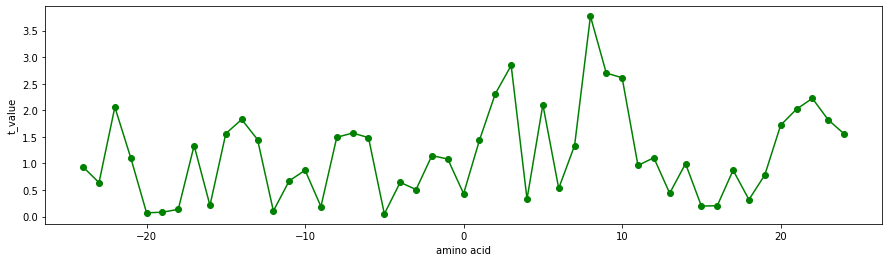

NAKH900102
SD of AA composition of total proteins (Nakashima et al., 1990)


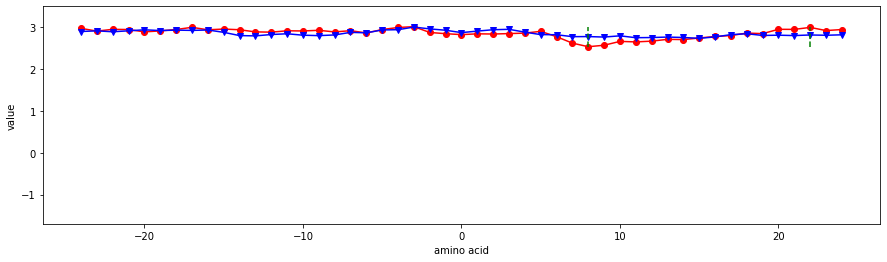

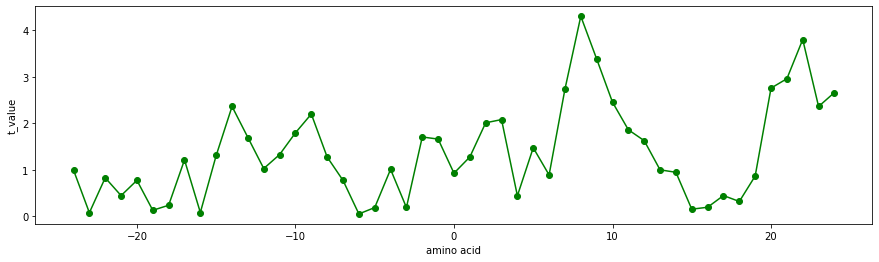

NAKH900103
AA composition of mt-proteins (Nakashima et al., 1990)


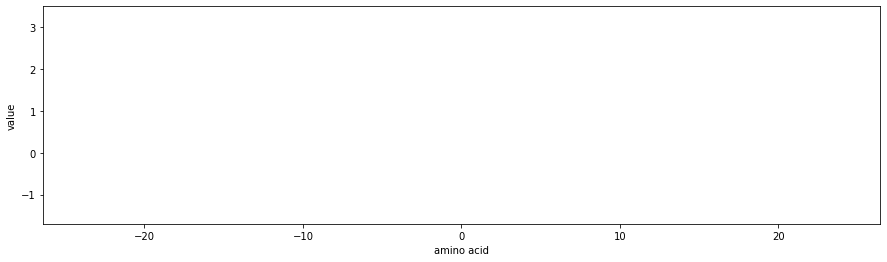

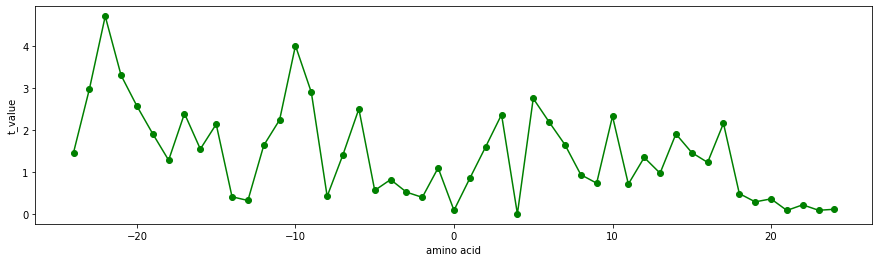

NAKH900104
Normalized composition of mt-proteins (Nakashima et al., 1990)


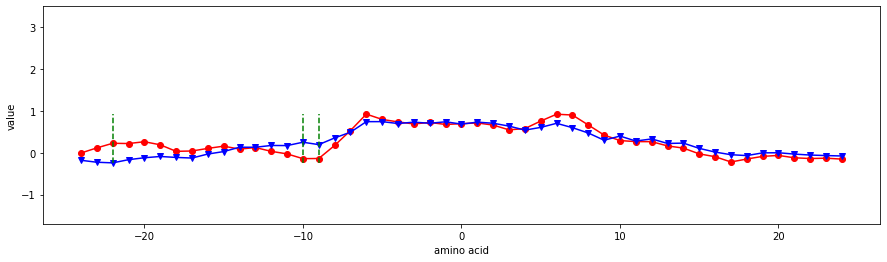

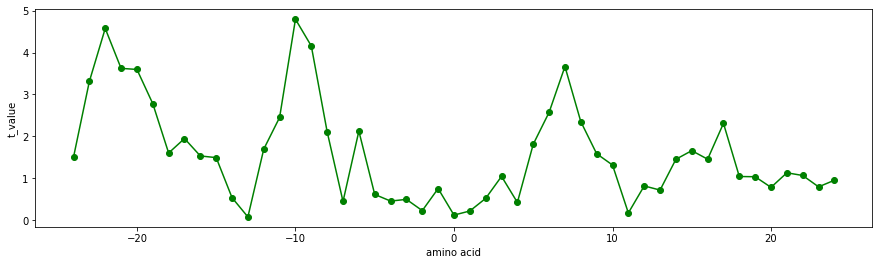

NAKH900105
AA composition of mt-proteins from animal (Nakashima et al., 1990)


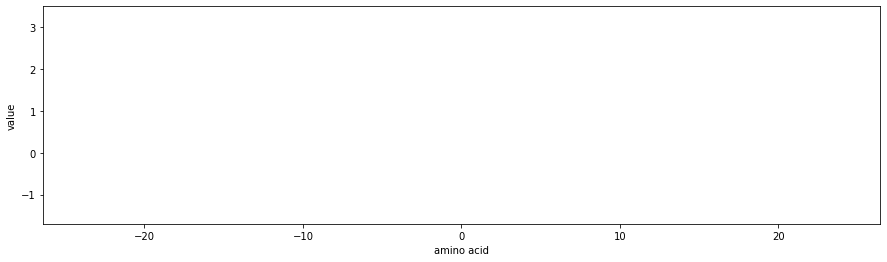

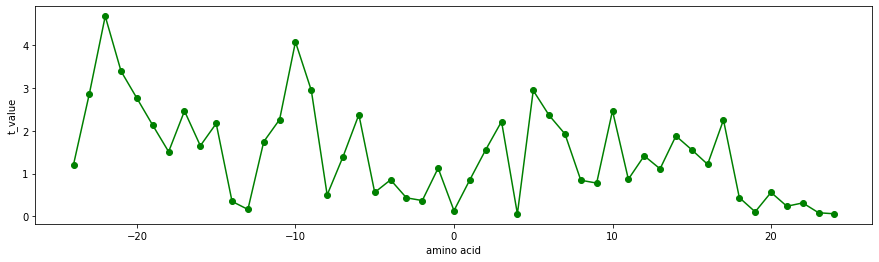

NAKH900106
Normalized composition from animal (Nakashima et al., 1990)


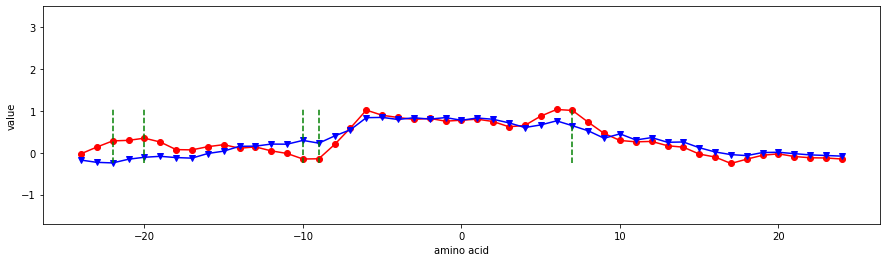

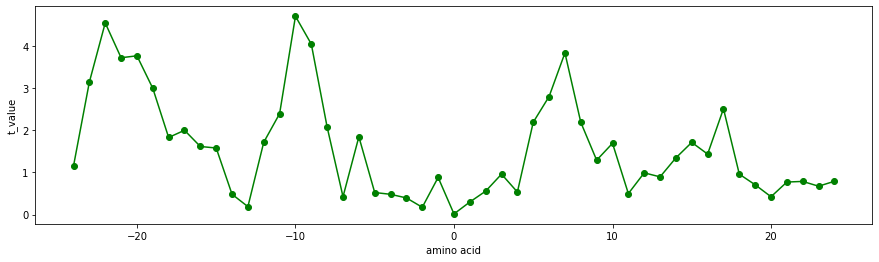

NAKH900107
AA composition of mt-proteins from fungi and plant (Nakashima et al., 1990)


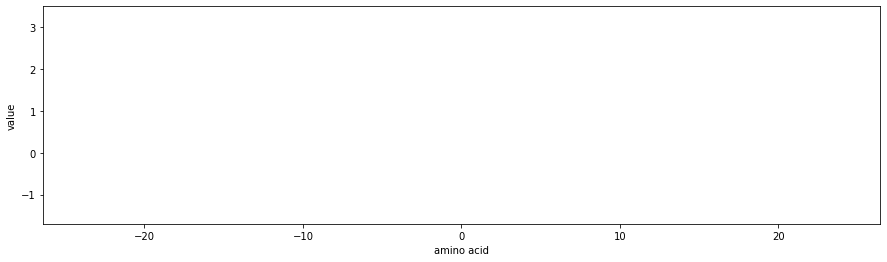

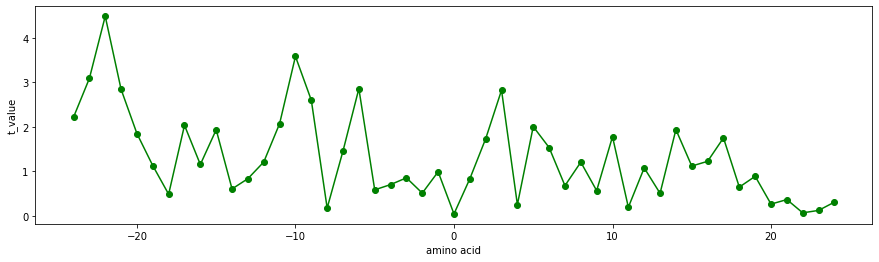

NAKH900108
Normalized composition from fungi and plant (Nakashima et al., 1990)


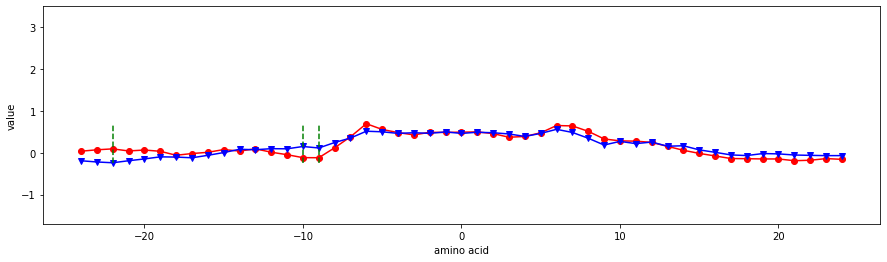

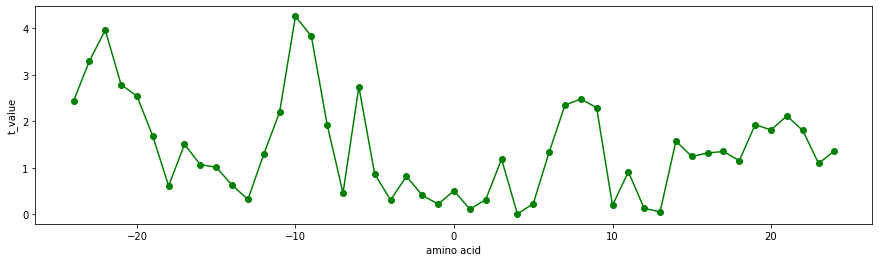

NAKH900109
AA composition of membrane proteins (Nakashima et al., 1990)


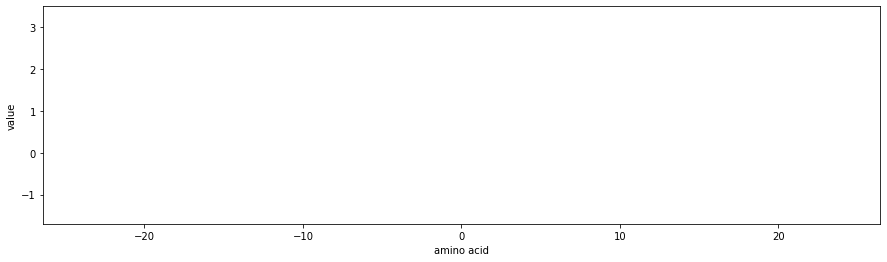

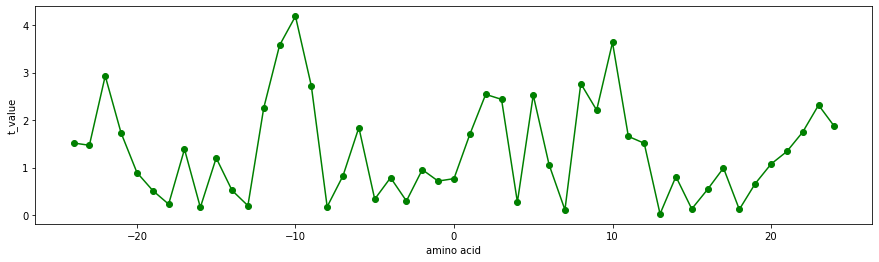

NAKH900110
Normalized composition of membrane proteins (Nakashima et al., 1990)


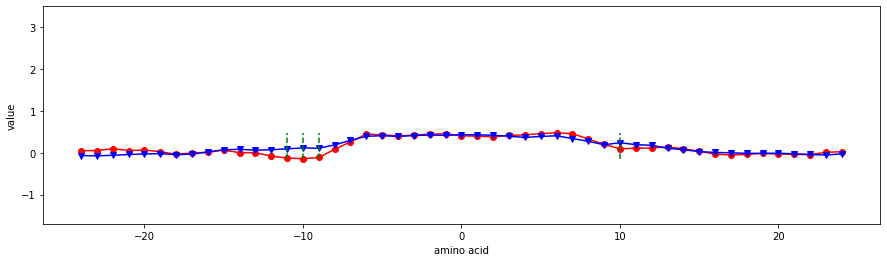

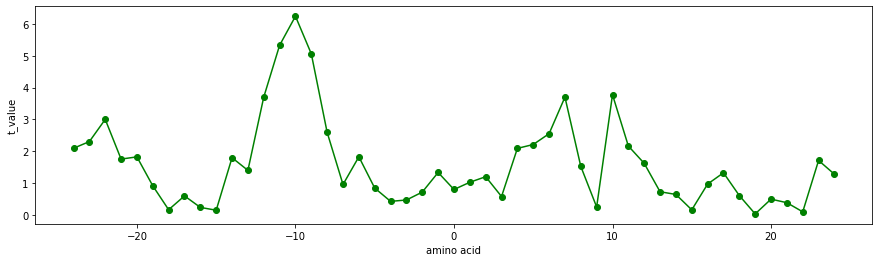

NAKH900111
Transmembrane regions of non-mt-proteins (Nakashima et al., 1990)


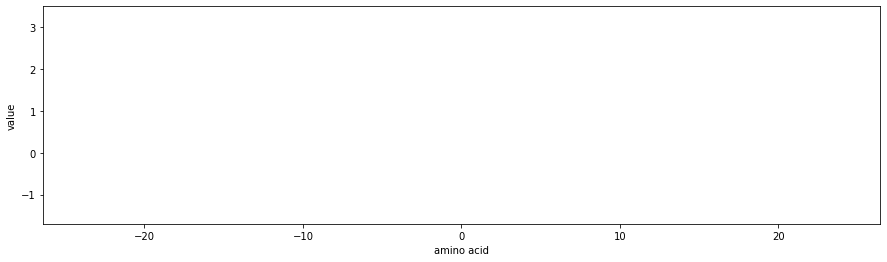

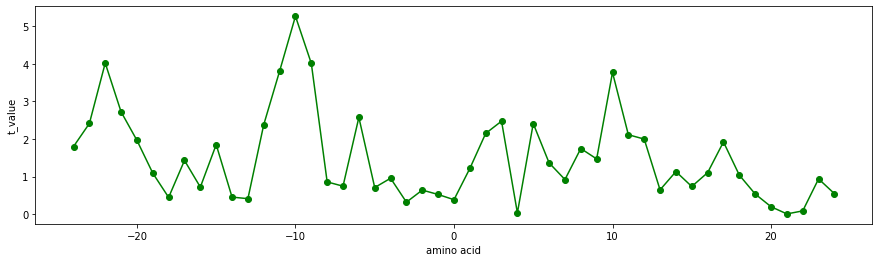

NAKH900112
Transmembrane regions of mt-proteins (Nakashima et al., 1990)


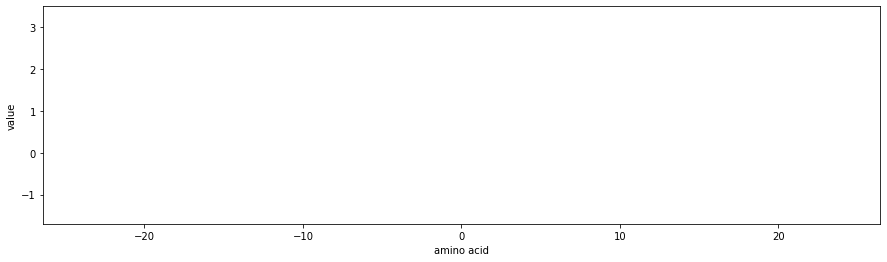

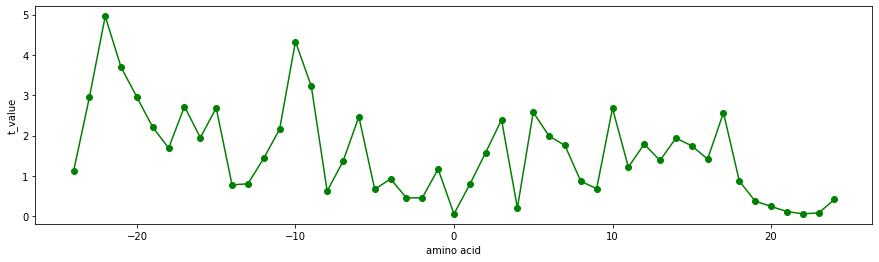

NAKH900113
Ratio of average and computed composition (Nakashima et al., 1990)


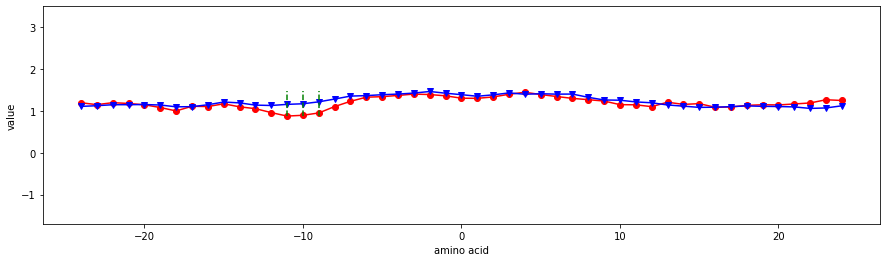

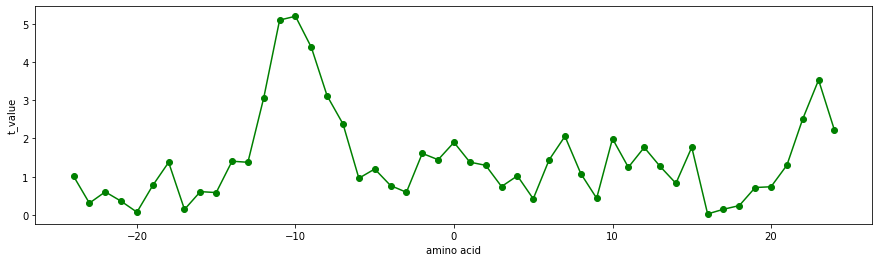

NAKH920102
AA composition of CYT2 of single-spanning proteins (Nakashima-Nishikawa,


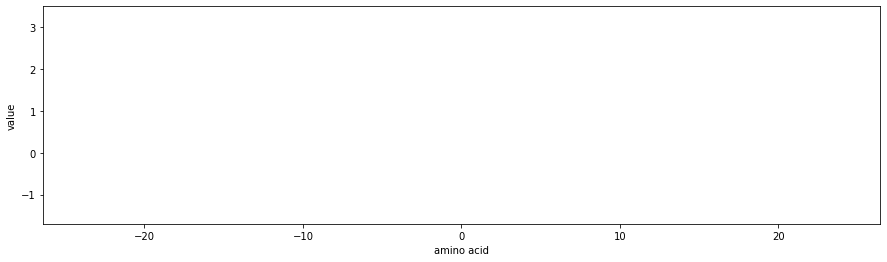

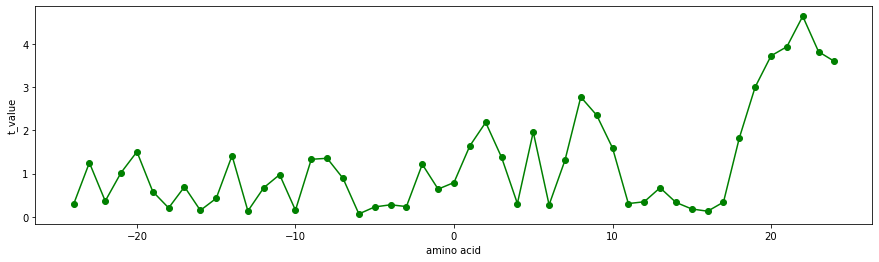

NAKH920103
AA composition of EXT of single-spanning proteins (Nakashima-Nishikawa, 1992)


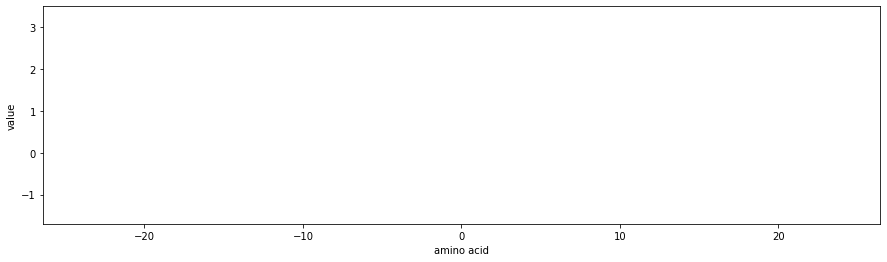

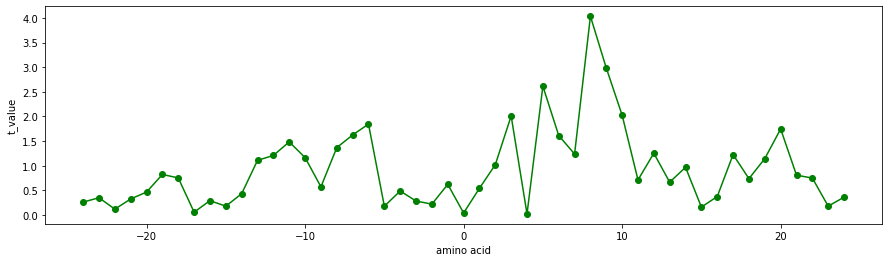

NAKH920105
AA composition of MEM of single-spanning proteins (Nakashima-Nishikawa, 1992)


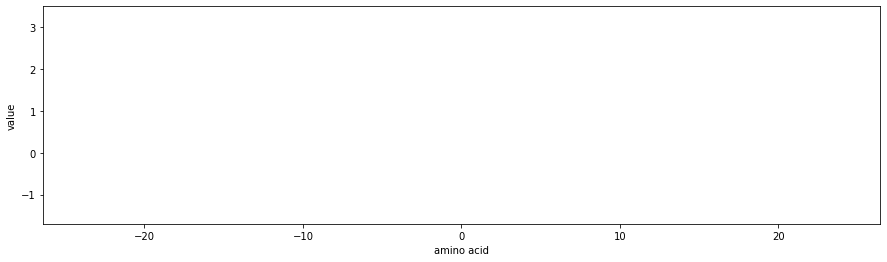

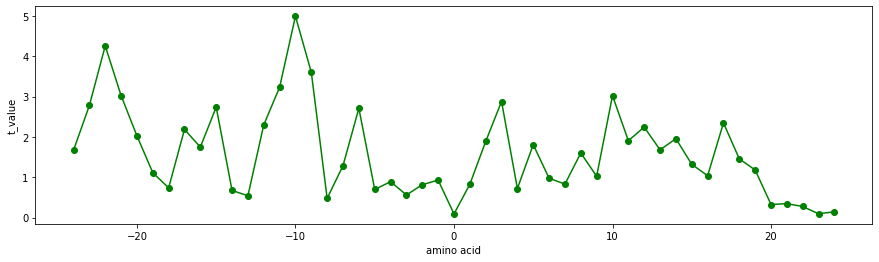

NAKH920108
AA composition of MEM of multi-spanning proteins (Nakashima-Nishikawa, 1992)


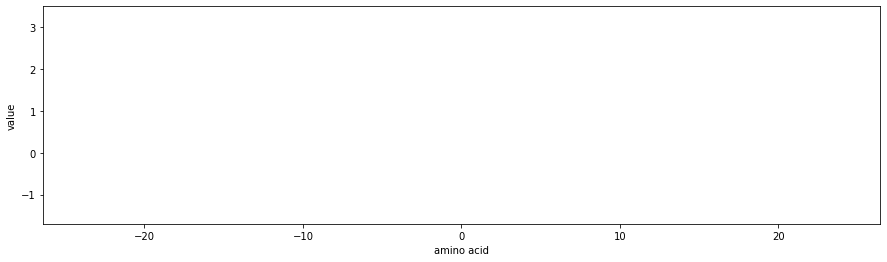

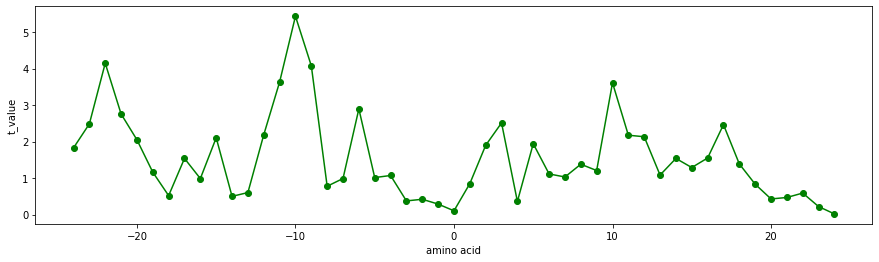

NISK800101
8 A contact number (Nishikawa-Ooi, 1980)


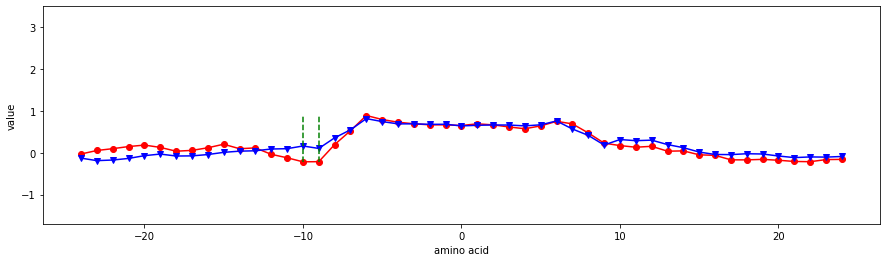

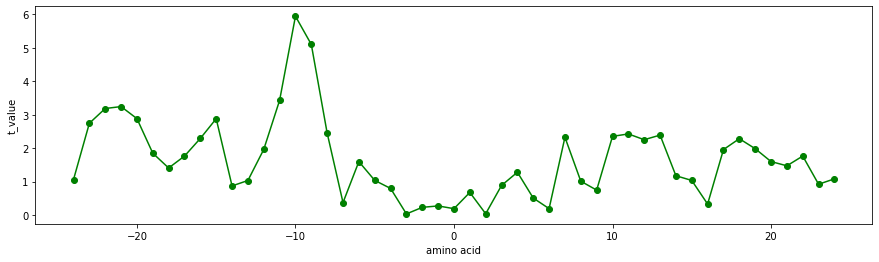

NISK860101
14 A contact number (Nishikawa-Ooi, 1986)


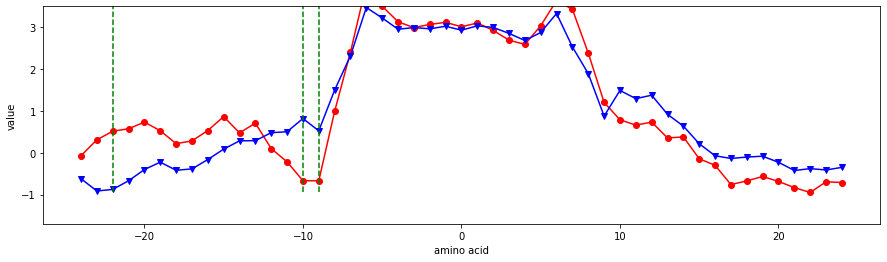

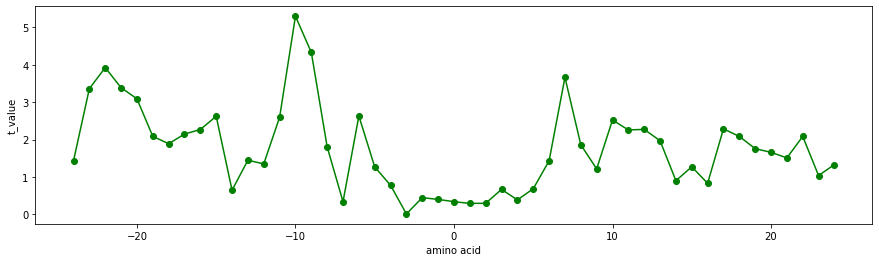

NOZY710101
Transfer energy, organic solvent/water (Nozaki-Tanford, 1971)


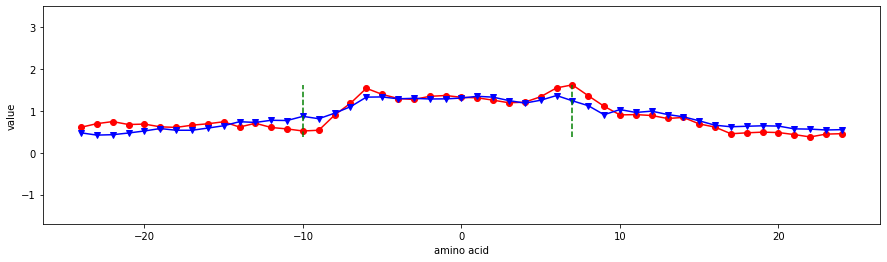

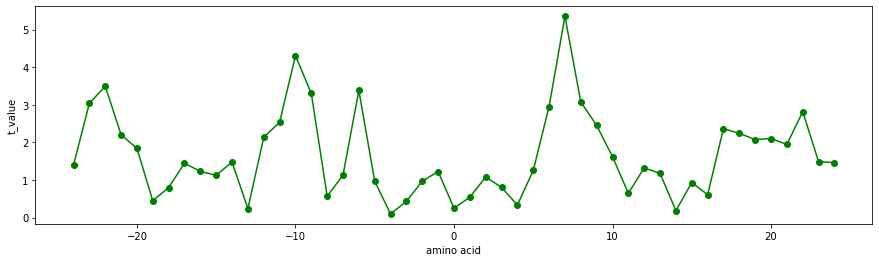

OOBM770101
Average non-bonded energy per atom (Oobatake-Ooi, 1977)


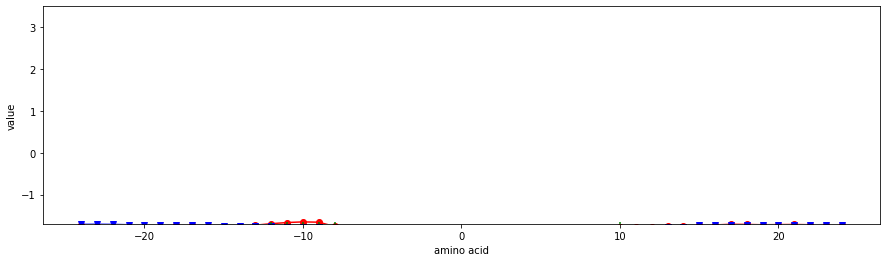

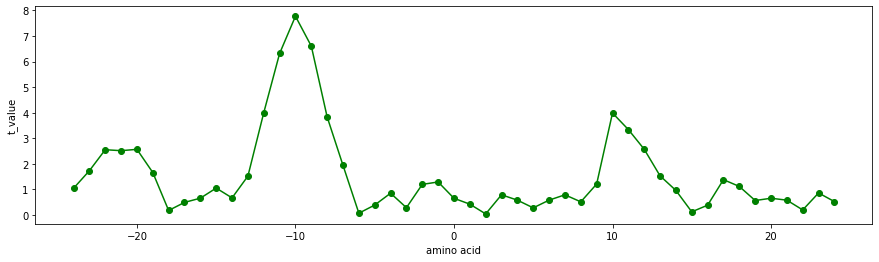

OOBM770102
Short and medium range non-bonded energy per atom (Oobatake-Ooi, 1977)


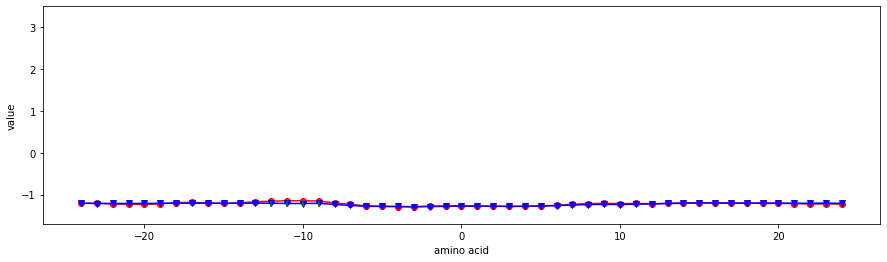

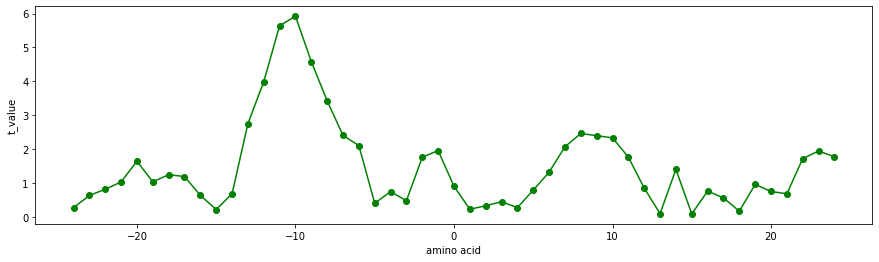

OOBM770103
Long range non-bonded energy per atom (Oobatake-Ooi, 1977)


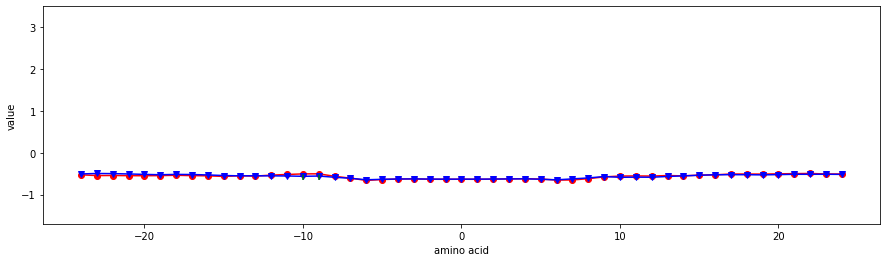

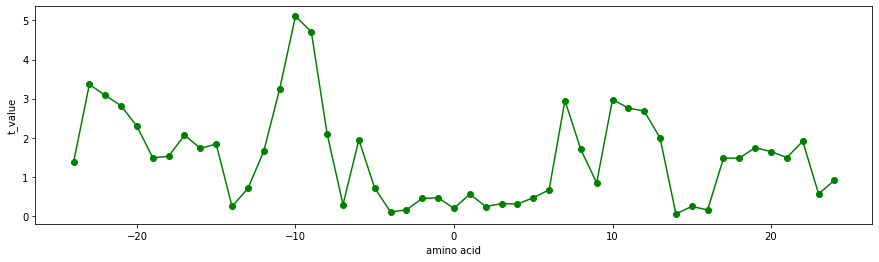

OOBM770104
Average non-bonded energy per residue (Oobatake-Ooi, 1977)


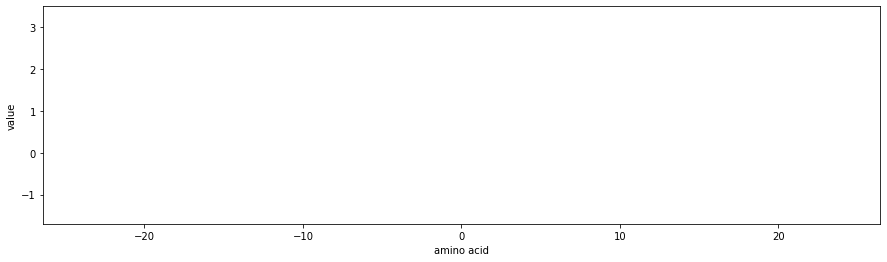

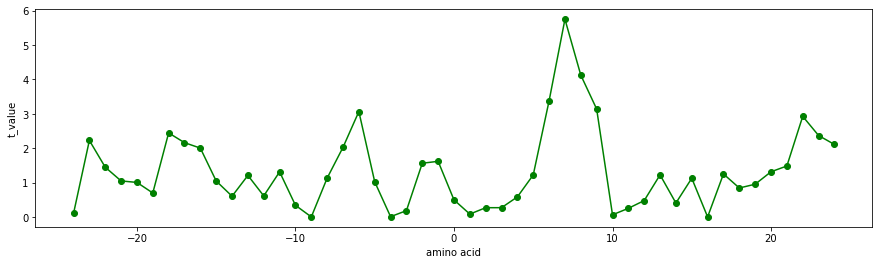

OOBM770105
Short and medium range non-bonded energy per residue (Oobatake-Ooi, 1977)


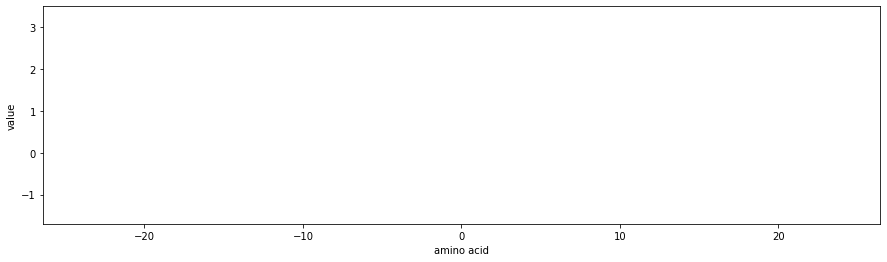

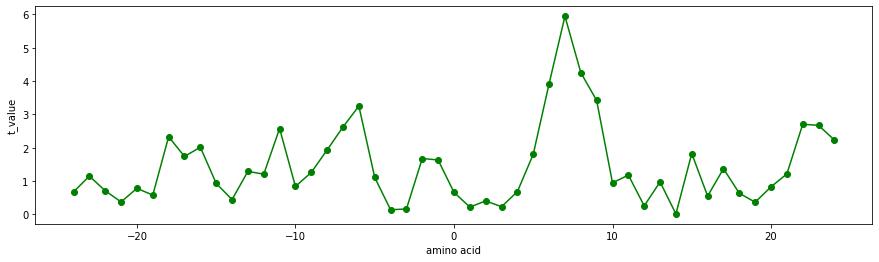

OOBM850101
Optimized beta-structure-coil equilibrium constant (Oobatake et al., 1985)


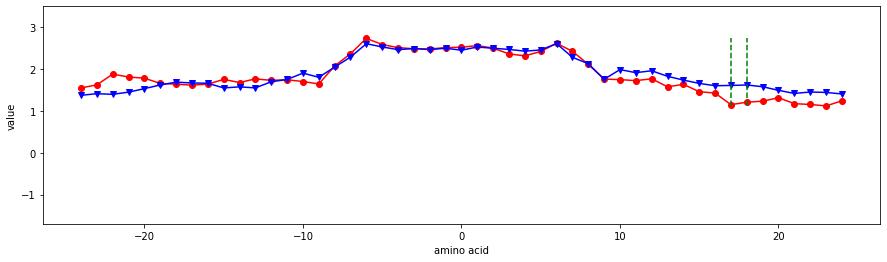

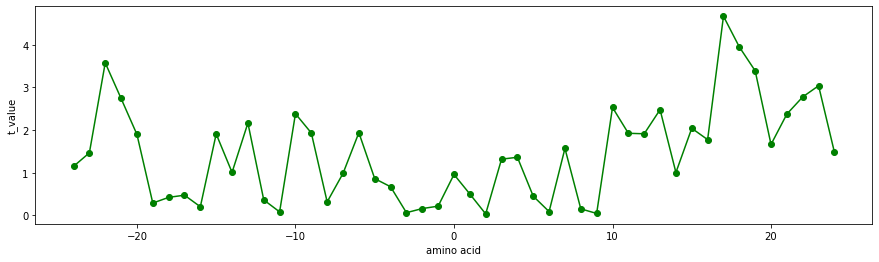

OOBM850102
Optimized propensity to form reverse turn (Oobatake et al., 1985)


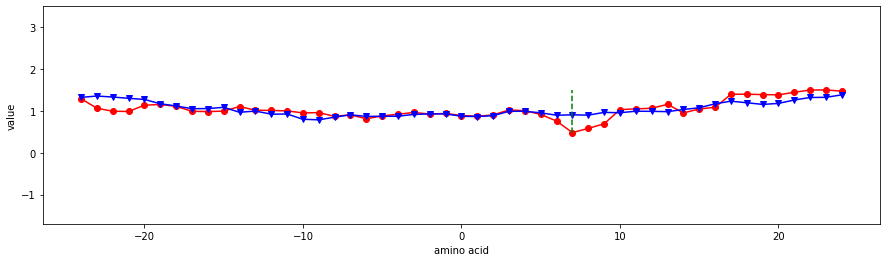

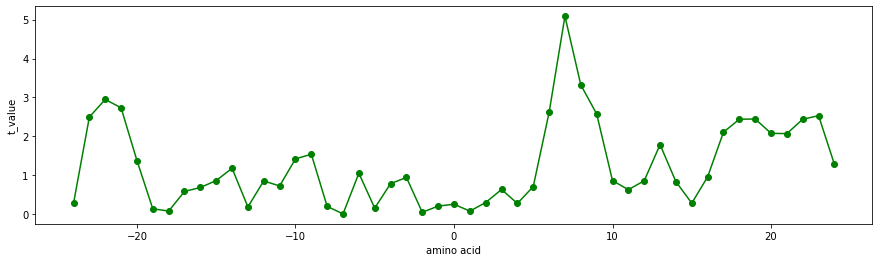

OOBM850103
Optimized transfer energy parameter (Oobatake et al., 1985)


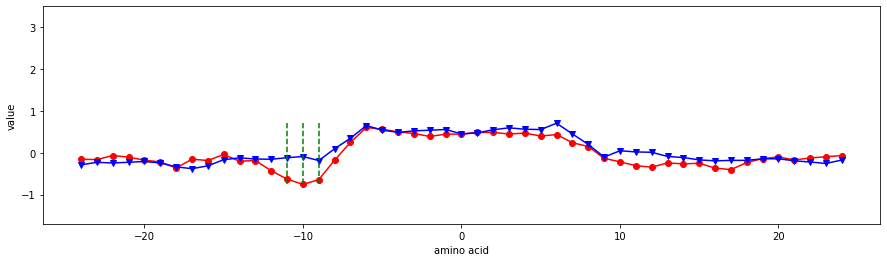

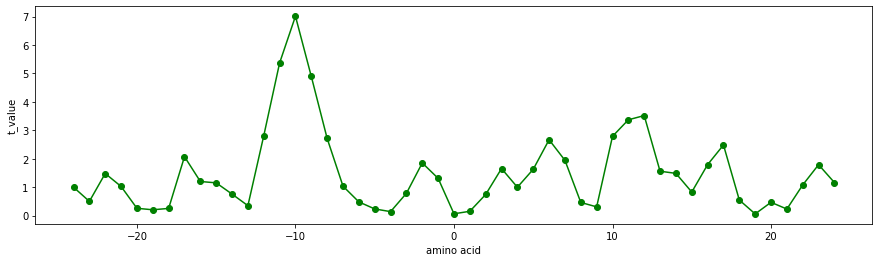

OOBM850104
Optimized average non-bonded energy per atom (Oobatake et al., 1985)


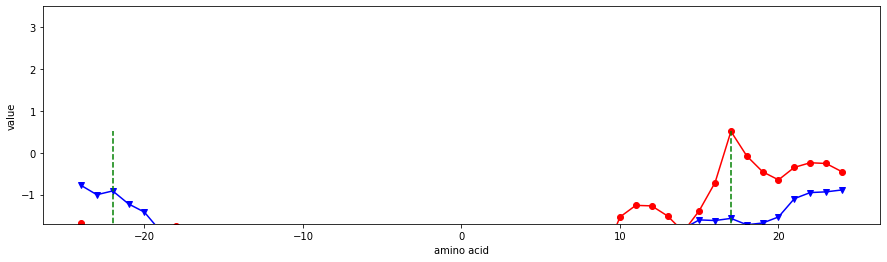

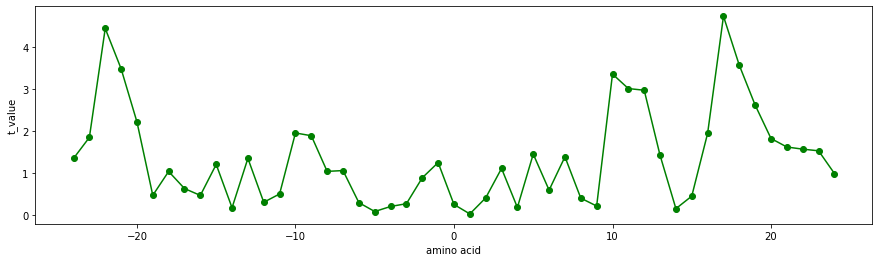

OOBM850105
Optimized side chain interaction parameter (Oobatake et al., 1985)


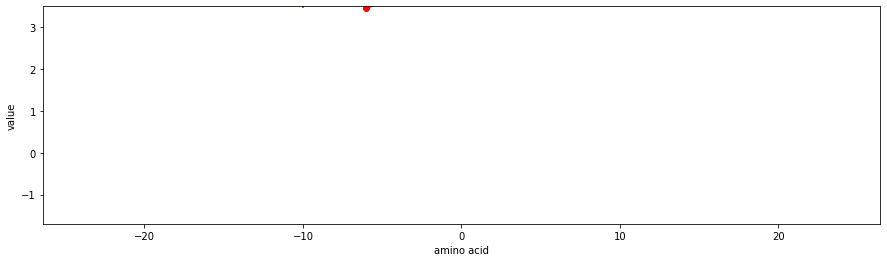

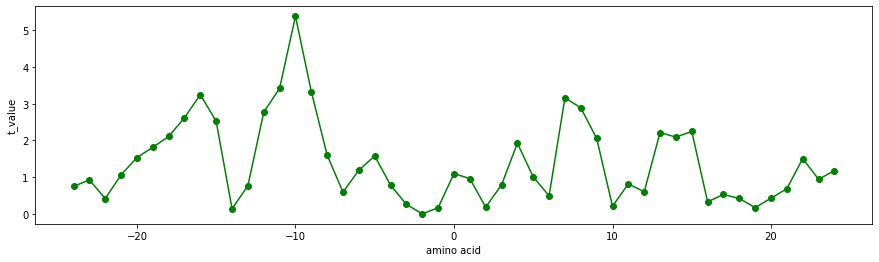

PALJ810102
Normalized frequency of alpha-helix from CF (Palau et al., 1981)


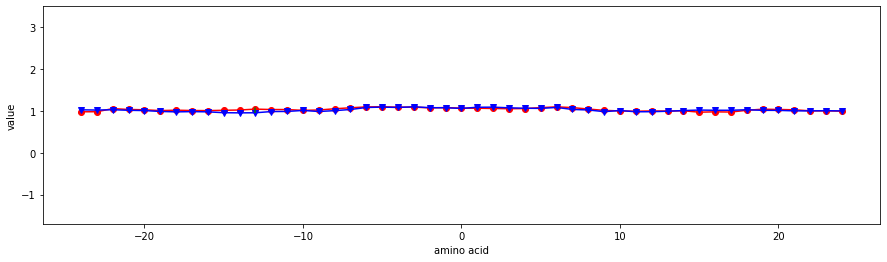

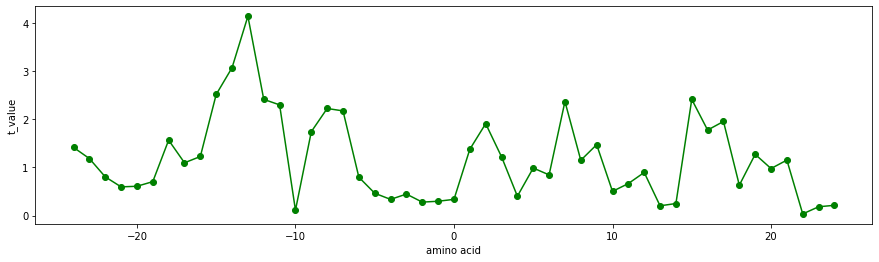

PALJ810103
Normalized frequency of beta-sheet from LG (Palau et al., 1981)


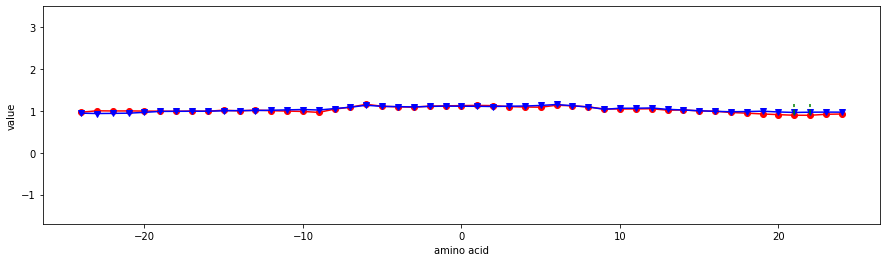

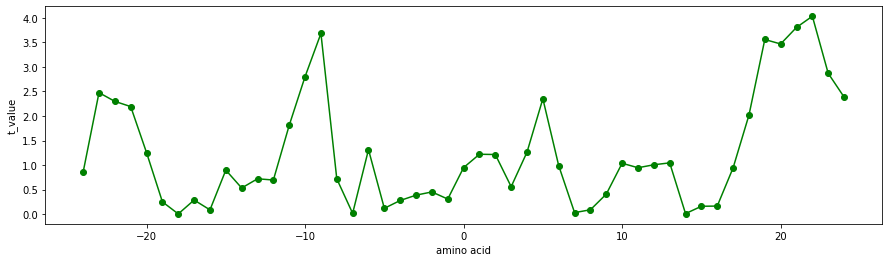

PALJ810104
Normalized frequency of beta-sheet from CF (Palau et al., 1981)


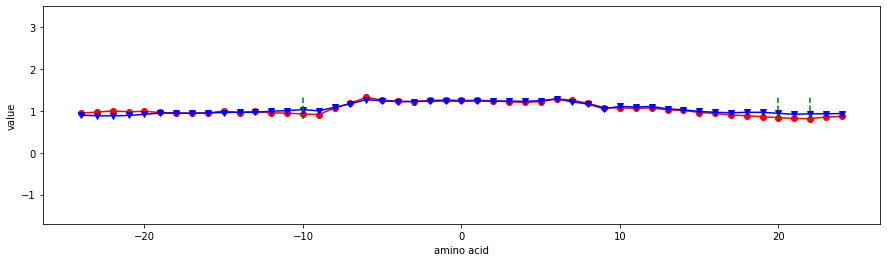

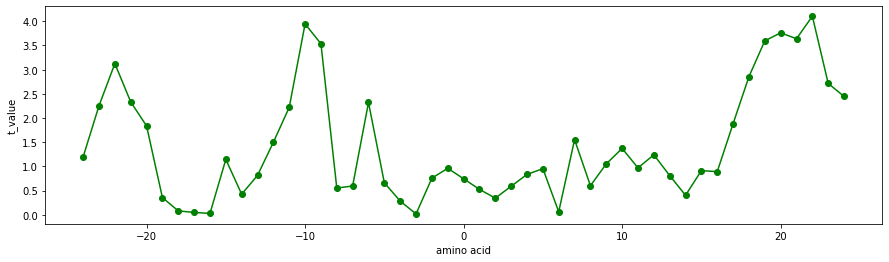

PALJ810105
Normalized frequency of turn from LG (Palau et al., 1981)


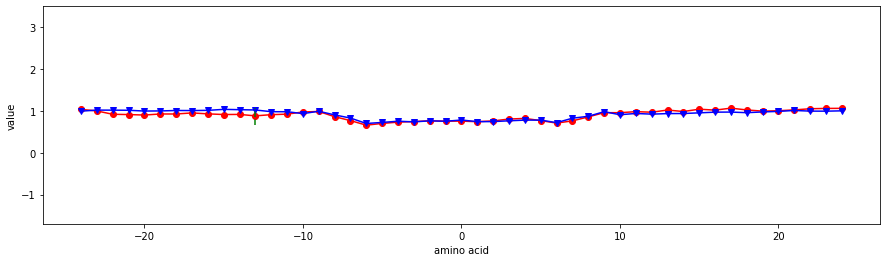

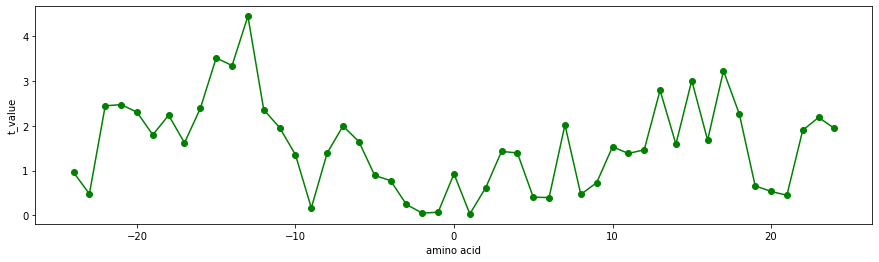

PALJ810106
Normalized frequency of turn from CF (Palau et al., 1981)


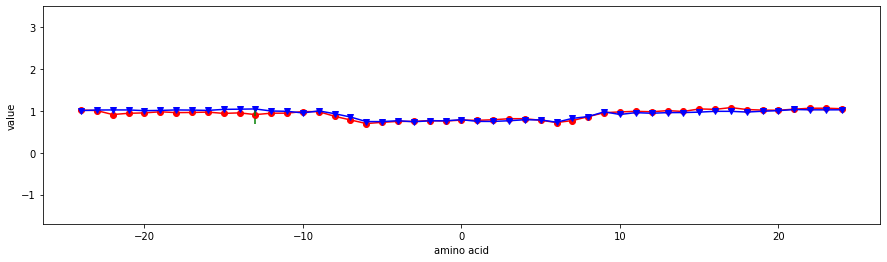

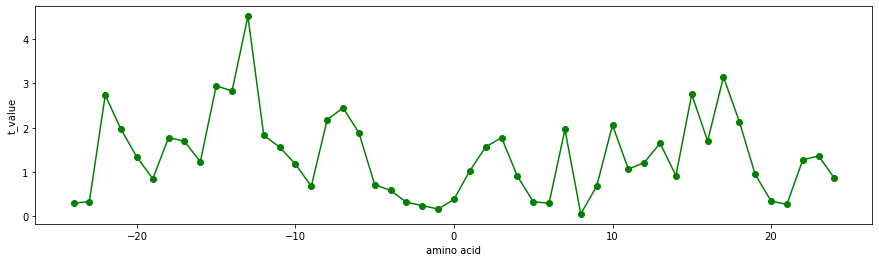

PALJ810107
Normalized frequency of alpha-helix in all-alpha class (Palau et al., 1981)


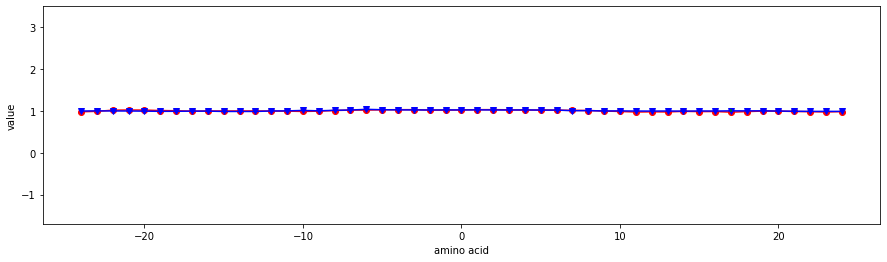

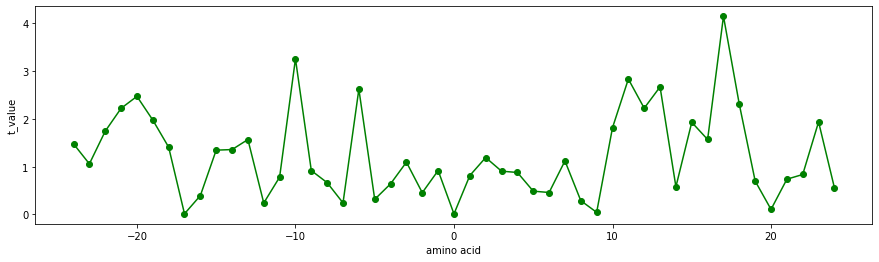

PALJ810110
Normalized frequency of beta-sheet in all-beta class (Palau et al., 1981)


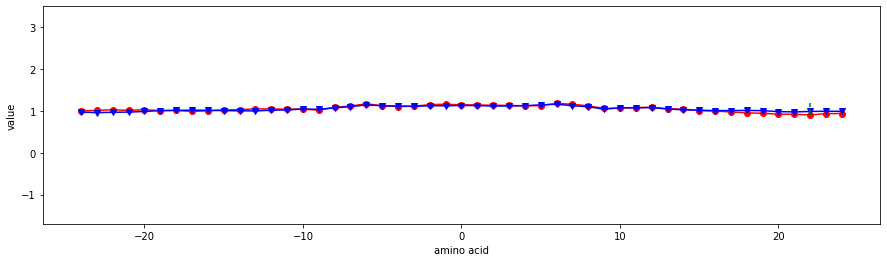

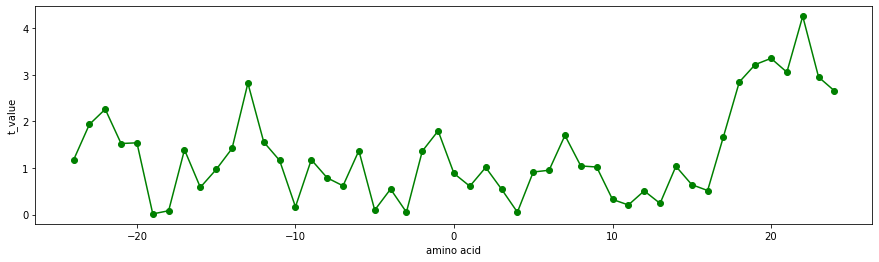

PALJ810113
Normalized frequency of turn in all-alpha class (Palau et al., 1981)


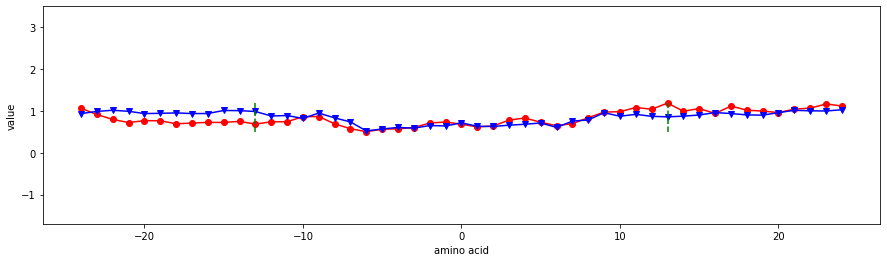

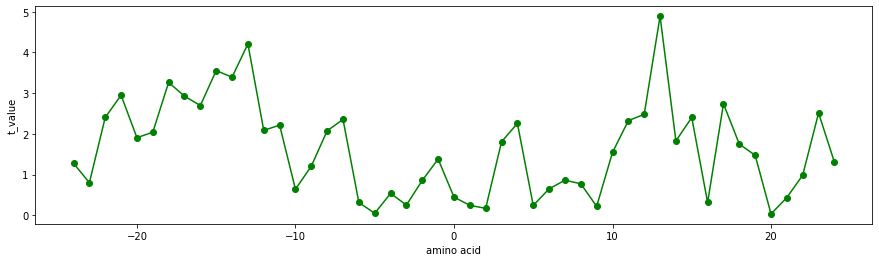

PALJ810115
Normalized frequency of turn in alpha+beta class (Palau et al., 1981)


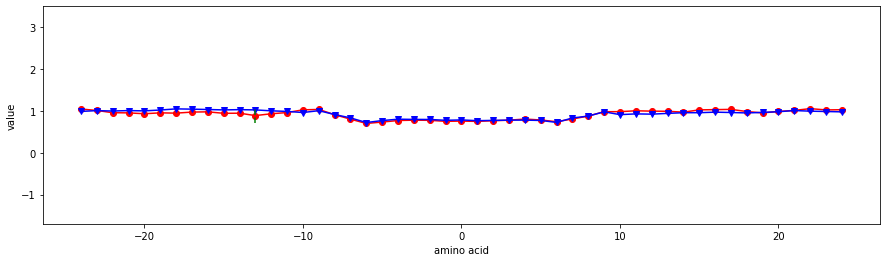

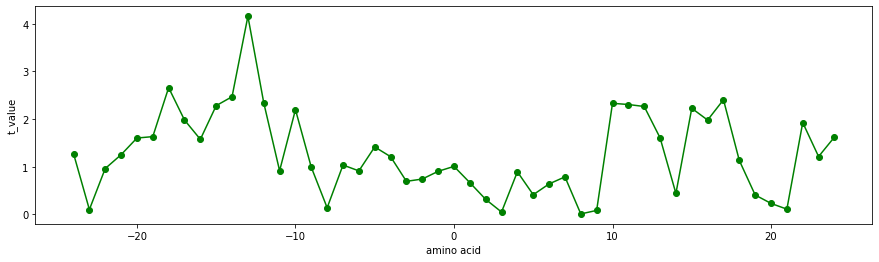

PARJ860101
HPLC parameter (Parker et al., 1986)


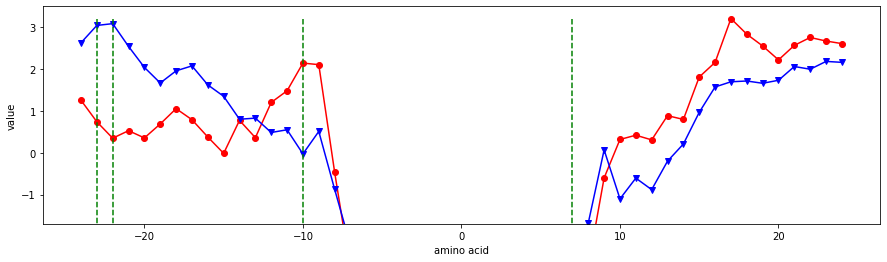

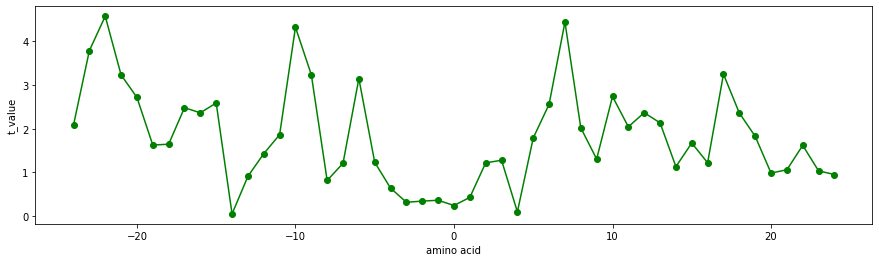

PLIV810101
Partition coefficient (Pliska et al., 1981)


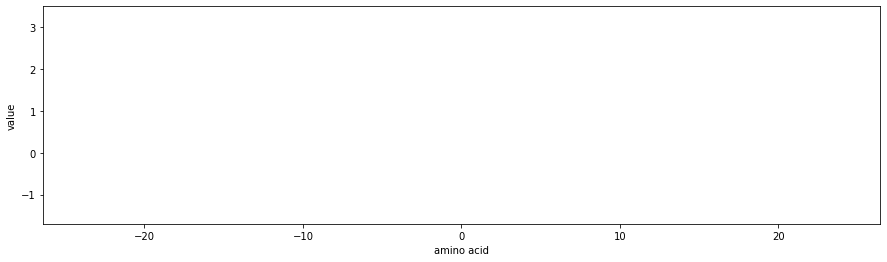

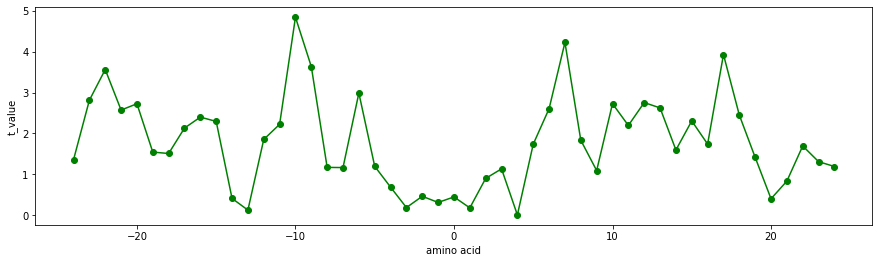

PONP800101
Surrounding hydrophobicity in folded form (Ponnuswamy et al., 1980)


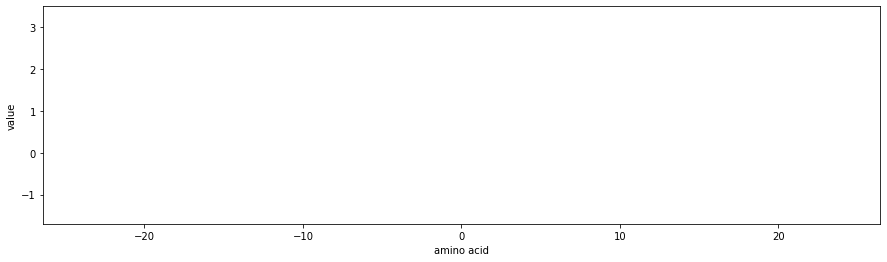

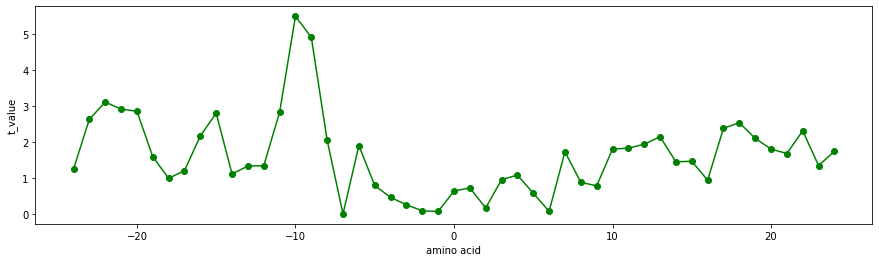

PONP800102
Average gain in surrounding hydrophobicity (Ponnuswamy et al., 1980)


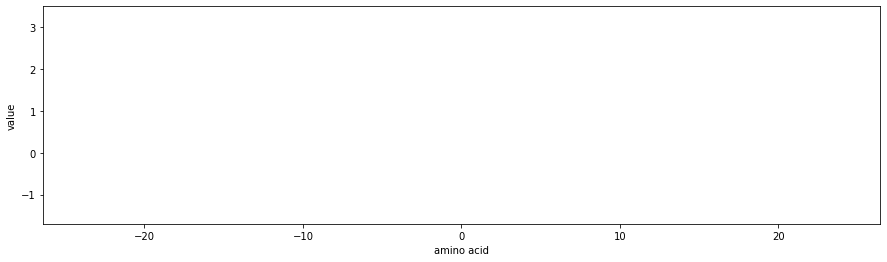

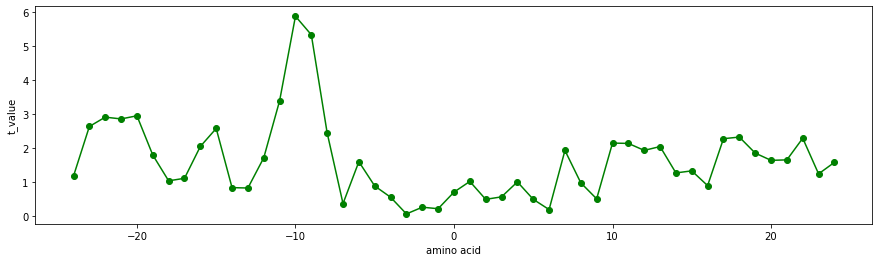

PONP800103
Average gain ratio in surrounding hydrophobicity (Ponnuswamy et al., 1980)


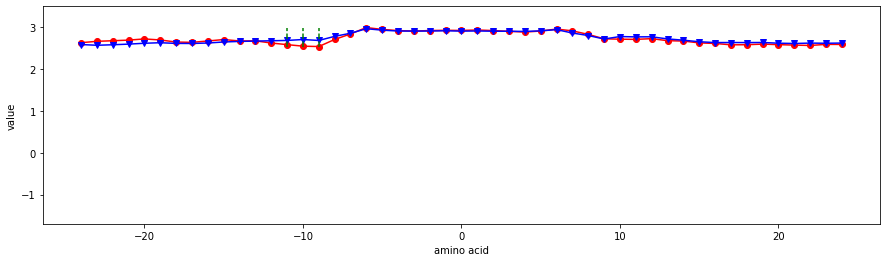

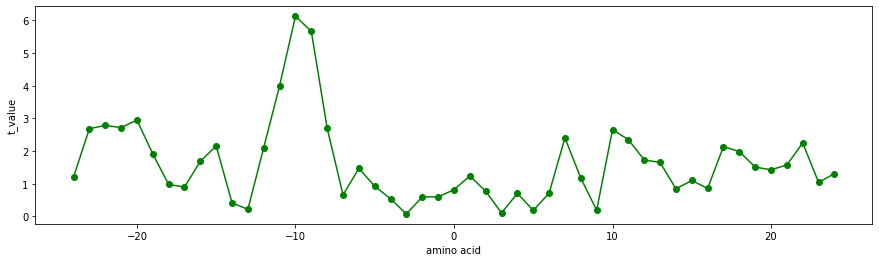

PONP800104
Surrounding hydrophobicity in alpha-helix (Ponnuswamy et al., 1980)


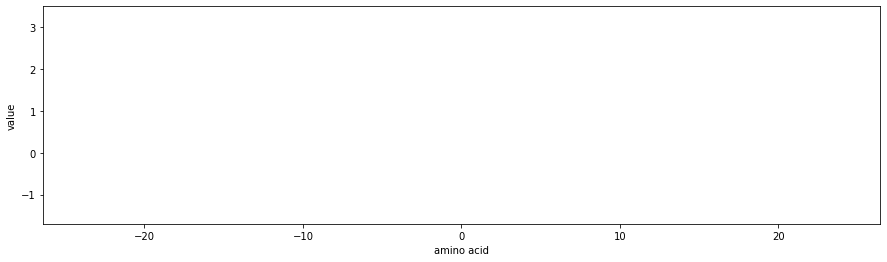

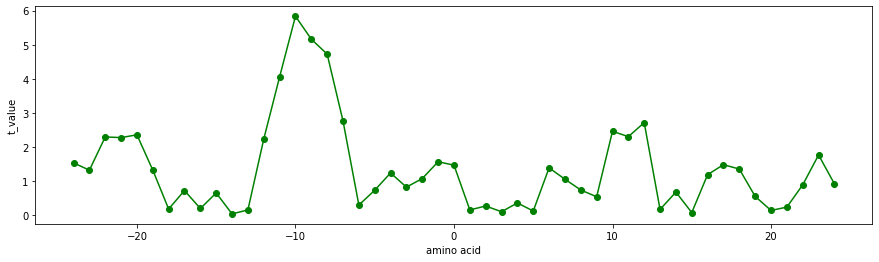

PONP800105
Surrounding hydrophobicity in beta-sheet (Ponnuswamy et al., 1980)


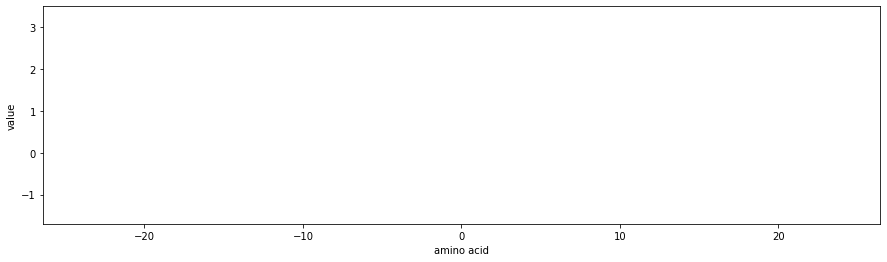

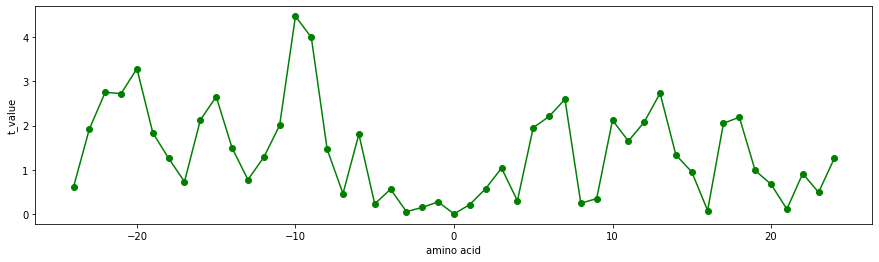

PONP800106
Surrounding hydrophobicity in turn (Ponnuswamy et al., 1980)


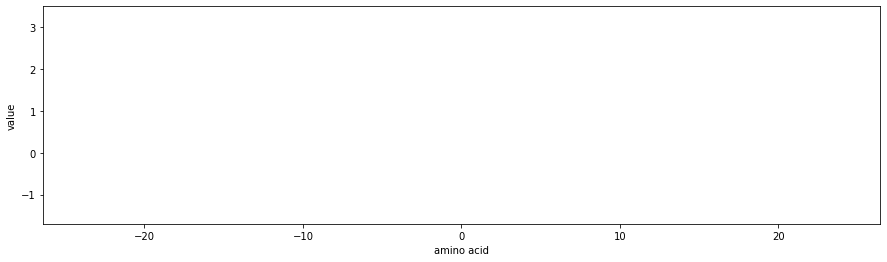

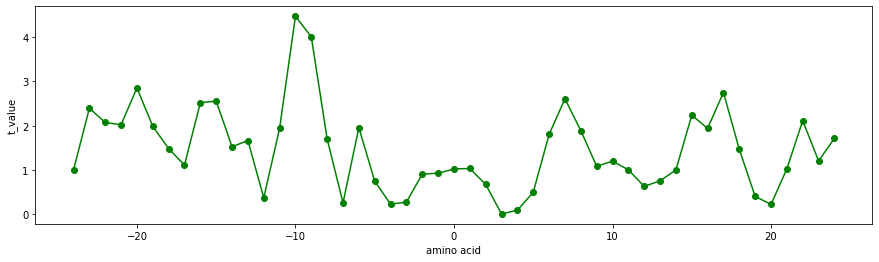

PONP800107
Accessibility reduction ratio (Ponnuswamy et al., 1980)


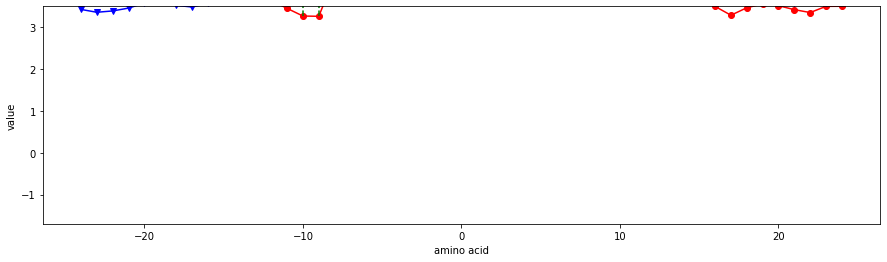

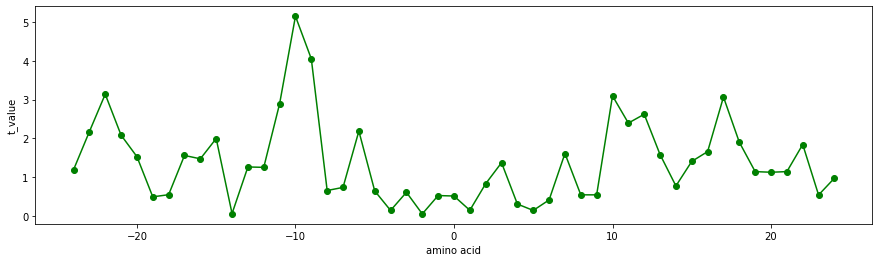

PONP800108
Average number of surrounding residues (Ponnuswamy et al., 1980)


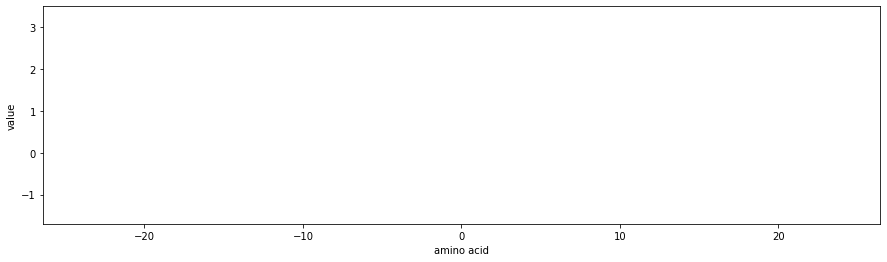

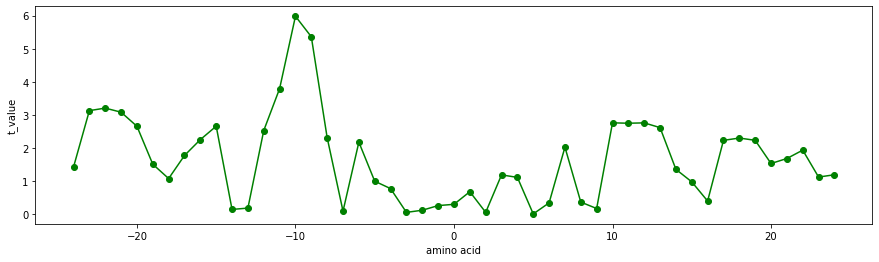

PRAM820101
Intercept in regression analysis (Prabhakaran-Ponnuswamy, 1982)


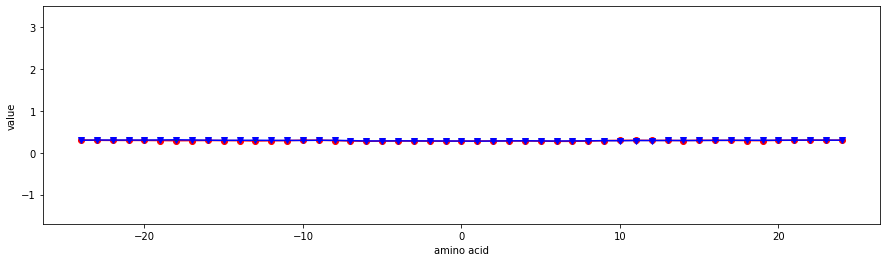

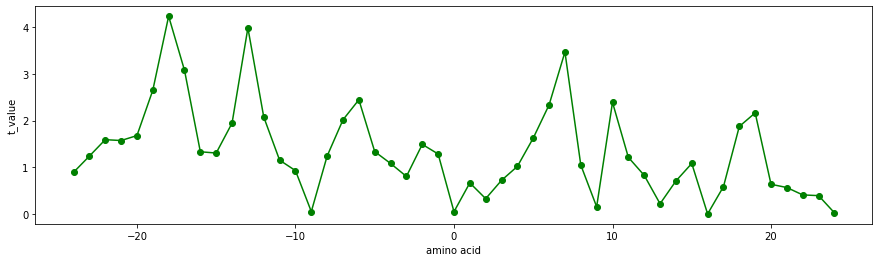

PRAM820102
Slope in regression analysis x 1.0E1 (Prabhakaran-Ponnuswamy, 1982)


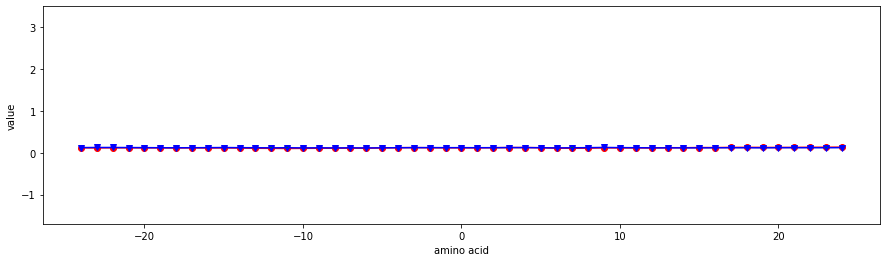

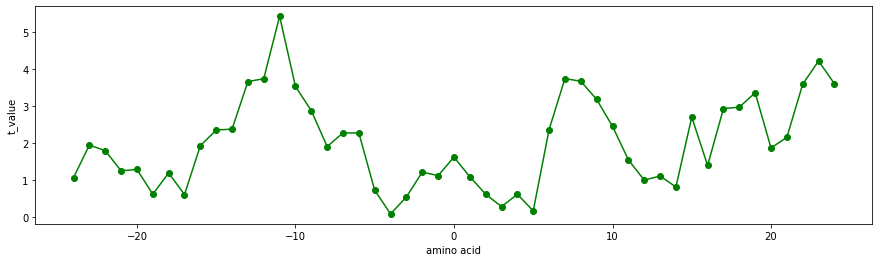

PRAM820103
Correlation coefficient in regression analysis (Prabhakaran-Ponnuswamy, 1982)


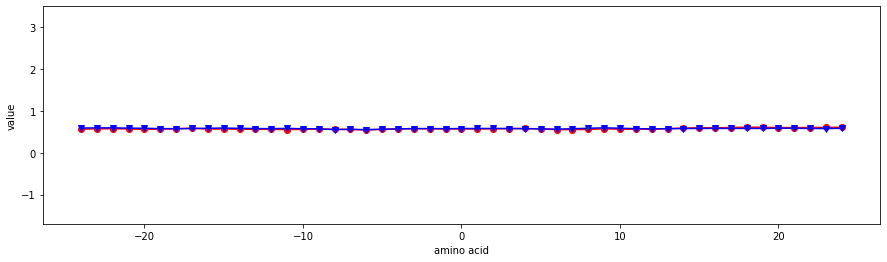

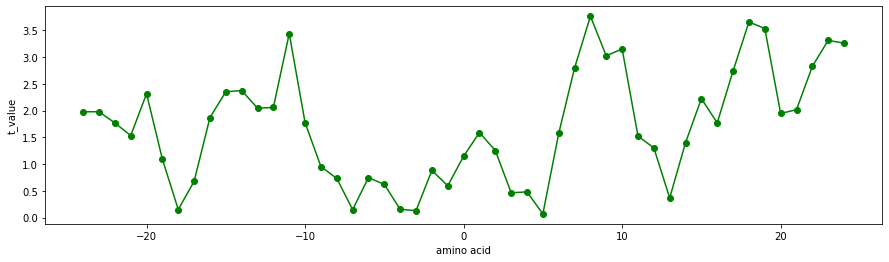

PRAM900101
Hydrophobicity (Prabhakaran, 1990)


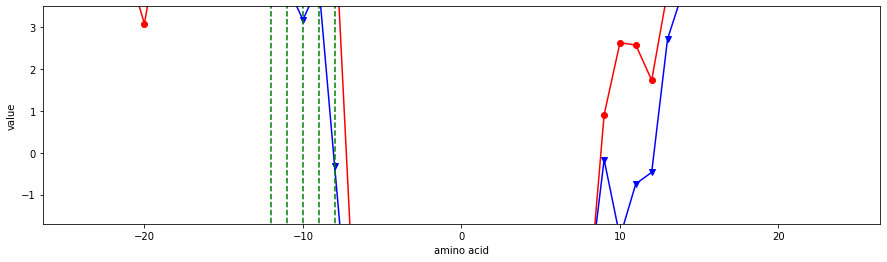

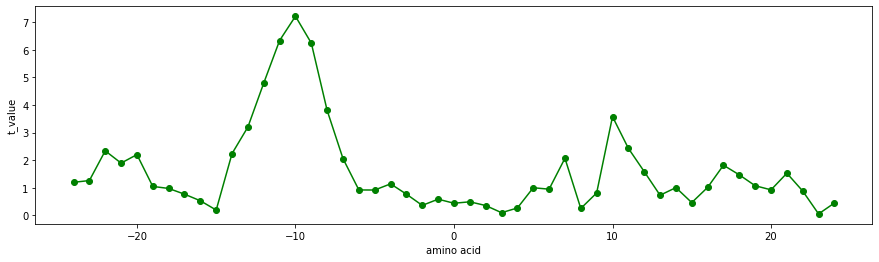

PRAM900104
Relative frequency in reverse-turn (Prabhakaran, 1990)


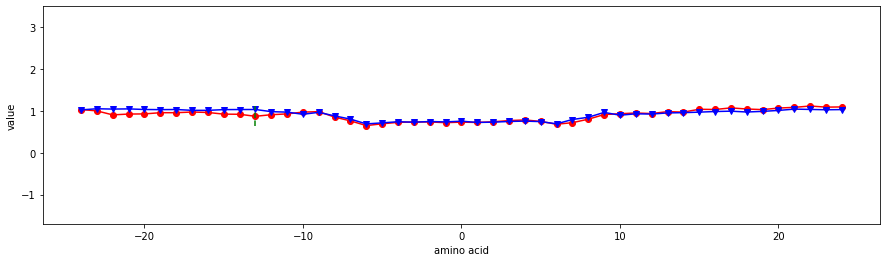

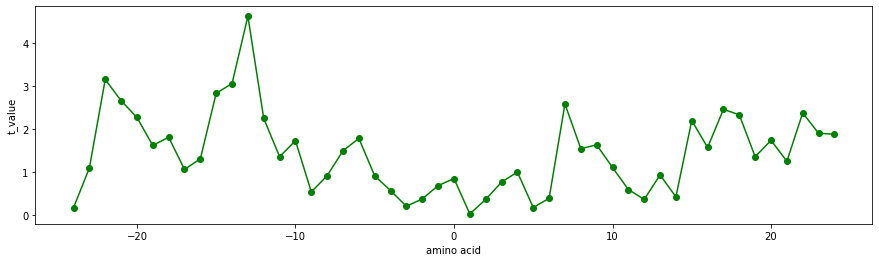

PTIO830101
Helix-coil equilibrium constant (Ptitsyn-Finkelstein, 1983)


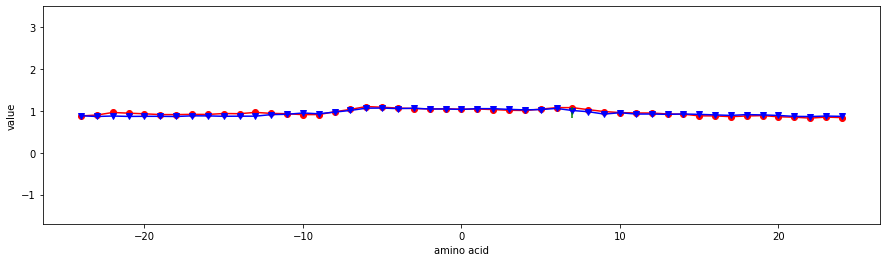

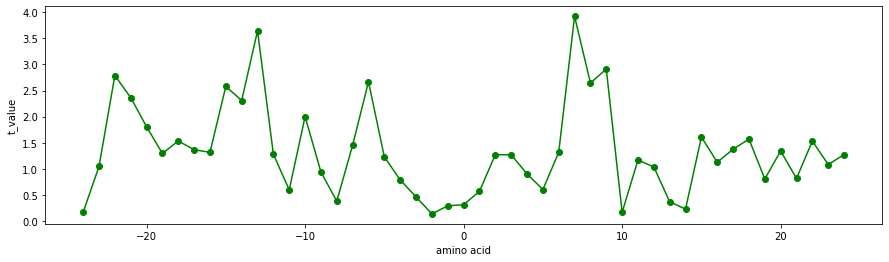

PTIO830102
Beta-coil equilibrium constant (Ptitsyn-Finkelstein, 1983)


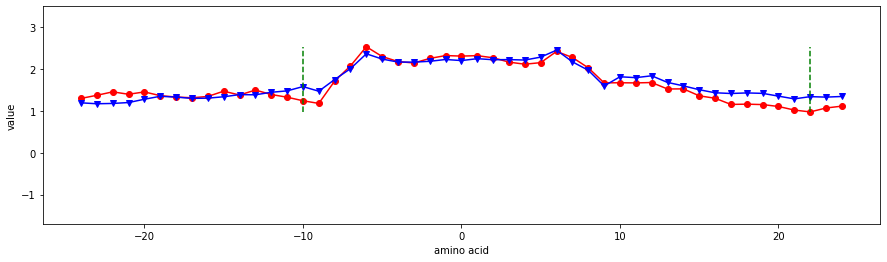

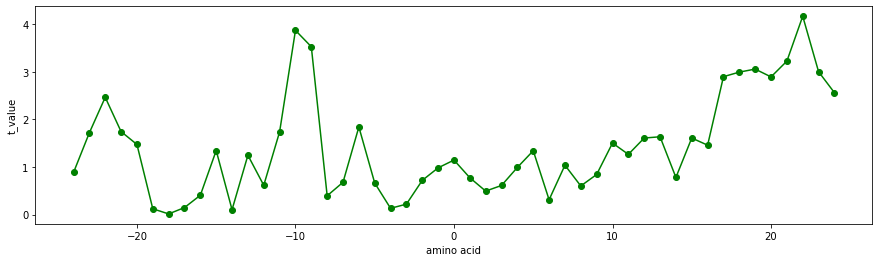

QIAN880101
Weights for alpha-helix at the window position of -6 (Qian-Sejnowski, 1988)


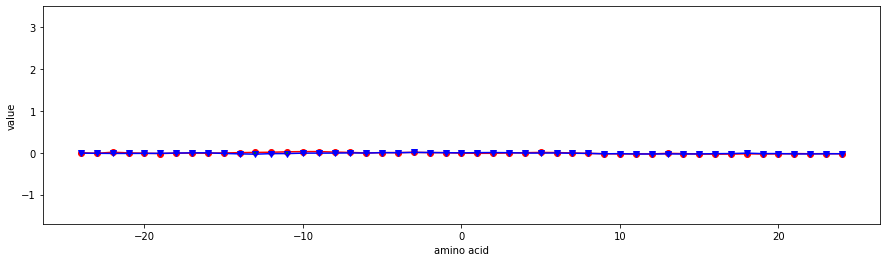

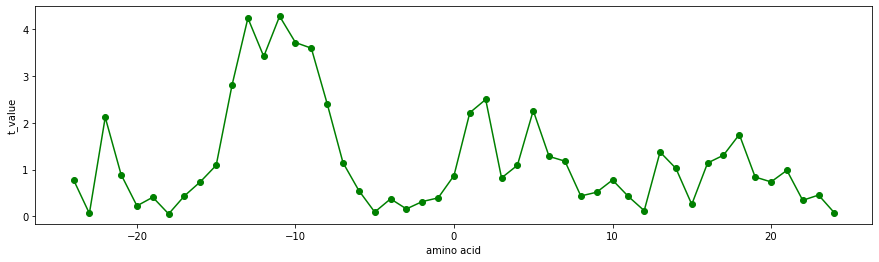

QIAN880103
Weights for alpha-helix at the window position of -4 (Qian-Sejnowski, 1988)


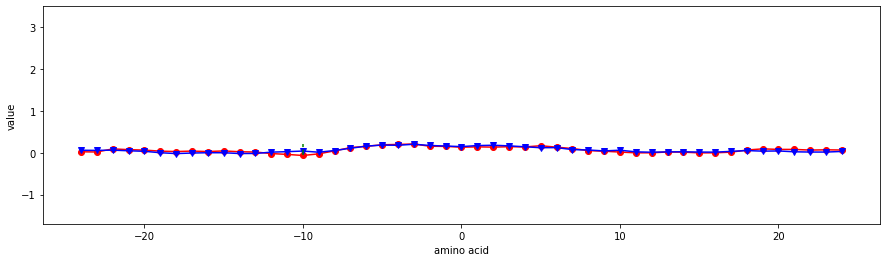

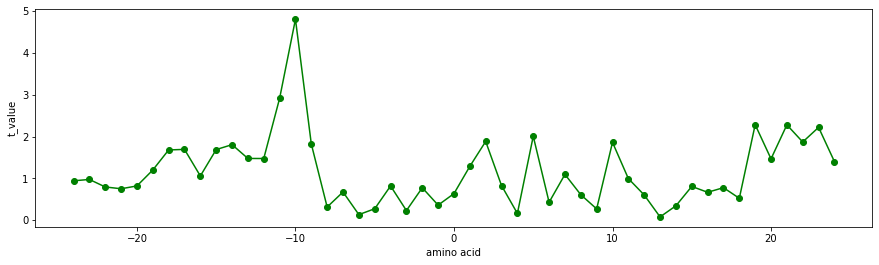

QIAN880104
Weights for alpha-helix at the window position of -3 (Qian-Sejnowski, 1988)


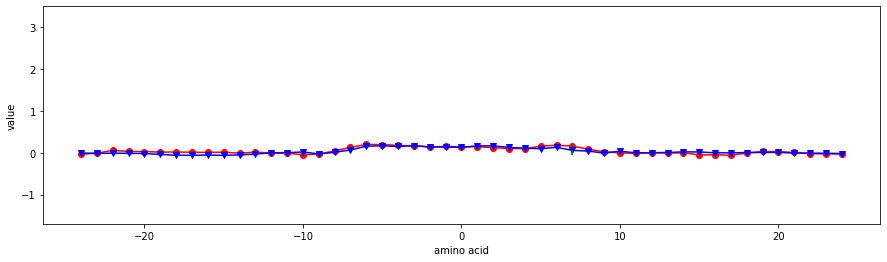

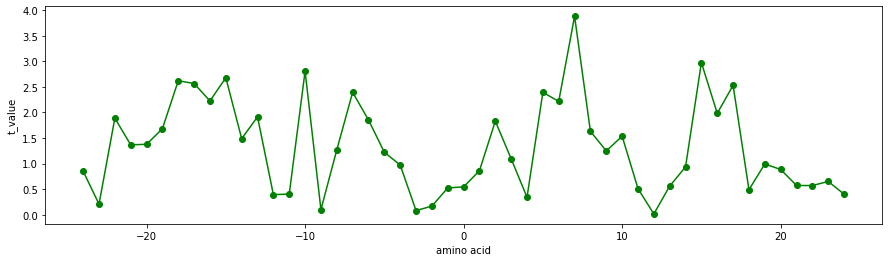

QIAN880106
Weights for alpha-helix at the window position of -1 (Qian-Sejnowski, 1988)


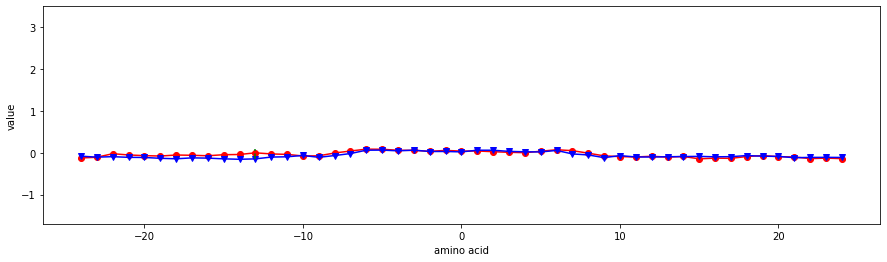

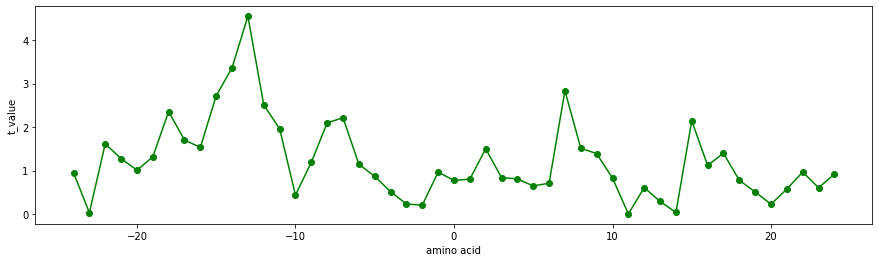

QIAN880107
Weights for alpha-helix at the window position of 0 (Qian-Sejnowski, 1988)


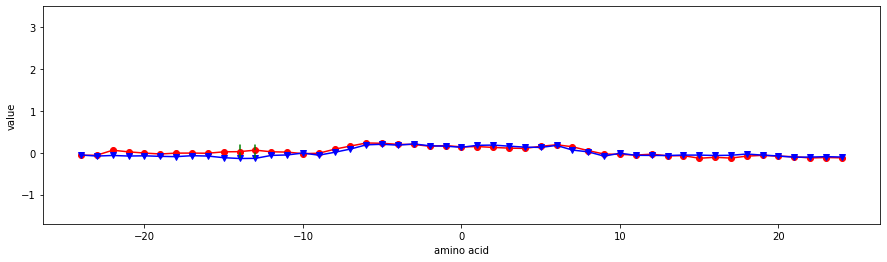

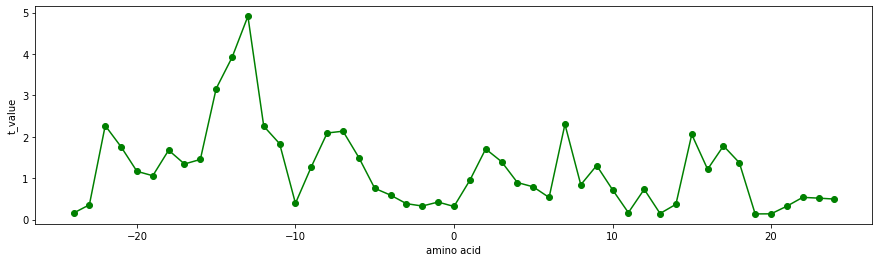

QIAN880108
Weights for alpha-helix at the window position of 1 (Qian-Sejnowski, 1988)


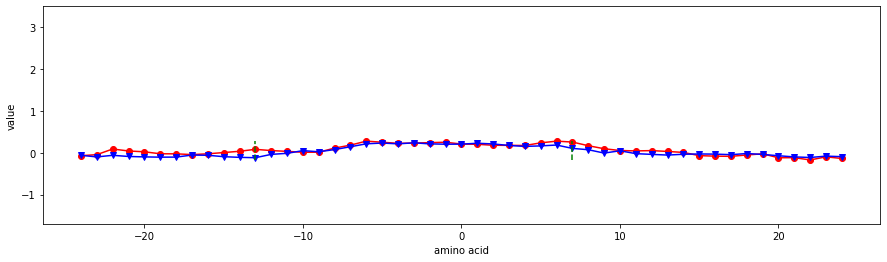

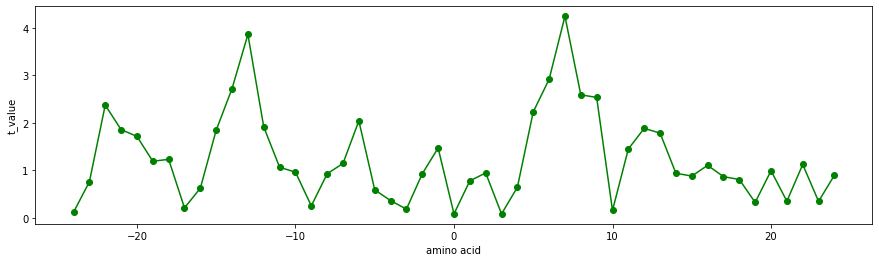

QIAN880109
Weights for alpha-helix at the window position of 2 (Qian-Sejnowski, 1988)


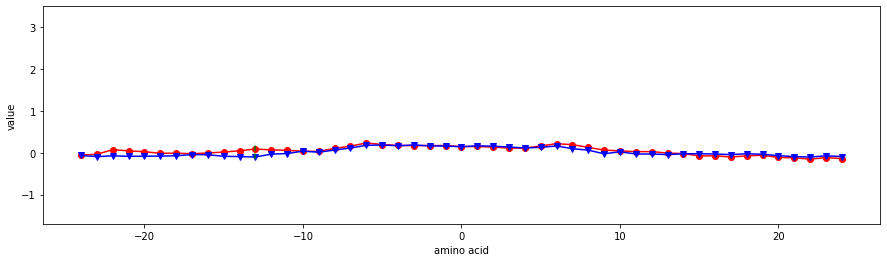

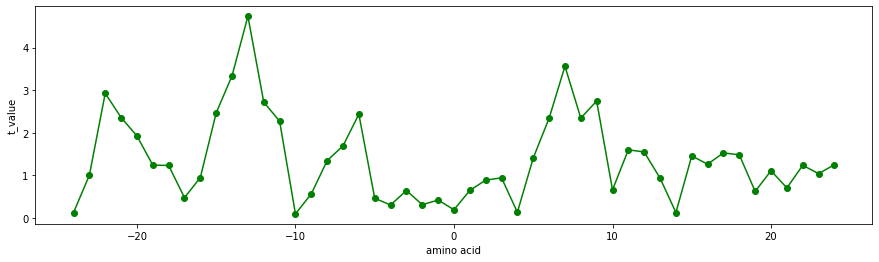

QIAN880110
Weights for alpha-helix at the window position of 3 (Qian-Sejnowski, 1988)


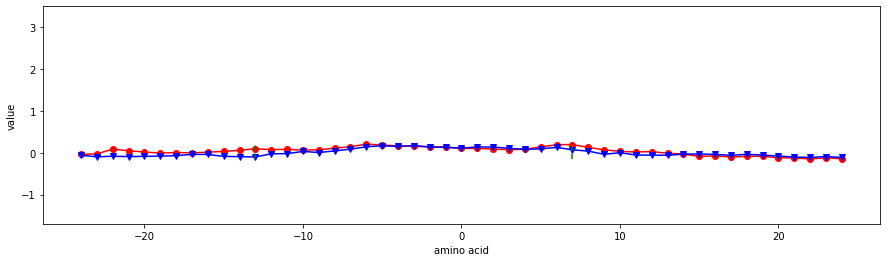

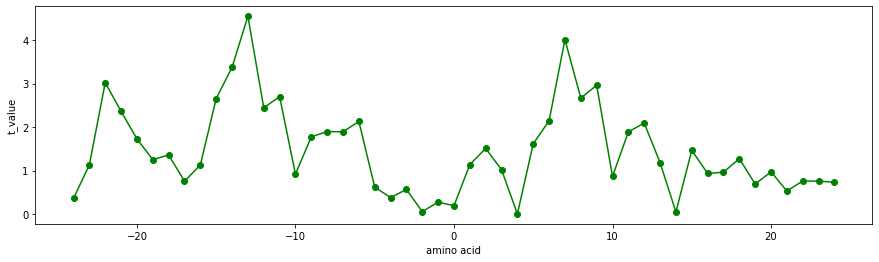

QIAN880111
Weights for alpha-helix at the window position of 4 (Qian-Sejnowski, 1988)


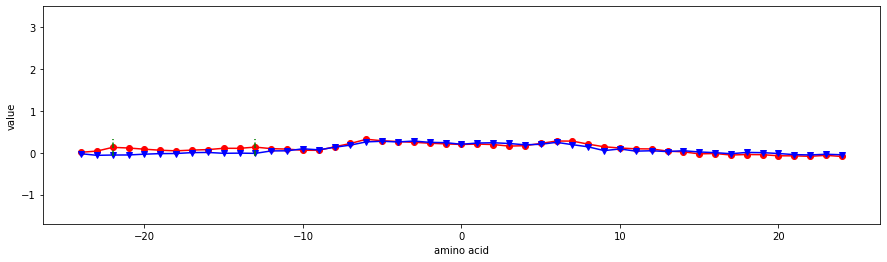

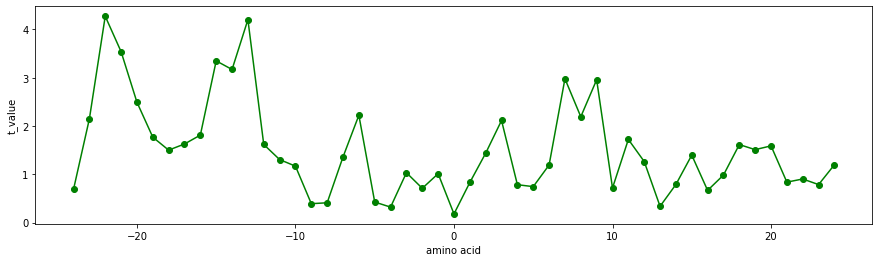

QIAN880112
Weights for alpha-helix at the window position of 5 (Qian-Sejnowski, 1988)


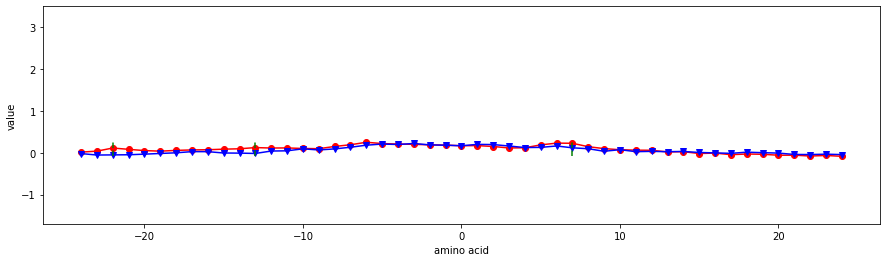

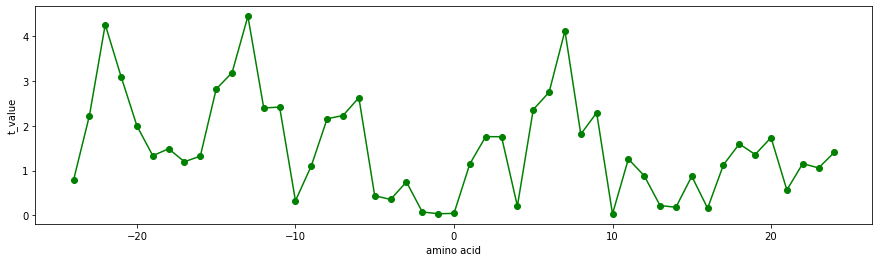

QIAN880113
Weights for alpha-helix at the window position of 6 (Qian-Sejnowski, 1988)


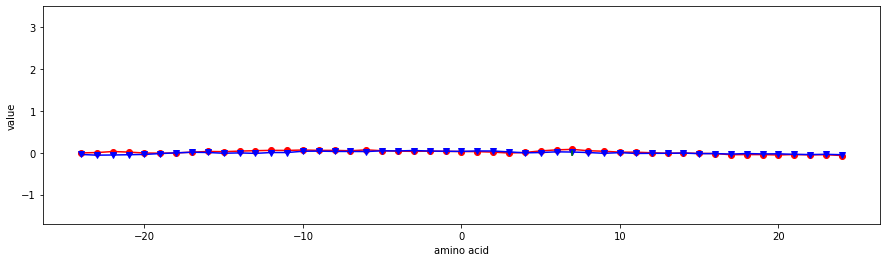

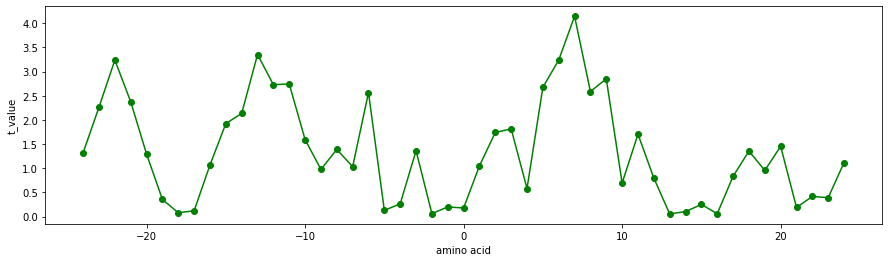

QIAN880114
Weights for beta-sheet at the window position of -6 (Qian-Sejnowski, 1988)


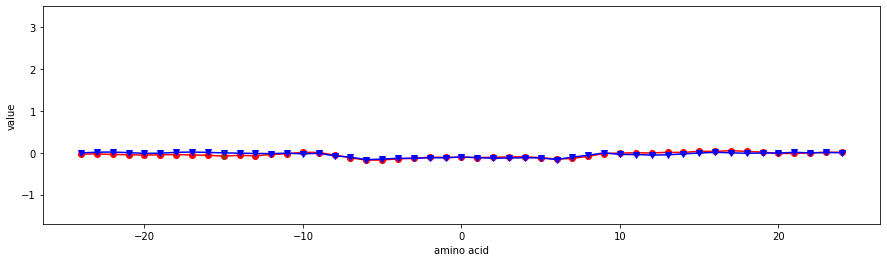

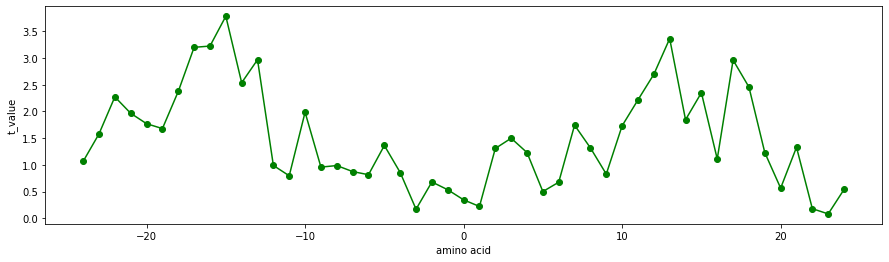

QIAN880116
Weights for beta-sheet at the window position of -4 (Qian-Sejnowski, 1988)


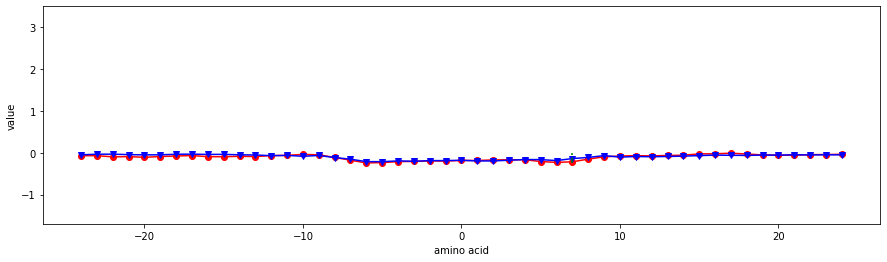

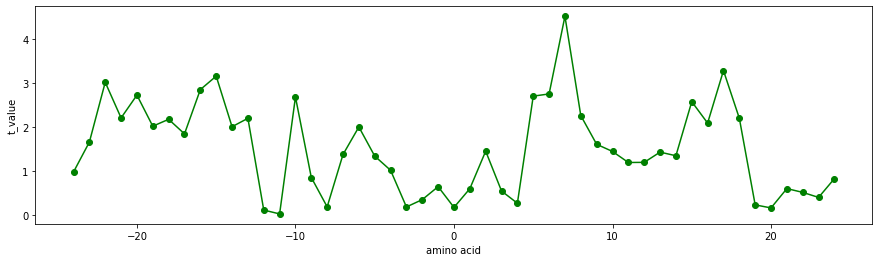

QIAN880118
Weights for beta-sheet at the window position of -2 (Qian-Sejnowski, 1988)


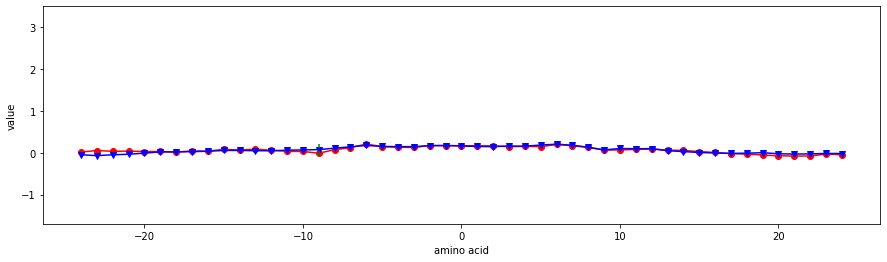

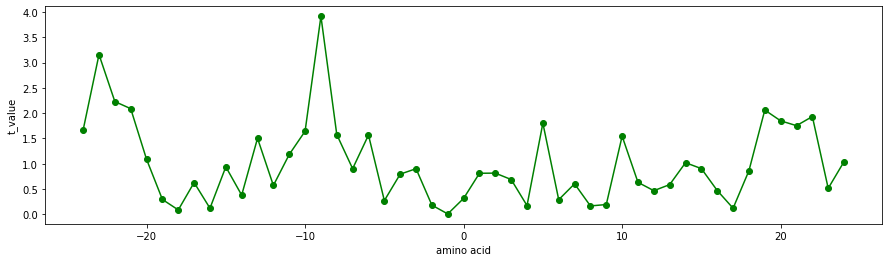

QIAN880121
Weights for beta-sheet at the window position of 1 (Qian-Sejnowski, 1988)


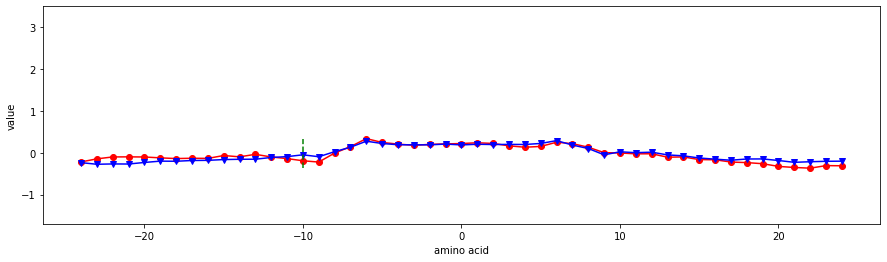

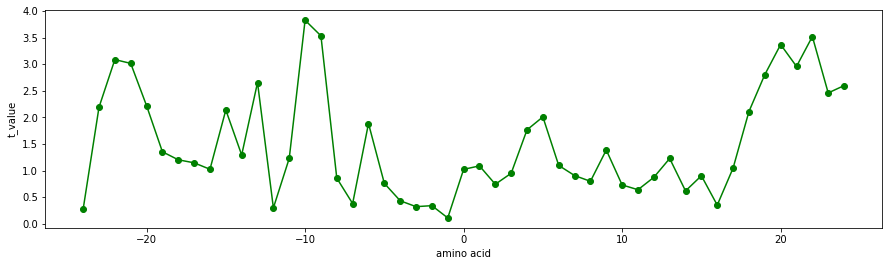

QIAN880122
Weights for beta-sheet at the window position of 2 (Qian-Sejnowski, 1988)


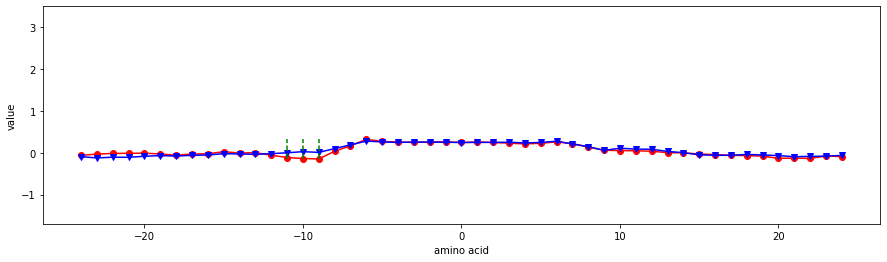

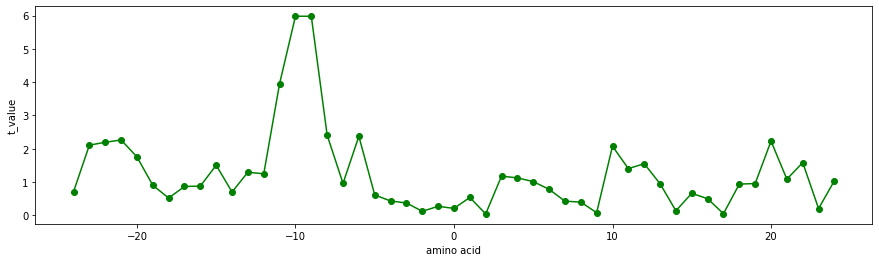

QIAN880126
Weights for beta-sheet at the window position of 6 (Qian-Sejnowski, 1988)


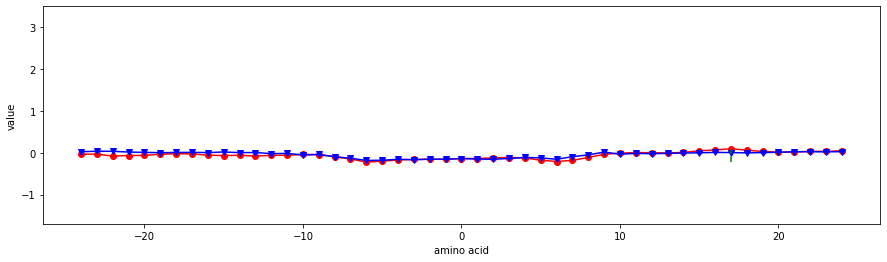

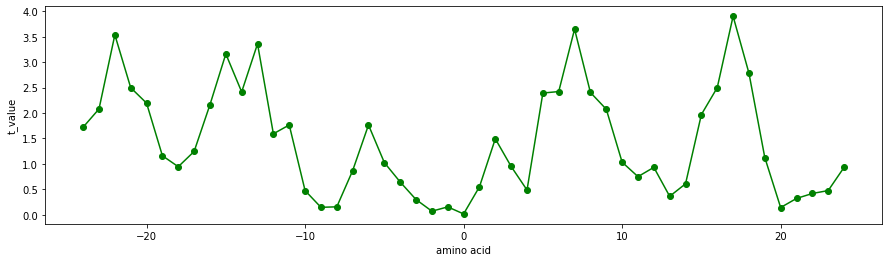

QIAN880127
Weights for coil at the window position of -6 (Qian-Sejnowski, 1988)


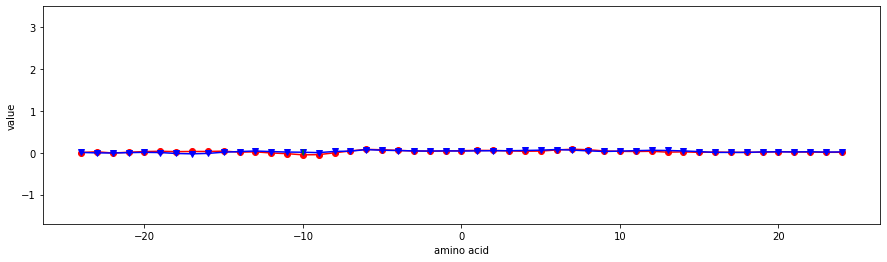

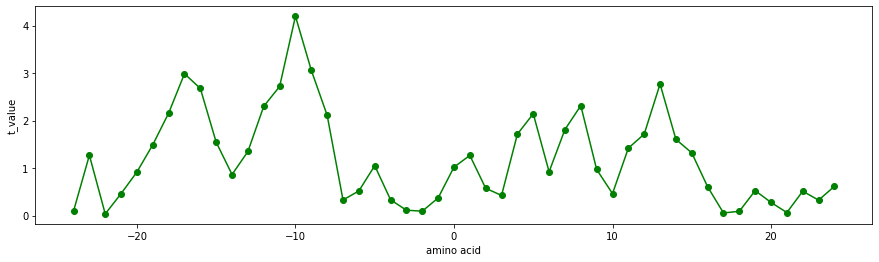

QIAN880129
Weights for coil at the window position of -4 (Qian-Sejnowski, 1988)


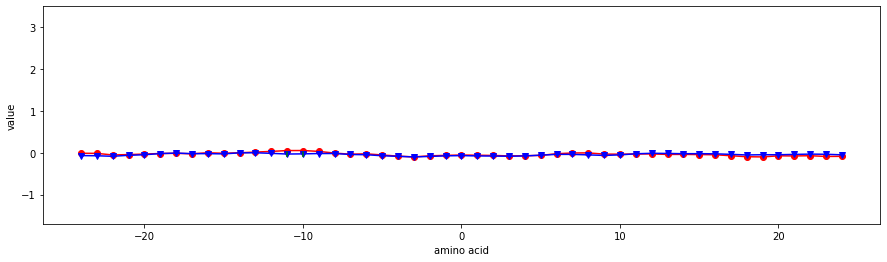

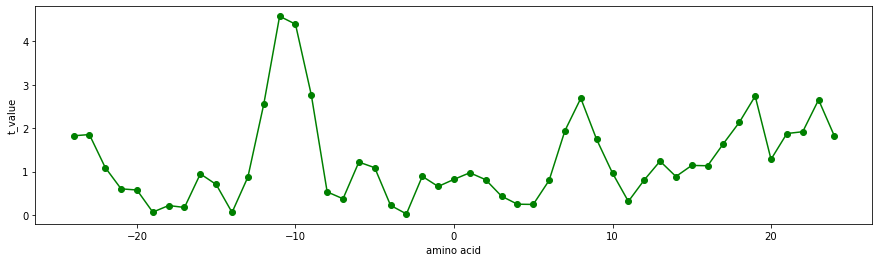

QIAN880131
Weights for coil at the window position of -2 (Qian-Sejnowski, 1988)


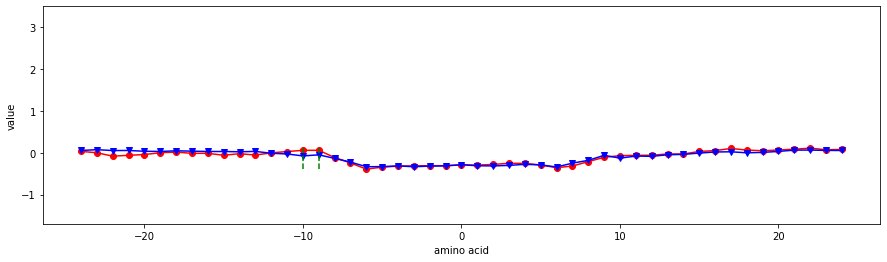

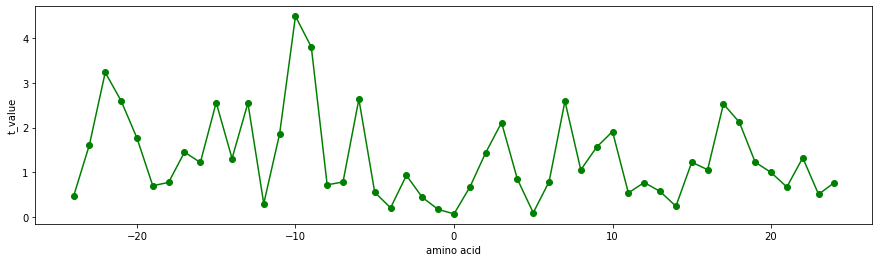

QIAN880132
Weights for coil at the window position of -1 (Qian-Sejnowski, 1988)


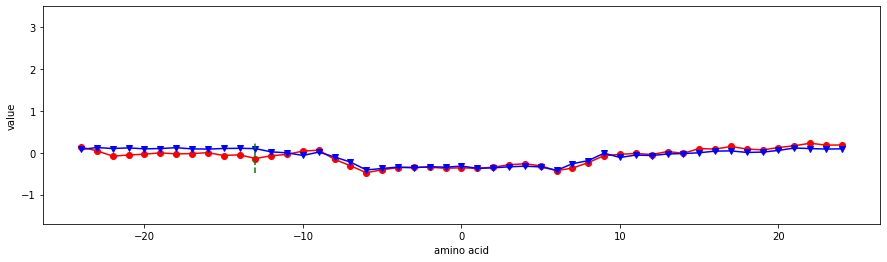

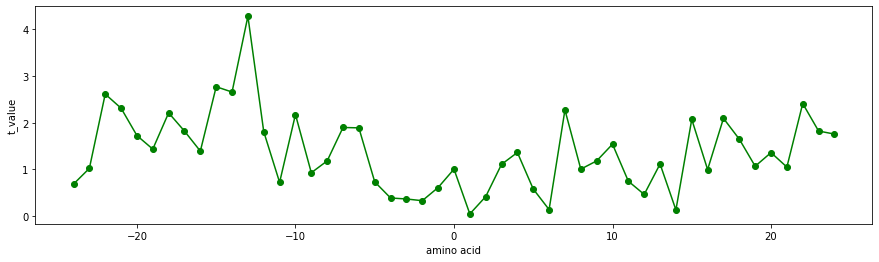

QIAN880133
Weights for coil at the window position of 0 (Qian-Sejnowski, 1988)


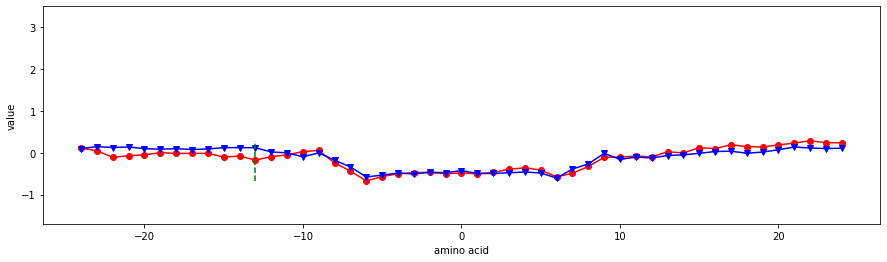

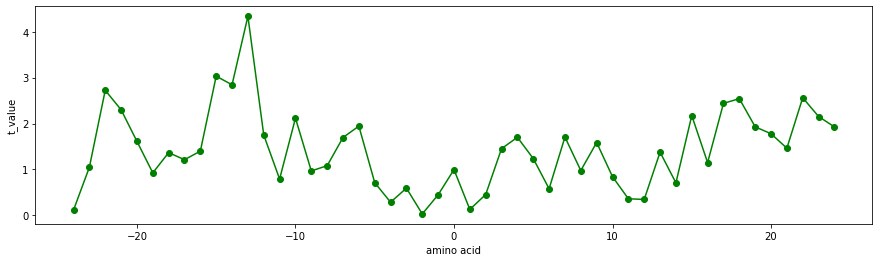

QIAN880136
Weights for coil at the window position of 3 (Qian-Sejnowski, 1988)


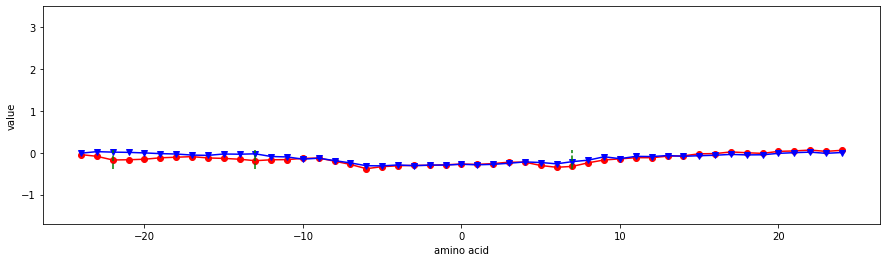

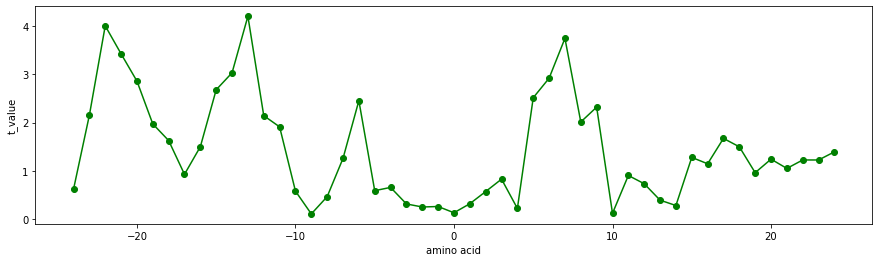

RACS770101
Average reduced distance for C-alpha (Rackovsky-Scheraga, 1977)


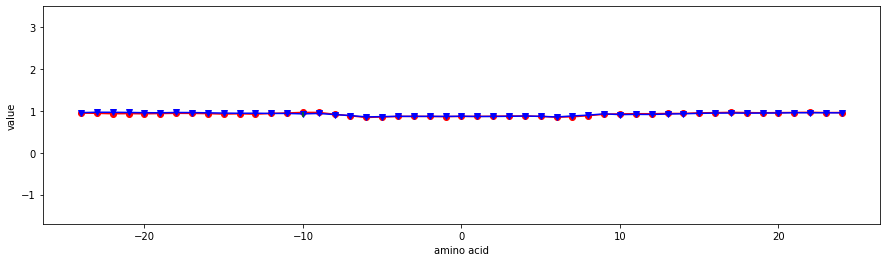

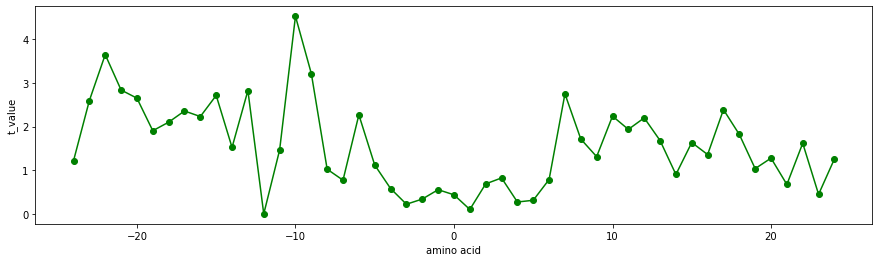

RACS770102
Average reduced distance for side chain (Rackovsky-Scheraga, 1977)


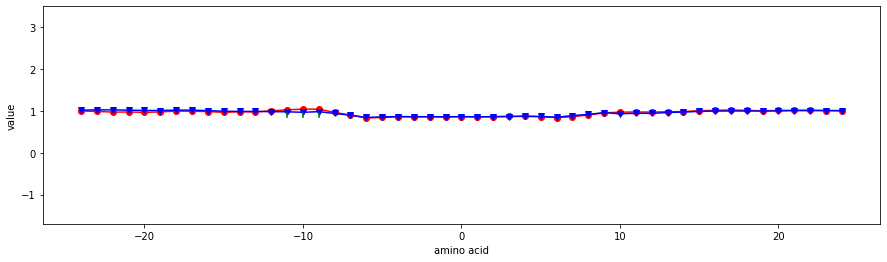

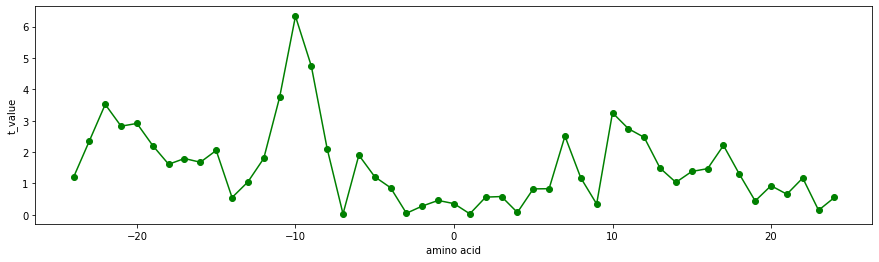

RACS770103
Side chain orientational preference (Rackovsky-Scheraga, 1977)


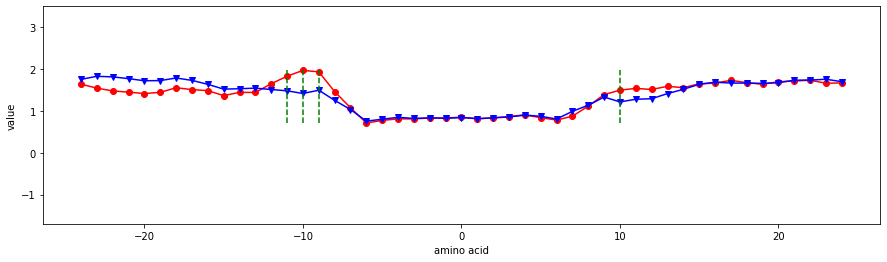

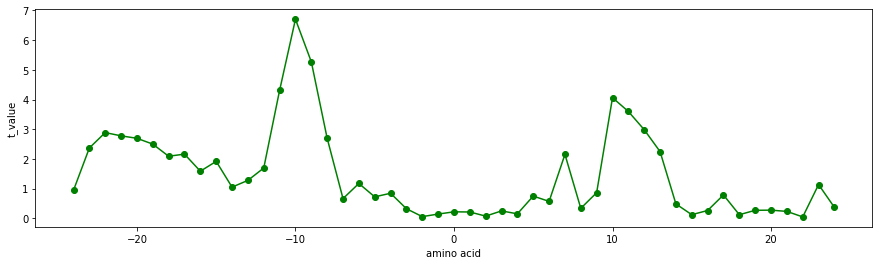

RACS820101
Average relative fractional occurrence in A0(i) (Rackovsky-Scheraga, 1982)


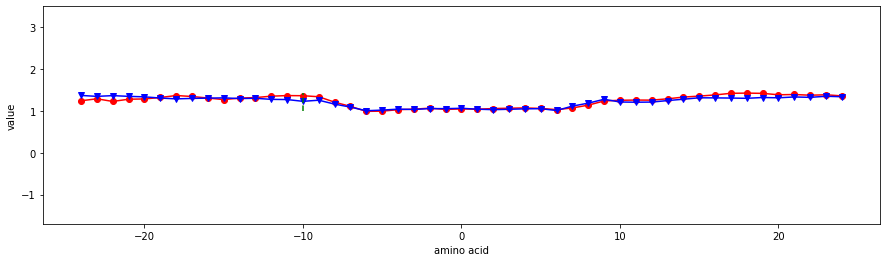

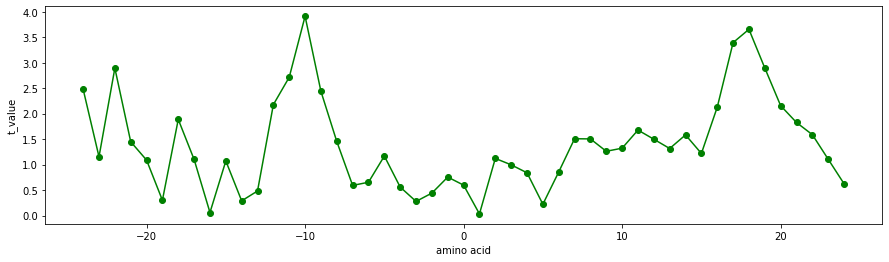

RACS820103
Average relative fractional occurrence in AL(i) (Rackovsky-Scheraga, 1982)


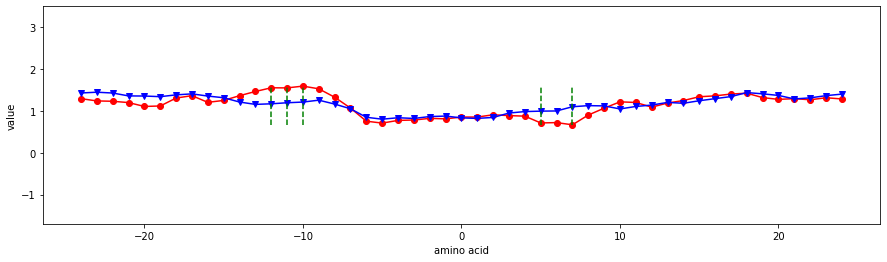

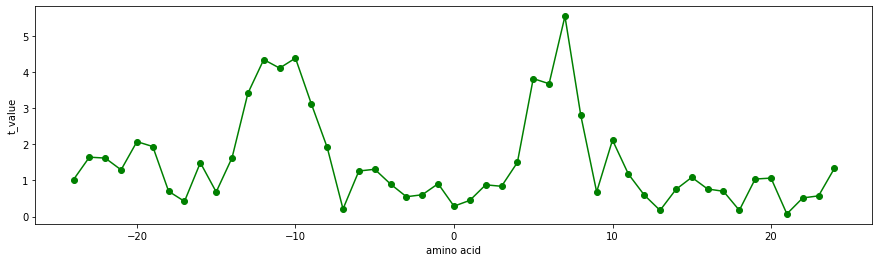

RACS820106
Average relative fractional occurrence in ER(i) (Rackovsky-Scheraga, 1982)


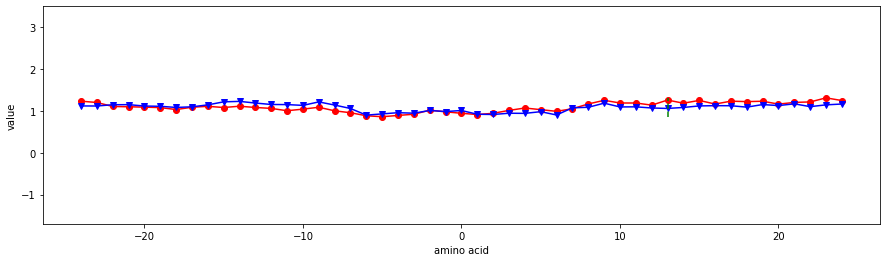

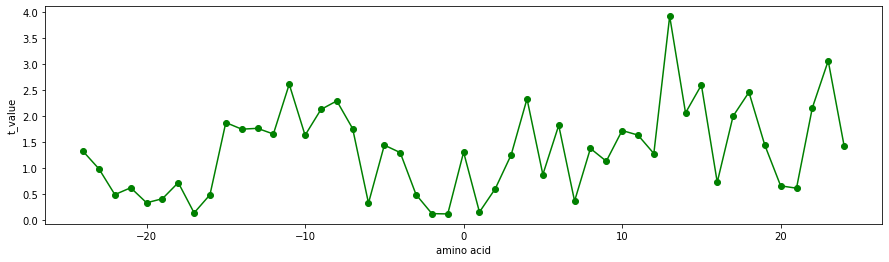

RACS820110
Average relative fractional occurrence in EL(i-1) (Rackovsky-Scheraga, 1982)


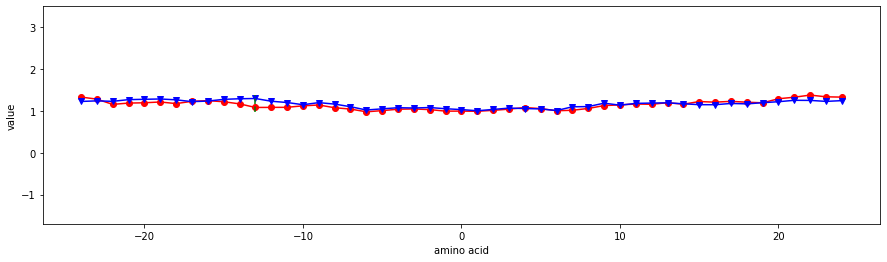

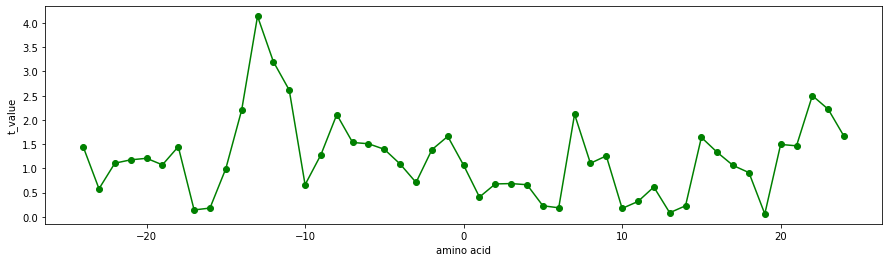

RACS820114
Value of theta(i-1) (Rackovsky-Scheraga, 1982)


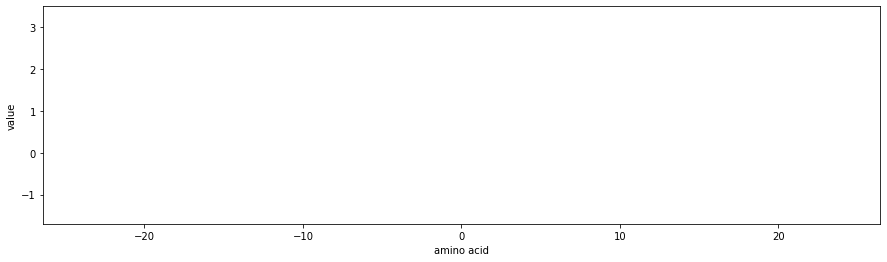

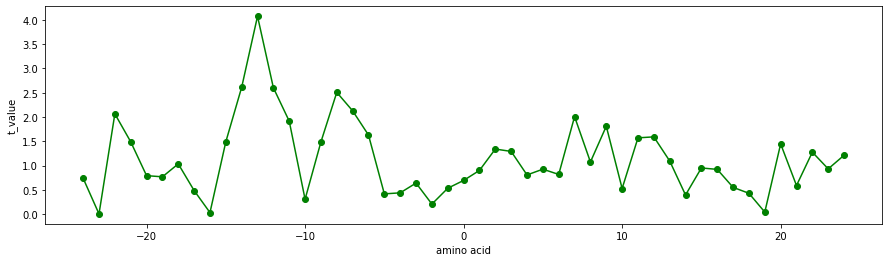

RADA880101
Transfer free energy from chx to wat (Radzicka-Wolfenden, 1988)


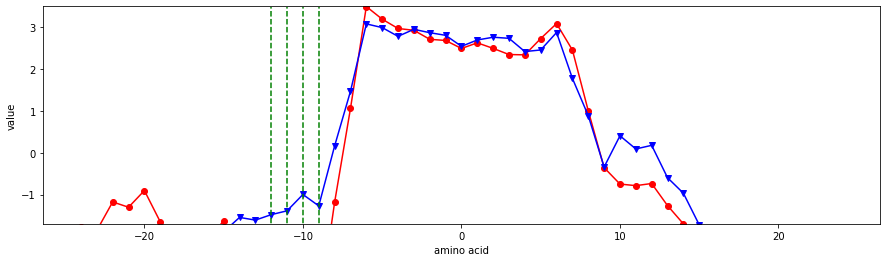

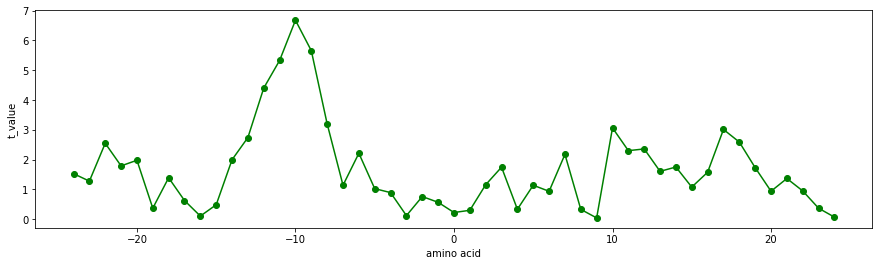

RADA880102
Transfer free energy from oct to wat (Radzicka-Wolfenden, 1988)


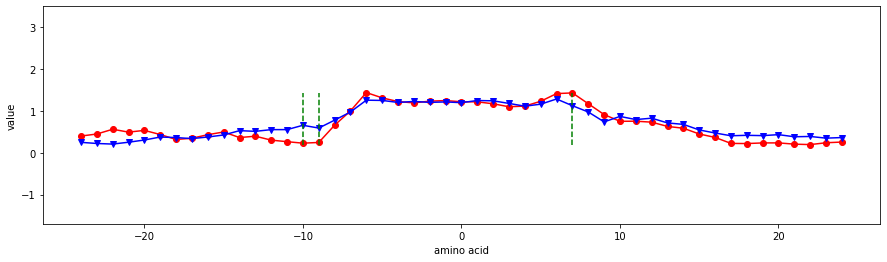

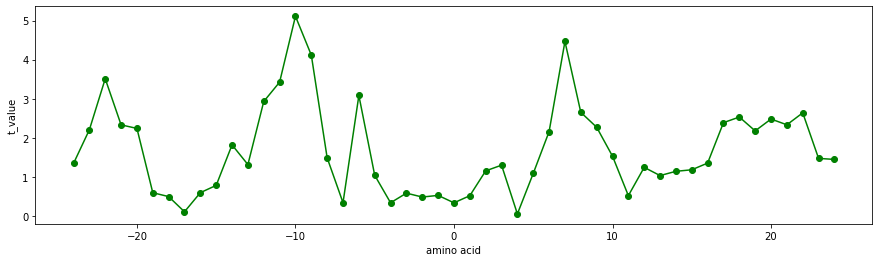

RADA880103
Transfer free energy from vap to chx (Radzicka-Wolfenden, 1988)


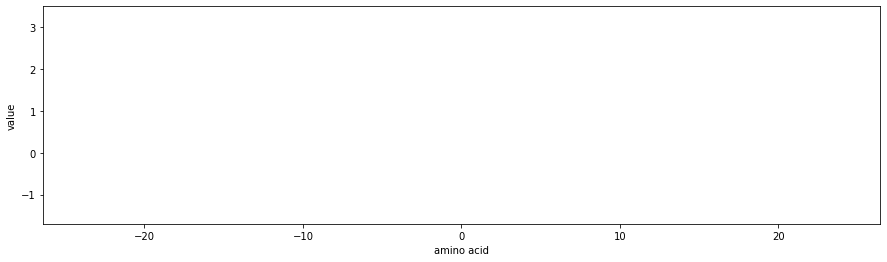

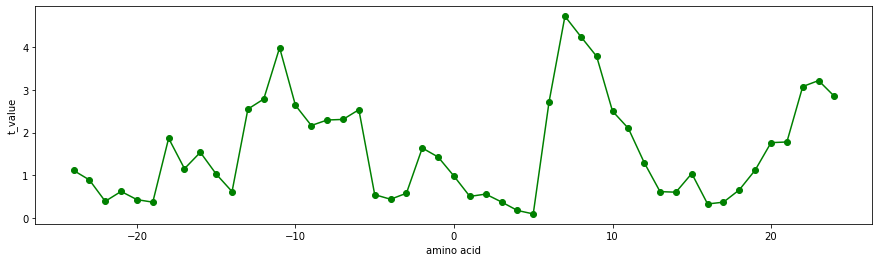

RADA880104
Transfer free energy from chx to oct (Radzicka-Wolfenden, 1988)


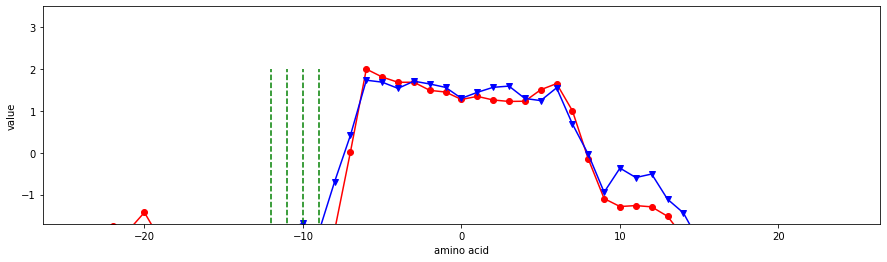

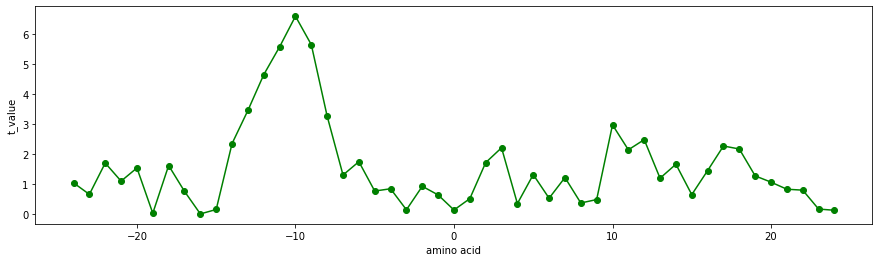

RADA880105
Transfer free energy from vap to oct (Radzicka-Wolfenden, 1988)


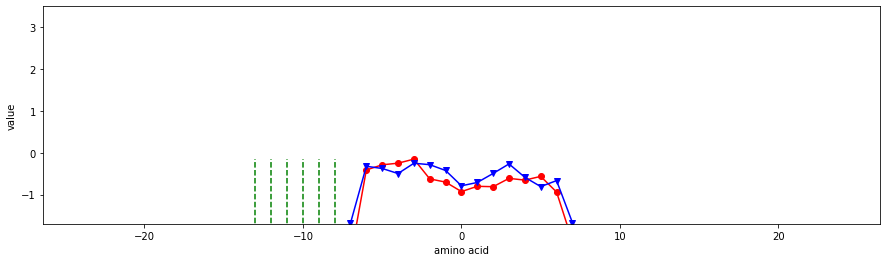

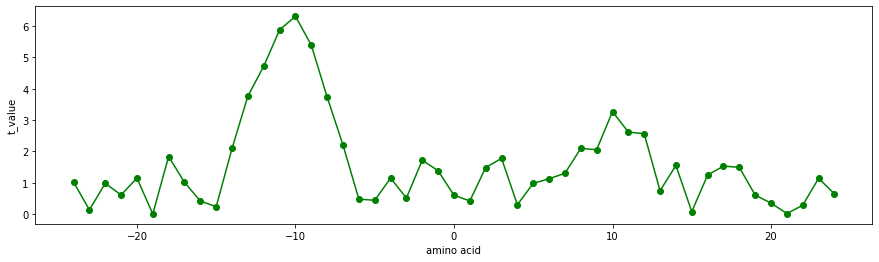

RADA880106
Accessible surface area (Radzicka-Wolfenden, 1988)


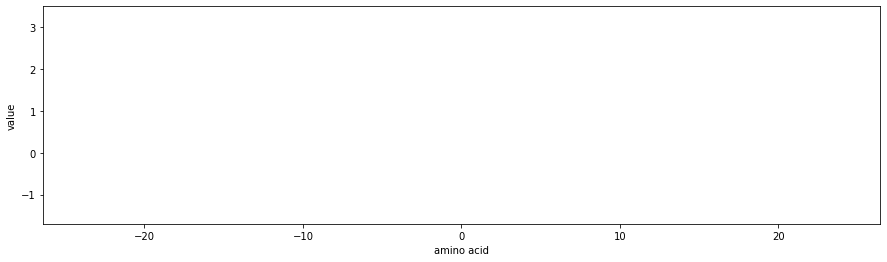

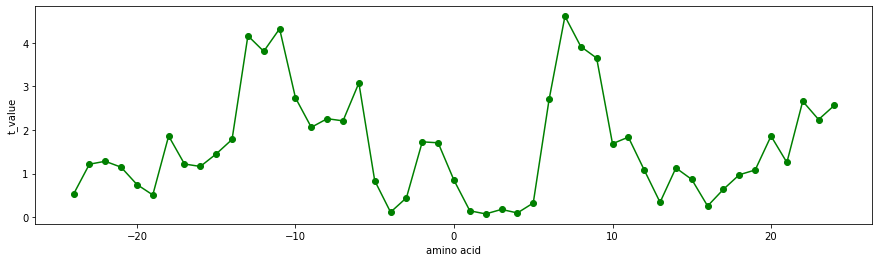

RADA880107
Energy transfer from out to in(95%buried) (Radzicka-Wolfenden, 1988)


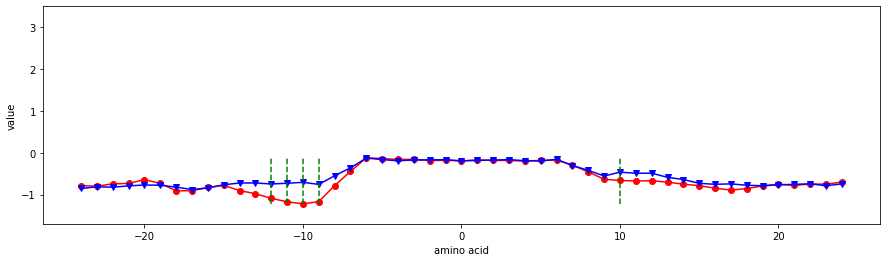

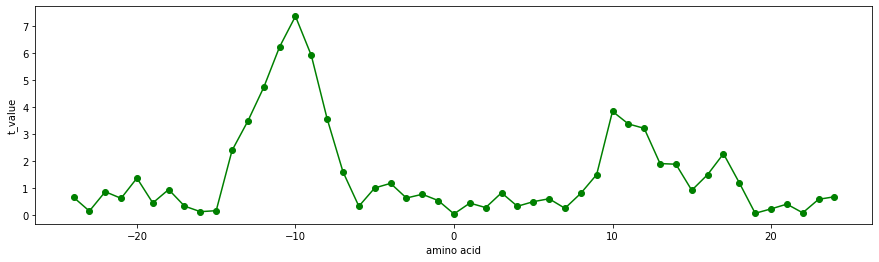

RADA880108
Mean polarity (Radzicka-Wolfenden, 1988)


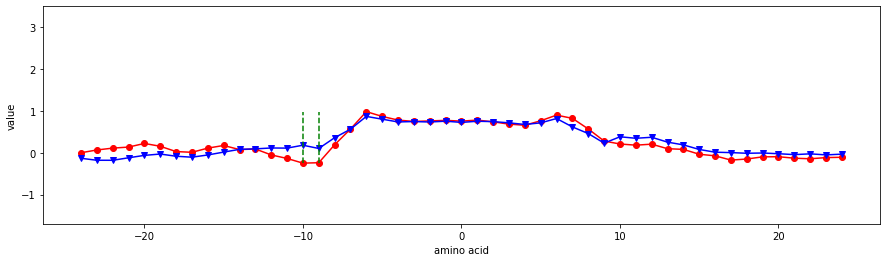

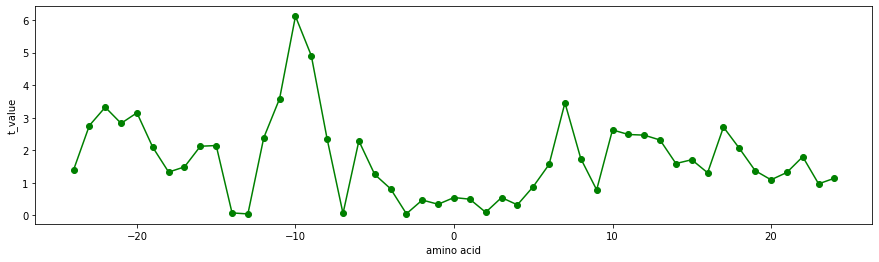

RICJ880101
Relative preference value at N" (Richardson-Richardson, 1988)


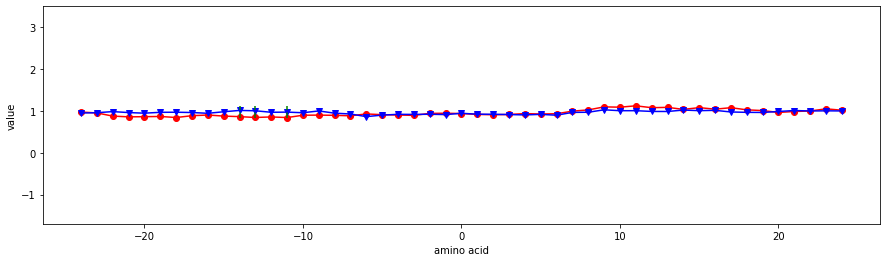

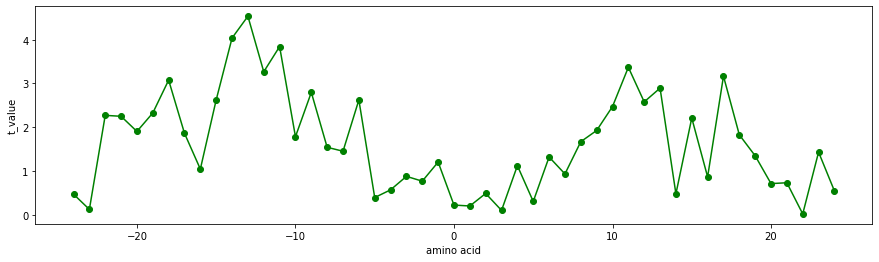

RICJ880102
Relative preference value at N' (Richardson-Richardson, 1988)


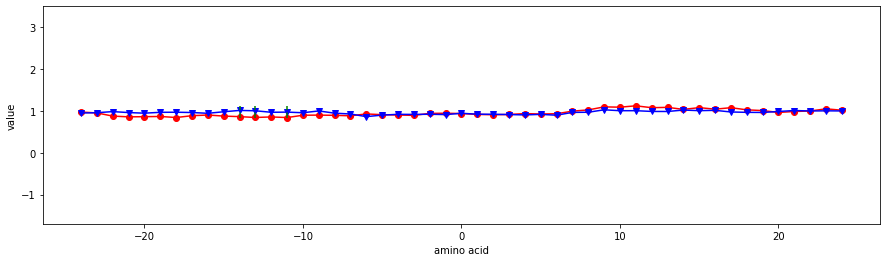

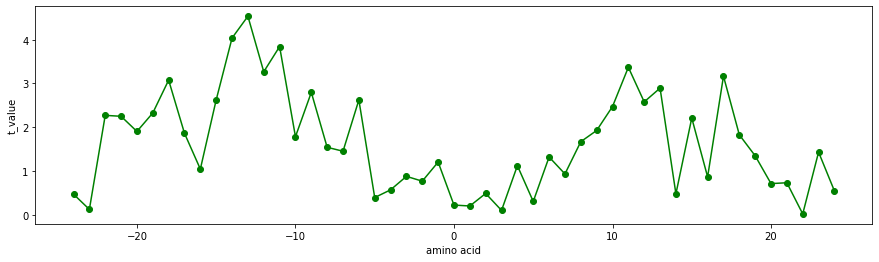

RICJ880104
Relative preference value at N1 (Richardson-Richardson, 1988)


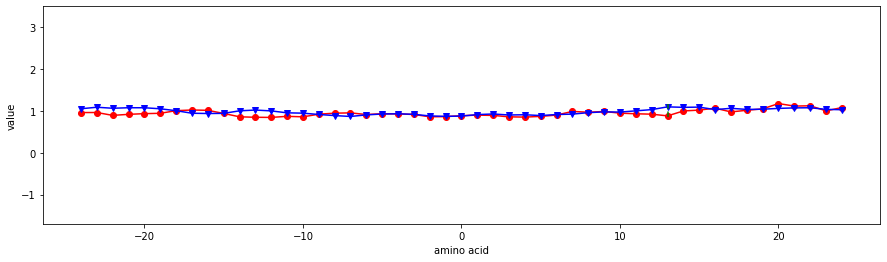

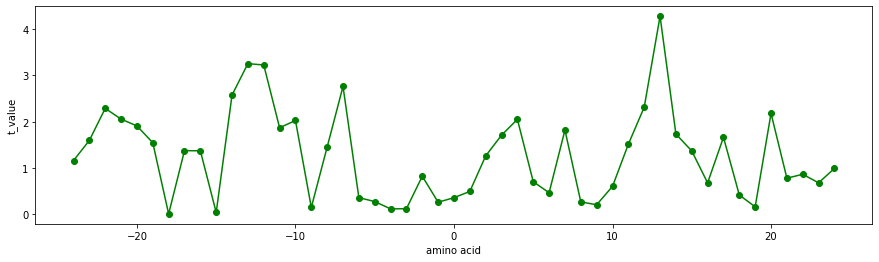

RICJ880105
Relative preference value at N2 (Richardson-Richardson, 1988)


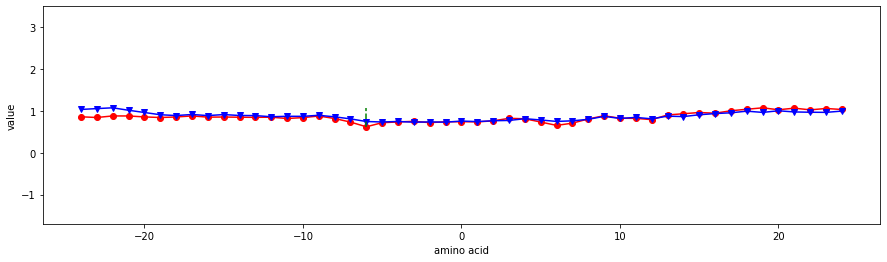

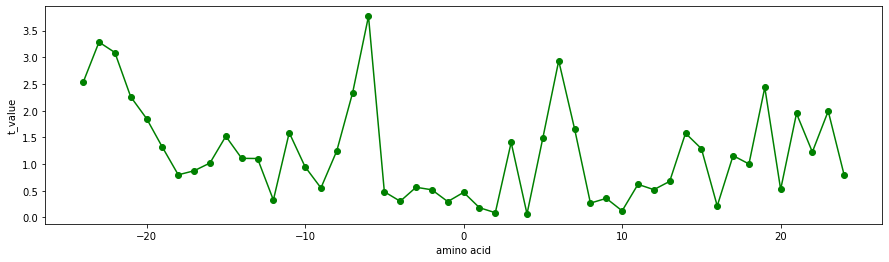

RICJ880107
Relative preference value at N4 (Richardson-Richardson, 1988)


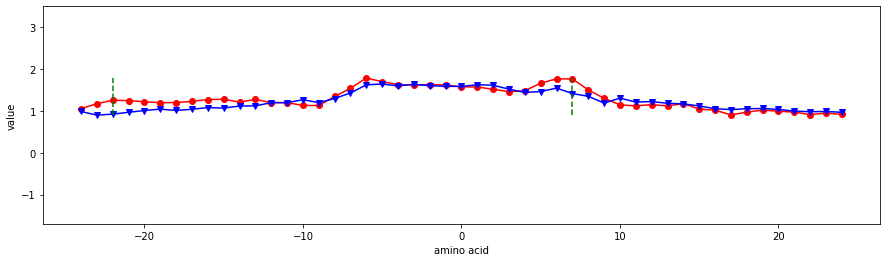

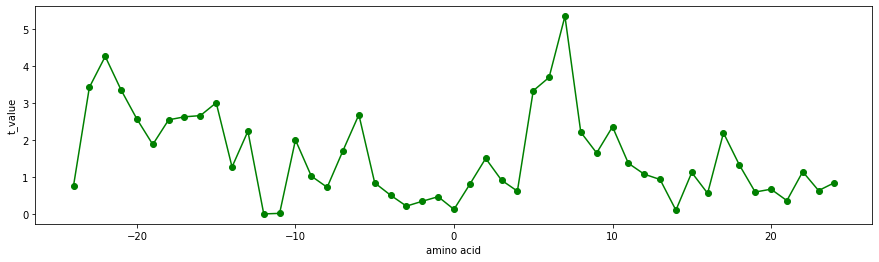

RICJ880109
Relative preference value at Mid (Richardson-Richardson, 1988)


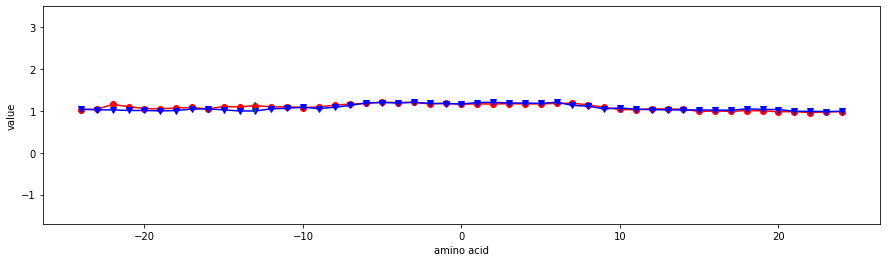

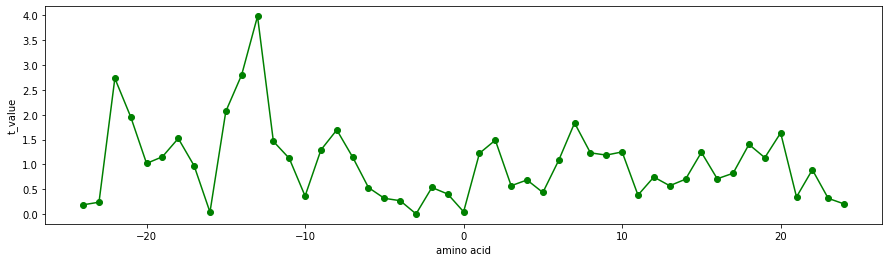

RICJ880110
Relative preference value at C5 (Richardson-Richardson, 1988)


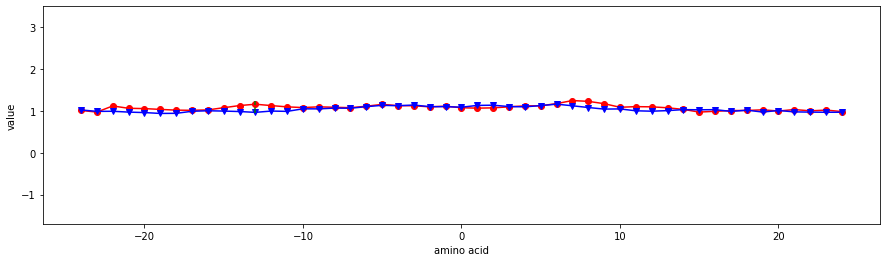

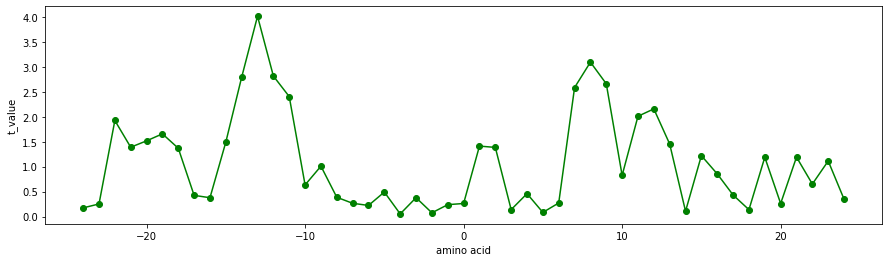

RICJ880111
Relative preference value at C4 (Richardson-Richardson, 1988)


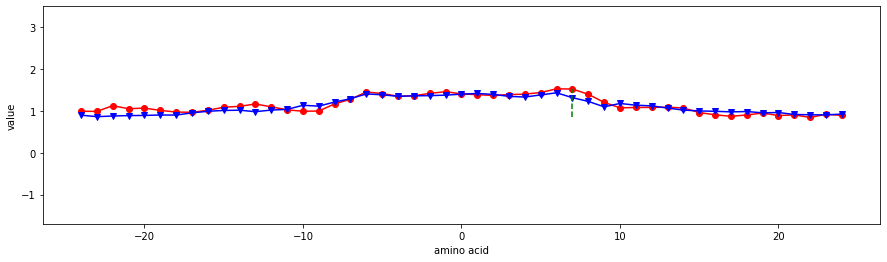

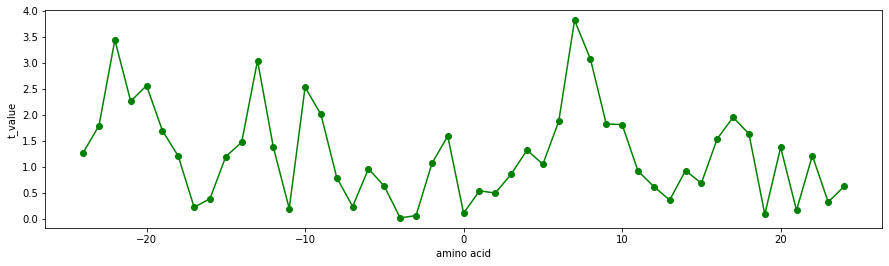

RICJ880112
Relative preference value at C3 (Richardson-Richardson, 1988)


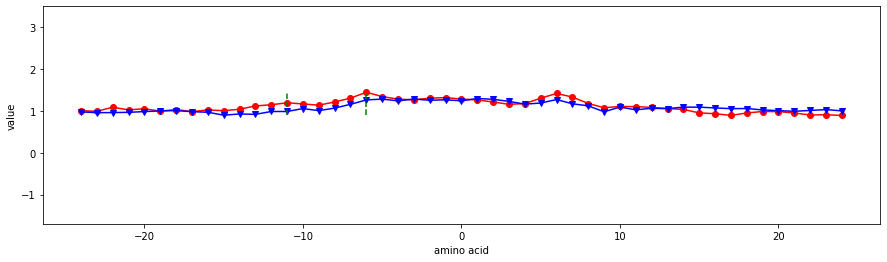

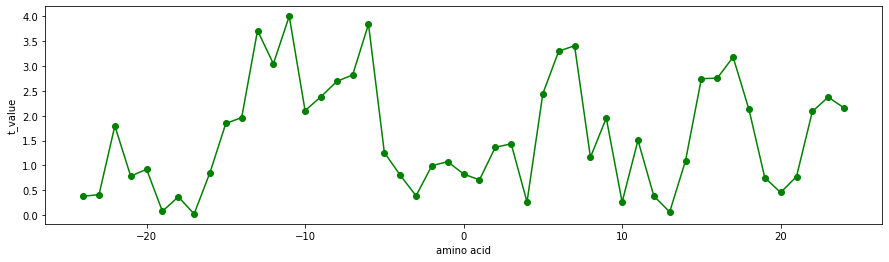

RICJ880113
Relative preference value at C2 (Richardson-Richardson, 1988)


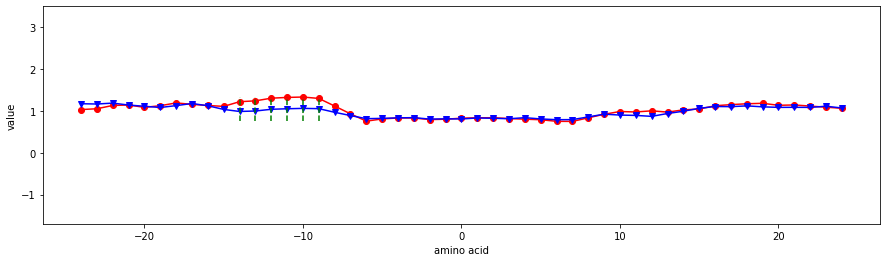

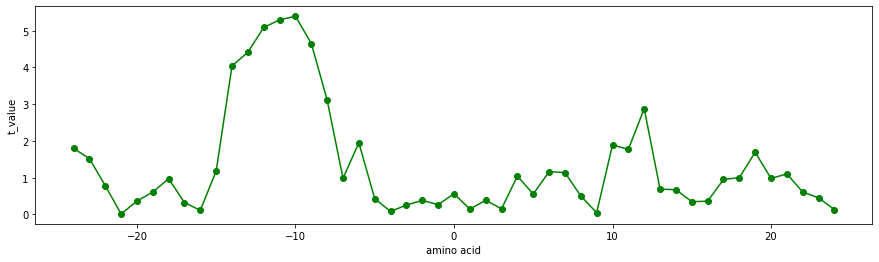

RICJ880114
Relative preference value at C1 (Richardson-Richardson, 1988)


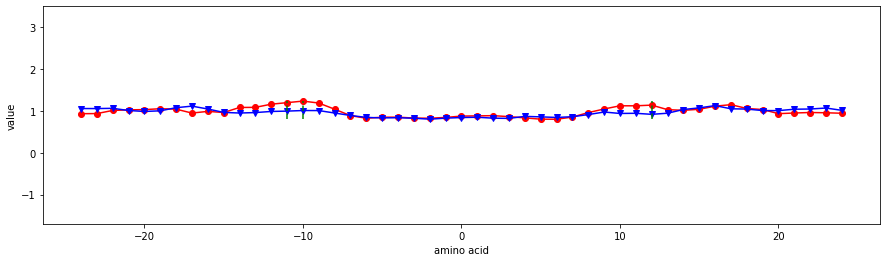

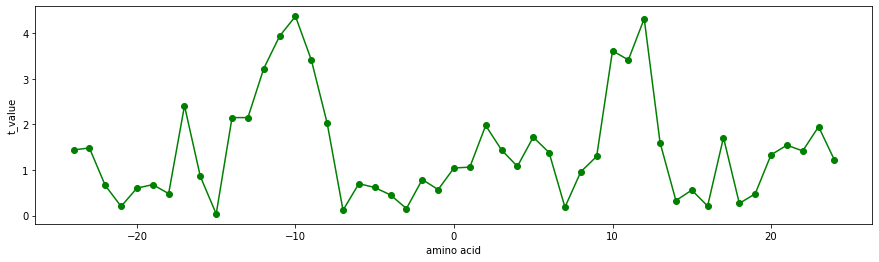

RICJ880116
Relative preference value at C' (Richardson-Richardson, 1988)


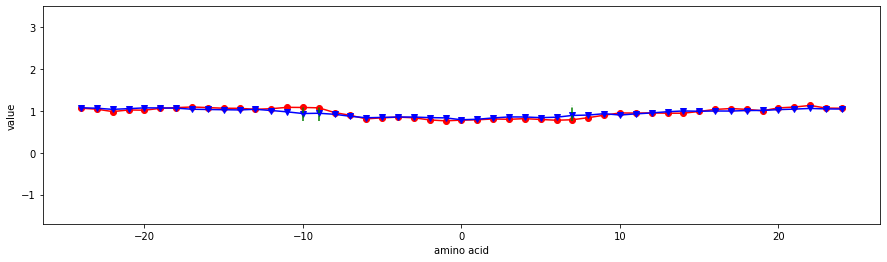

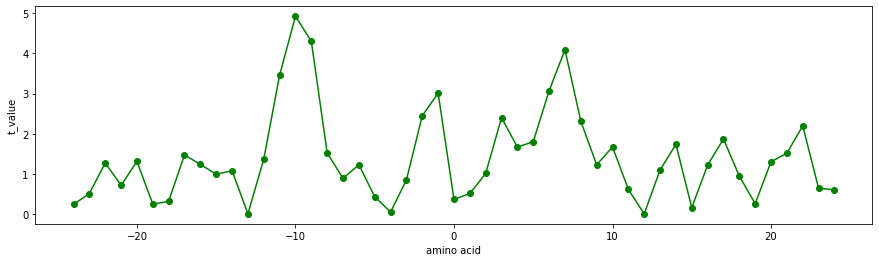

ROBB760103
Information measure for middle helix (Robson-Suzuki, 1976)


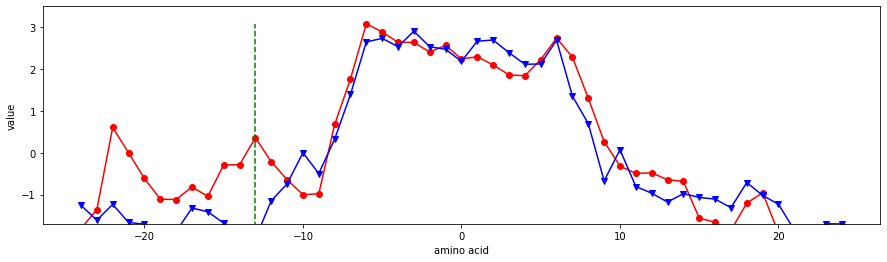

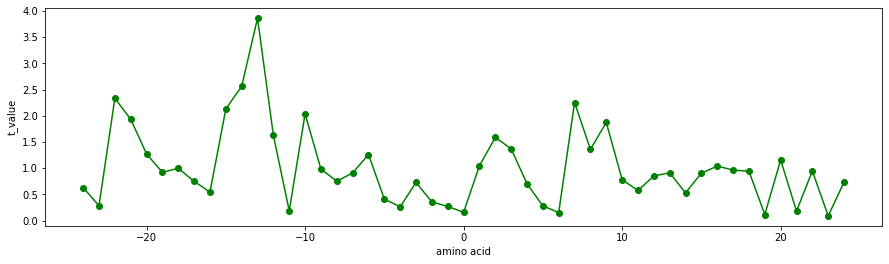

ROBB760104
Information measure for C-terminal helix (Robson-Suzuki, 1976)


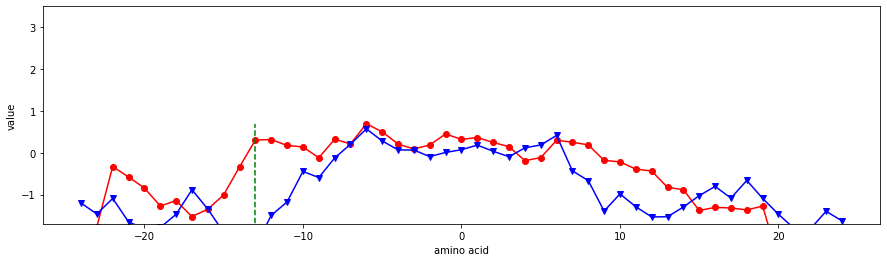

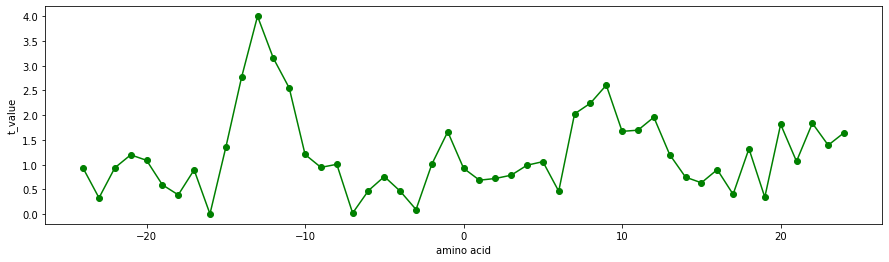

ROBB760105
Information measure for extended (Robson-Suzuki, 1976)


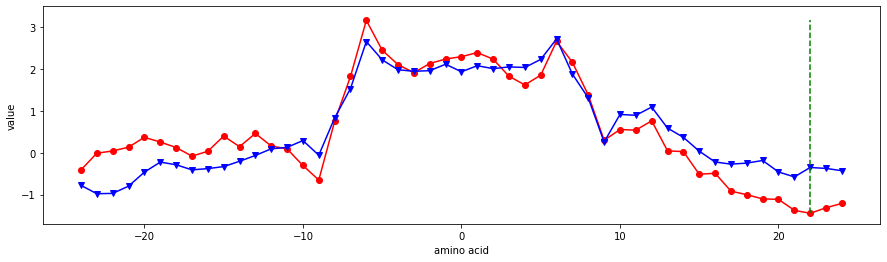

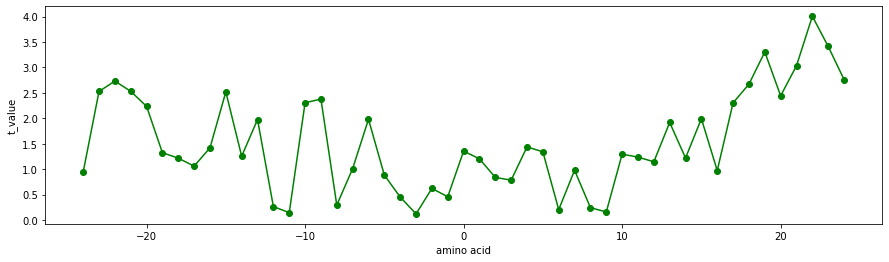

ROBB760106
Information measure for pleated-sheet (Robson-Suzuki, 1976)


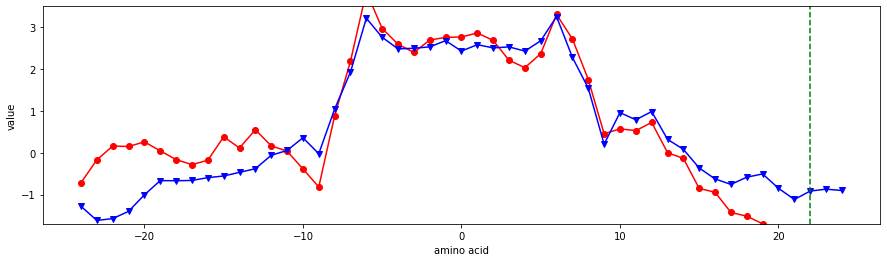

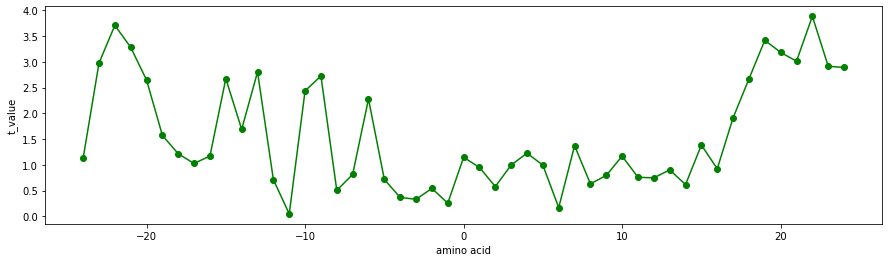

ROBB760112
Information measure for coil (Robson-Suzuki, 1976)


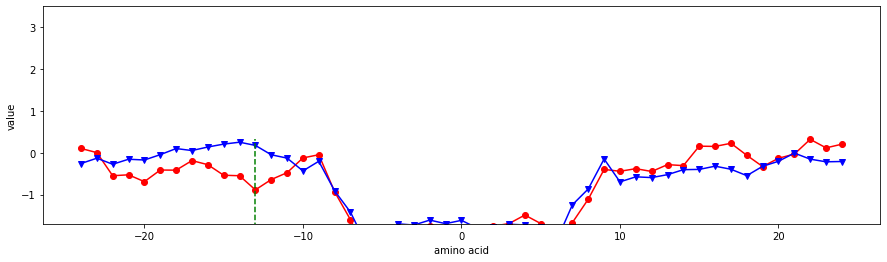

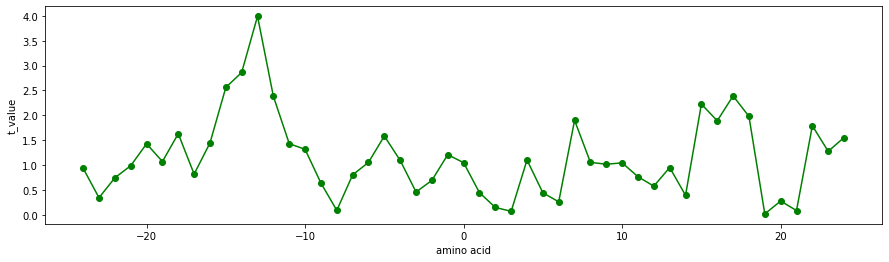

ROSG850101
Mean area buried on transfer (Rose et al., 1985)


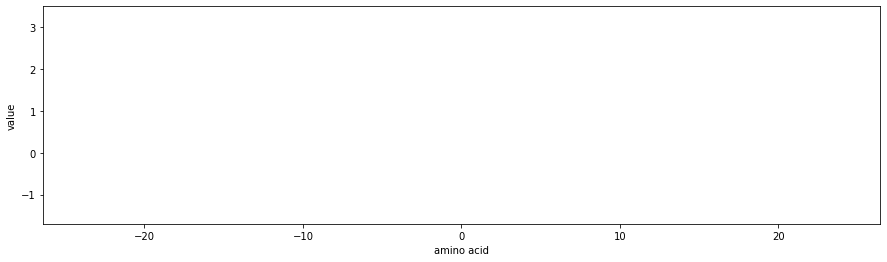

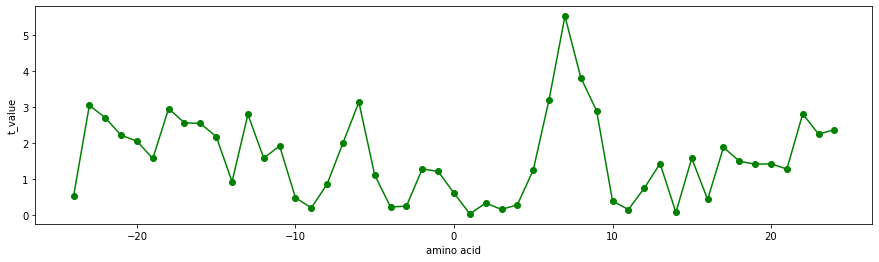

ROSG850102
Mean fractional area loss (Rose et al., 1985)


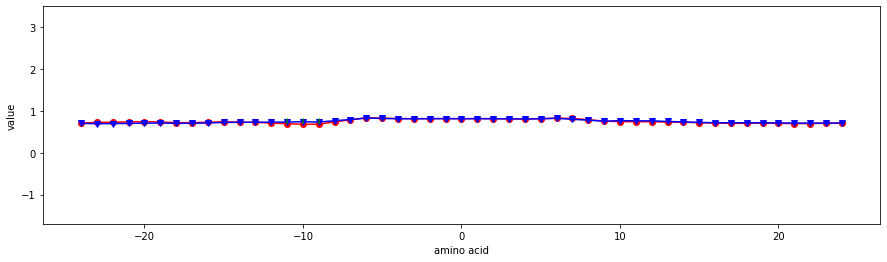

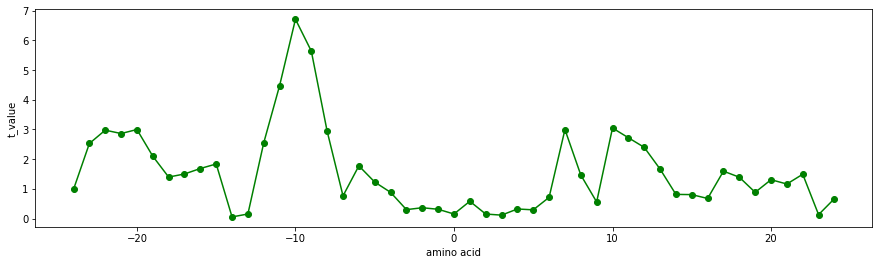

ROSM880101
Side chain hydropathy, uncorrected for solvation (Roseman, 1988)


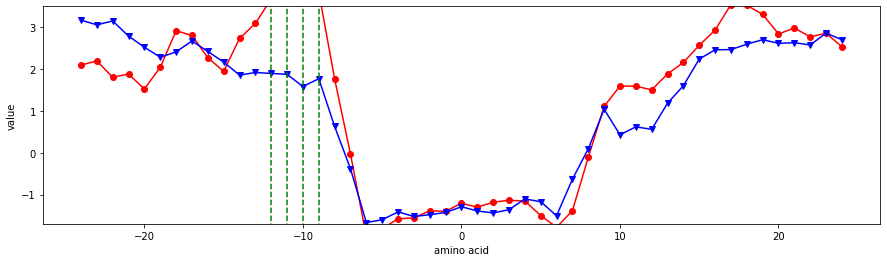

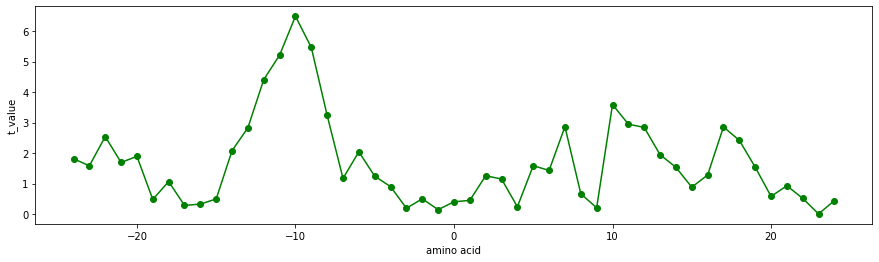

ROSM880102
Side chain hydropathy, corrected for solvation (Roseman, 1988)


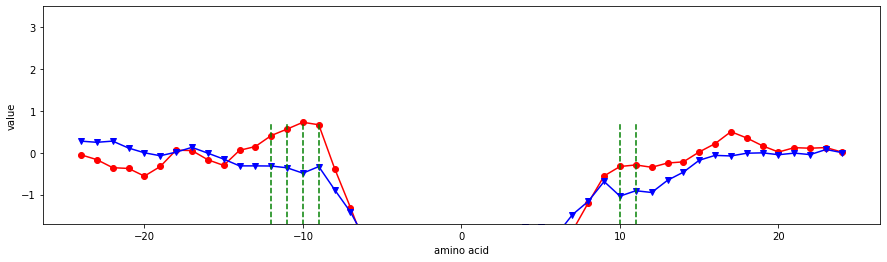

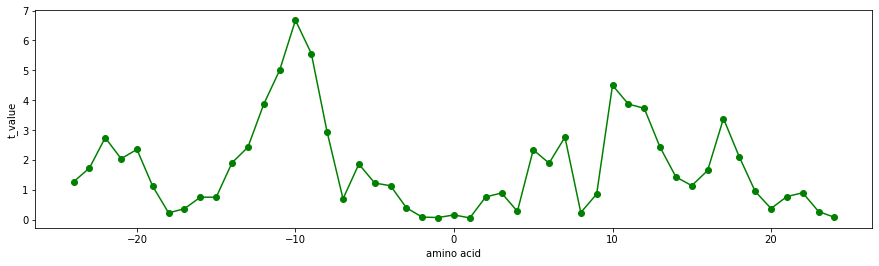

ROSM880103
Loss of Side chain hydropathy by helix formation (Roseman, 1988)


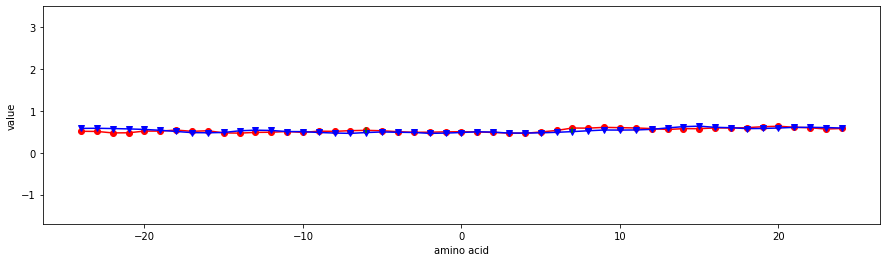

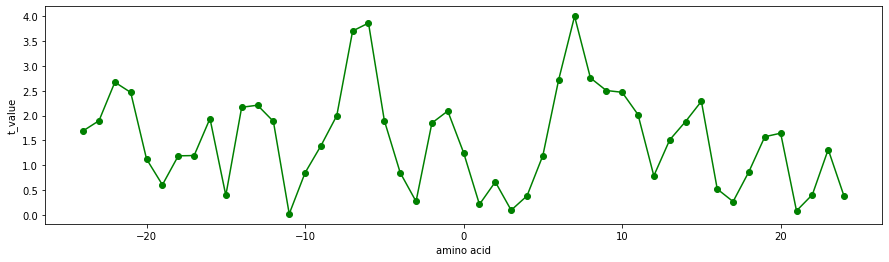

SIMZ760101
Transfer free energy (Simon, 1976), Cited by Charton-Charton (1982)


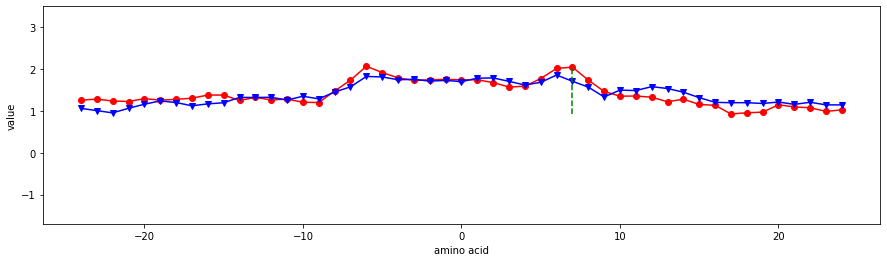

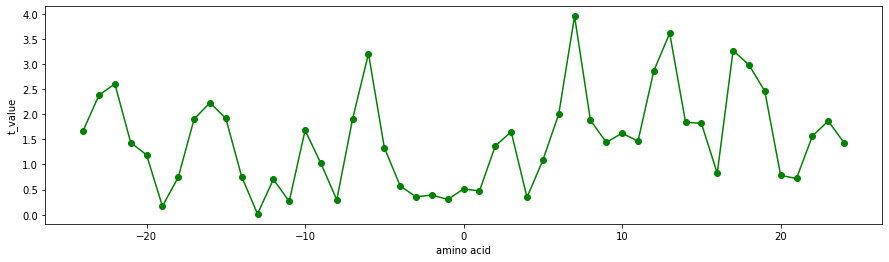

SNEP660101
Principal component I (Sneath, 1966)


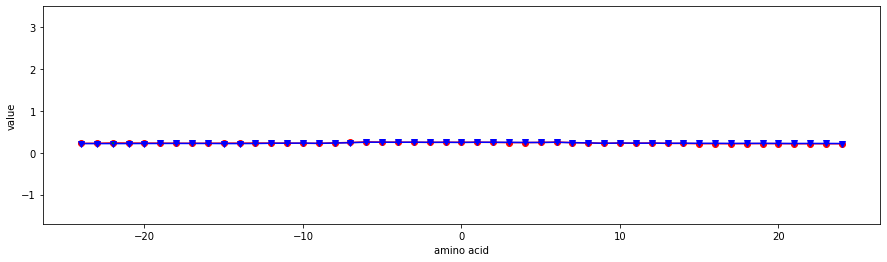

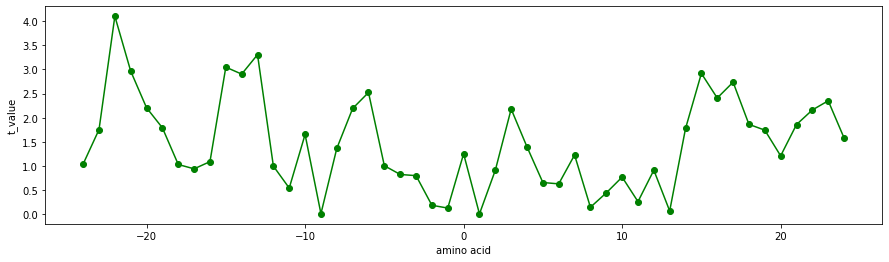

SNEP660102
Principal component II (Sneath, 1966)


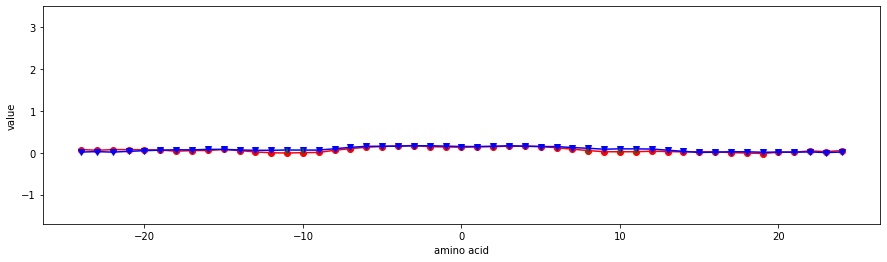

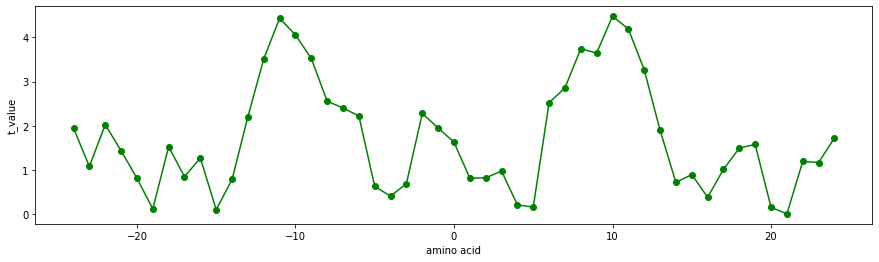

SNEP660103
Principal component III (Sneath, 1966)


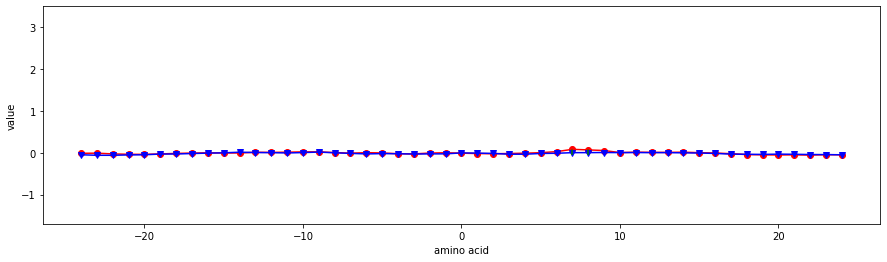

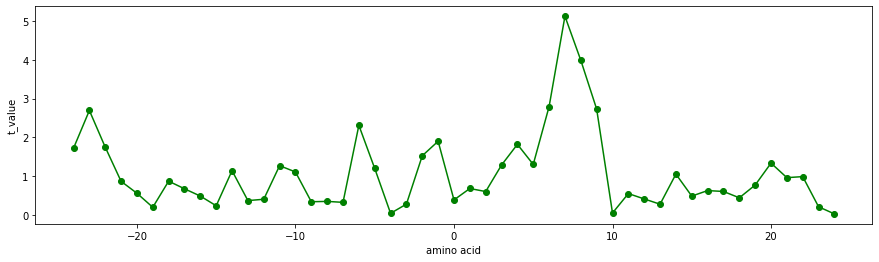

SUEM840101
Zimm-Bragg parameter s at 20 C (Sueki et al., 1984)


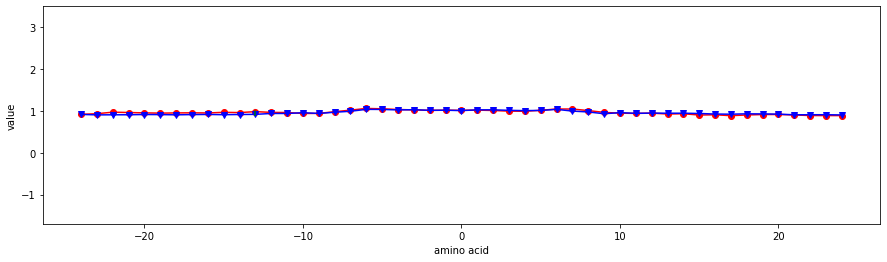

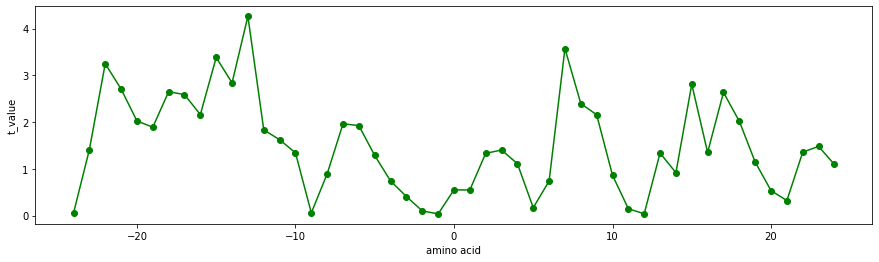

SWER830101
Optimal matching hydrophobicity (Sweet-Eisenberg, 1983)


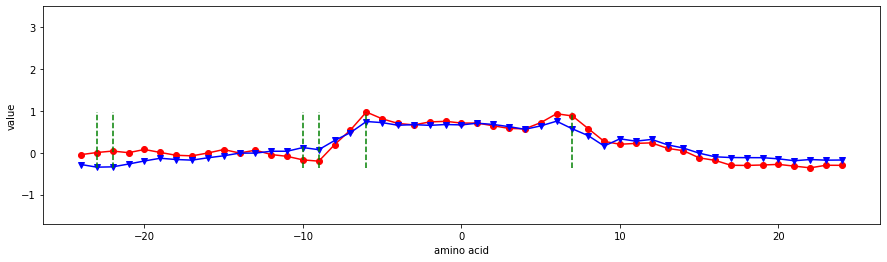

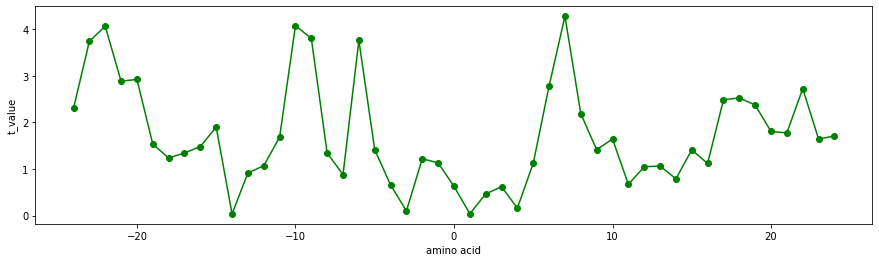

TANS770101
Normalized frequency of alpha-helix (Tanaka-Scheraga, 1977)


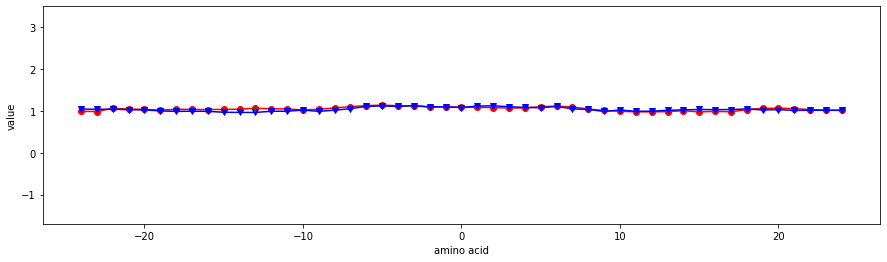

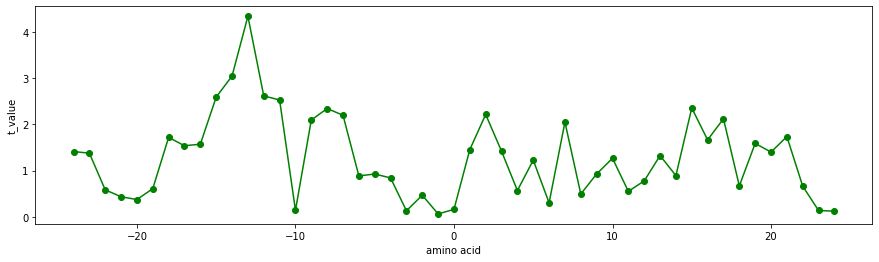

TANS770105
Normalized frequency of chain reversal S (Tanaka-Scheraga, 1977)


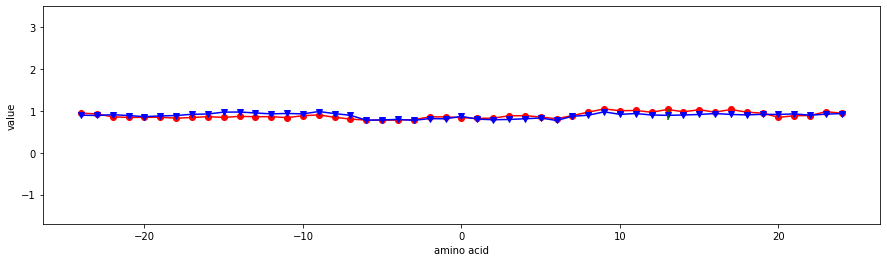

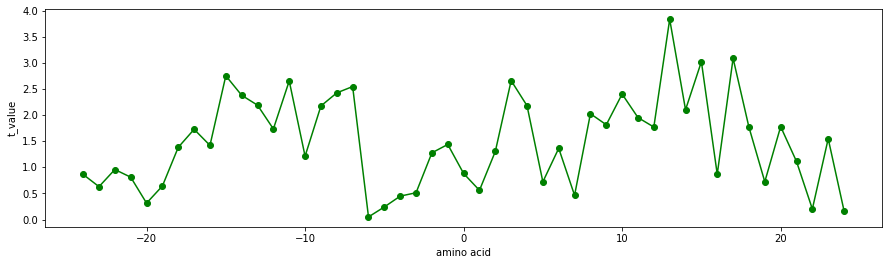

TANS770106
Normalized frequency of chain reversal D (Tanaka-Scheraga, 1977)


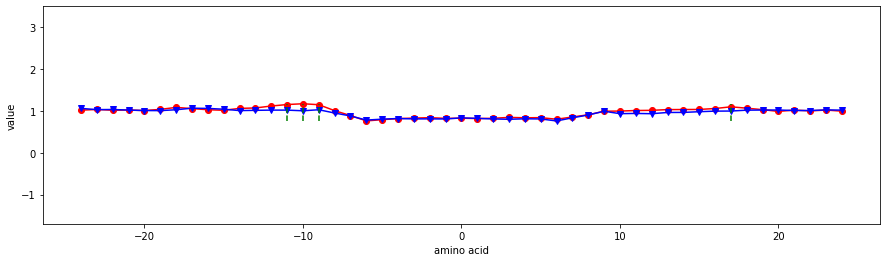

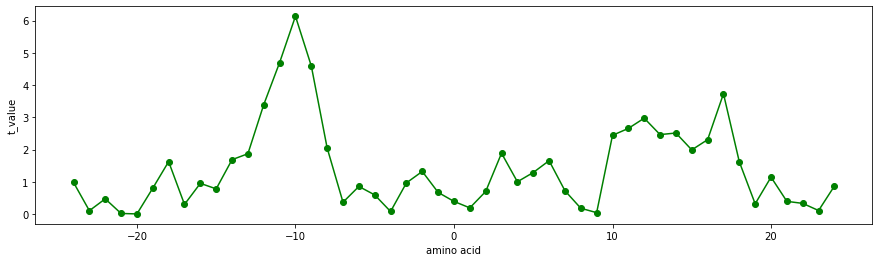

TANS770107
Normalized frequency of left-handed helix (Tanaka-Scheraga, 1977)


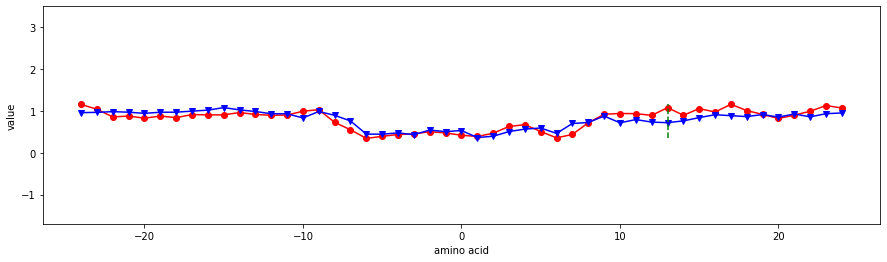

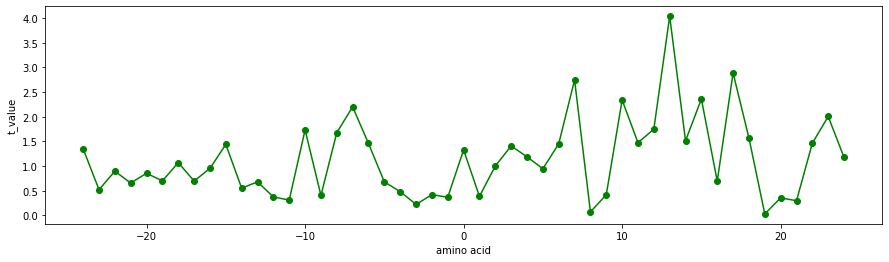

TANS770108
Normalized frequency of zeta R (Tanaka-Scheraga, 1977)


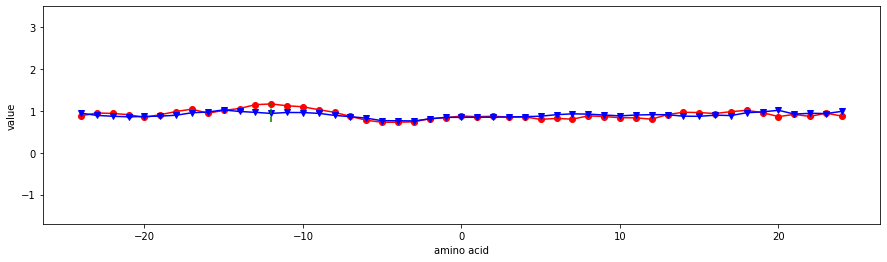

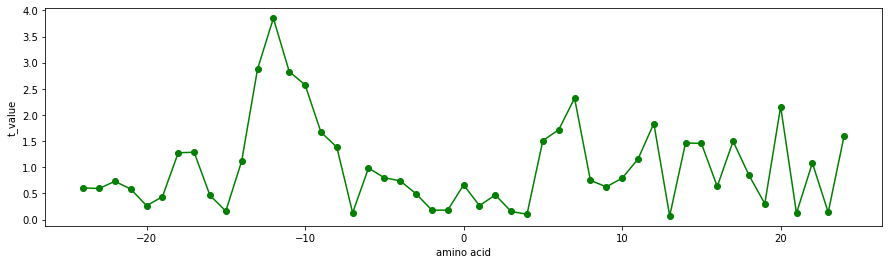

TANS770109
Normalized frequency of coil (Tanaka-Scheraga, 1977)


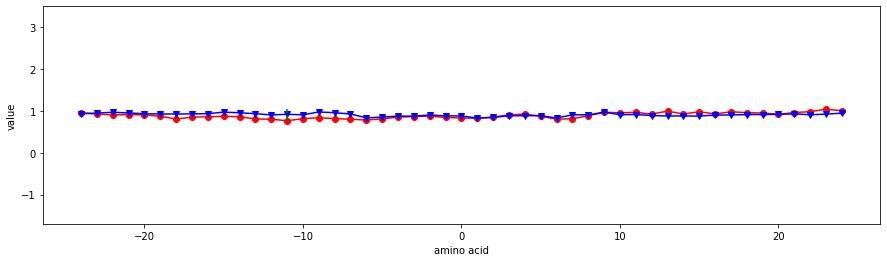

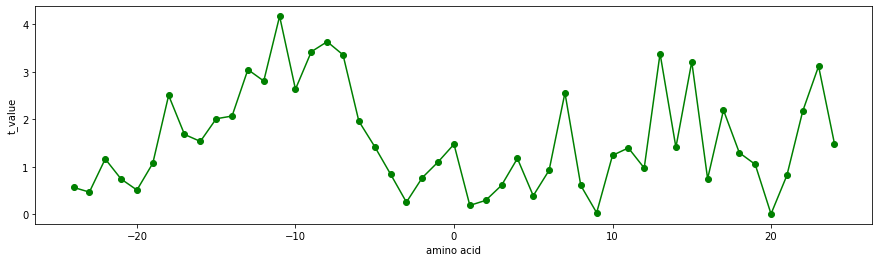

TANS770110
Normalized frequency of chain reversal (Tanaka-Scheraga, 1977)


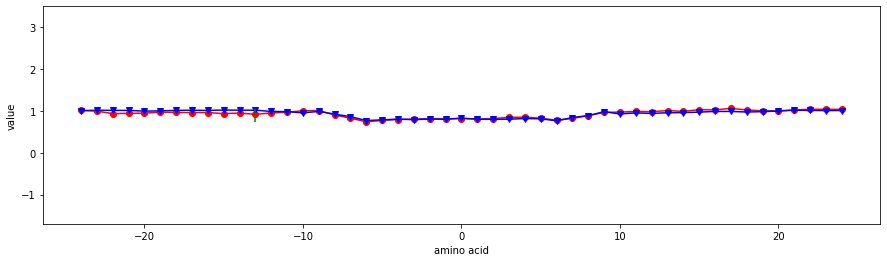

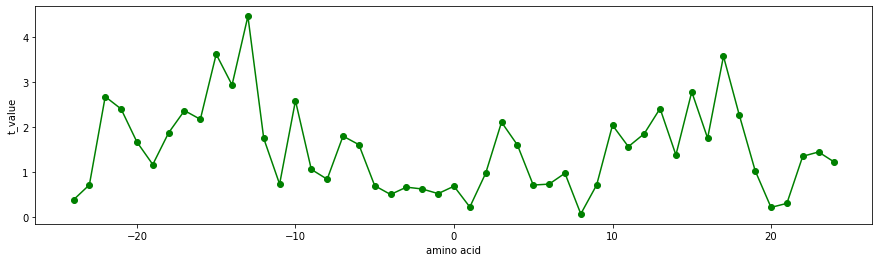

VASM830101
Relative population of conformational state A (Vasquez et al., 1983)


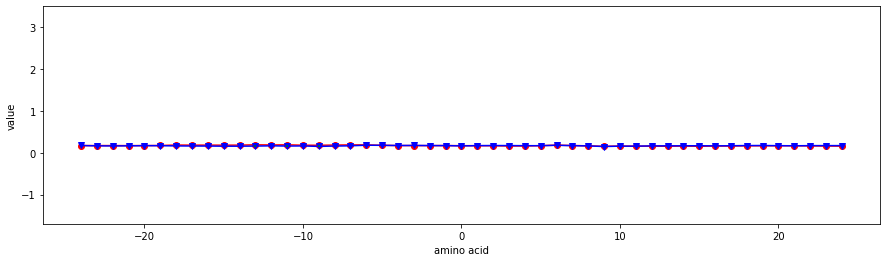

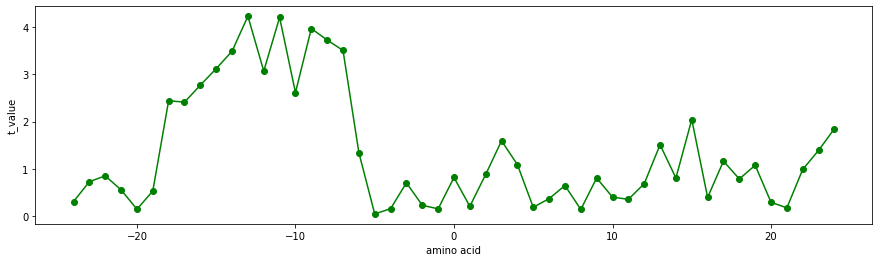

VENT840101
Bitterness (Venanzi, 1984)


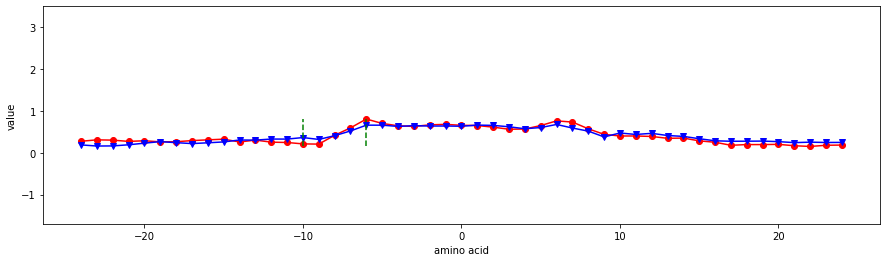

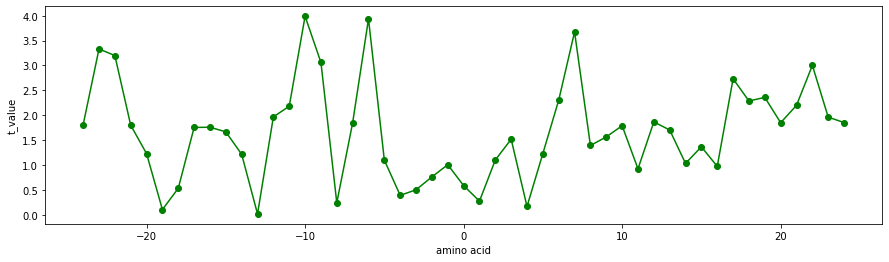

VHEG790101
Transfer free energy to lipophilic phase (von Heijne-Blomberg, 1979)


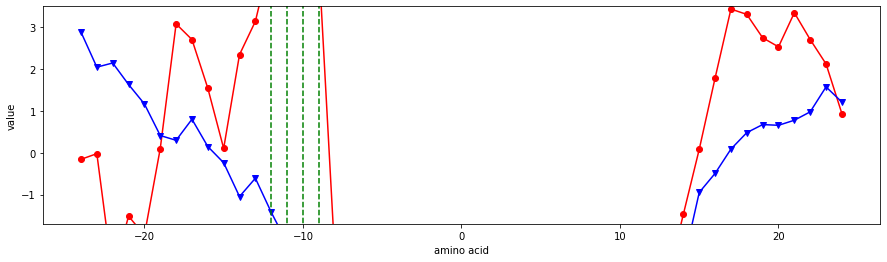

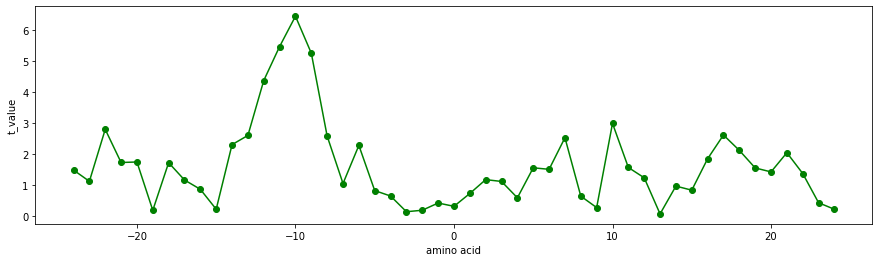

WARP780101
Average interactions per side chain atom (Warme-Morgan, 1978)


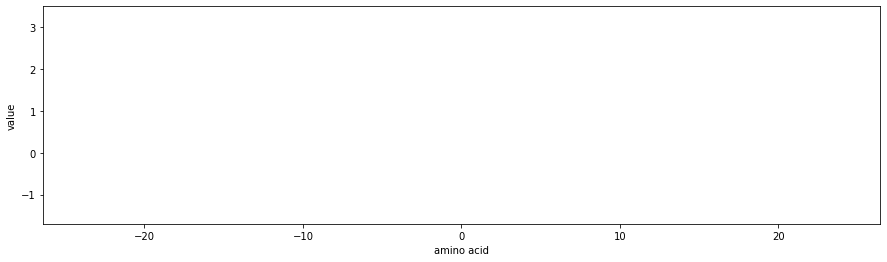

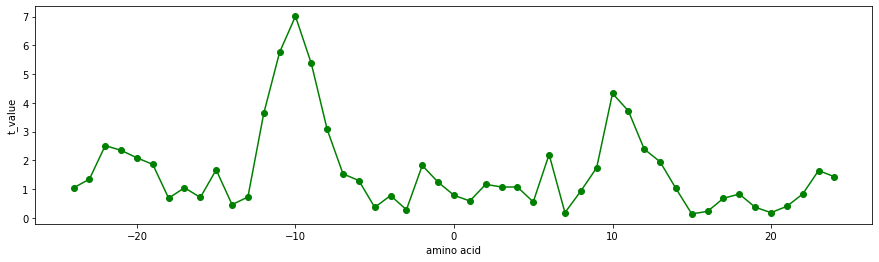

WEBA780101
RF value in high salt chromatography (Weber-Lacey, 1978)


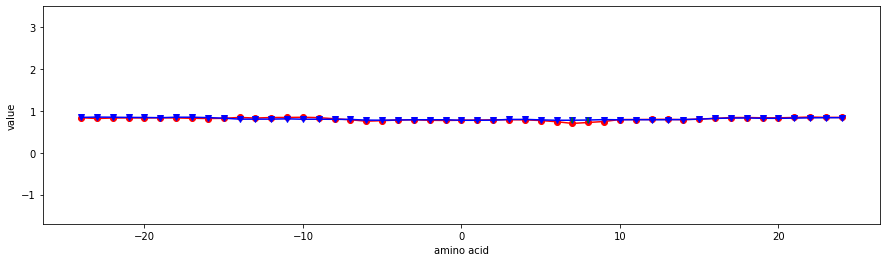

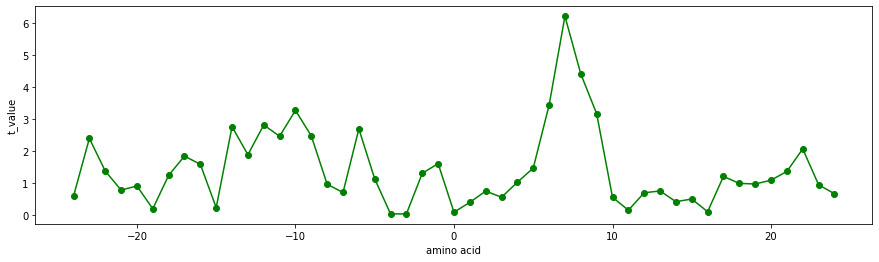

WERD780101
Propensity to be buried inside (Wertz-Scheraga, 1978)


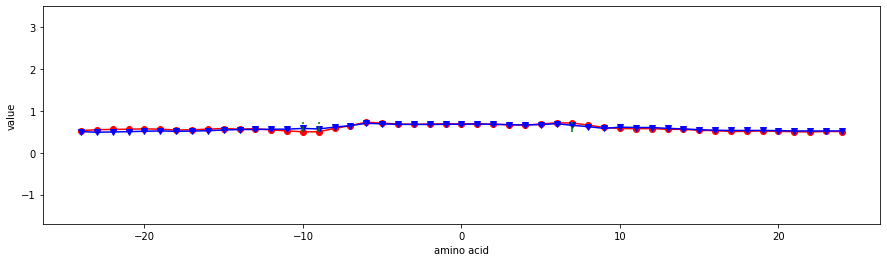

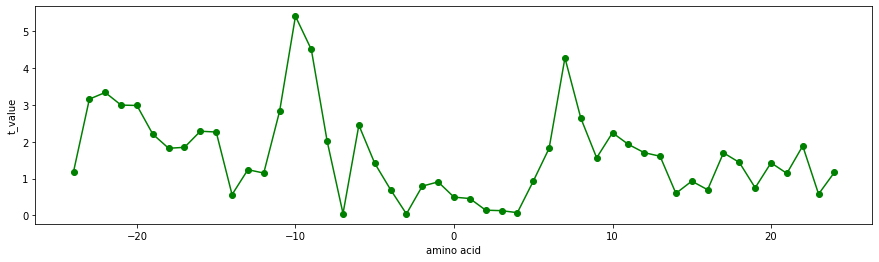

WERD780104
Free energy change of epsilon(i) to alpha(Rh) (Wertz-Scheraga, 1978)


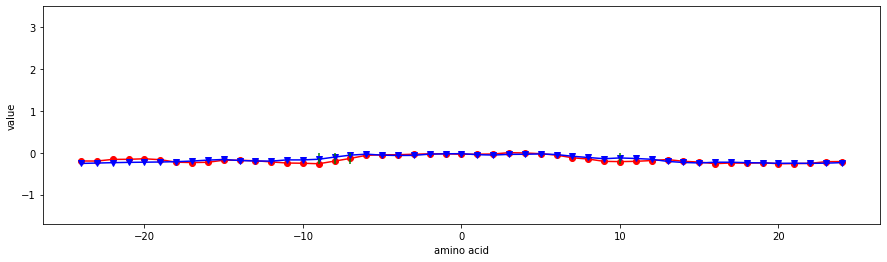

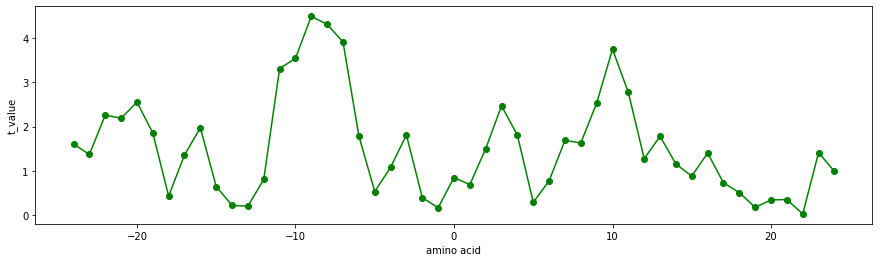

WOEC730101
Polar requirement (Woese, 1973)


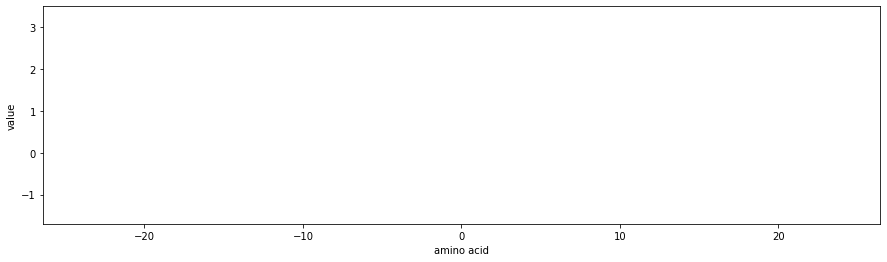

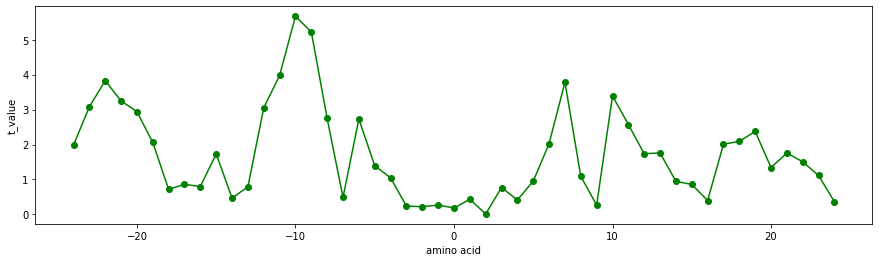

WOLR810101
Hydration potential (Wolfenden et al., 1981)


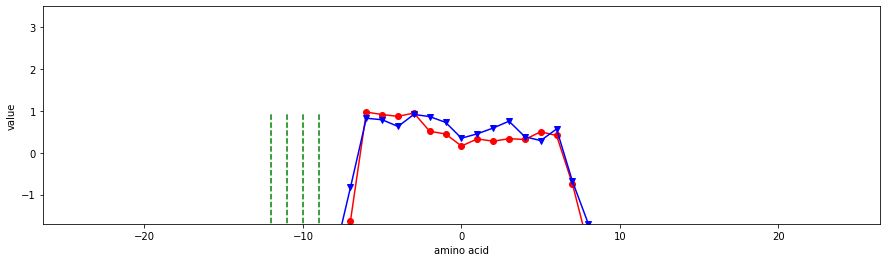

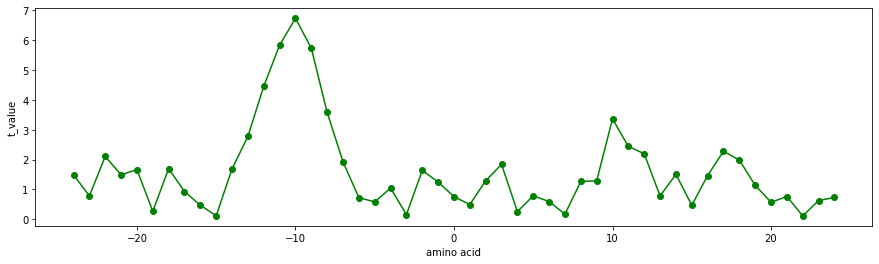

WOLS870101
Principal property value z1 (Wold et al., 1987)


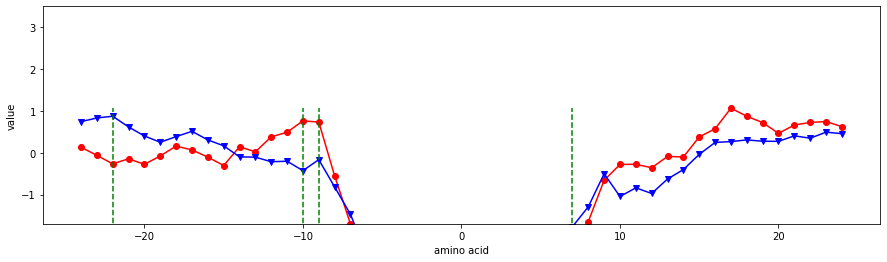

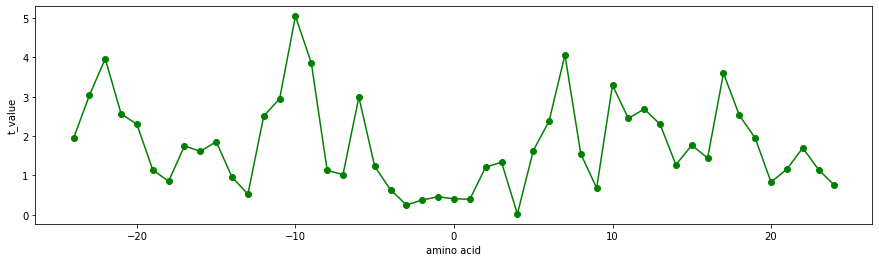

WOLS870102
Principal property value z2 (Wold et al., 1987)


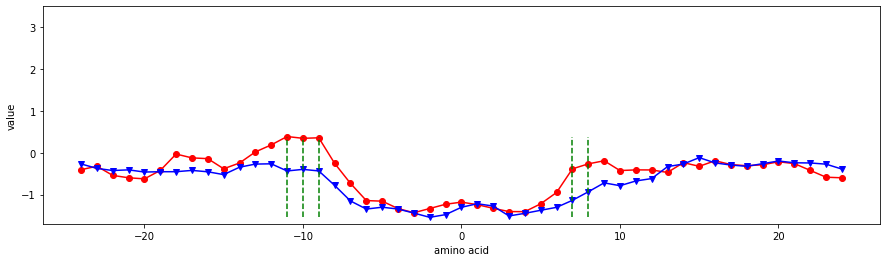

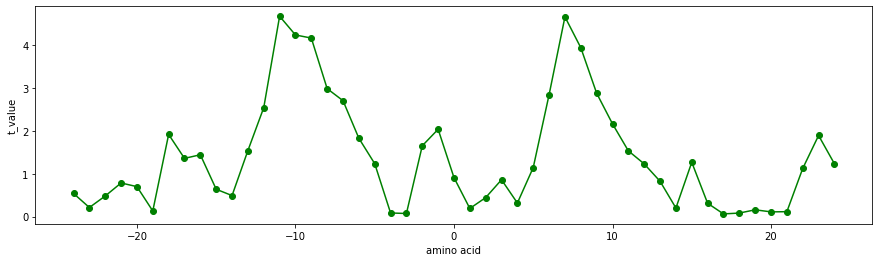

WOLS870103
Principal property value z3 (Wold et al., 1987)


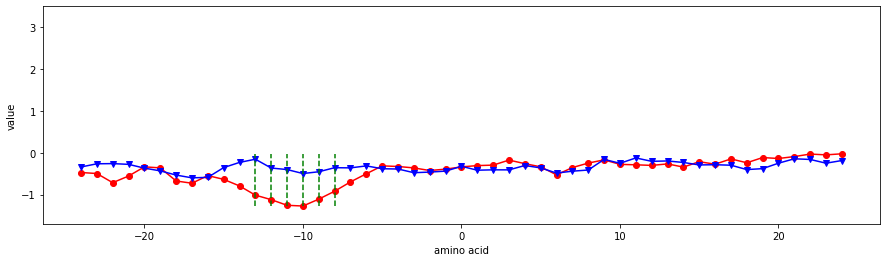

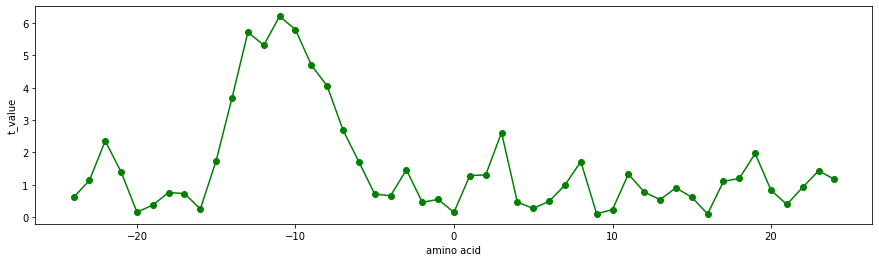

YUTK870101
Unfolding Gibbs energy in water, pH7.0 (Yutani et al., 1987)


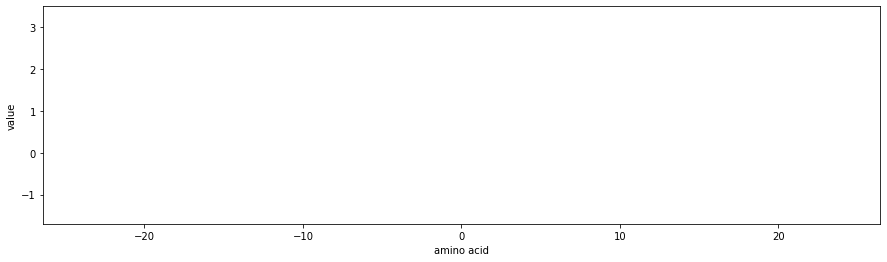

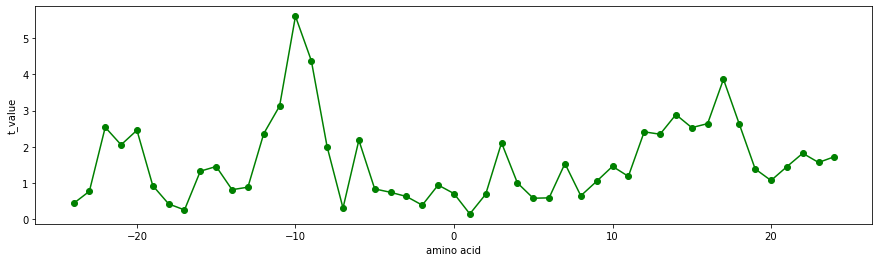

YUTK870102
Unfolding Gibbs energy in water, pH9.0 (Yutani et al., 1987)


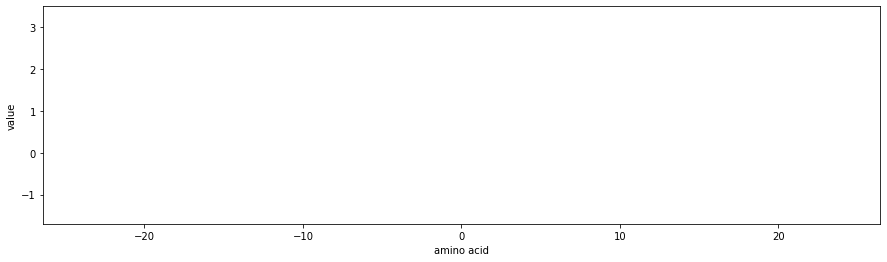

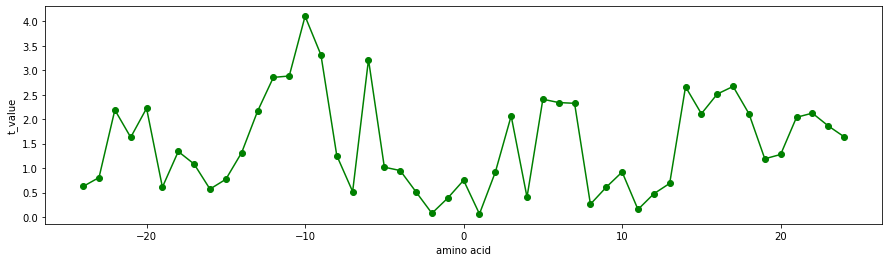

YUTK870103
Activation Gibbs energy of unfolding, pH7.0 (Yutani et al., 1987)


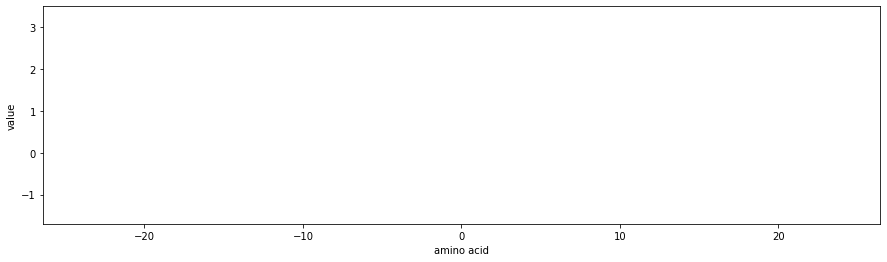

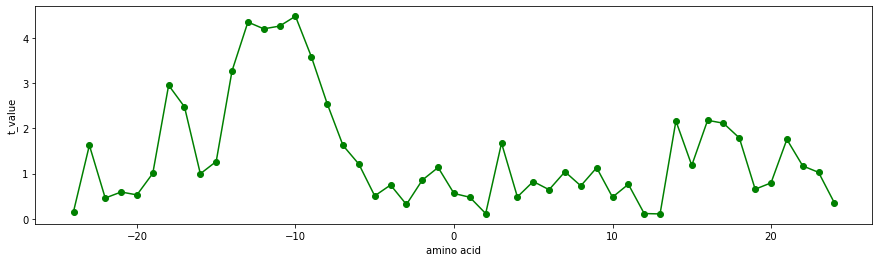

YUTK870104
Activation Gibbs energy of unfolding, pH9.0 (Yutani et al., 1987)


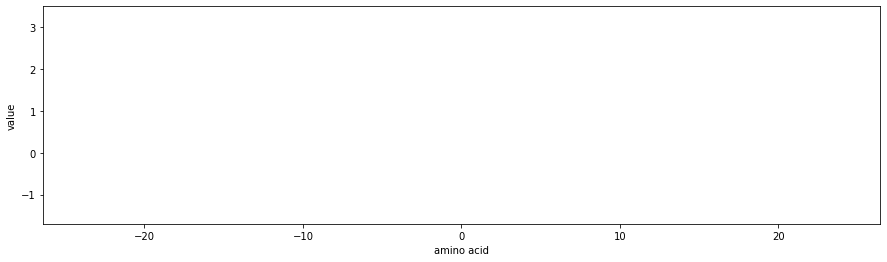

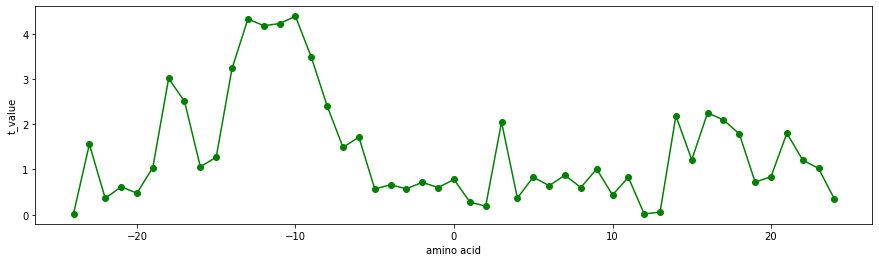

ZASB820101
Dependence of partition coefficient on ionic strength (Zaslavsky et al.,


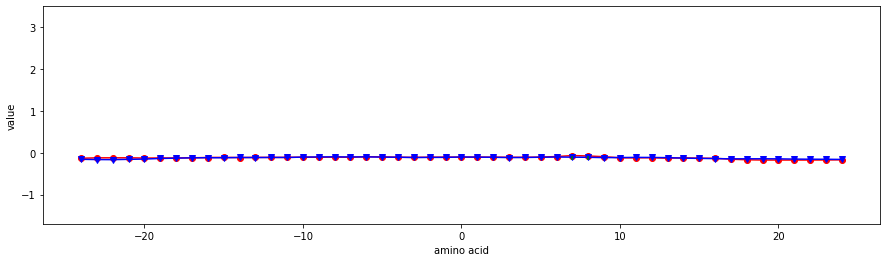

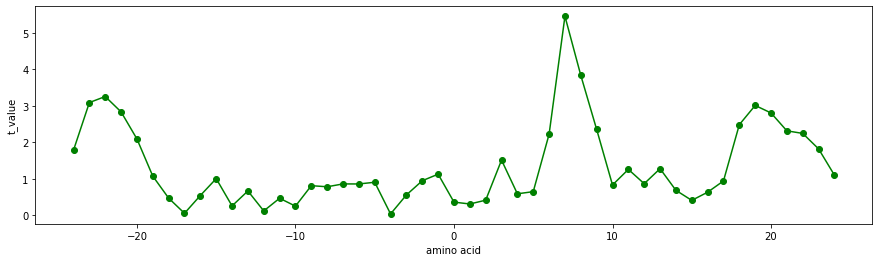

ZIMJ680102
Bulkiness (Zimmerman et al., 1968)


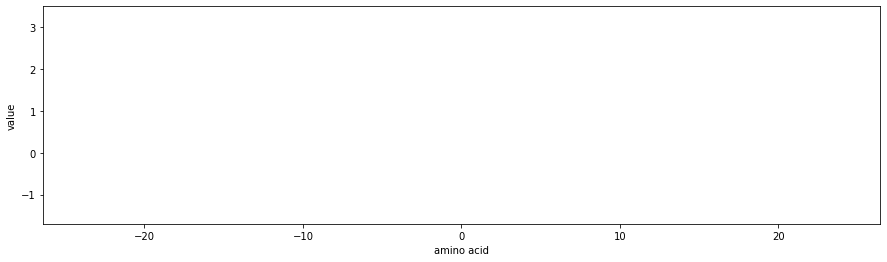

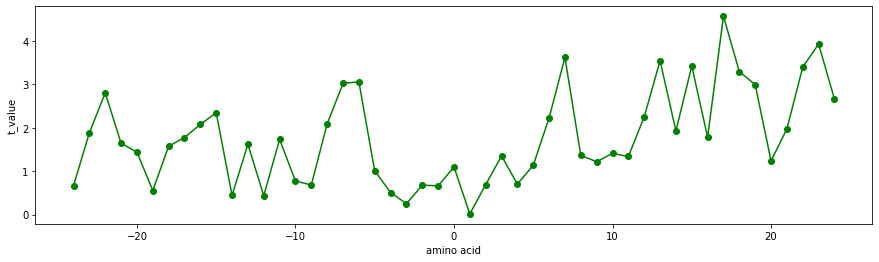

ZIMJ680103
Polarity (Zimmerman et al., 1968)


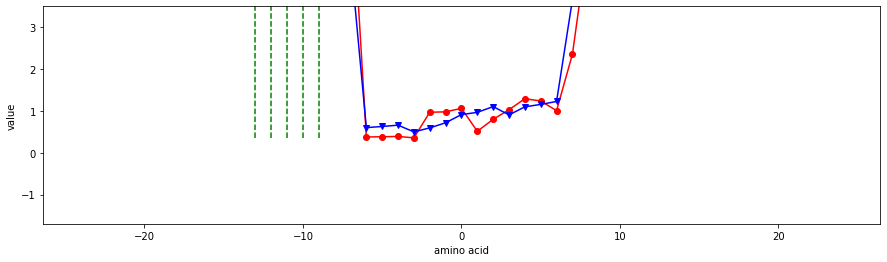

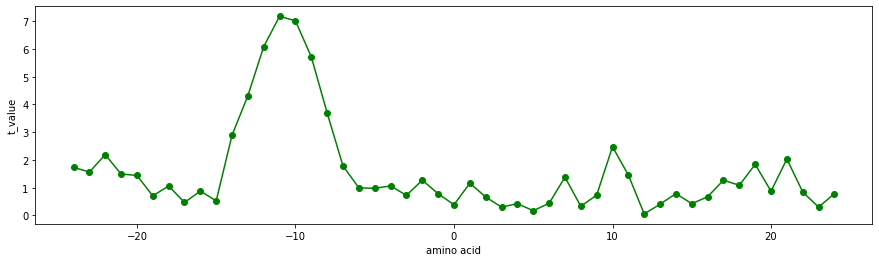

ZIMJ680104
Isoelectric point (Zimmerman et al., 1968)


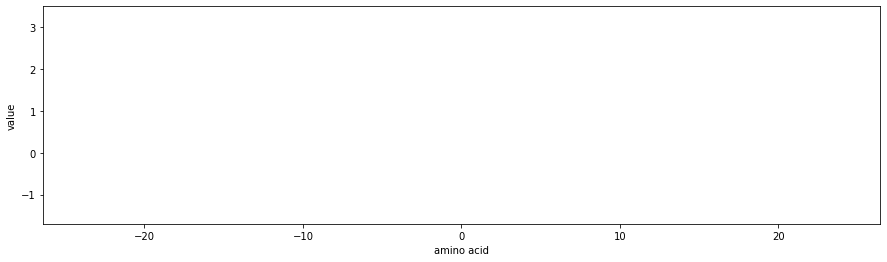

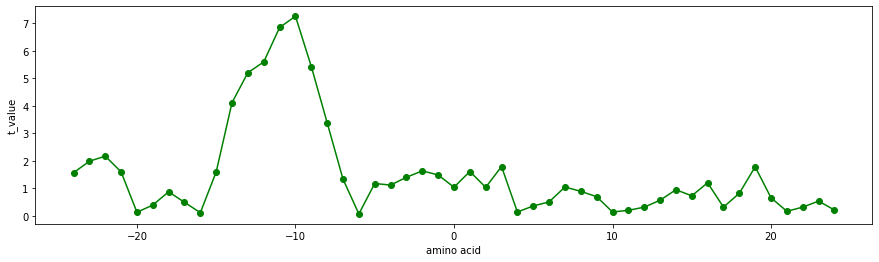

ZIMJ680105
RF rank (Zimmerman et al., 1968)


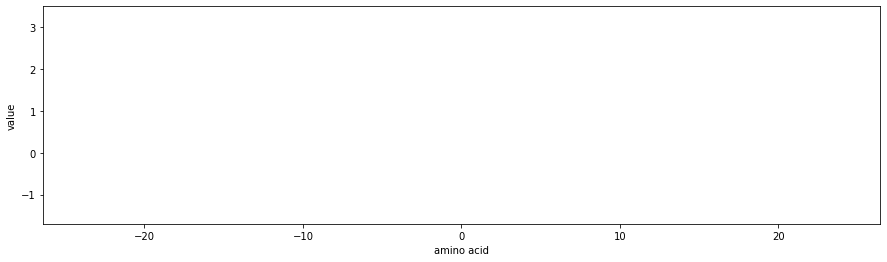

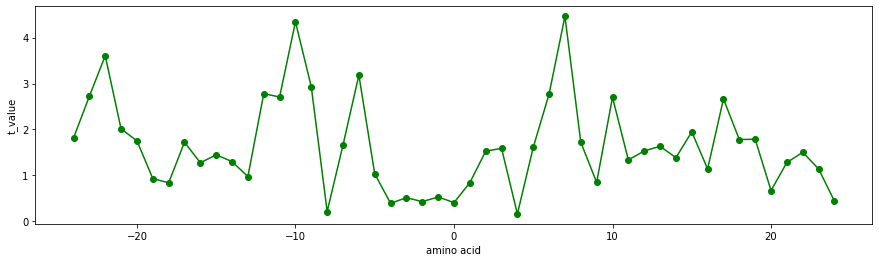

AURR980102
Normalized positional residue frequency at helix termini N"' (Aurora-Rose,


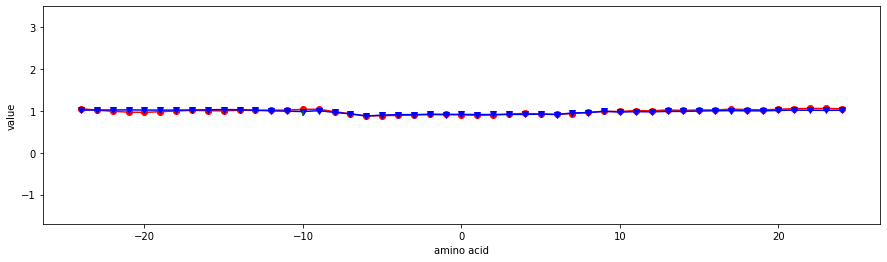

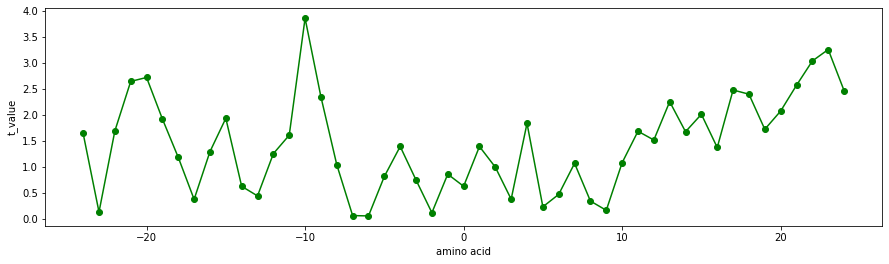

AURR980109
Normalized positional residue frequency at helix termini N4 (Aurora-Rose,


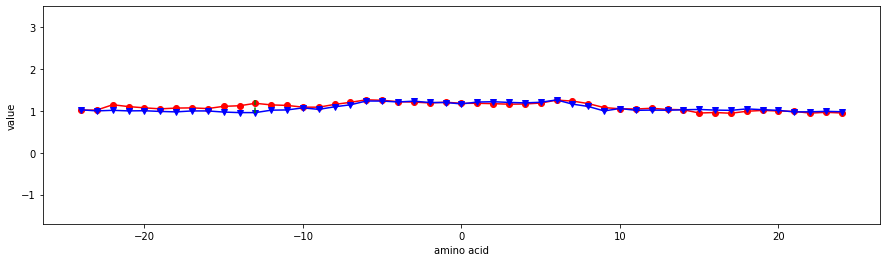

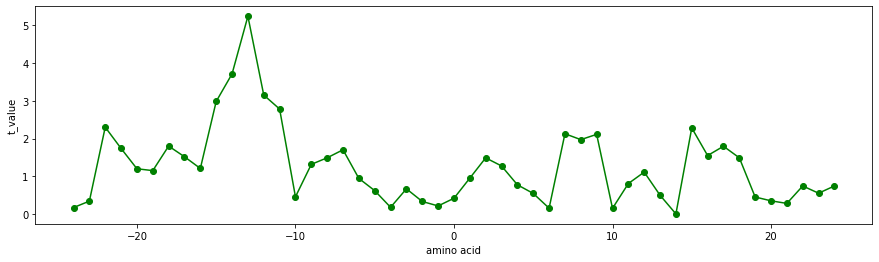

AURR980110
Normalized positional residue frequency at helix termini N5 (Aurora-Rose,


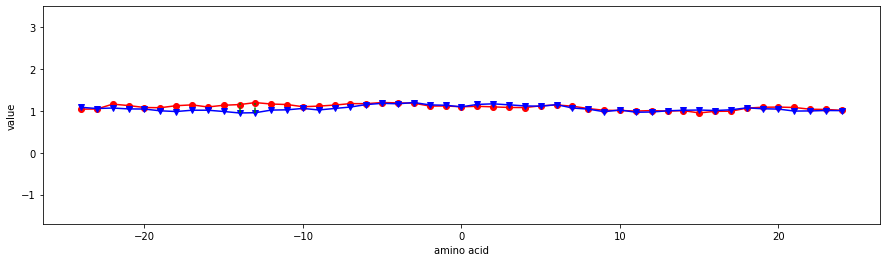

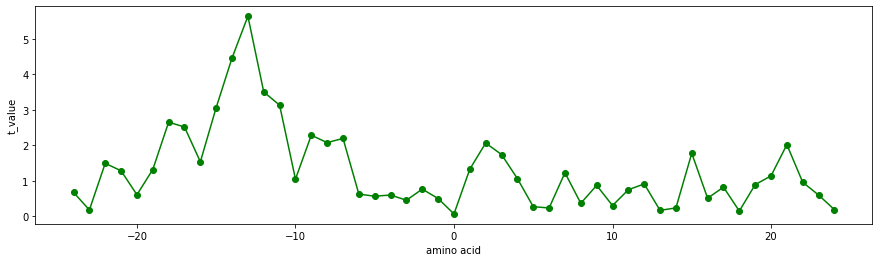

AURR980111
Normalized positional residue frequency at helix termini C5 (Aurora-Rose,


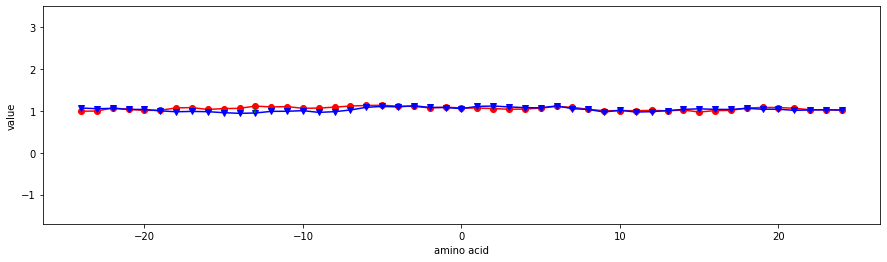

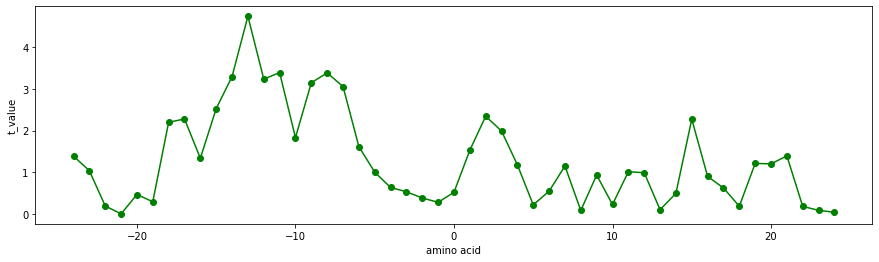

AURR980112
Normalized positional residue frequency at helix termini C4 (Aurora-Rose,


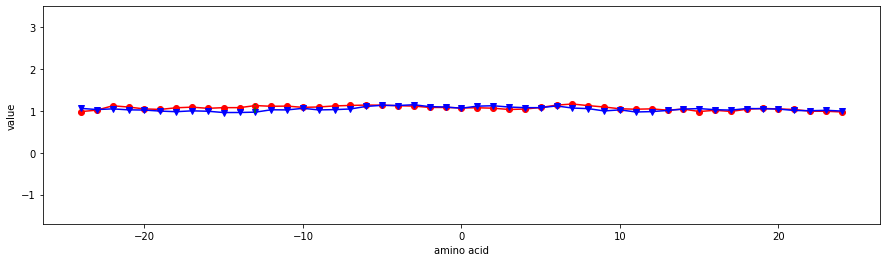

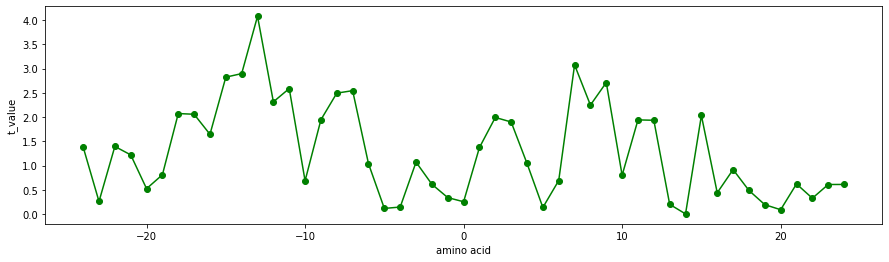

AURR980113
Normalized positional residue frequency at helix termini C3 (Aurora-Rose,


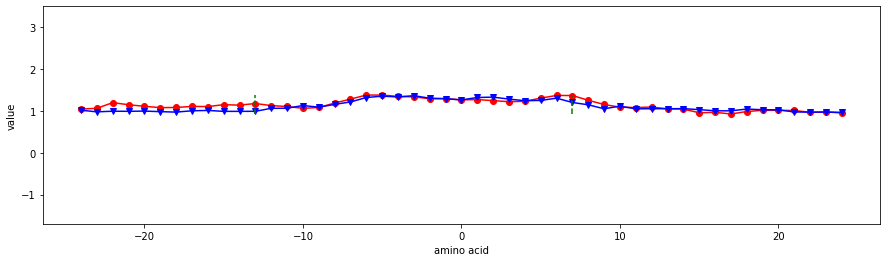

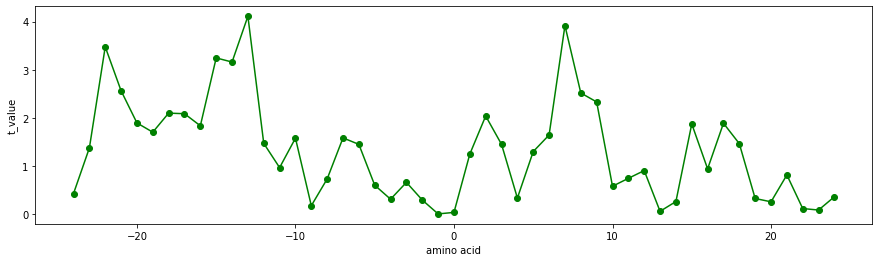

AURR980114
Normalized positional residue frequency at helix termini C2 (Aurora-Rose,


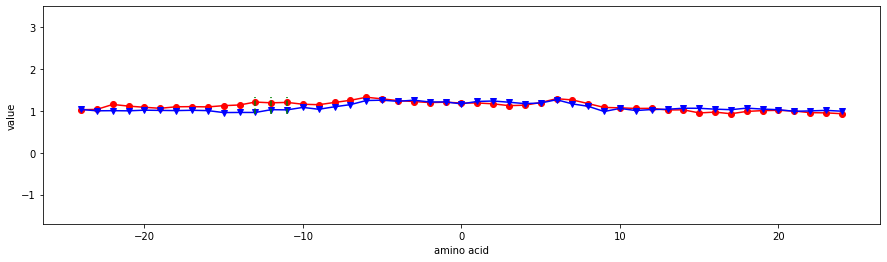

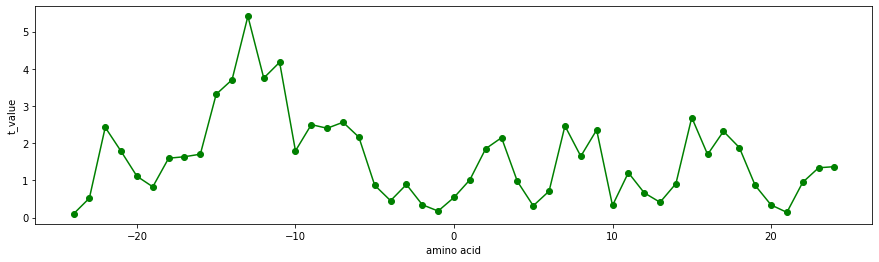

AURR980115
Normalized positional residue frequency at helix termini C1 (Aurora-Rose,


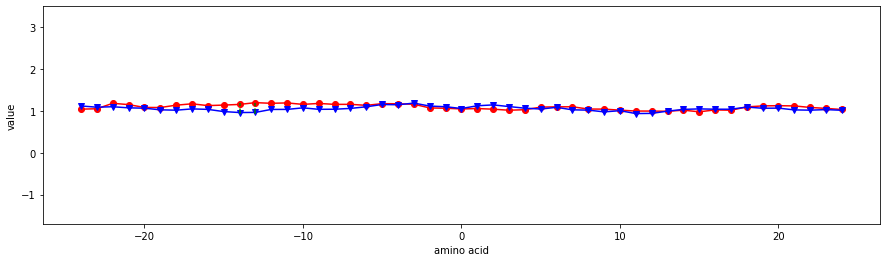

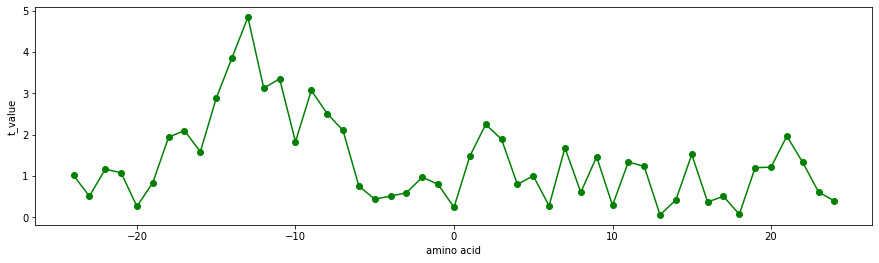

AURR980116
Normalized positional residue frequency at helix termini Cc (Aurora-Rose,


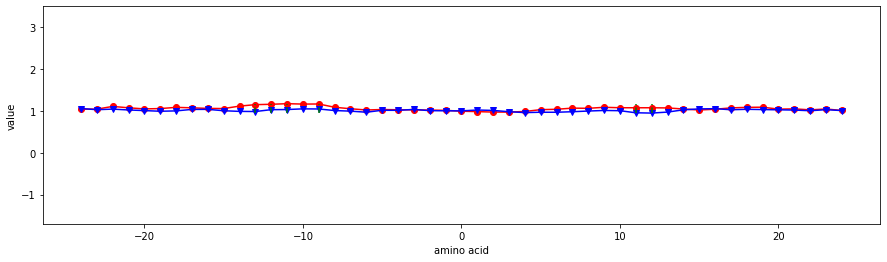

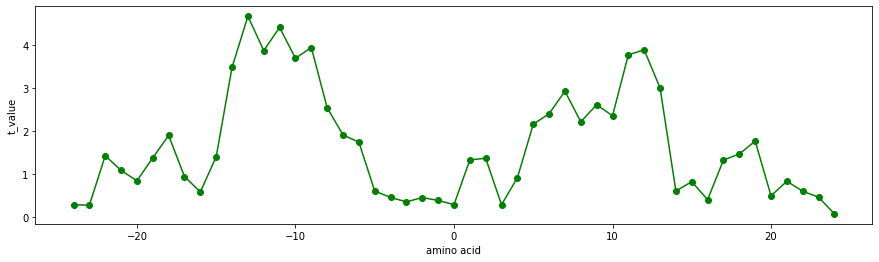

AURR980119
Normalized positional residue frequency at helix termini C"' (Aurora-Rose,


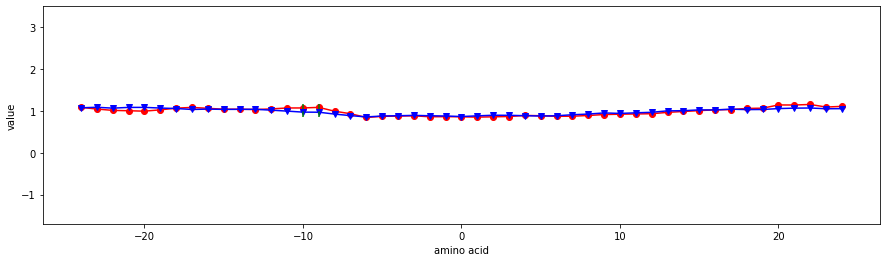

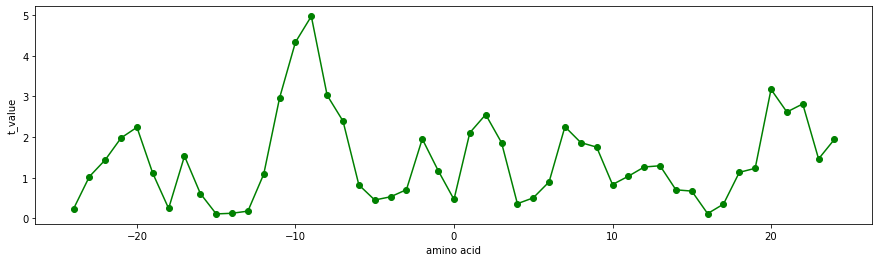

ONEK900101
Delta G values for the peptides extrapolated to 0 M urea (O'Neil-DeGrado,


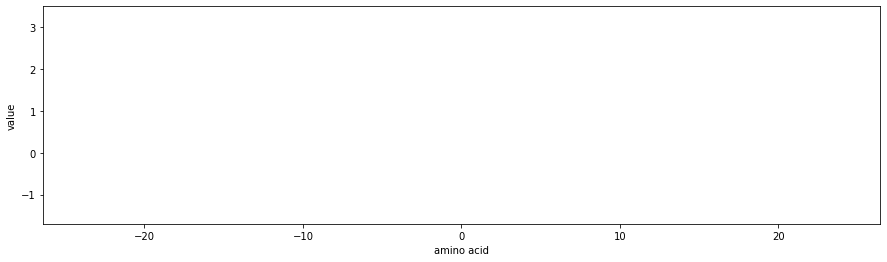

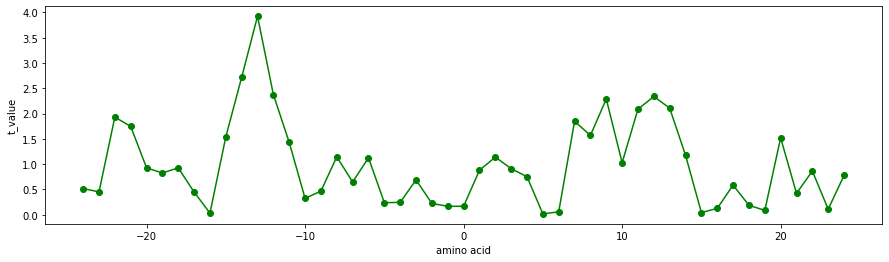

VINM940101
Normalized flexibility parameters (B-values), average (Vihinen et al., 1994)


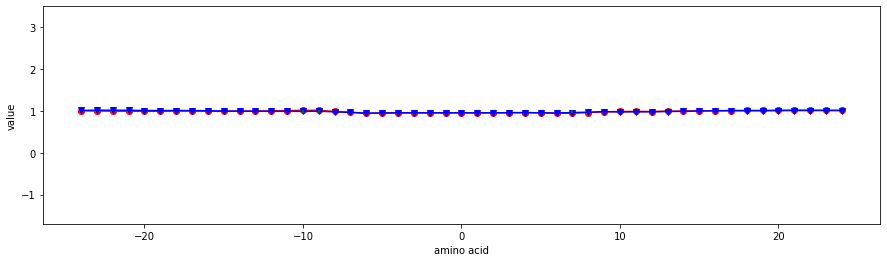

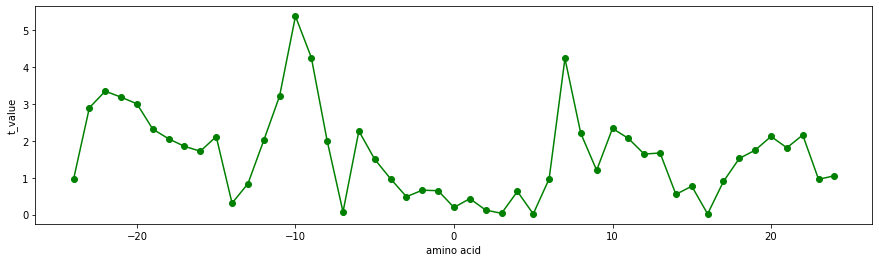

VINM940102
Normalized flexibility parameters (B-values) for each residue surrounded by


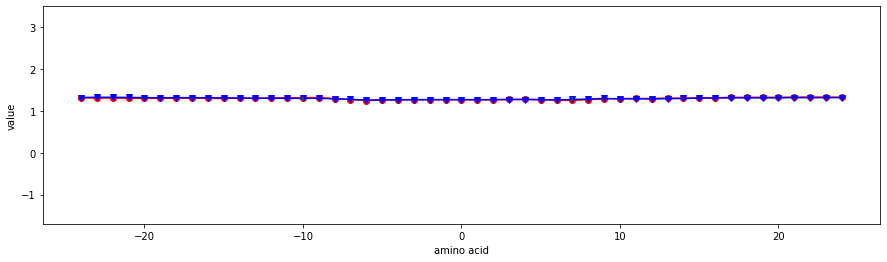

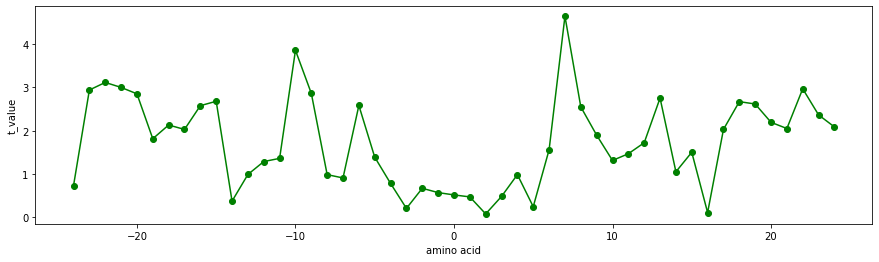

VINM940103
Normalized flexibility parameters (B-values) for each residue surrounded by


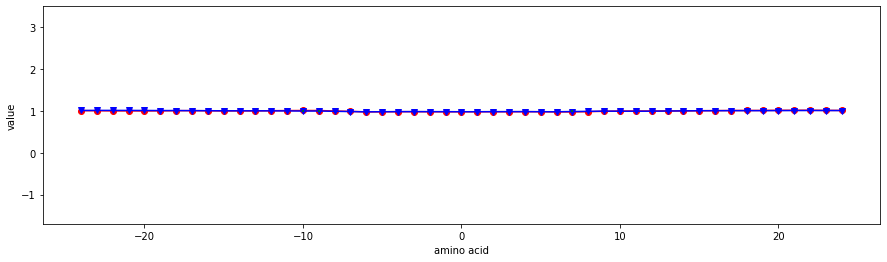

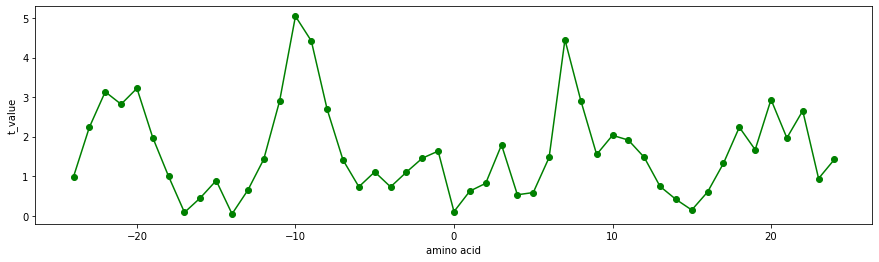

VINM940104
Normalized flexibility parameters (B-values) for each residue surrounded by


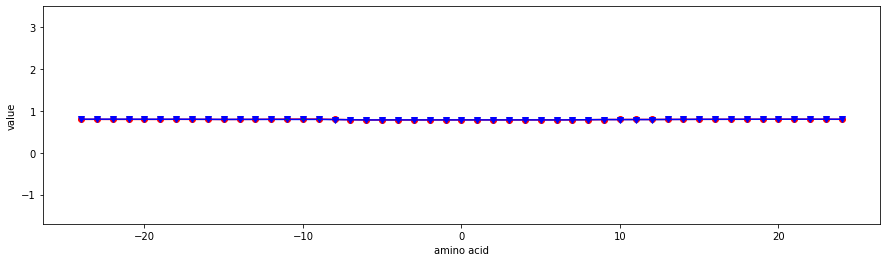

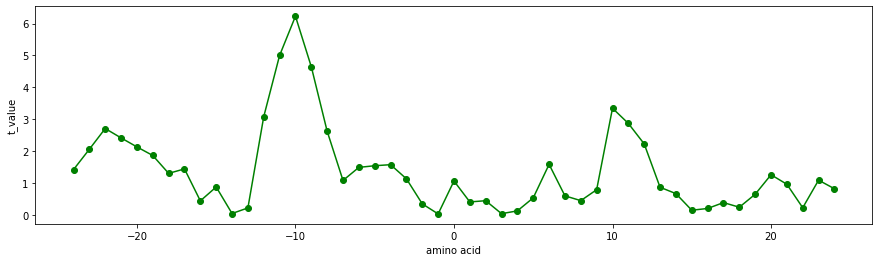

MUNV940101
Free energy in alpha-helical conformation (Munoz-Serrano, 1994)


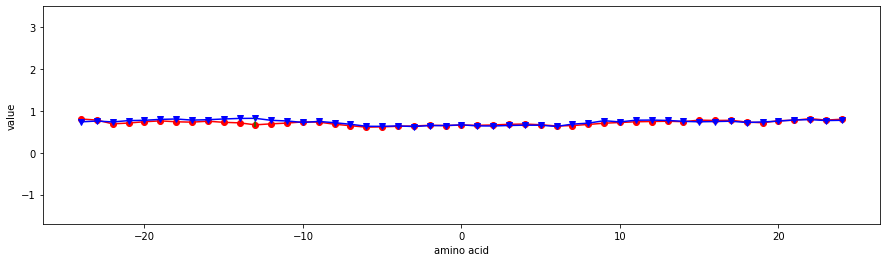

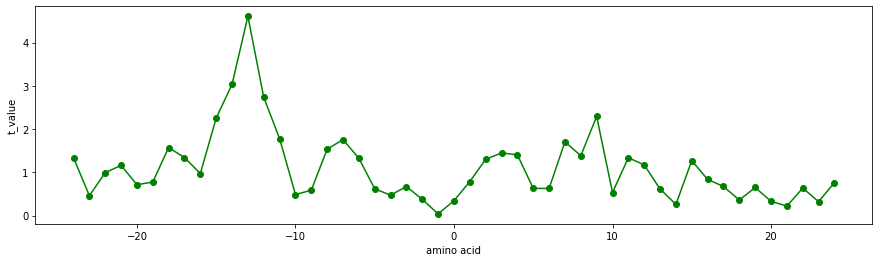

MUNV940102
Free energy in alpha-helical region (Munoz-Serrano, 1994)


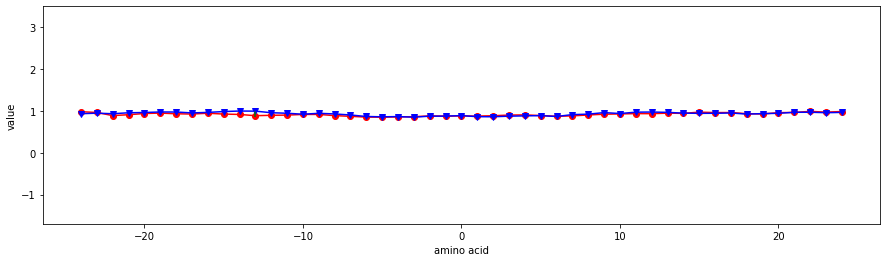

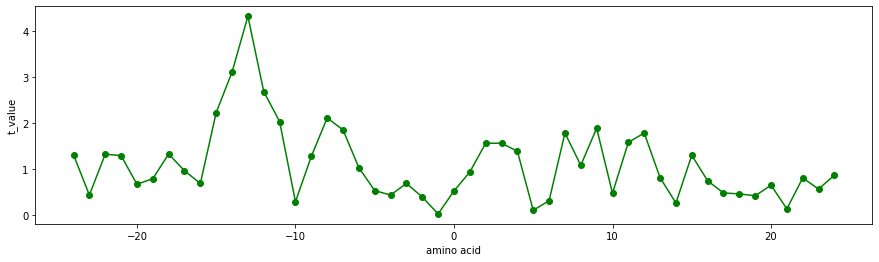

MUNV940103
Free energy in beta-strand conformation (Munoz-Serrano, 1994)


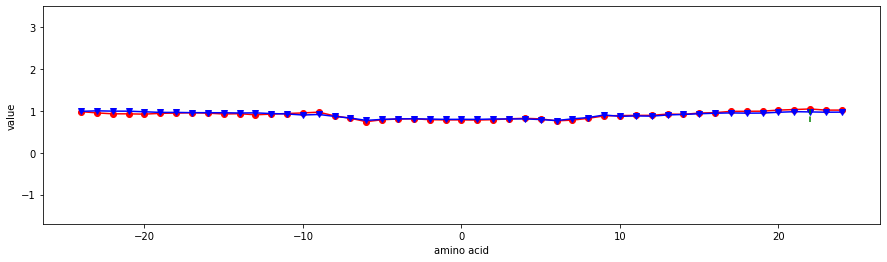

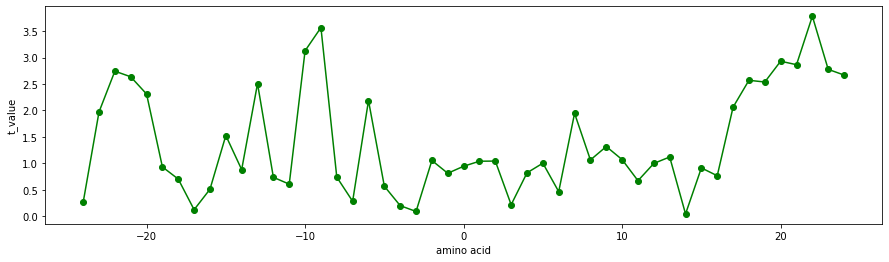

WIMW960101
Free energies of transfer of AcWl-X-LL peptides from bilayer interface to


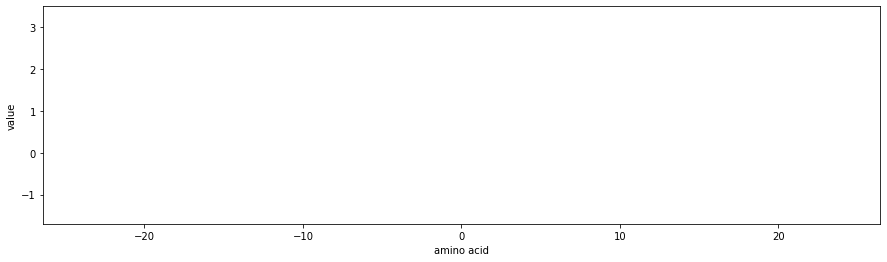

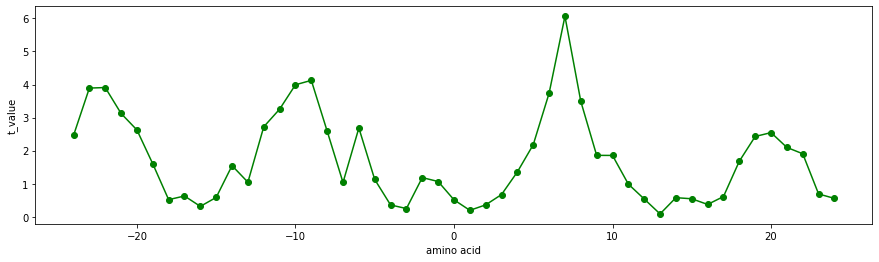

KIMC930101
Thermodynamic beta sheet propensity (Kim-Berg, 1993)


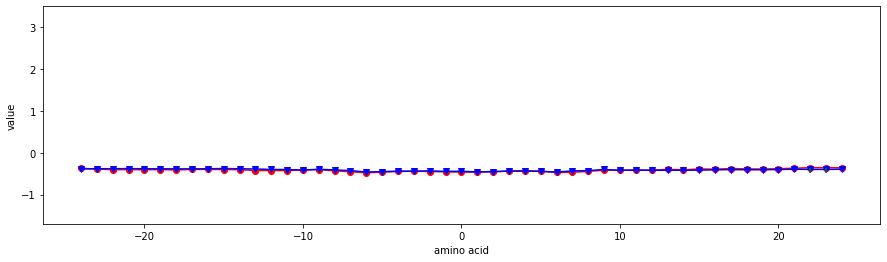

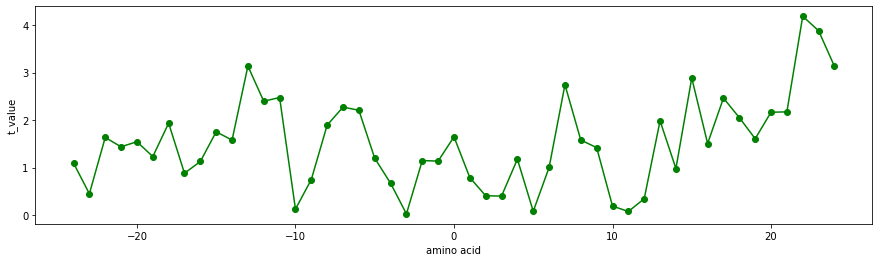

MONM990101
Turn propensity scale for transmembrane helices (Monne et al., 1999)


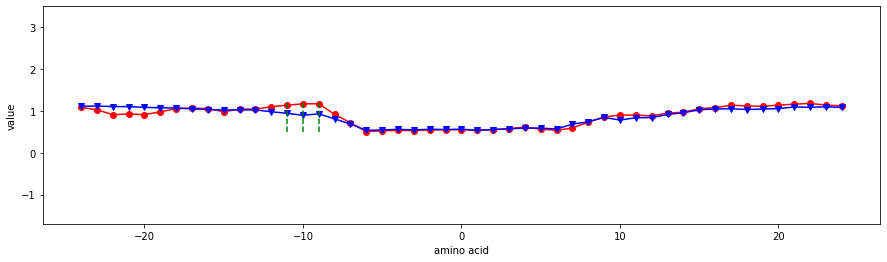

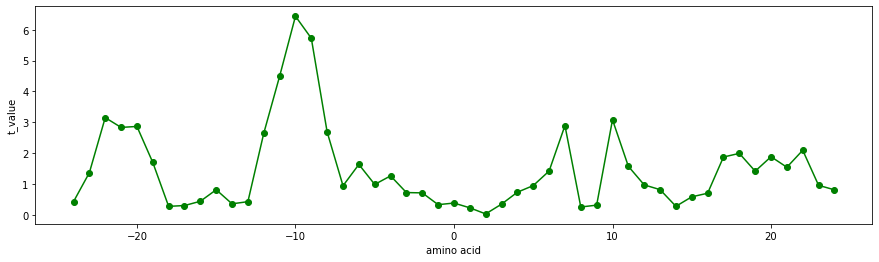

PARS000101
p-Values of mesophilic proteins based on the distributions of B values


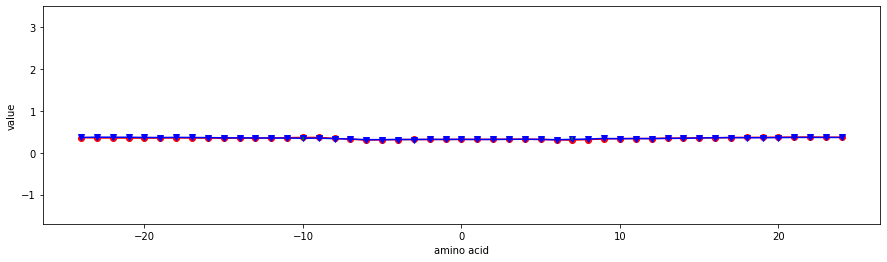

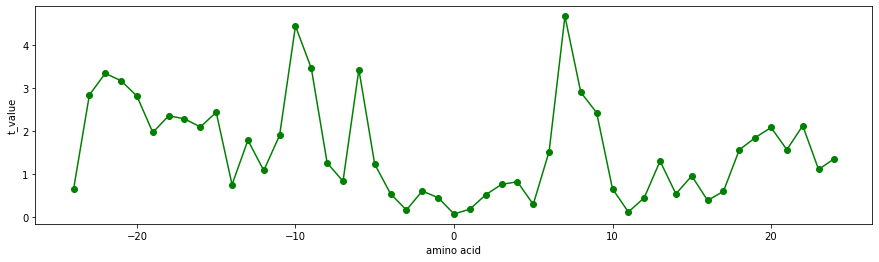

PARS000102
p-Values of thermophilic proteins based on the distributions of B values


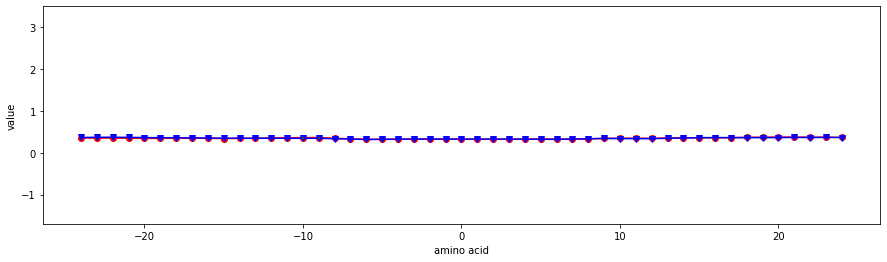

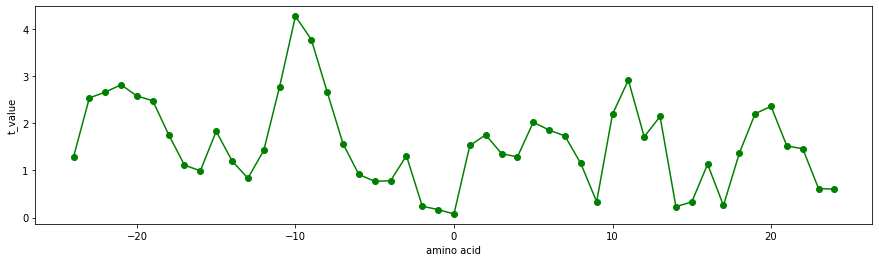

KUMS000101
Distribution of amino acid residues in the 18 non-redundant families of


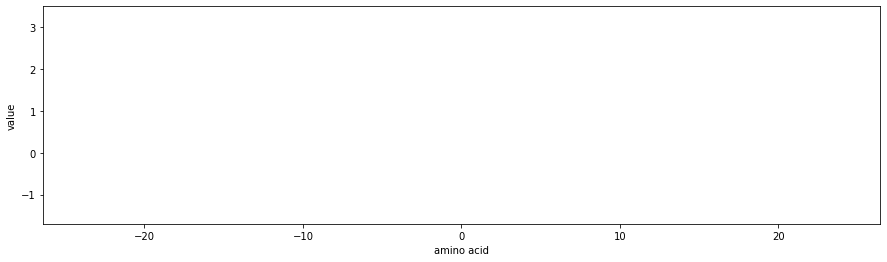

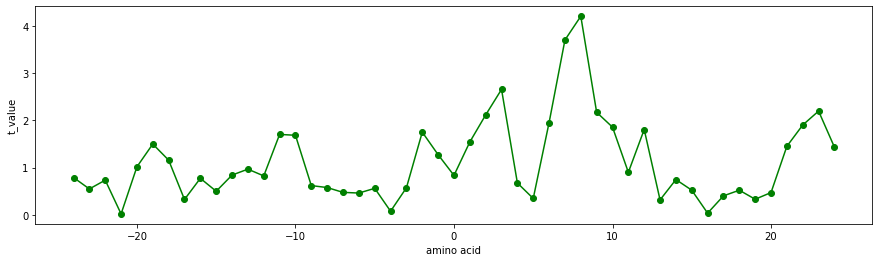

KUMS000102
Distribution of amino acid residues in the 18 non-redundant families of


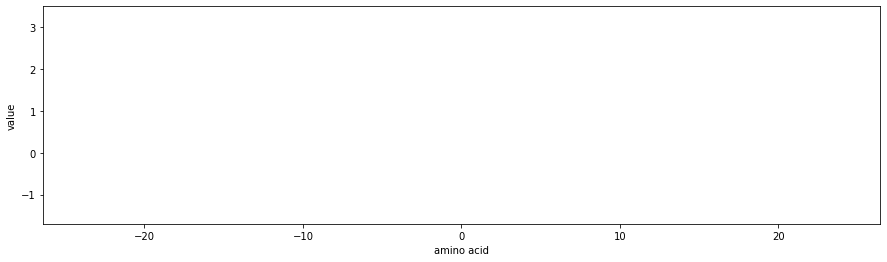

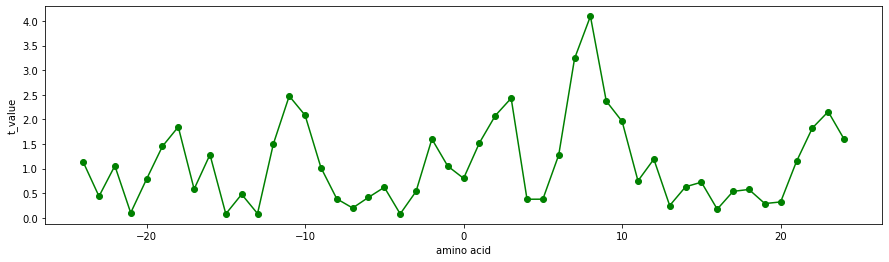

TAKK010101
Side-chain contribution to protein stability (kJ/mol) (Takano-Yutani, 2001)


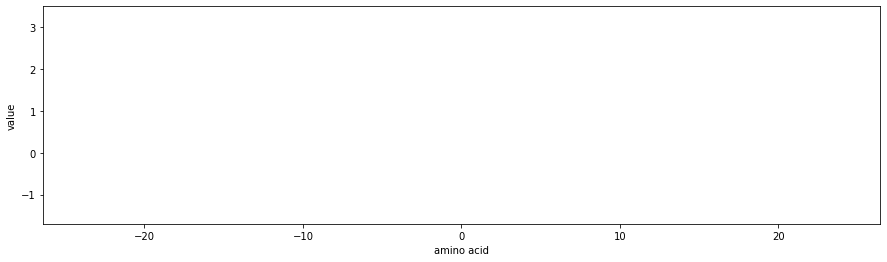

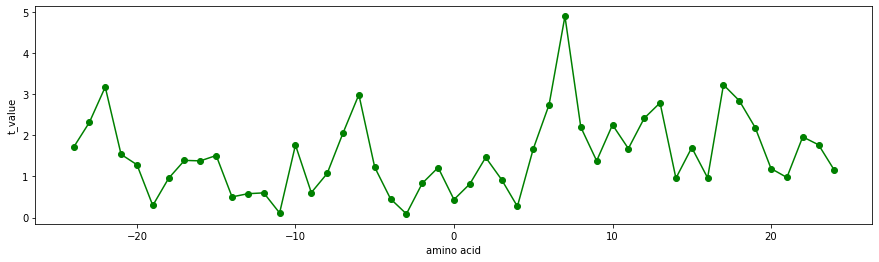

FODM020101
Propensity of amino acids within pi-helices (Fodje-Al-Karadaghi, 2002)


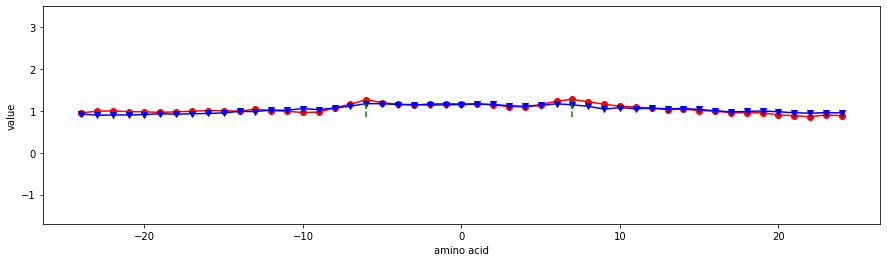

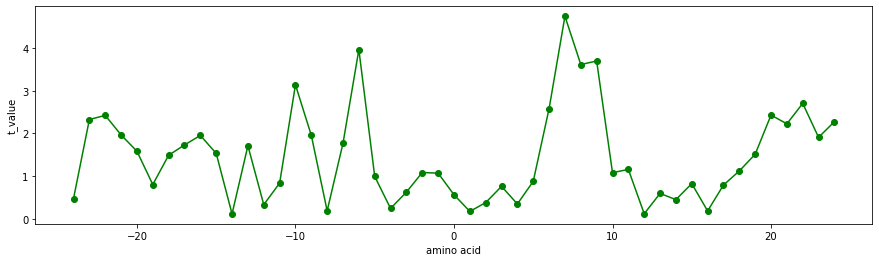

NADH010101
Hydropathy scale based on self-information values in the two-state model (5%


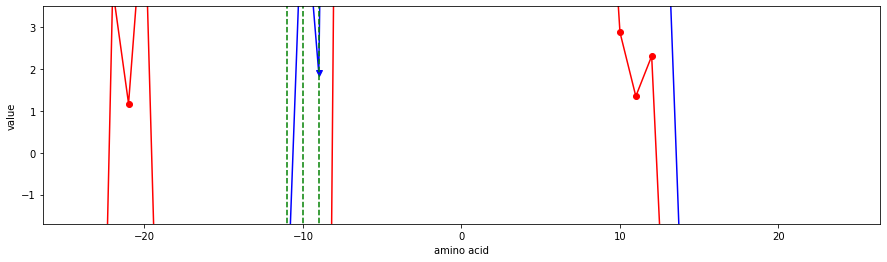

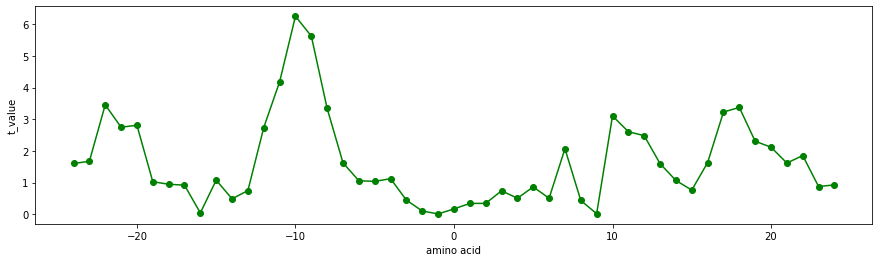

NADH010102
Hydropathy scale based on self-information values in the two-state model (9%


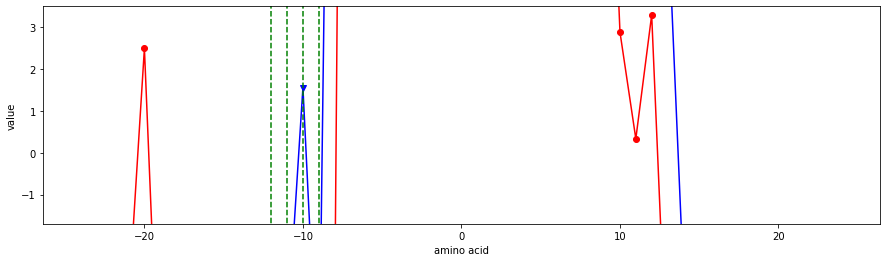

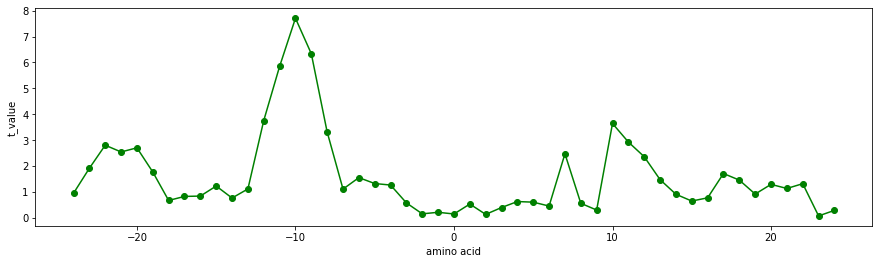

NADH010103
Hydropathy scale based on self-information values in the two-state model (16%


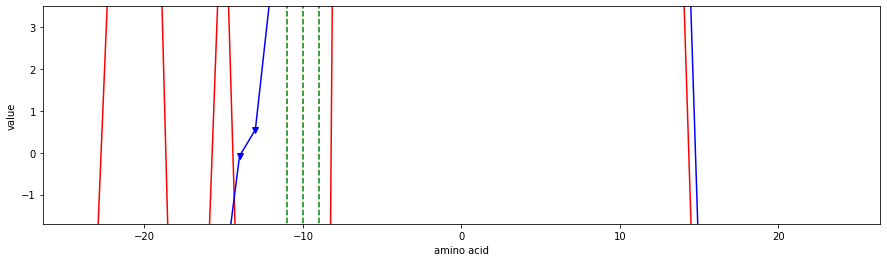

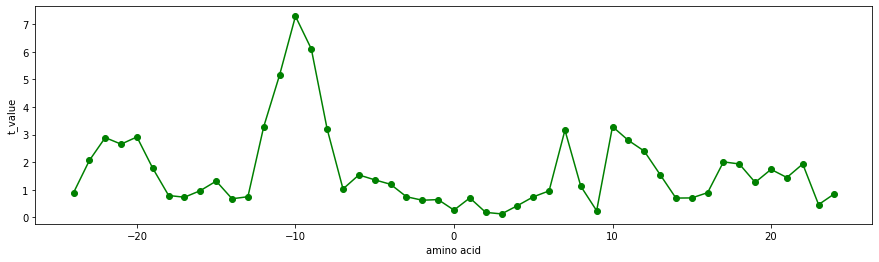

NADH010104
Hydropathy scale based on self-information values in the two-state model (20%


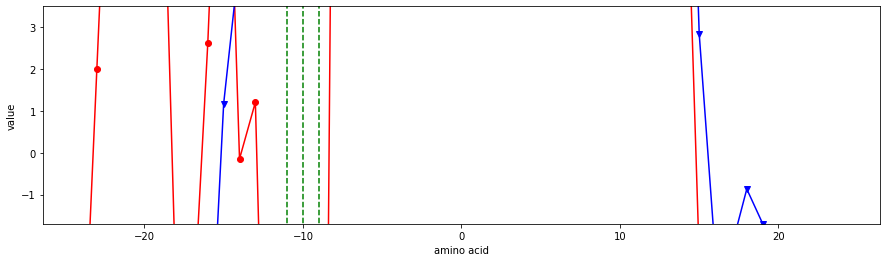

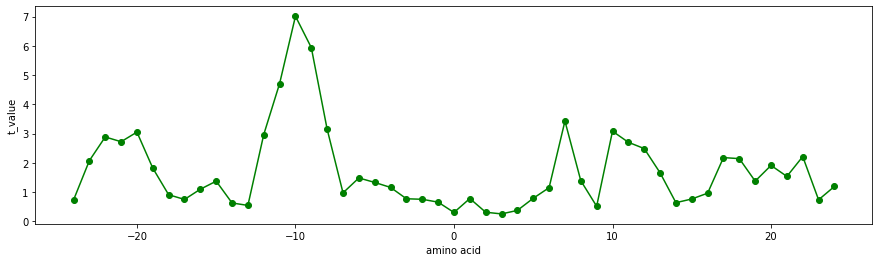

NADH010105
Hydropathy scale based on self-information values in the two-state model (25%


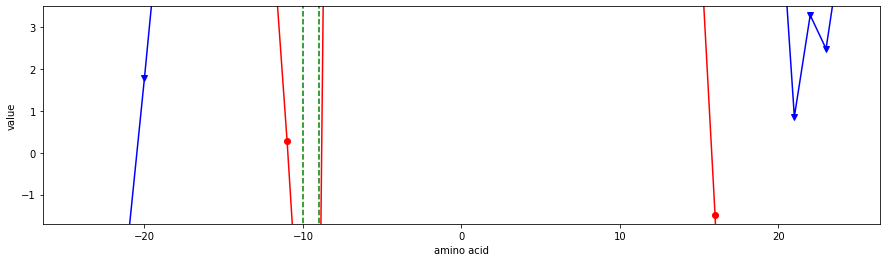

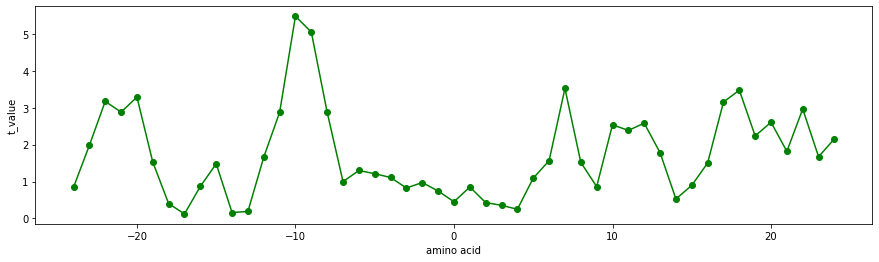

NADH010106
Hydropathy scale based on self-information values in the two-state model (36%


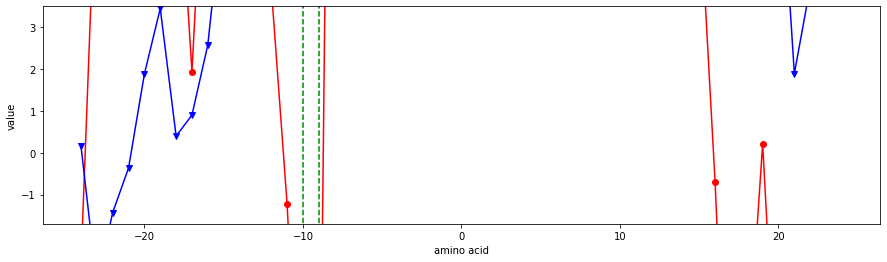

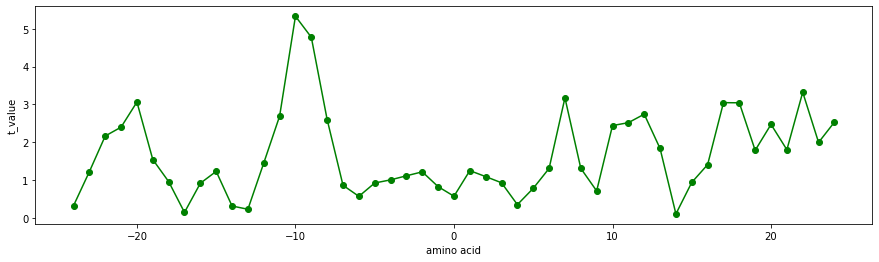

MONM990201
Averaged turn propensities in a transmembrane helix (Monne et al., 1999)


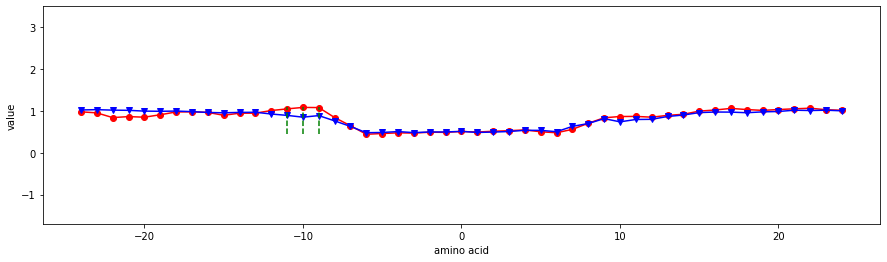

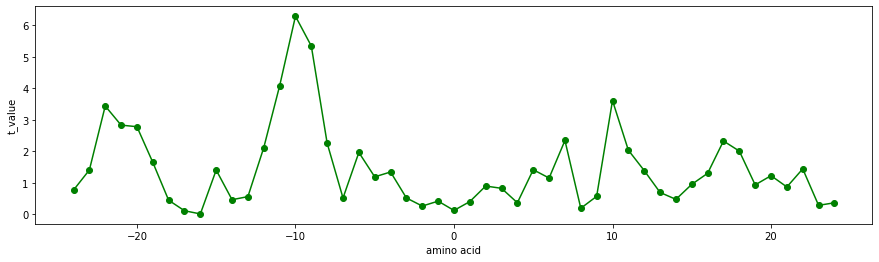

KOEP990101
Alpha-helix propensity derived from designed sequences (Koehl-Levitt, 1999)


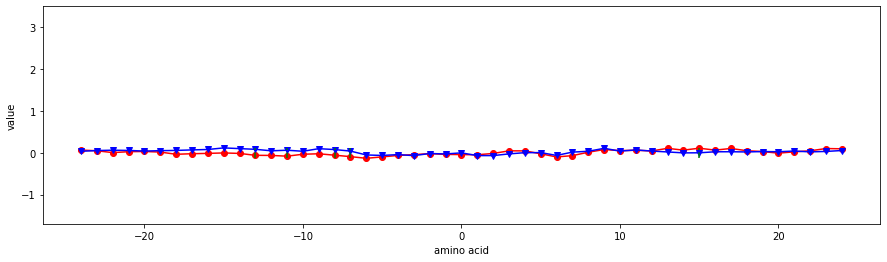

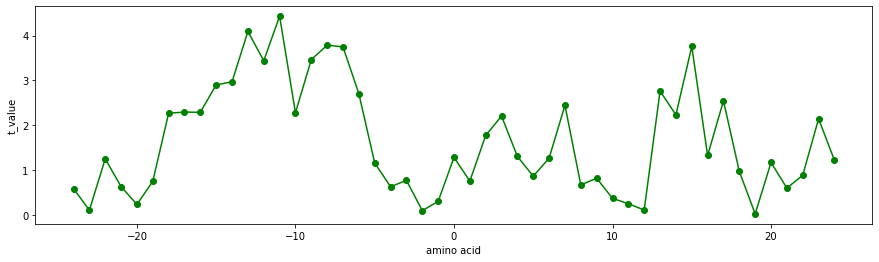

KOEP990102
Beta-sheet propensity derived from designed sequences (Koehl-Levitt, 1999)


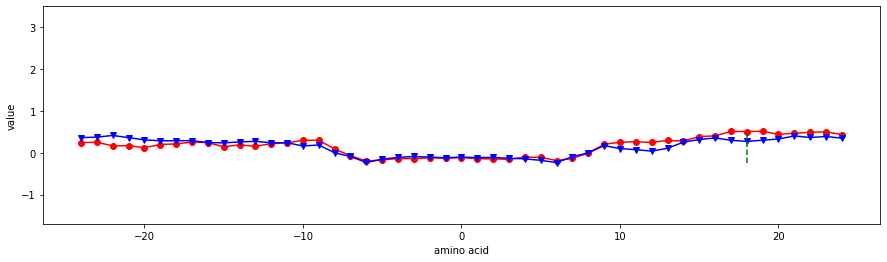

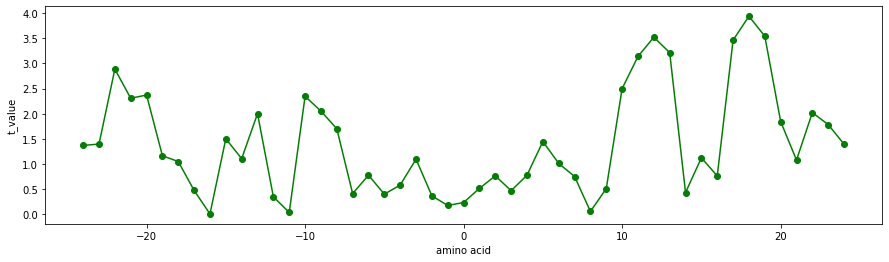

CEDJ970104
Composition of amino acids in intracellular proteins (percent) (Cedano et


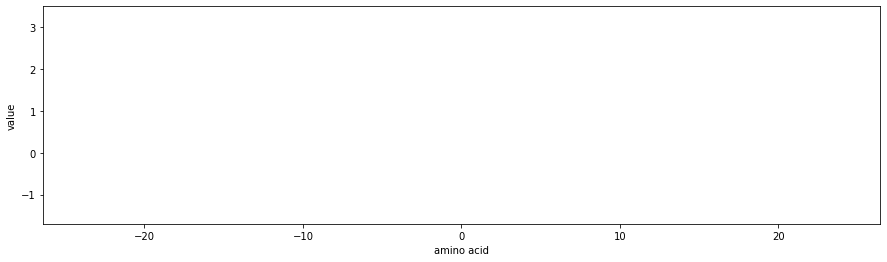

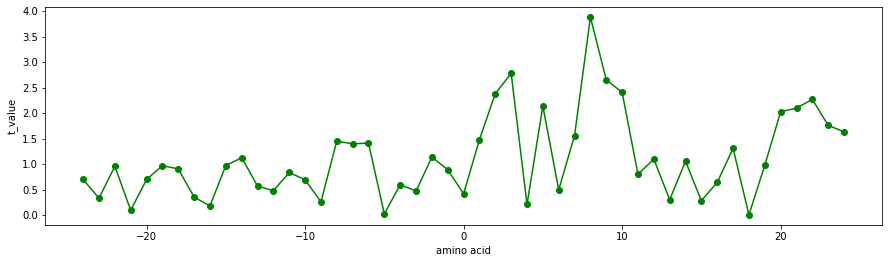

CEDJ970105
Composition of amino acids in nuclear proteins (percent) (Cedano et al.,


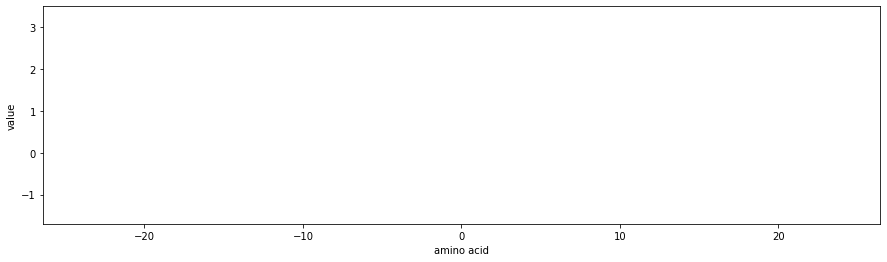

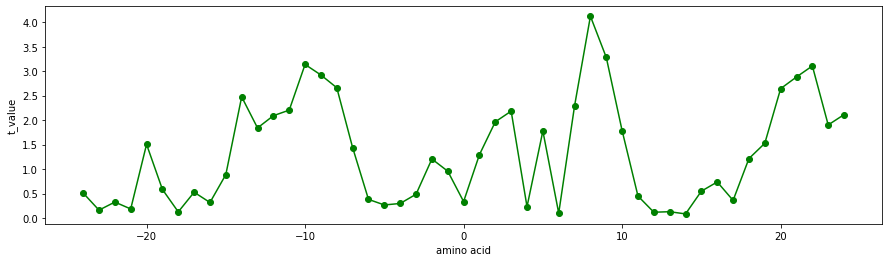

FUKS010101
Surface composition of amino acids in intracellular proteins of thermophiles


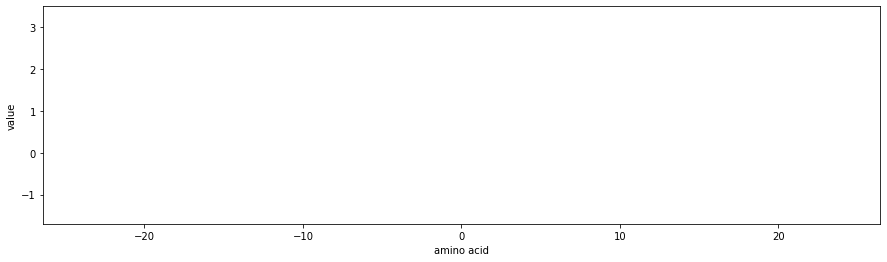

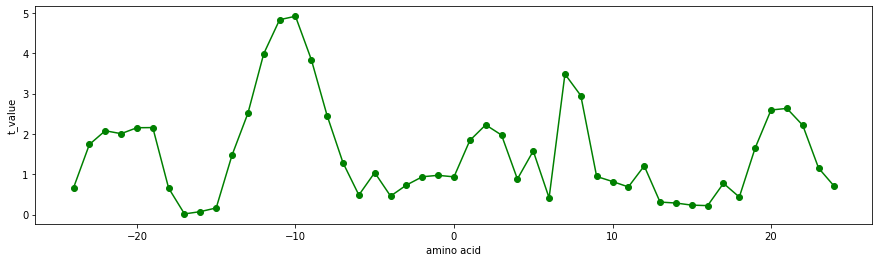

FUKS010102
Surface composition of amino acids in intracellular proteins of mesophiles


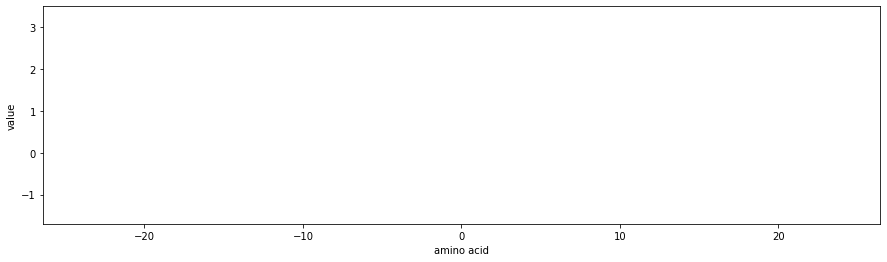

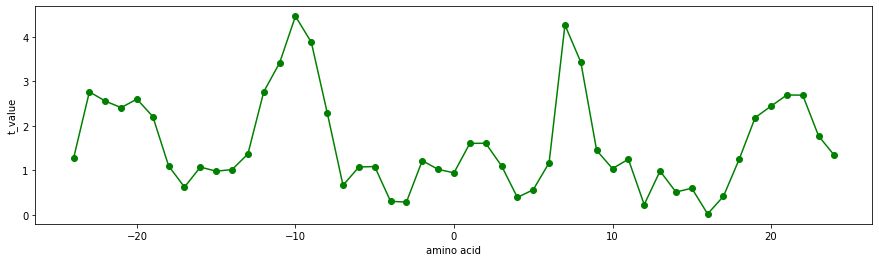

FUKS010103
Surface composition of amino acids in extracellular proteins of mesophiles


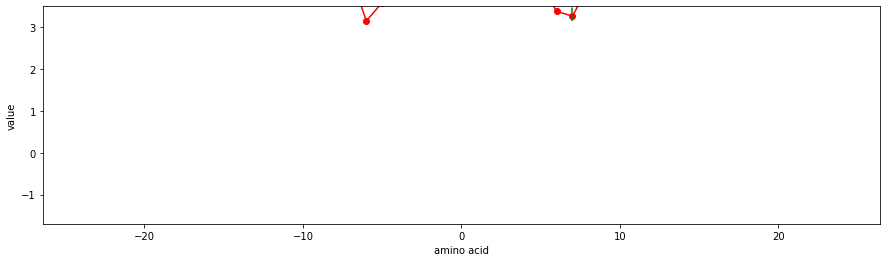

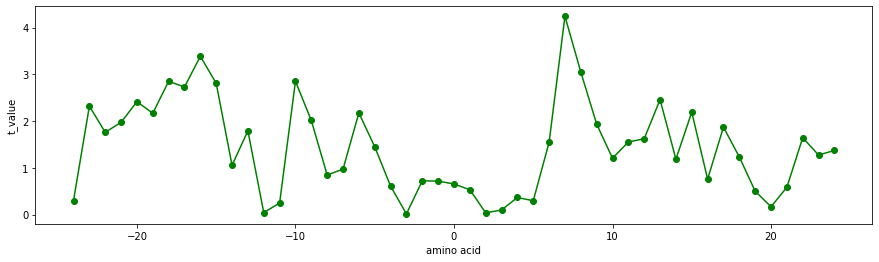

FUKS010104
Surface composition of amino acids in nuclear proteins (percent)


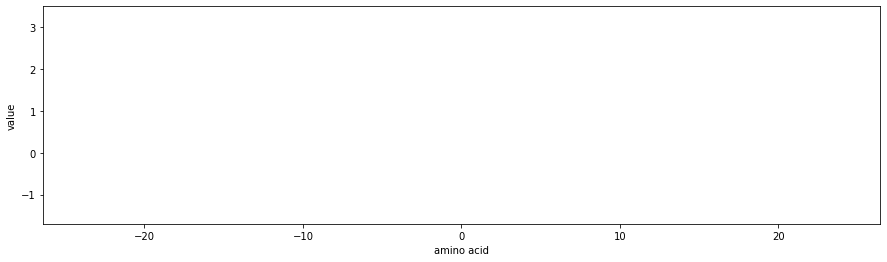

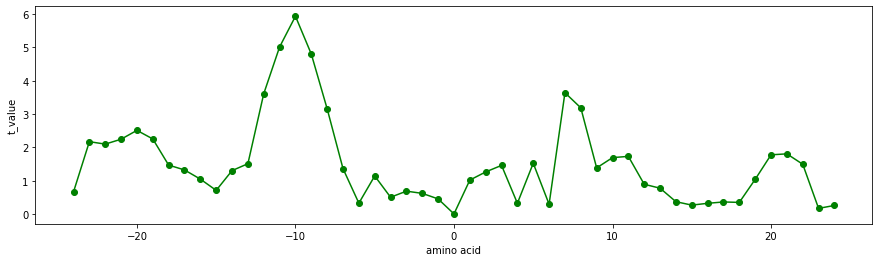

FUKS010105
Interior composition of amino acids in intracellular proteins of thermophiles


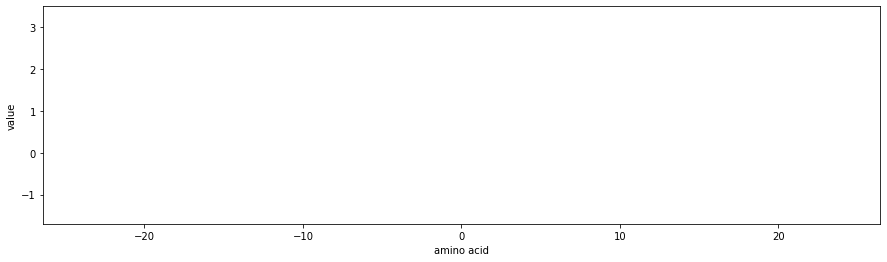

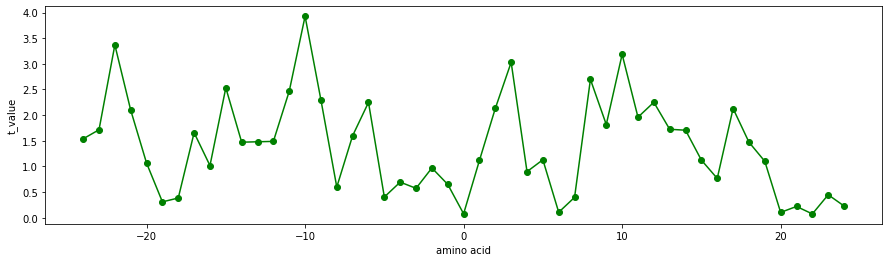

FUKS010106
Interior composition of amino acids in intracellular proteins of mesophiles


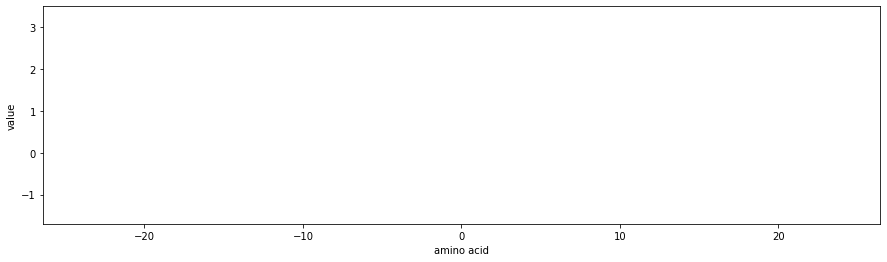

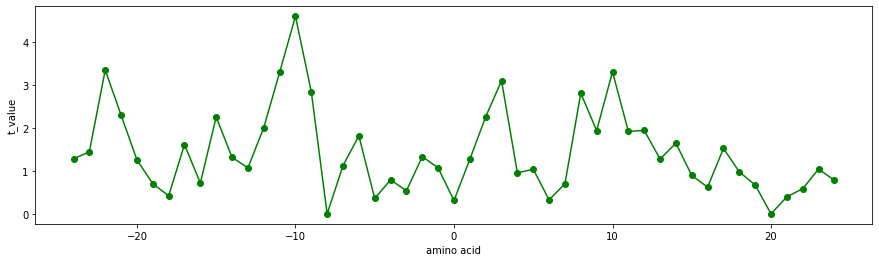

FUKS010107
Interior composition of amino acids in extracellular proteins of mesophiles


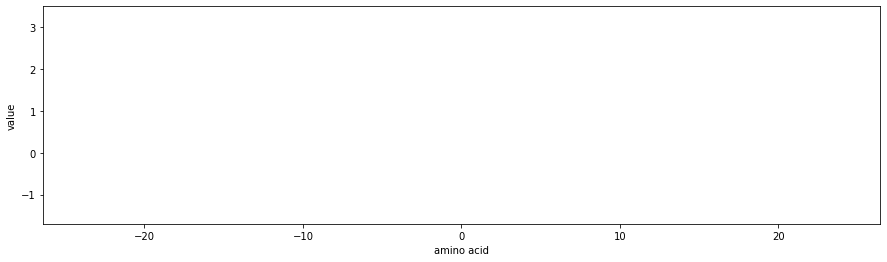

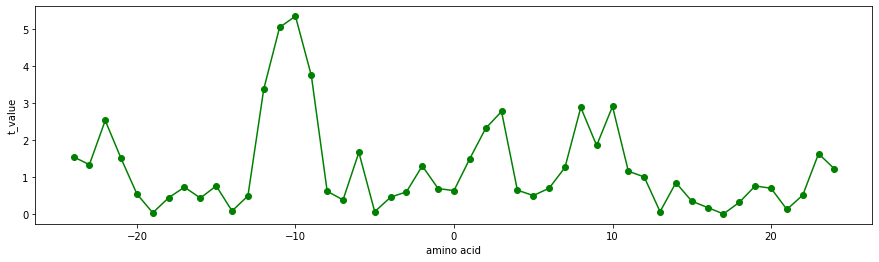

FUKS010108
Interior composition of amino acids in nuclear proteins (percent)


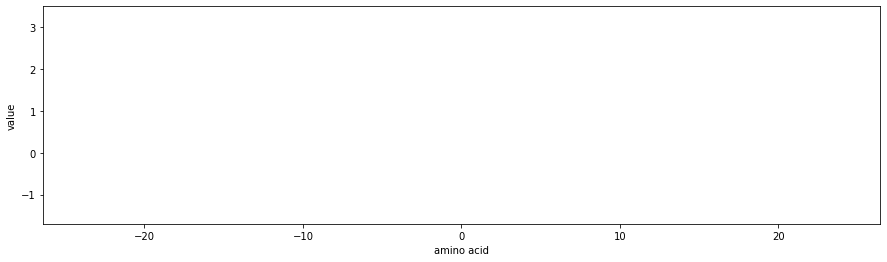

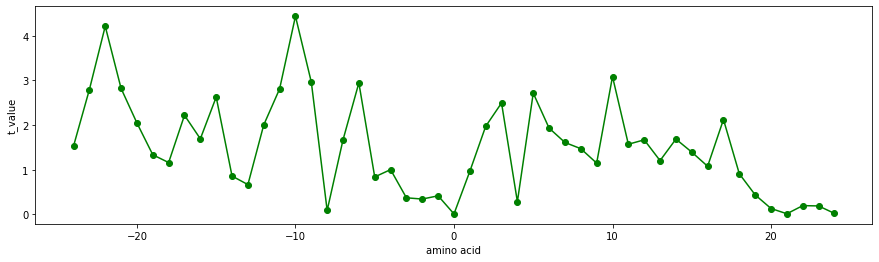

FUKS010110
Entire chain composition of amino acids in intracellular proteins of


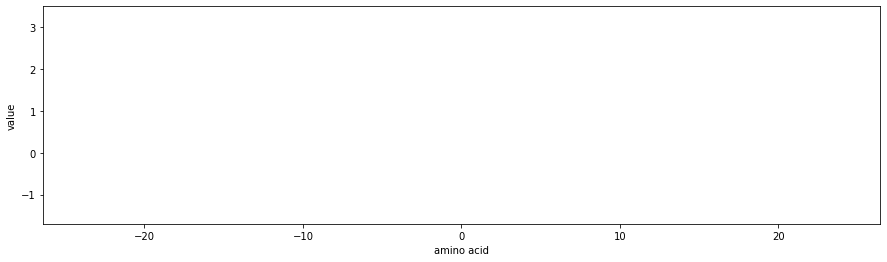

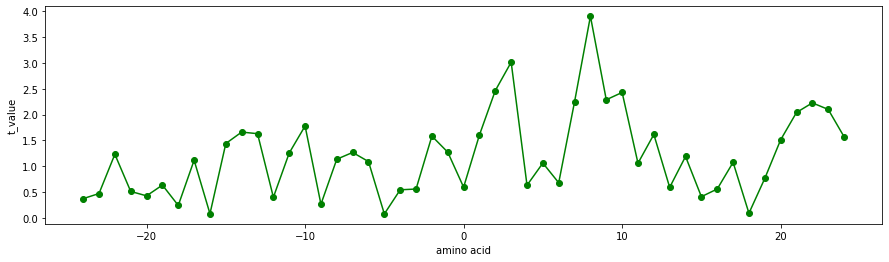

FUKS010111
Entire chain composition of amino acids in extracellular proteins of


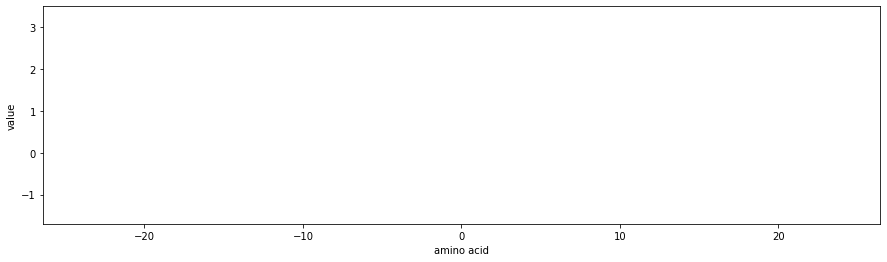

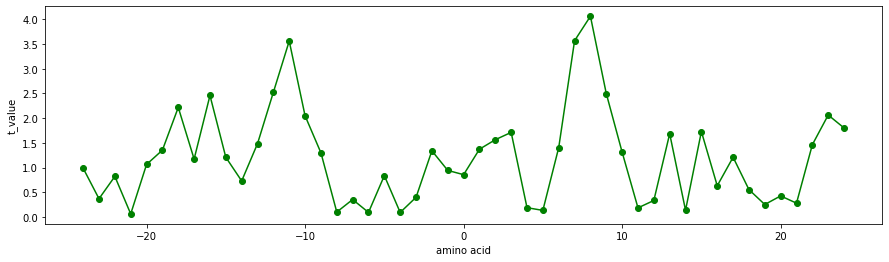

TSAJ990101
Volumes including the crystallographic waters using the ProtOr (Tsai et al.,


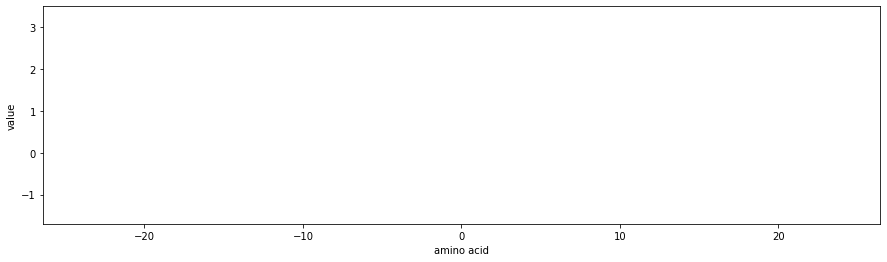

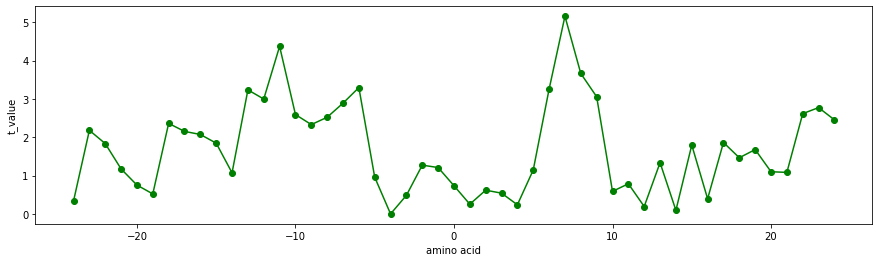

TSAJ990102
Volumes not including the crystallographic waters using the ProtOr (Tsai et


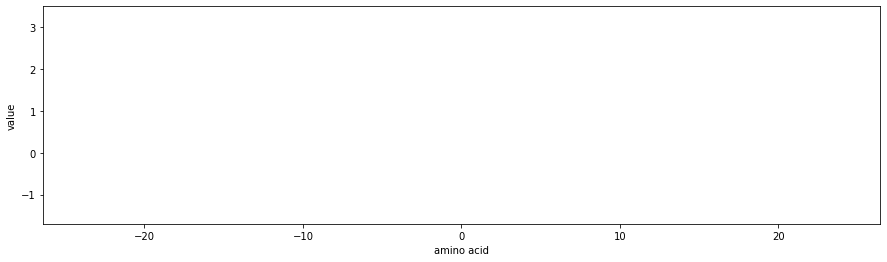

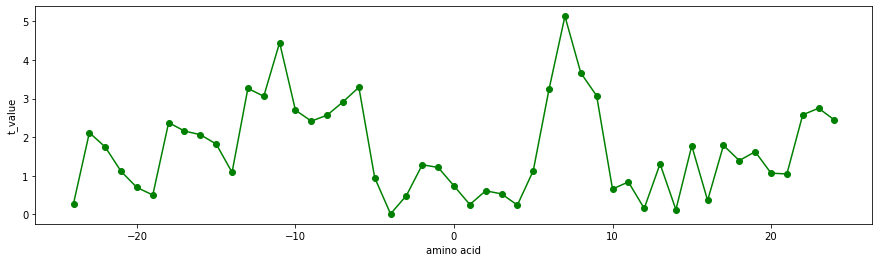

PONP930101
Hydrophobicity scales (Ponnuswamy, 1993)


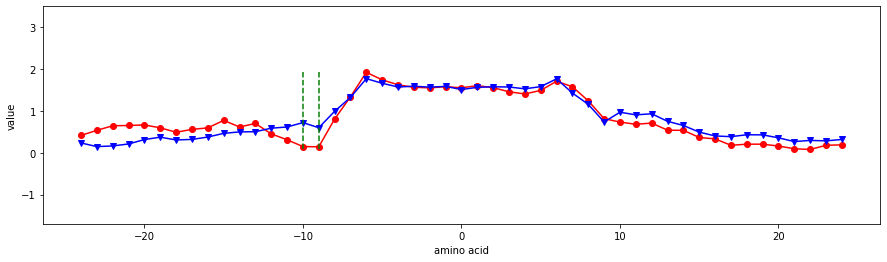

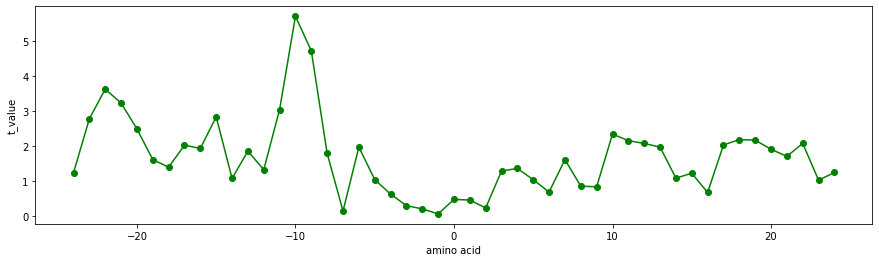

WILM950101
Hydrophobicity coefficient in RP-HPLC, C18 with 0.1%TFA/MeCN/H2O (Wilce et


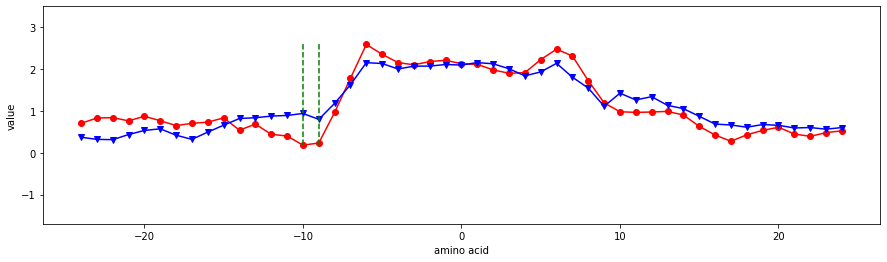

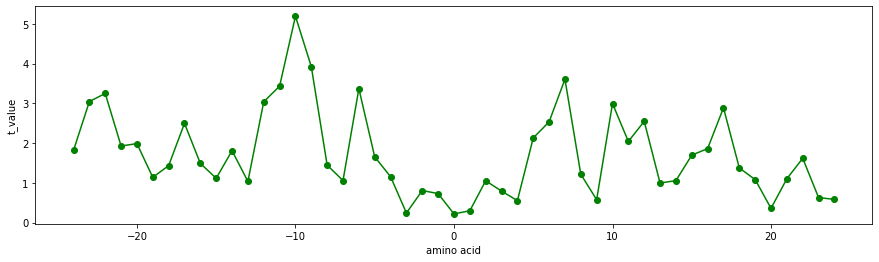

WILM950102
Hydrophobicity coefficient in RP-HPLC, C8 with 0.1%TFA/MeCN/H2O (Wilce et al.


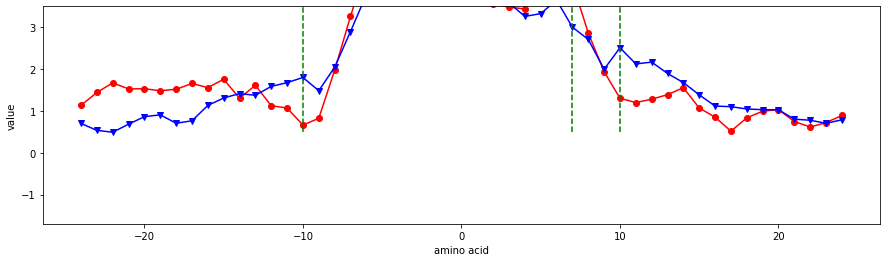

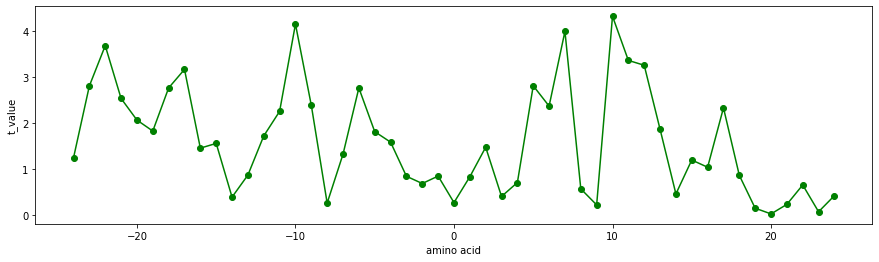

WILM950103
Hydrophobicity coefficient in RP-HPLC, C4 with 0.1%TFA/MeCN/H2O (Wilce et al.


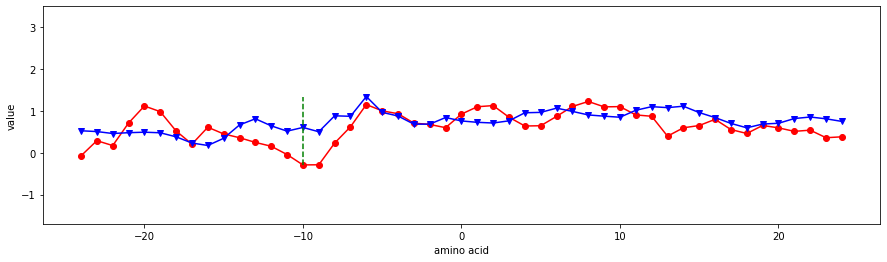

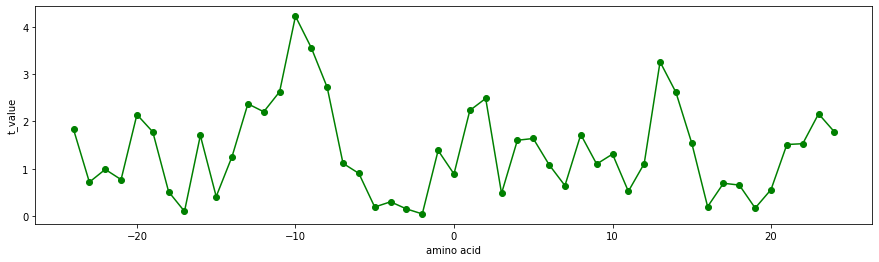

WILM950104
Hydrophobicity coefficient in RP-HPLC, C18 with 0.1%TFA/2-PrOH/MeCN/H2O


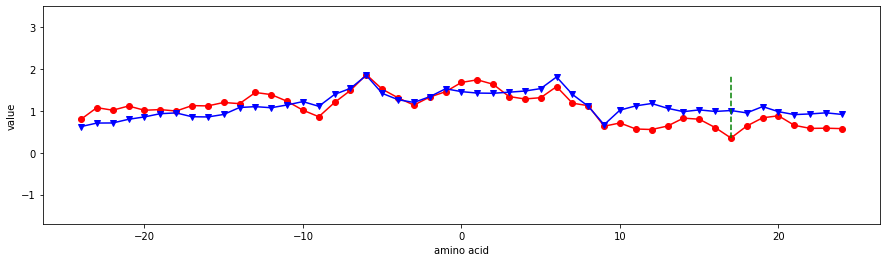

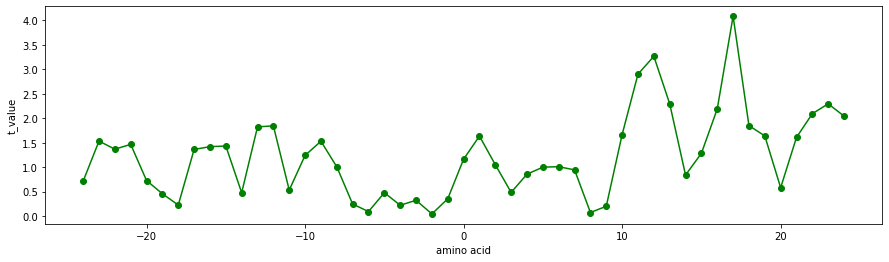

KUHL950101
Hydrophilicity scale (Kuhn et al., 1995)


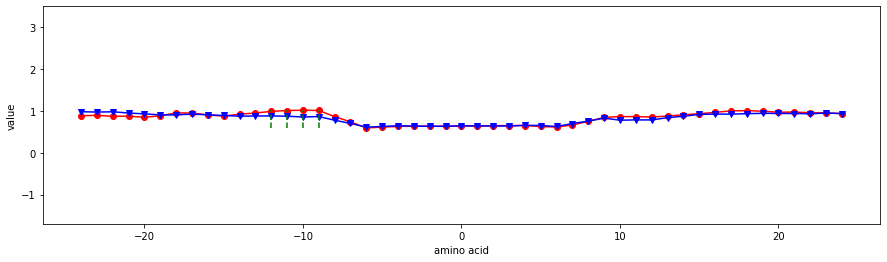

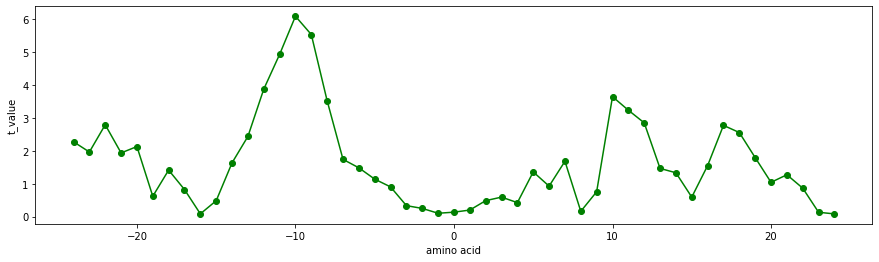

GUOD860101
Retention coefficient at pH 2 (Guo et al., 1986)


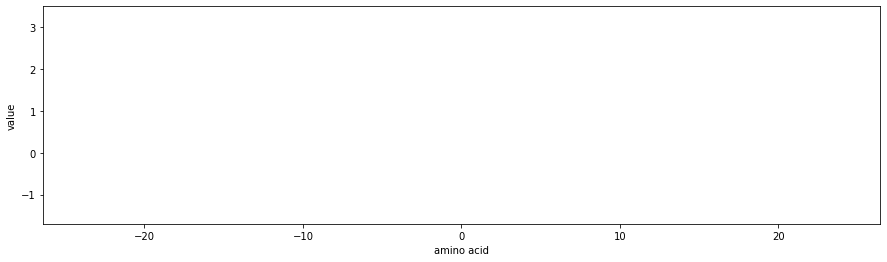

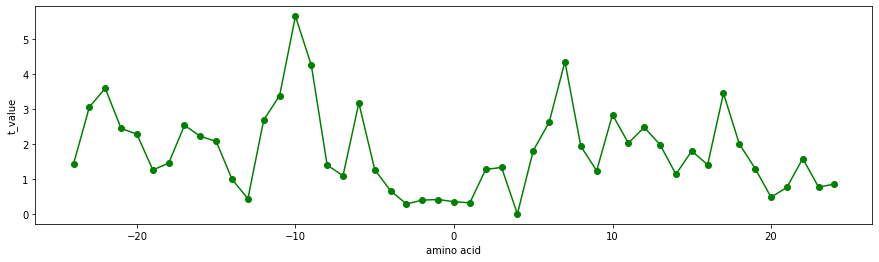

JURD980101
Modified Kyte-Doolittle hydrophobicity scale (Juretic et al., 1998)


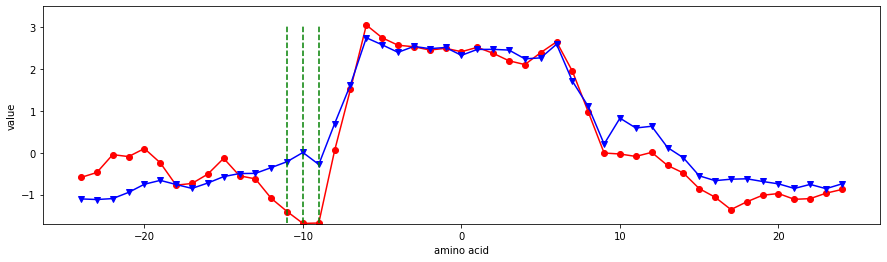

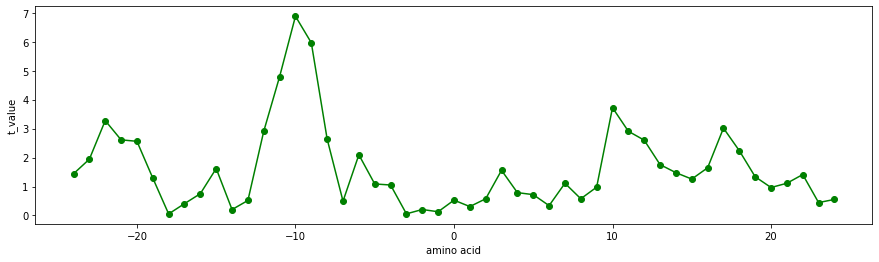

BASU050101
Interactivity scale obtained from the contact matrix (Bastolla et al., 2005)


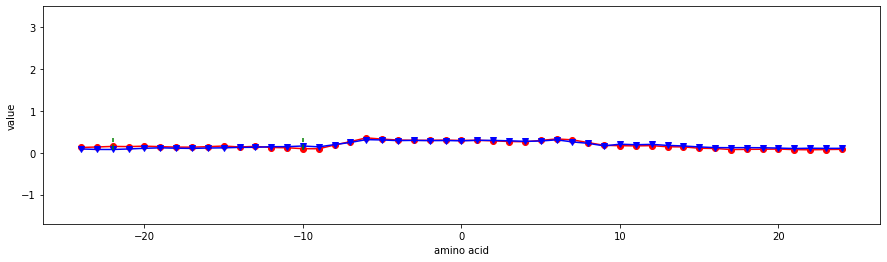

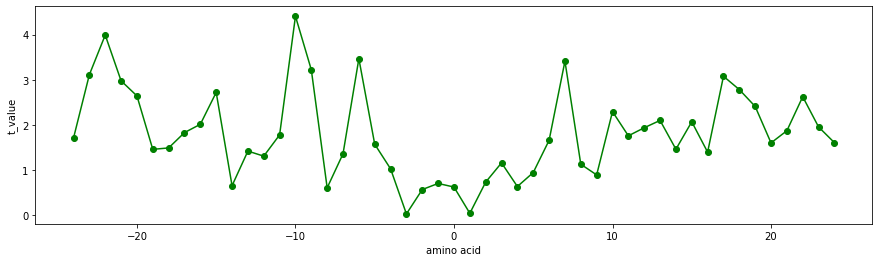

BASU050102
Interactivity scale obtained by maximizing the mean of correlation


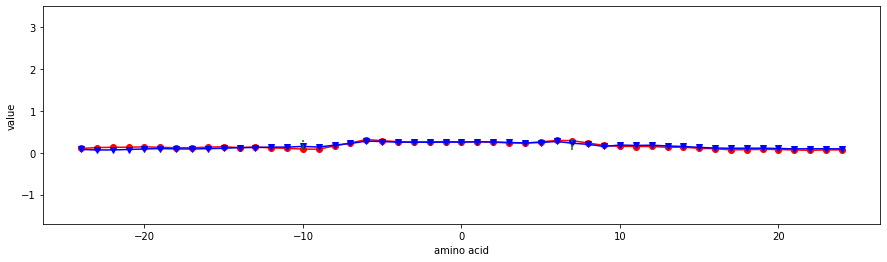

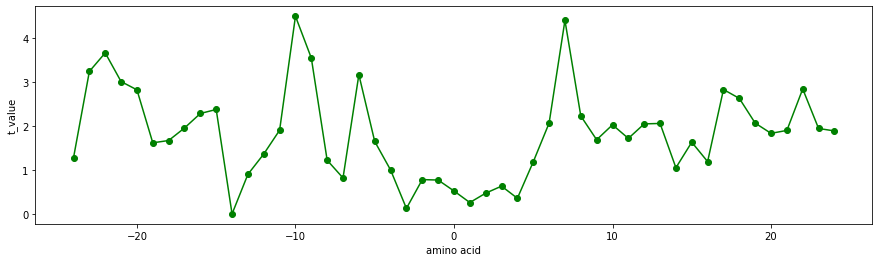

BASU050103
Interactivity scale obtained by maximizing the mean of correlation


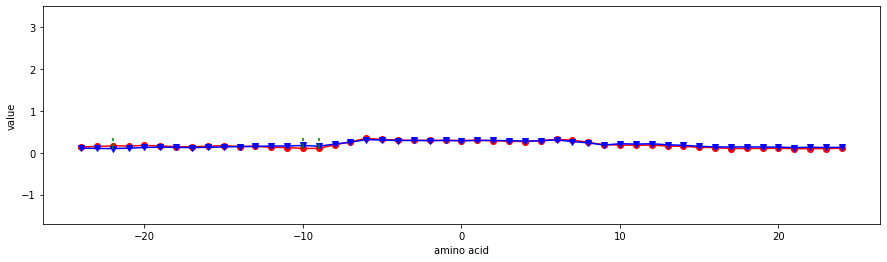

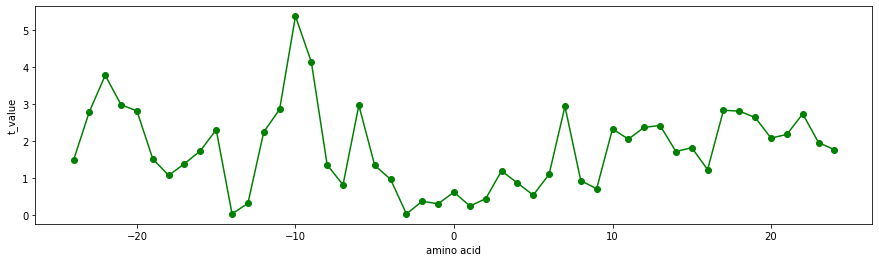

SUYM030101
Linker propensity index (Suyama-Ohara, 2003)


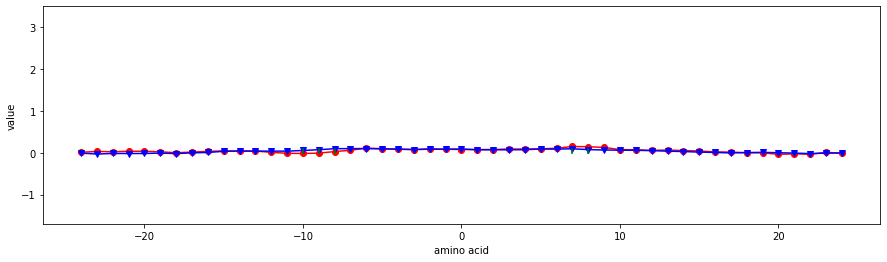

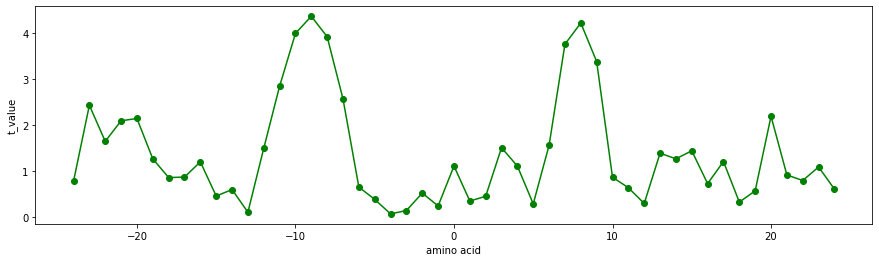

PUNT030101
Knowledge-based membrane-propensity scale from 1D_Helix in MPtopo databases


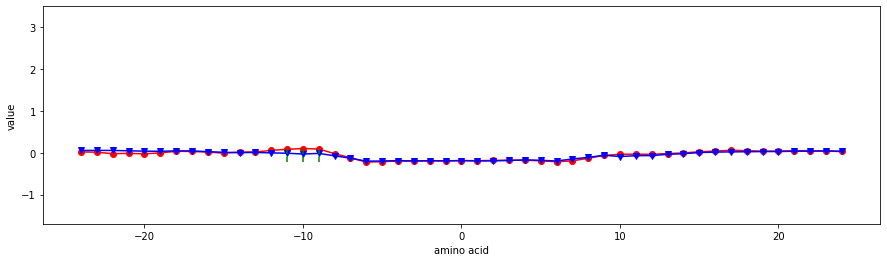

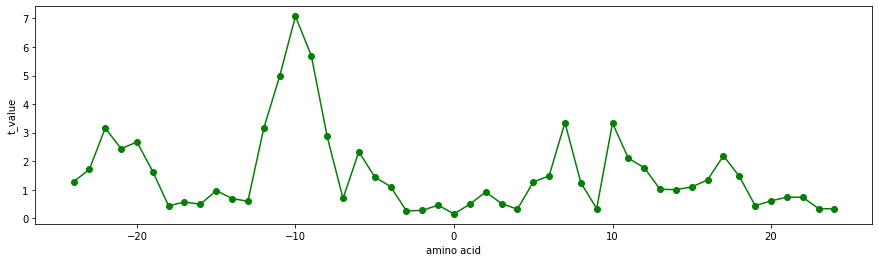

PUNT030102
Knowledge-based membrane-propensity scale from 3D_Helix in MPtopo databases


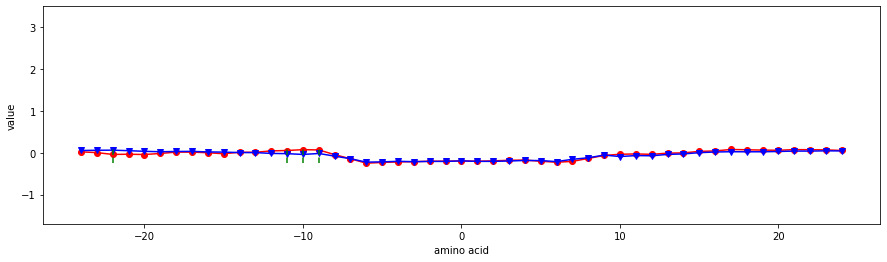

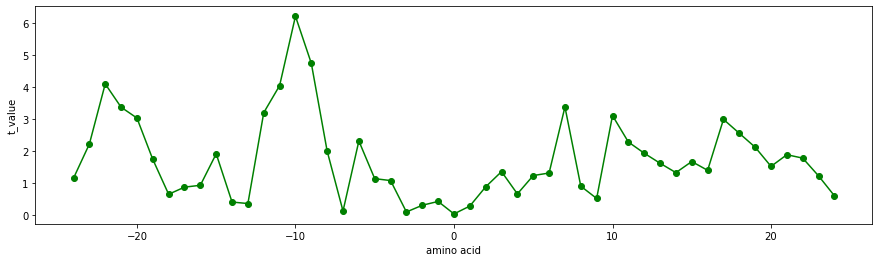

GEOR030101
Linker propensity from all dataset (George-Heringa, 2003)


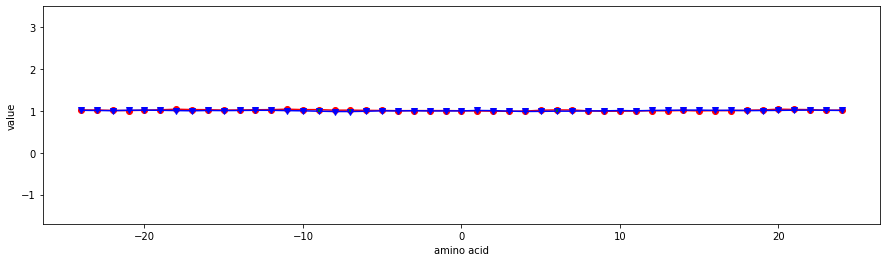

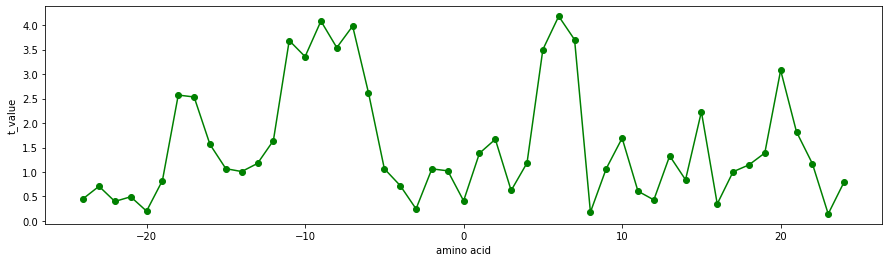

GEOR030102
Linker propensity from 1-linker dataset (George-Heringa, 2003)


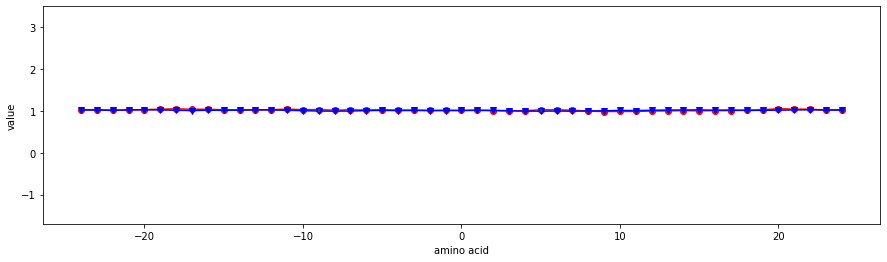

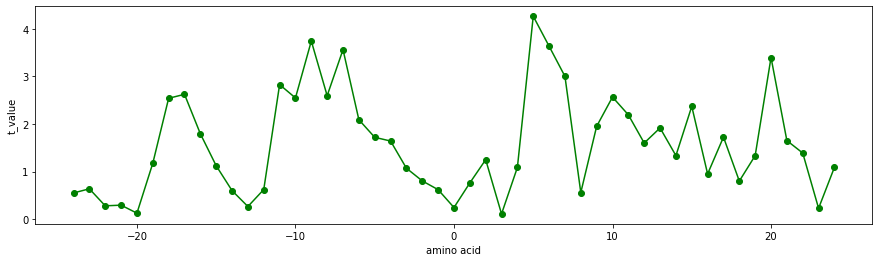

GEOR030104
Linker propensity from 3-linker dataset (George-Heringa, 2003)


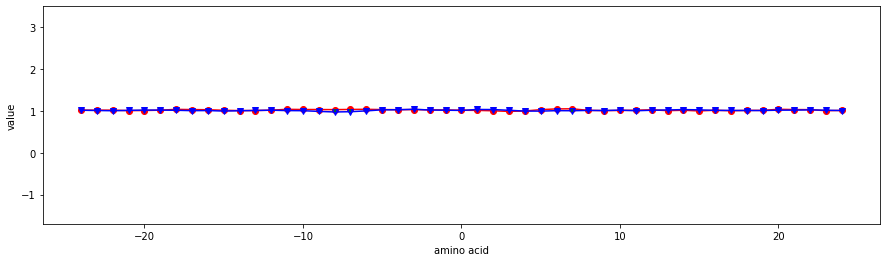

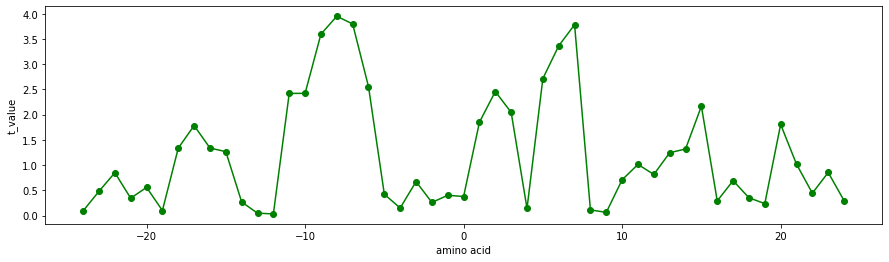

GEOR030105
Linker propensity from small dataset (linker length is less than six


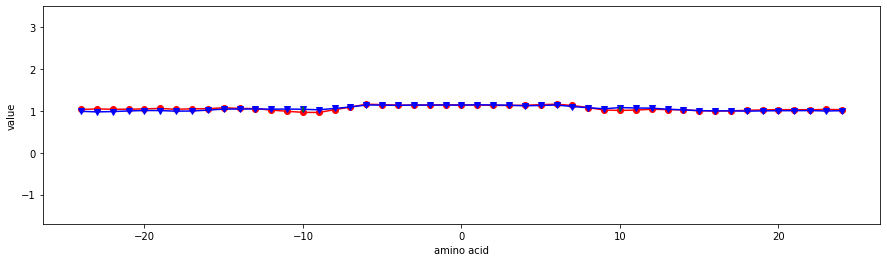

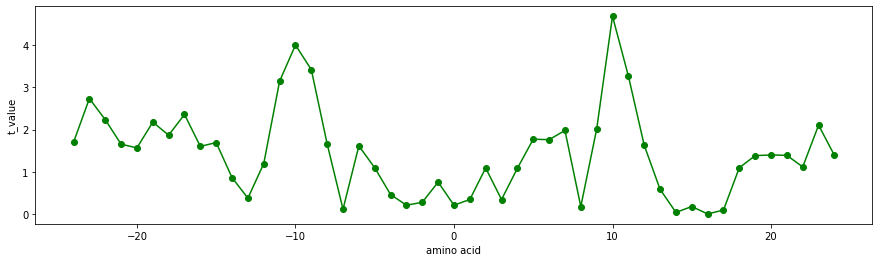

GEOR030106
Linker propensity from medium dataset (linker length is between six and 14


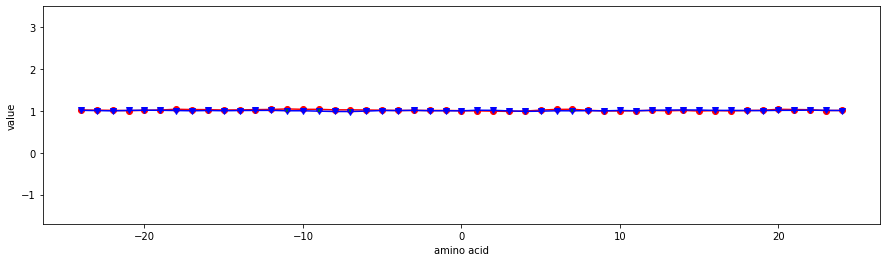

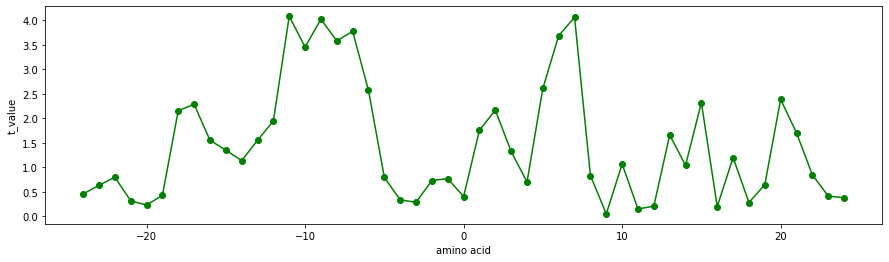

GEOR030107
Linker propensity from long dataset (linker length is greater than 14


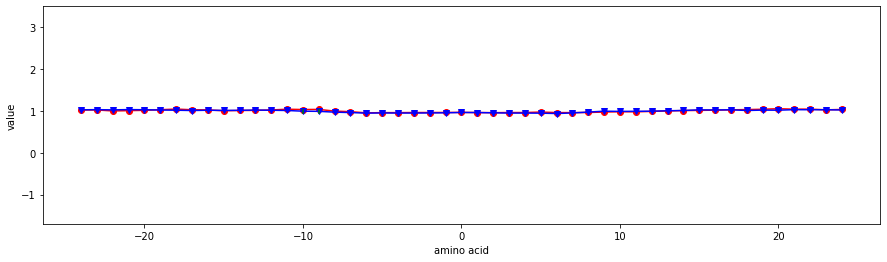

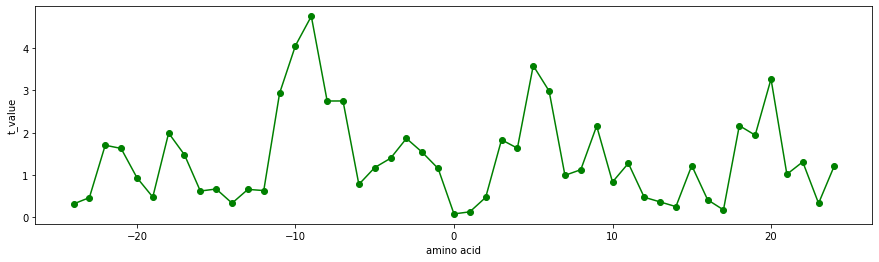

GEOR030108
Linker propensity from helical (annotated by DSSP) dataset (George-Heringa,


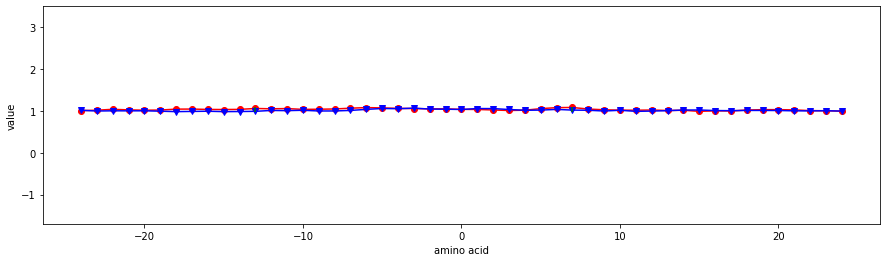

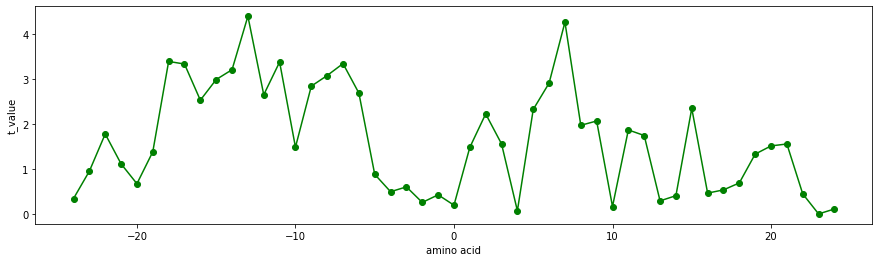

ZHOH040101
The stability scale from the knowledge-based atom-atom potential (Zhou-Zhou,


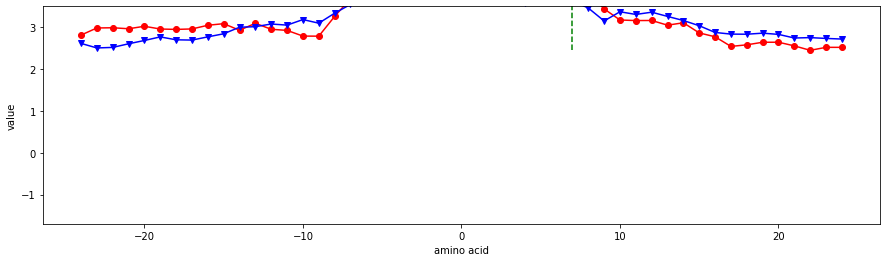

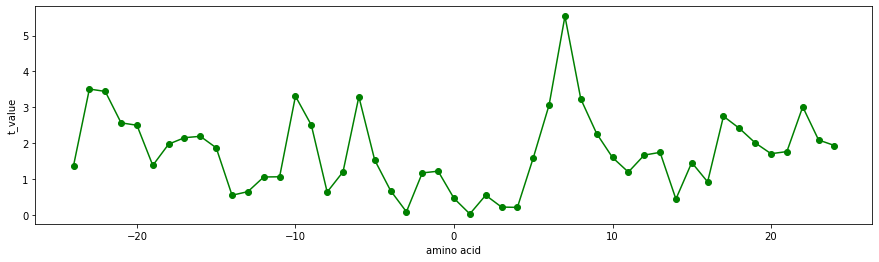

ZHOH040102
The relative stability scale extracted from mutation experiments (Zhou-Zhou,


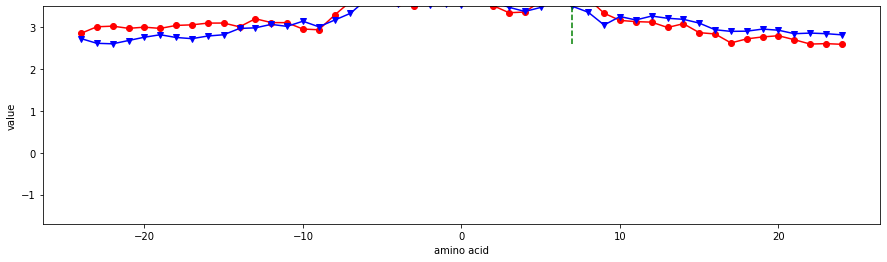

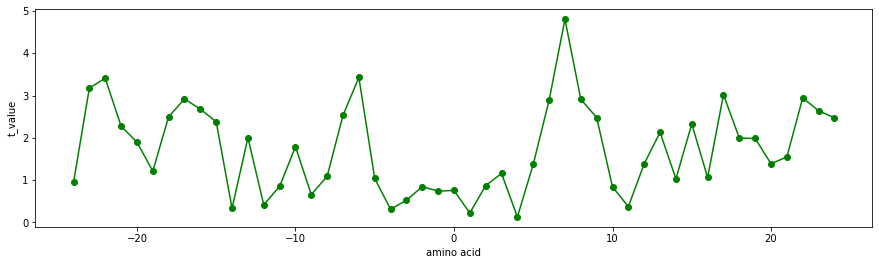

ZHOH040103
Buriability (Zhou-Zhou, 2004)


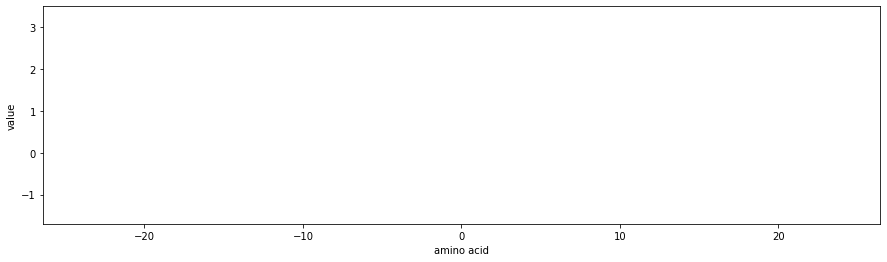

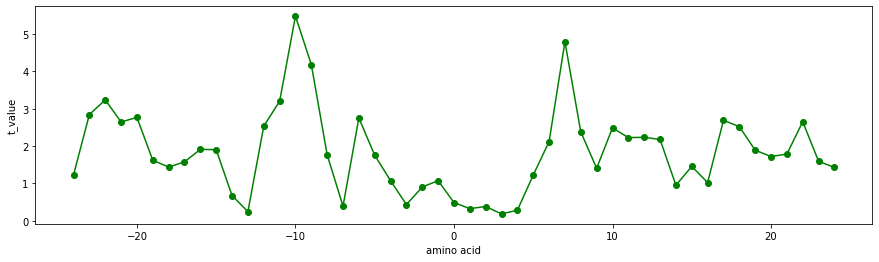

BAEK050101
Linker index (Bae et al., 2005)


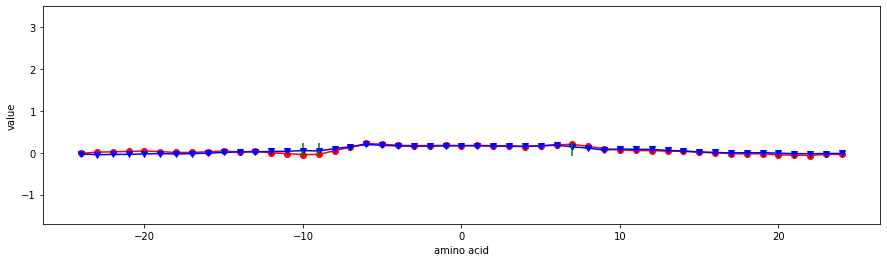

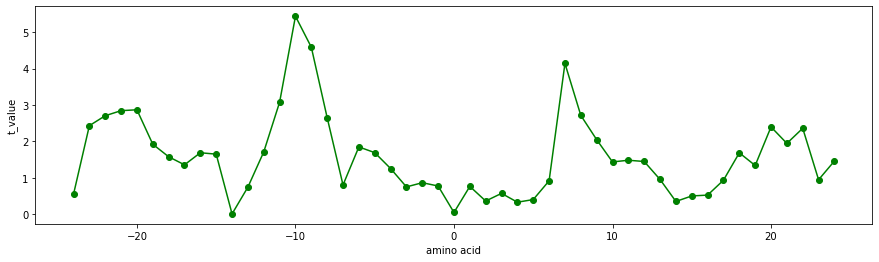

HARY940101
Mean volumes of residues buried in protein interiors (Harpaz et al., 1994)


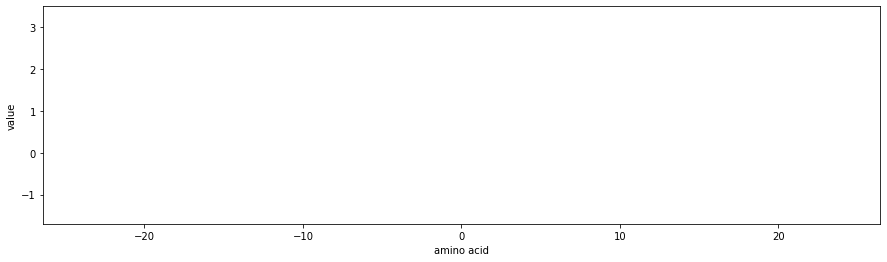

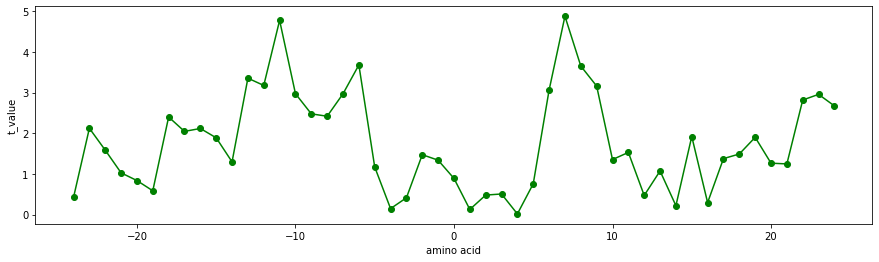

PONJ960101
Average volumes of residues (Pontius et al., 1996)


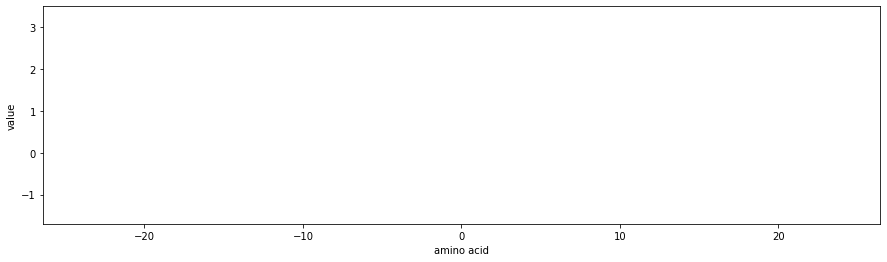

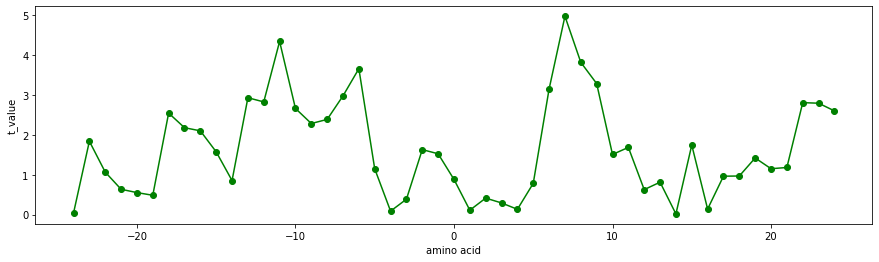

DIGM050101
Hydrostatic pressure asymmetry index, PAI (Di Giulio, 2005)


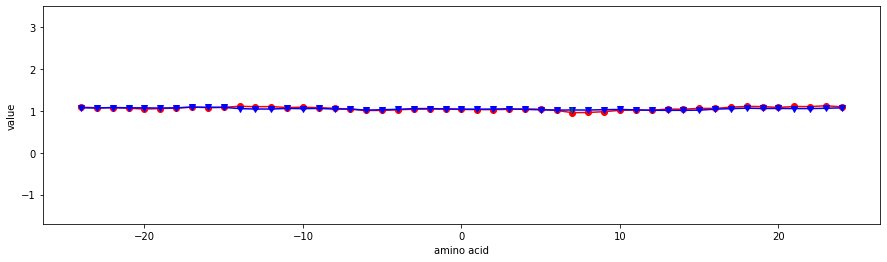

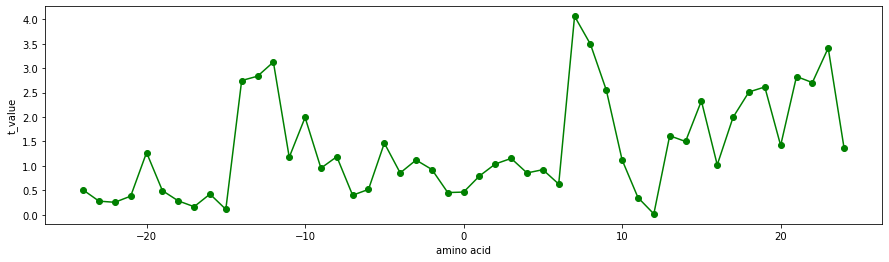

WOLR790101
Hydrophobicity index (Wolfenden et al., 1979)


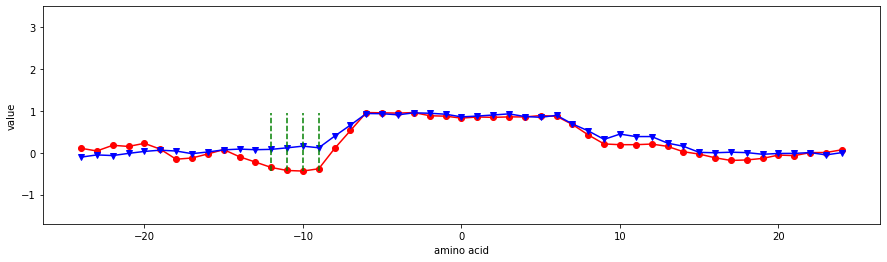

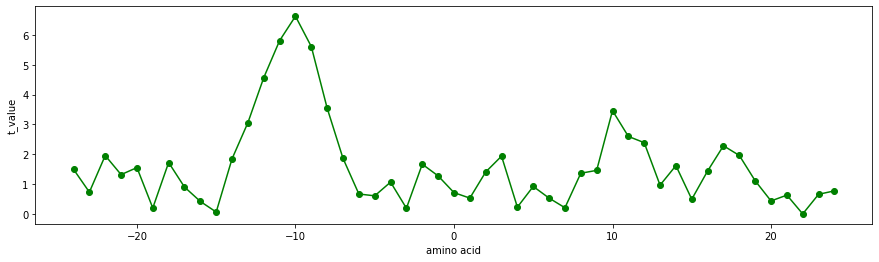

OLSK800101
Average internal preferences (Olsen, 1980)


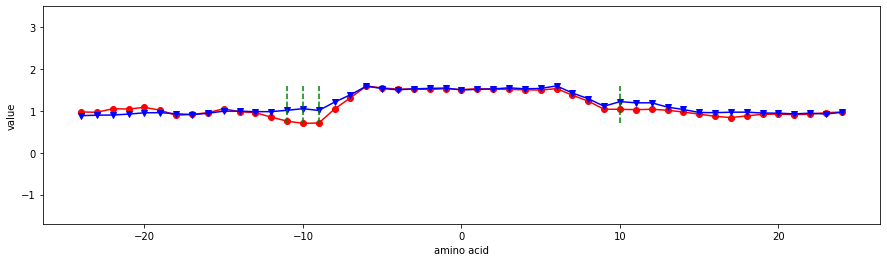

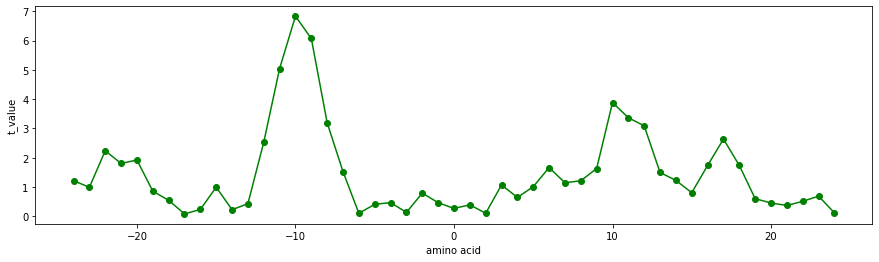

KIDA850101
Hydrophobicity-related index (Kidera et al., 1985)


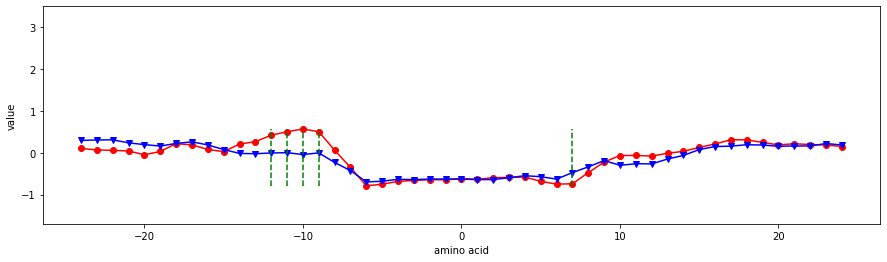

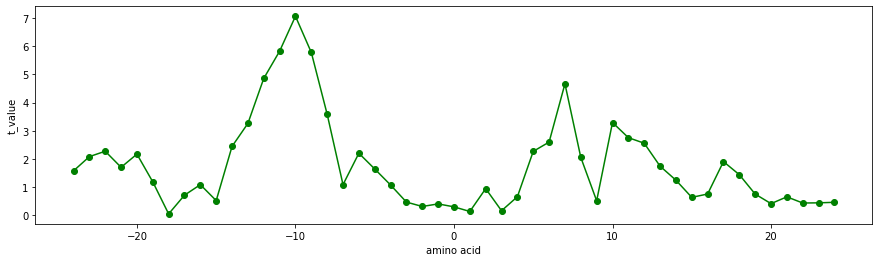

GUYH850102
Apparent partition energies calculated from Wertz-Scheraga index (Guy, 1985)


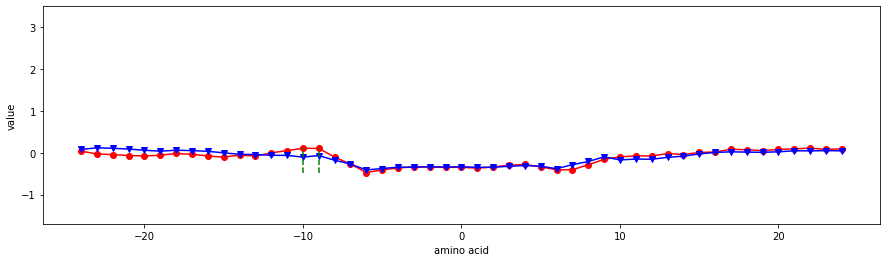

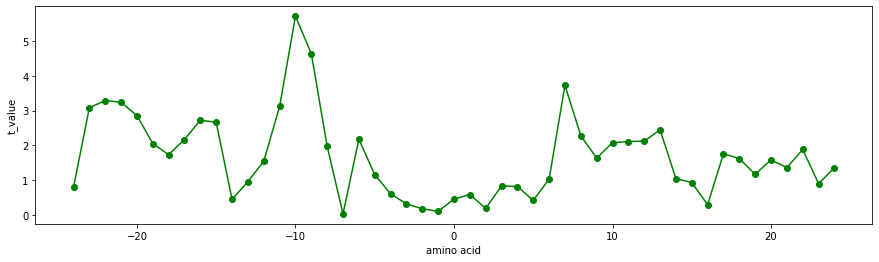

GUYH850104
Apparent partition energies calculated from Janin index (Guy, 1985)


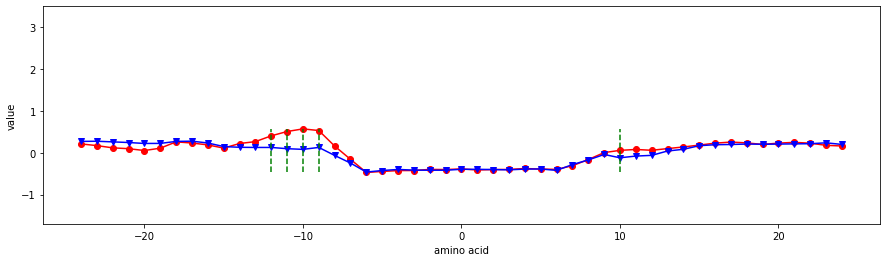

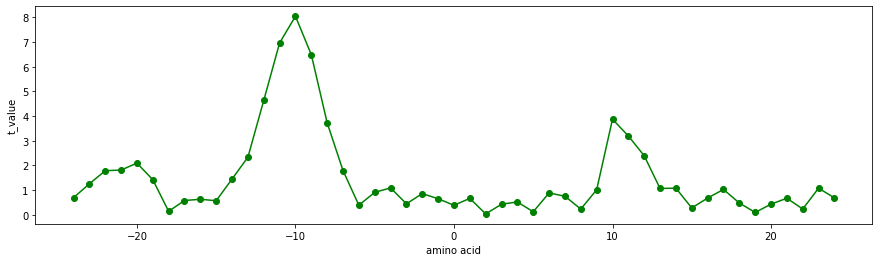

GUYH850105
Apparent partition energies calculated from Chothia index (Guy, 1985)


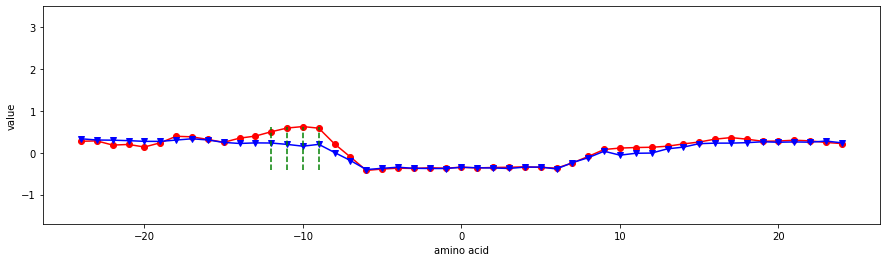

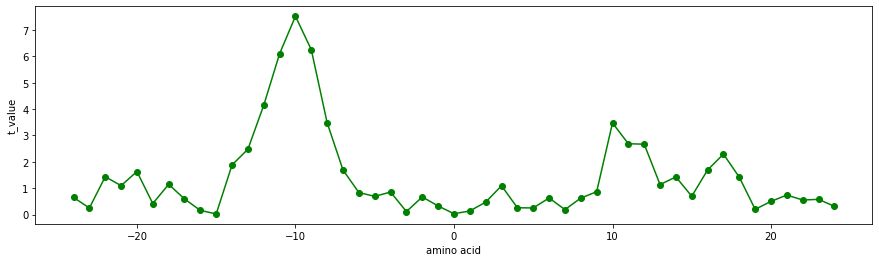

JACR890101
Weights from the IFH scale (Jacobs-White, 1989)


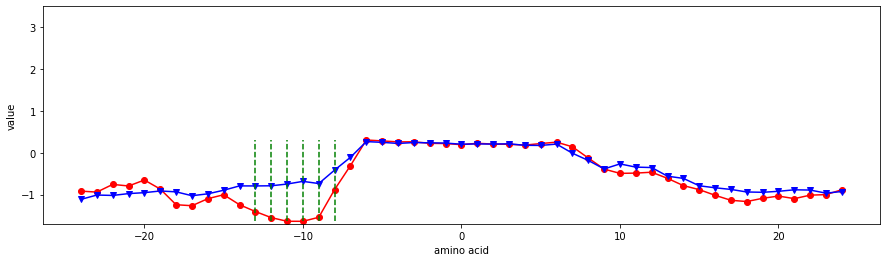

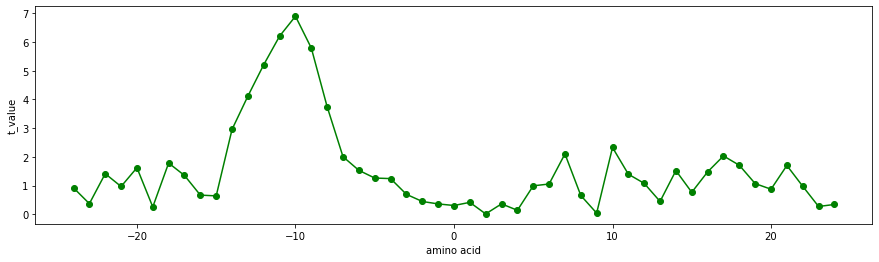

COWR900101
Hydrophobicity index, 3.0 pH (Cowan-Whittaker, 1990)


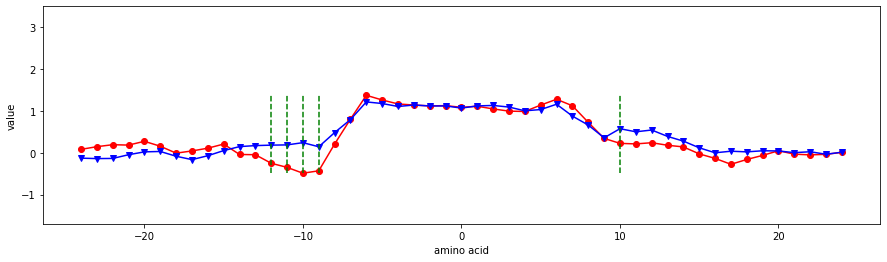

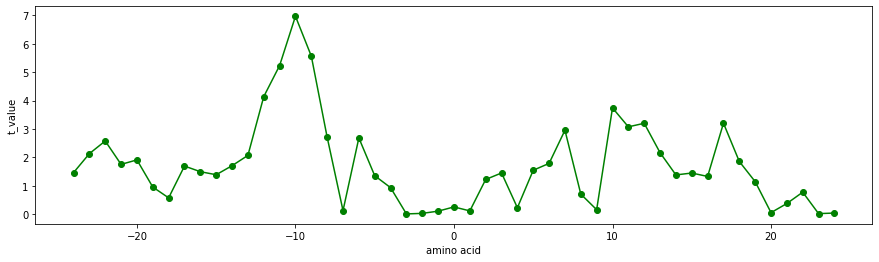

BLAS910101
Scaled side chain hydrophobicity values (Black-Mould, 1991)


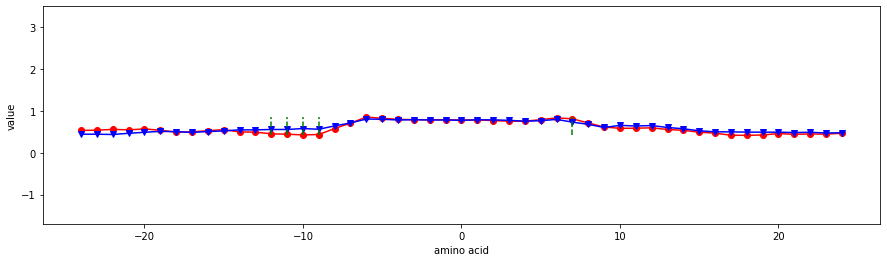

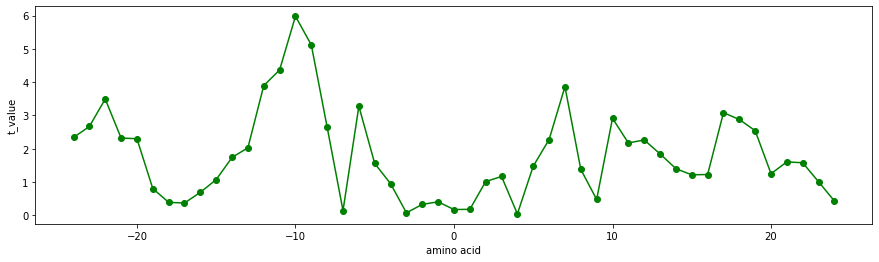

CASG920101
Hydrophobicity scale from native protein structures (Casari-Sippl, 1992)


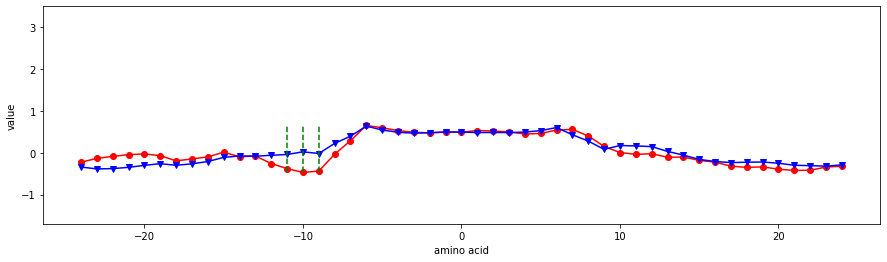

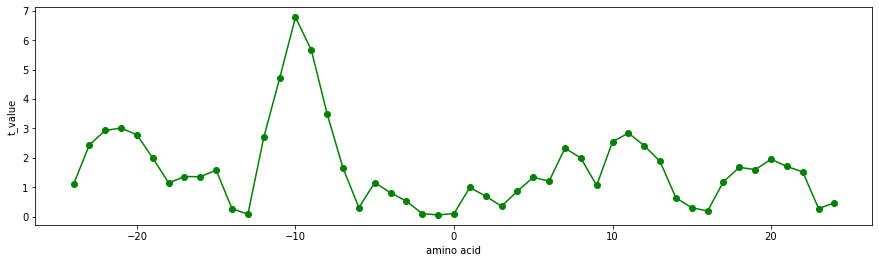

CORJ870101
NNEIG index (Cornette et al., 1987)


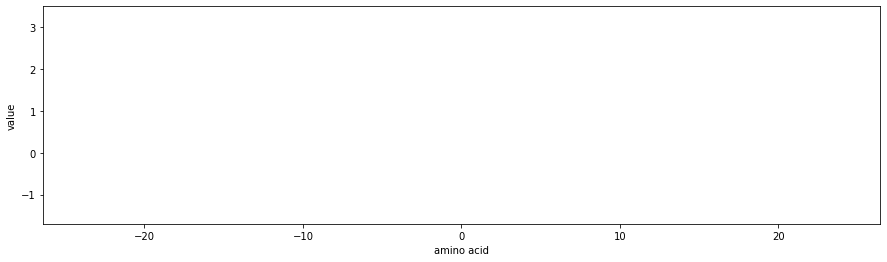

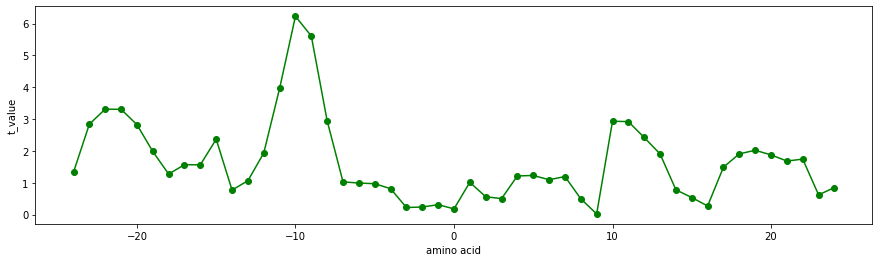

CORJ870102
SWEIG index (Cornette et al., 1987)


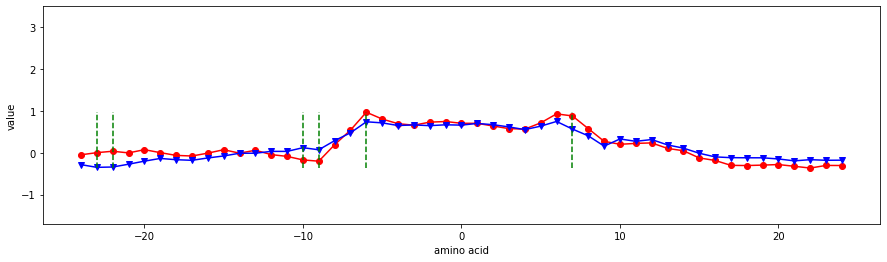

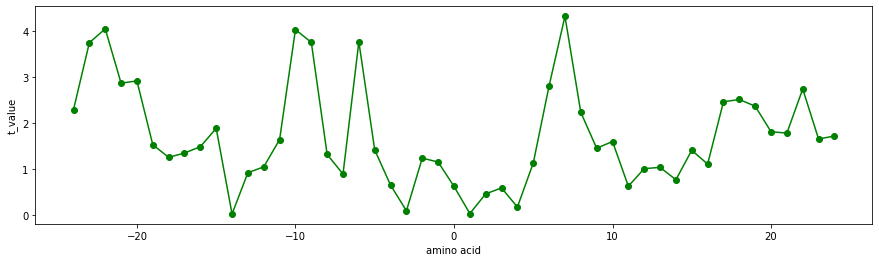

CORJ870103
PRIFT index (Cornette et al., 1987)


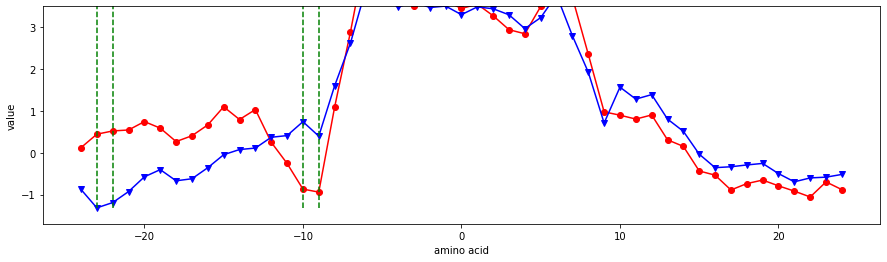

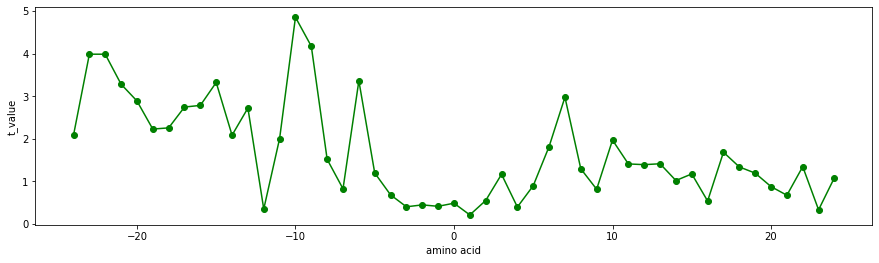

CORJ870104
PRILS index (Cornette et al., 1987)


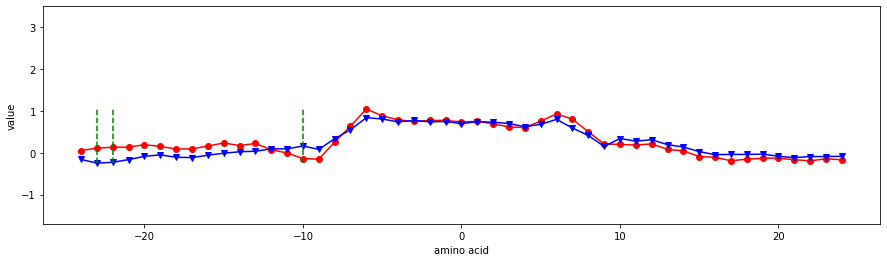

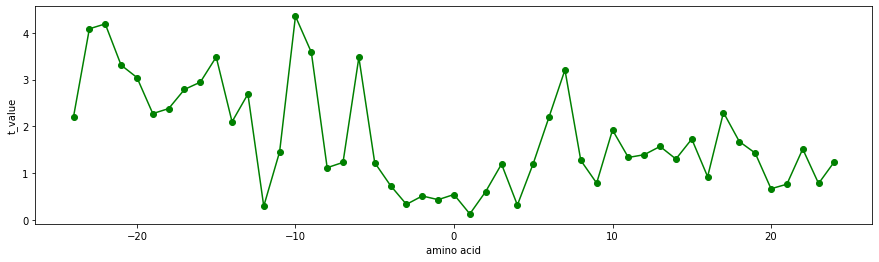

CORJ870105
ALTFT index (Cornette et al., 1987)


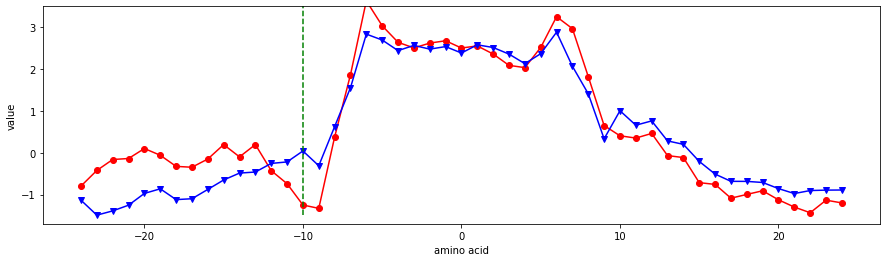

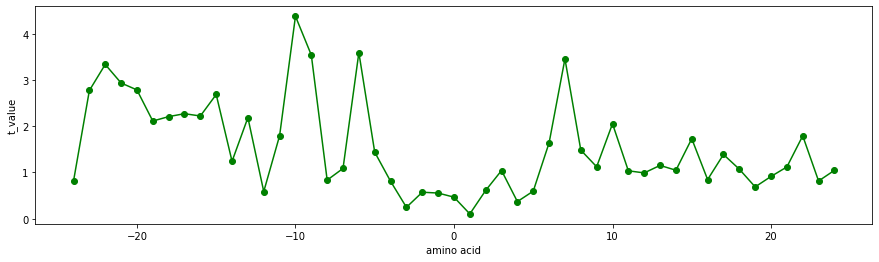

CORJ870106
ALTLS index (Cornette et al., 1987)


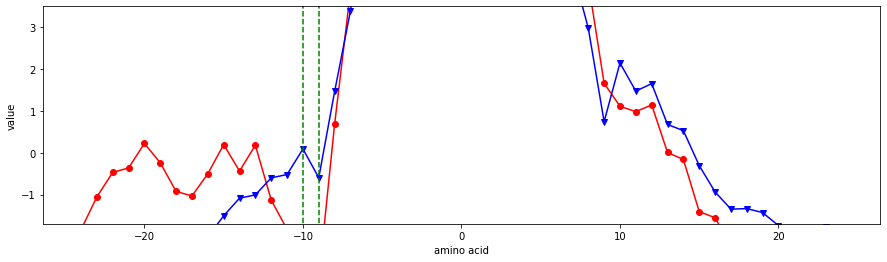

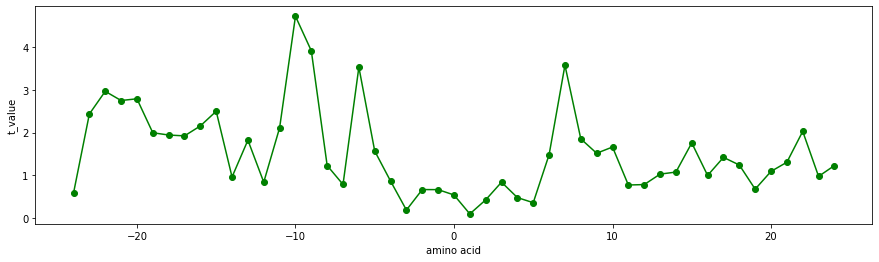

CORJ870107
TOTFT index (Cornette et al., 1987)


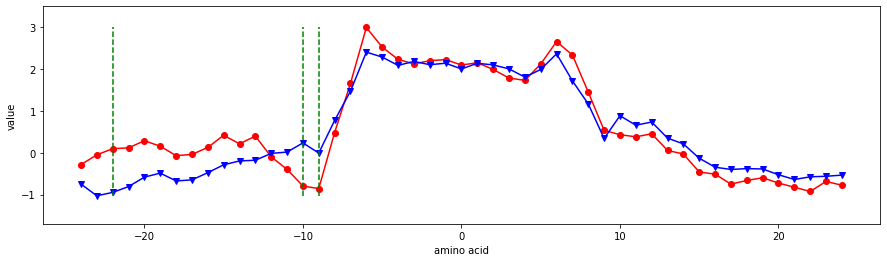

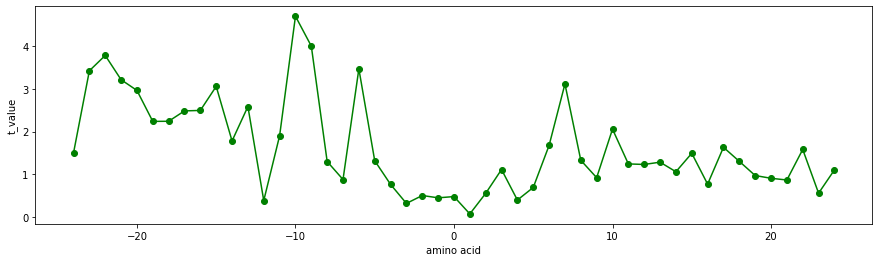

CORJ870108
TOTLS index (Cornette et al., 1987)


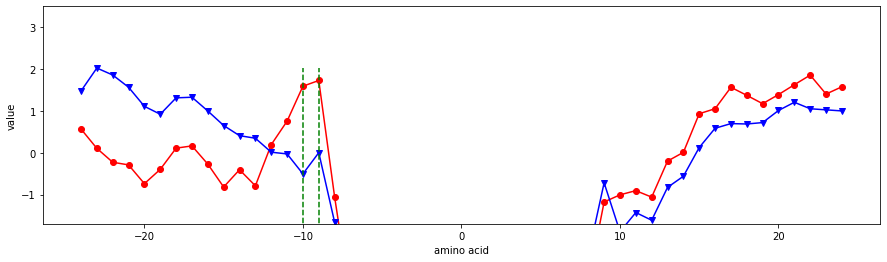

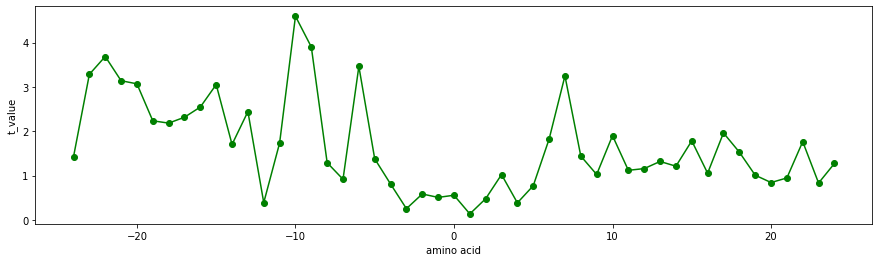

MIYS990101
Relative partition energies derived by the Bethe approximation


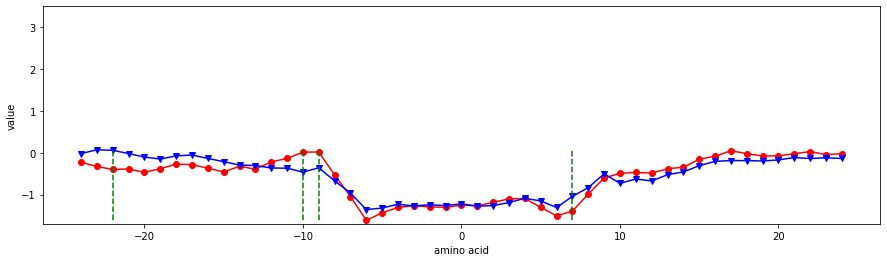

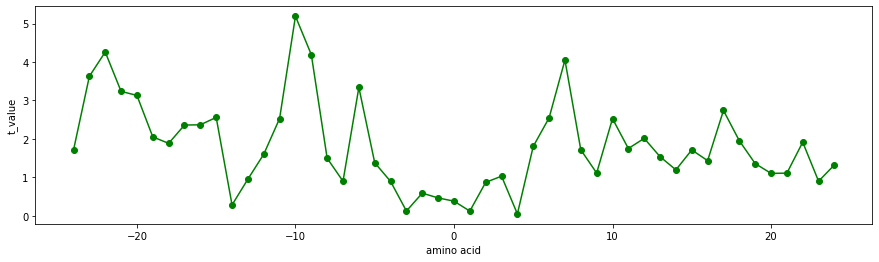

MIYS990102
Optimized relative partition energies - method A (Miyazawa-Jernigan, 1999)


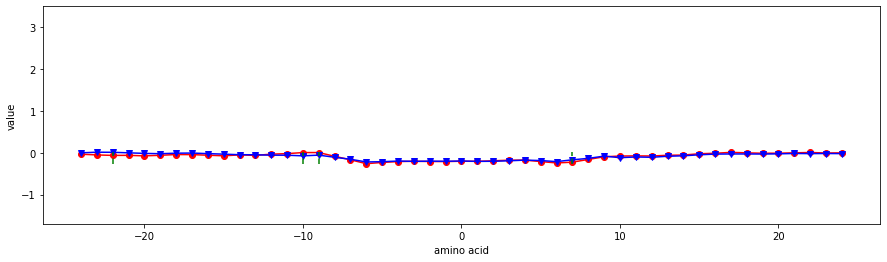

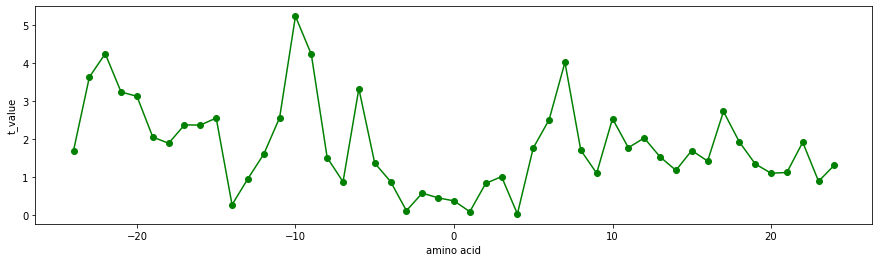

MIYS990103
Optimized relative partition energies - method B (Miyazawa-Jernigan, 1999)


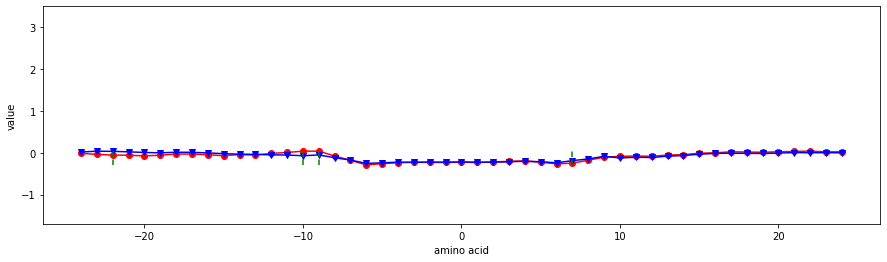

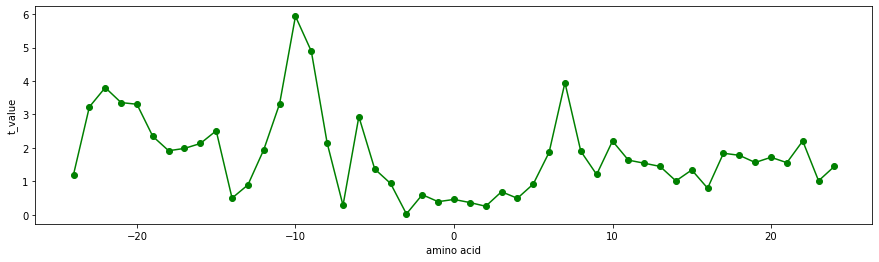

MIYS990104
Optimized relative partition energies - method C (Miyazawa-Jernigan, 1999)


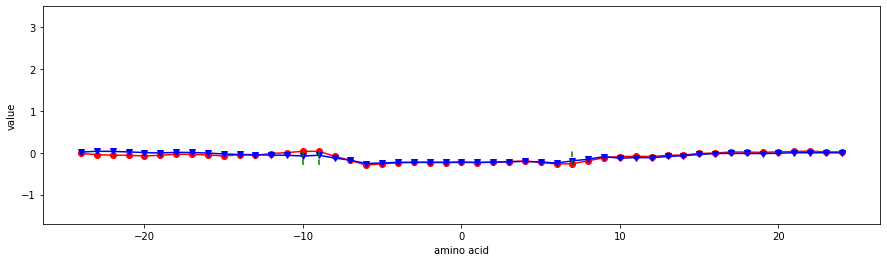

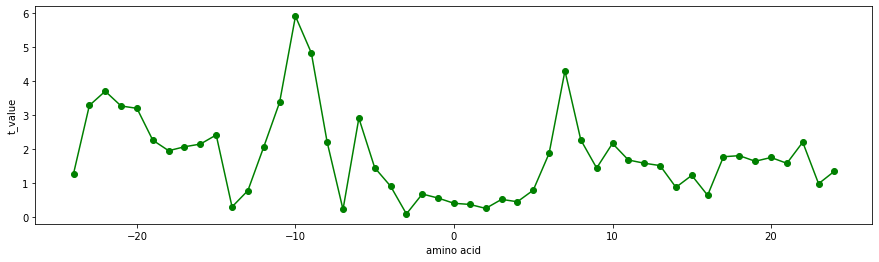

MIYS990105
Optimized relative partition energies - method D (Miyazawa-Jernigan, 1999)


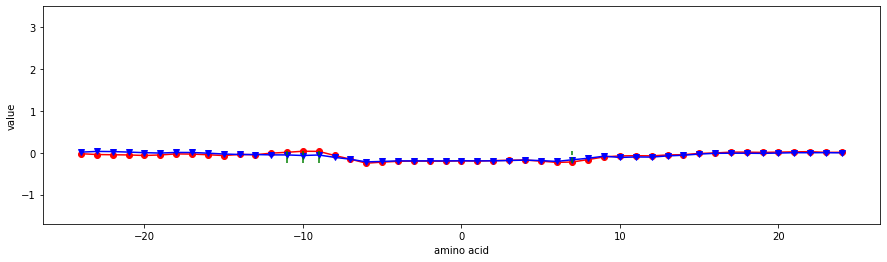

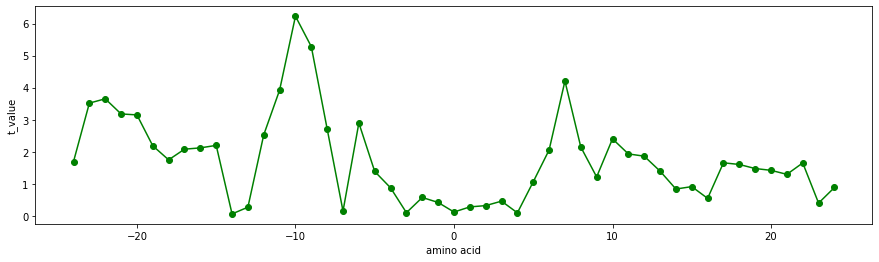

ENGD860101
Hydrophobicity index (Engelman et al., 1986)


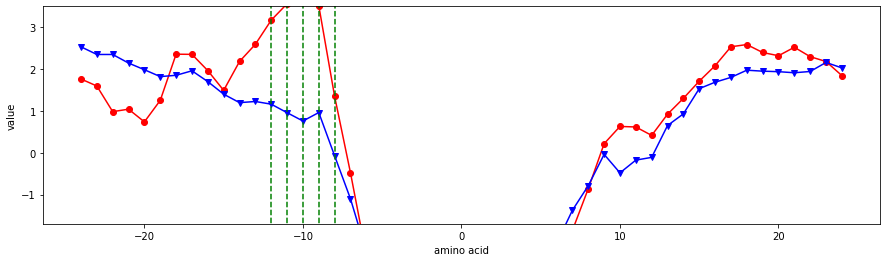

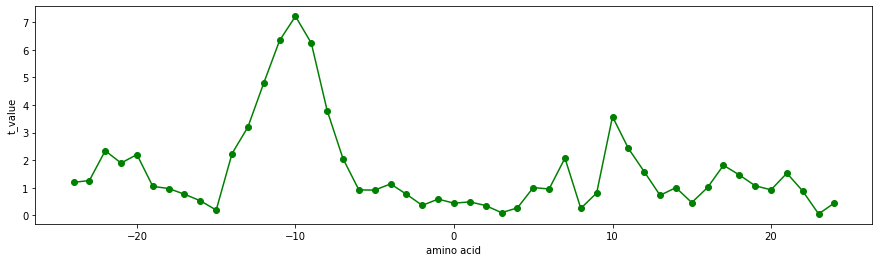

FASG890101
Hydrophobicity index (Fasman, 1989)


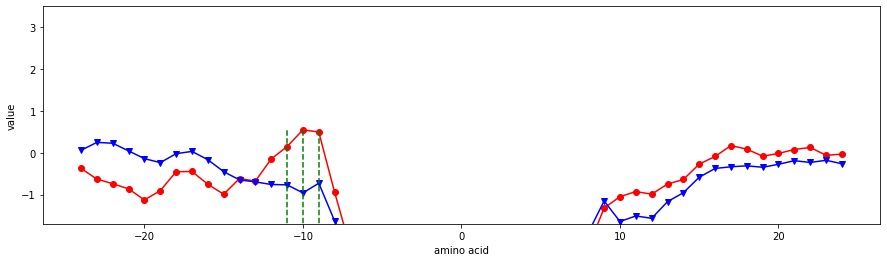

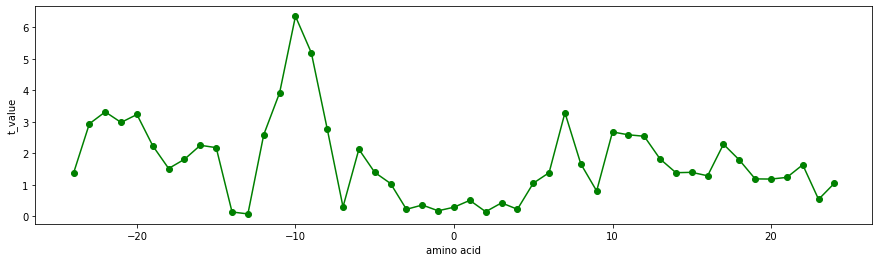

KARS160101
Number of vertices (order of the graph) (Karkbara-Knisley, 2016)


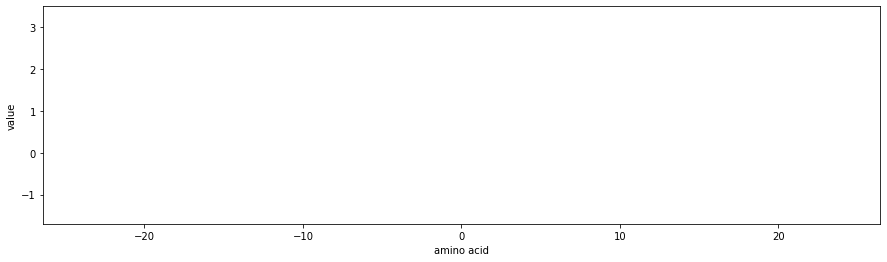

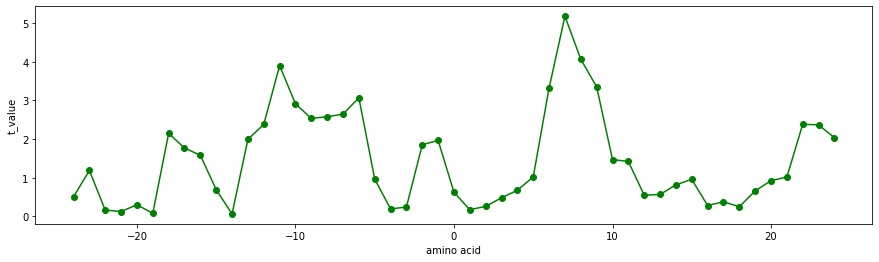

KARS160102
Number of edges (size of the graph) (Karkbara-Knisley, 2016)


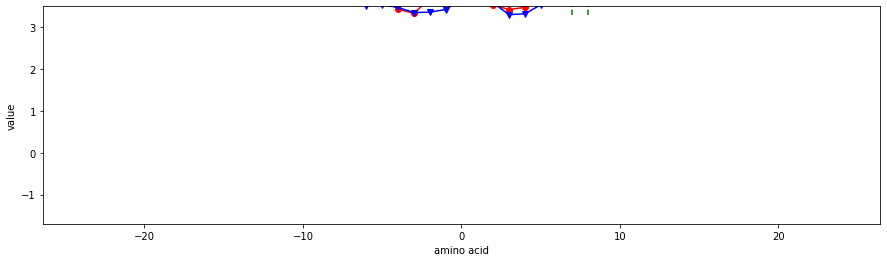

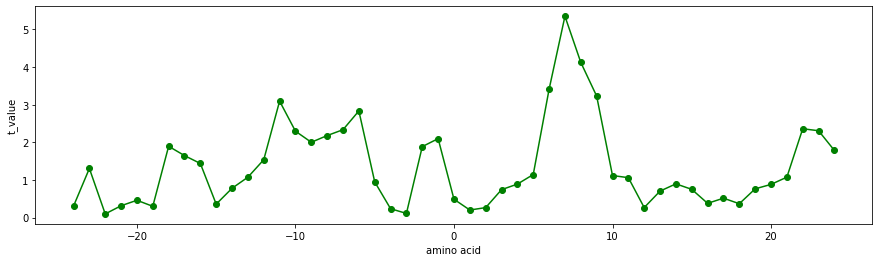

KARS160103
Total weighted degree of the graph (obtained by adding all the weights of


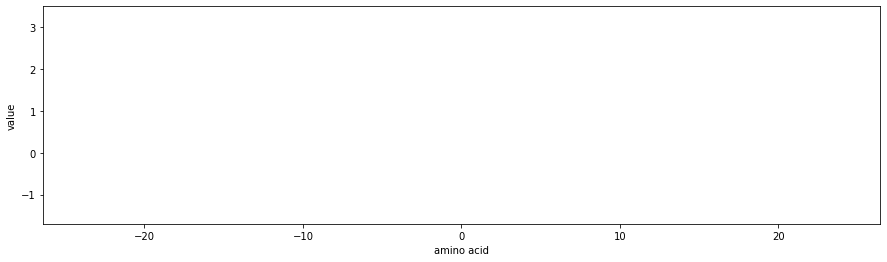

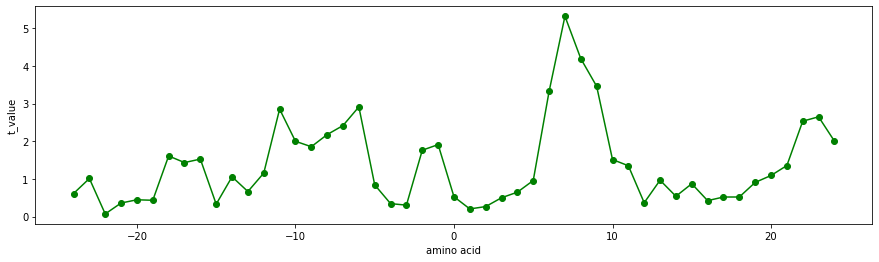

KARS160104
Weighted domination number (Karkbara-Knisley, 2016)


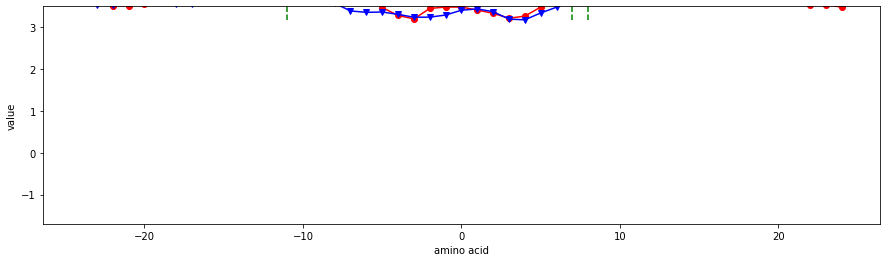

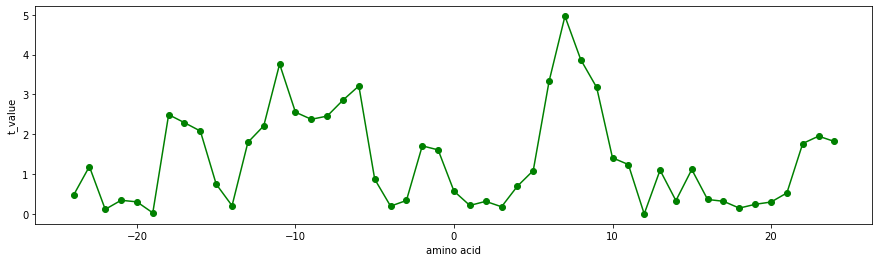

KARS160105
Average eccentricity (Karkbara-Knisley, 2016)


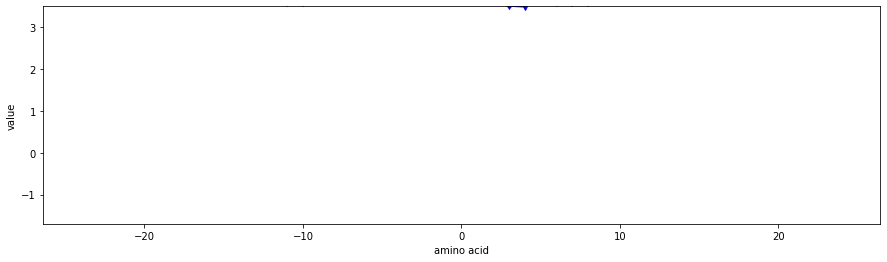

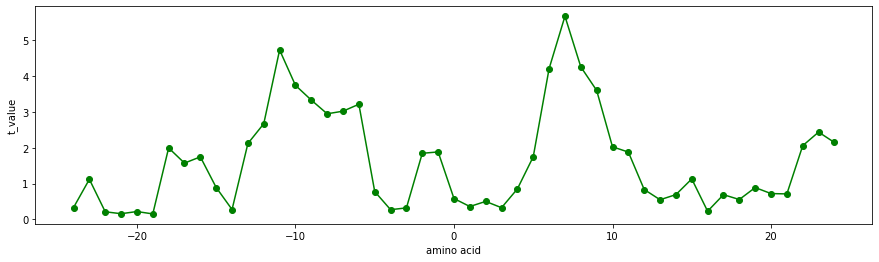

KARS160106
Radius (minimum eccentricity) (Karkbara-Knisley, 2016)


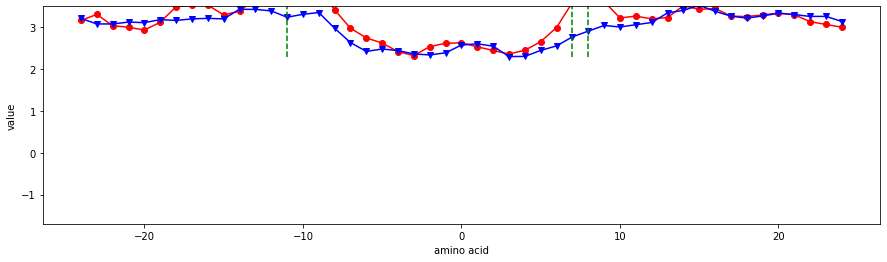

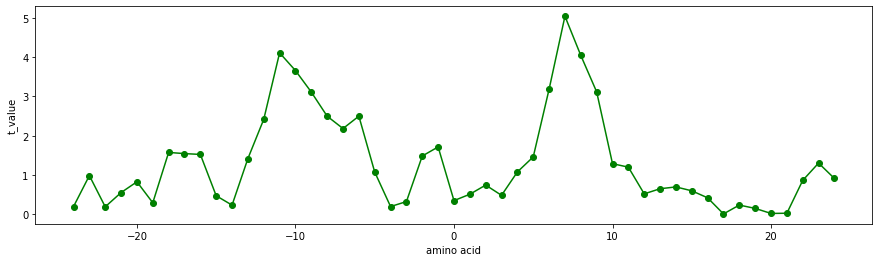

KARS160107
Diameter (maximum eccentricity) (Karkbara-Knisley, 2016)


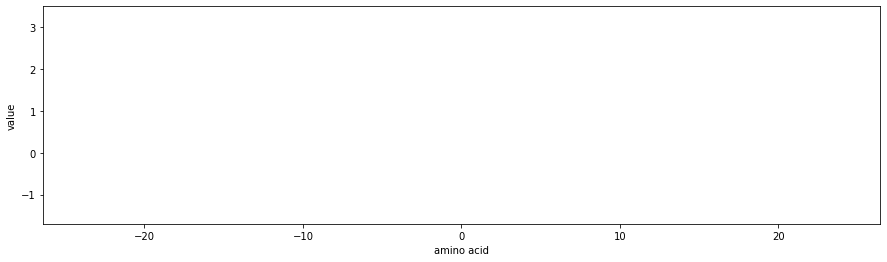

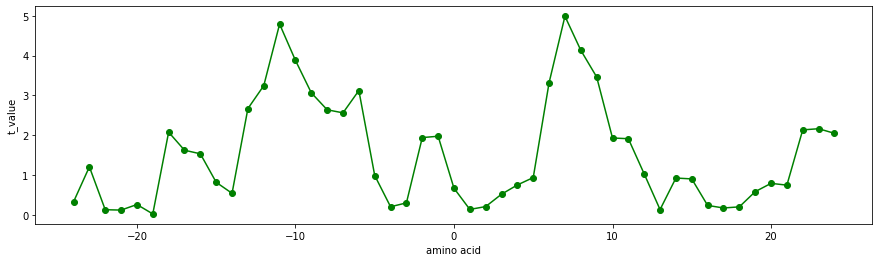

KARS160108
Average weighted degree (total degree, divided by the number of vertices)


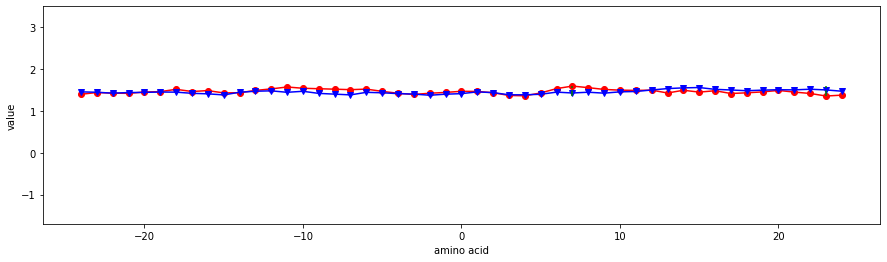

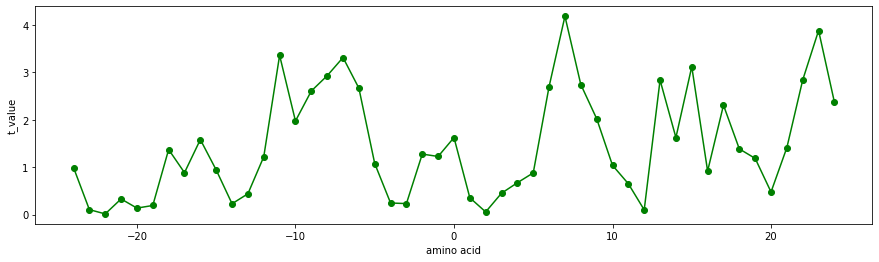

KARS160109
Maximum eigenvalue of the weighted Laplacian matrix of the graph


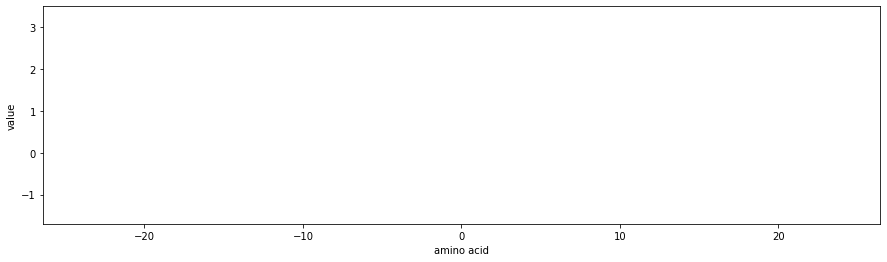

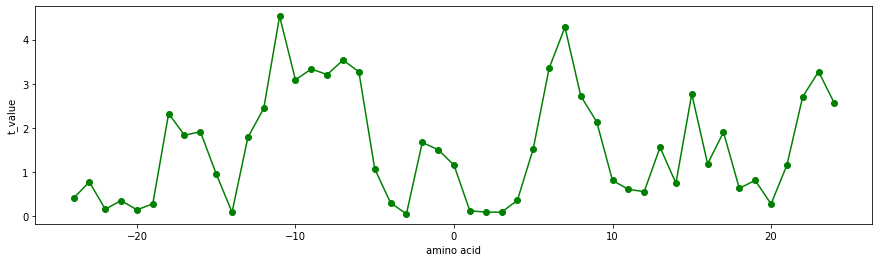

KARS160111
Average eigenvalue of the Laplacian matrix of the the graph


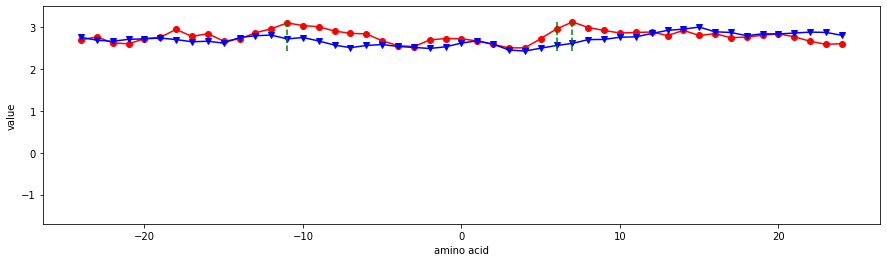

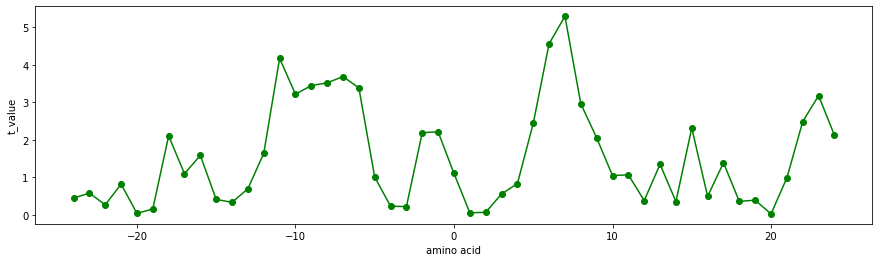

KARS160113
Weighted domination number using the atomic number (Karkbara-Knisley, 2016)


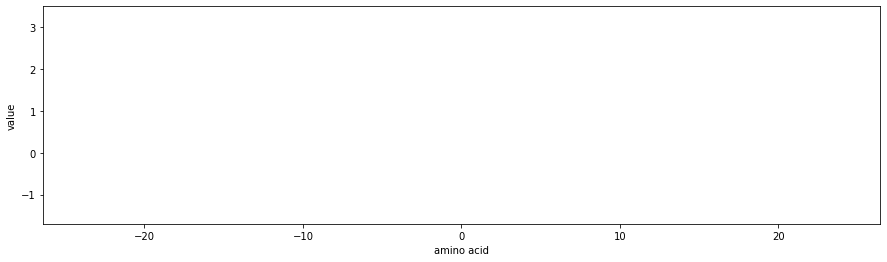

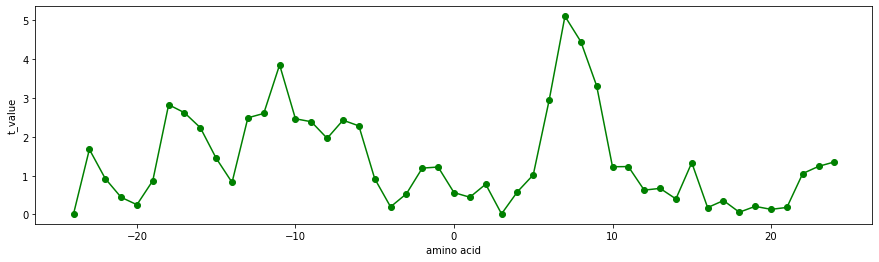

KARS160114
Average weighted eccentricity based on the the atomic number


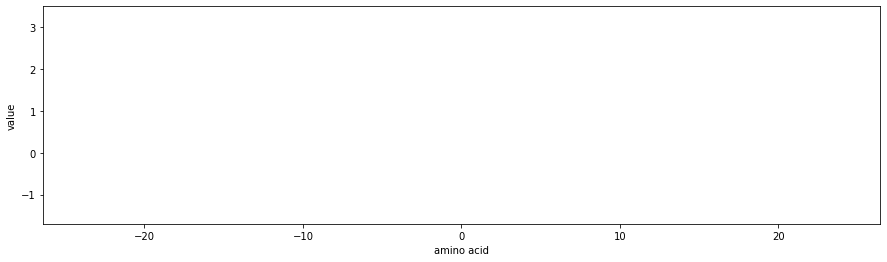

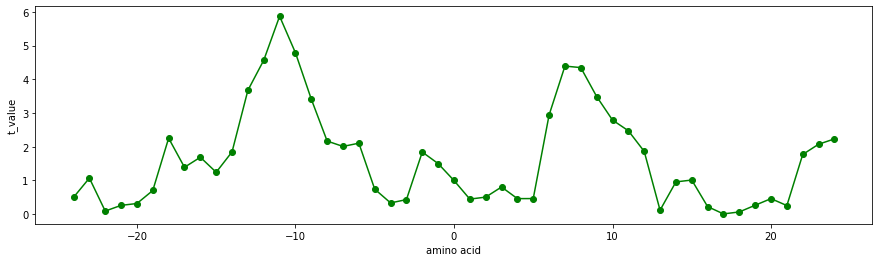

KARS160115
Weighted radius based on the atomic number (minimum eccentricity)


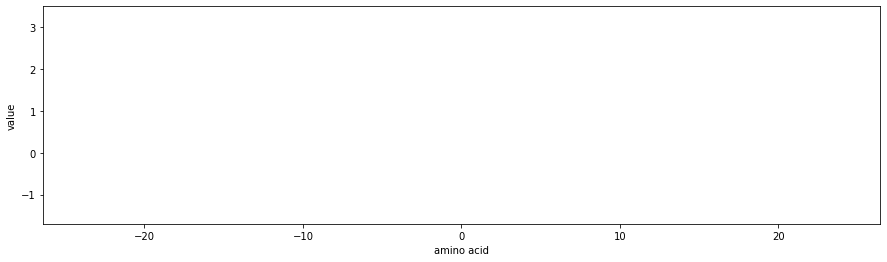

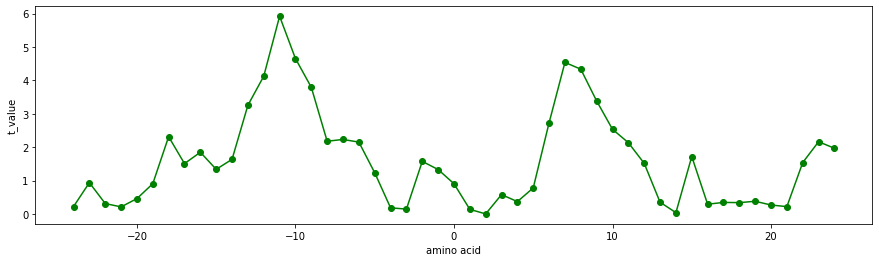

KARS160116
Weighted diameter based on the atomic number (maximum eccentricity)


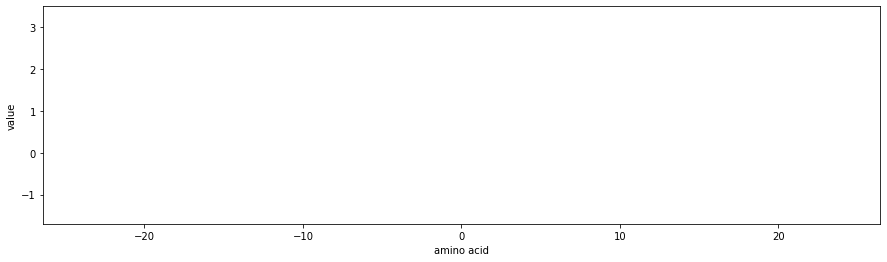

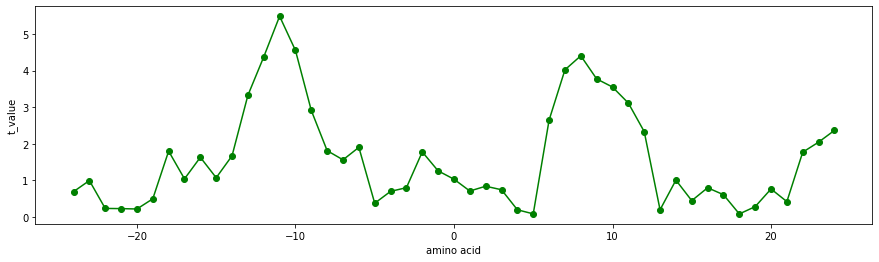

KARS160117
Total weighted atomic number of the graph (obtained by summing all the atomic


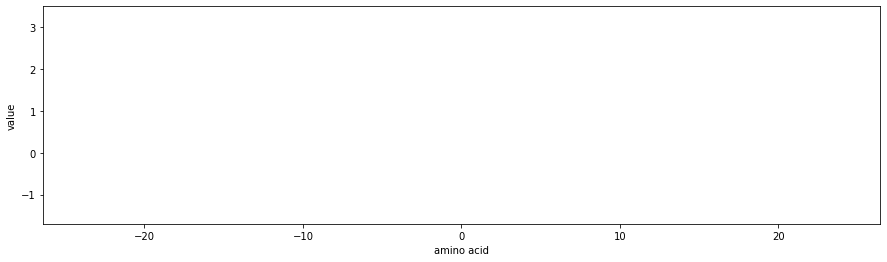

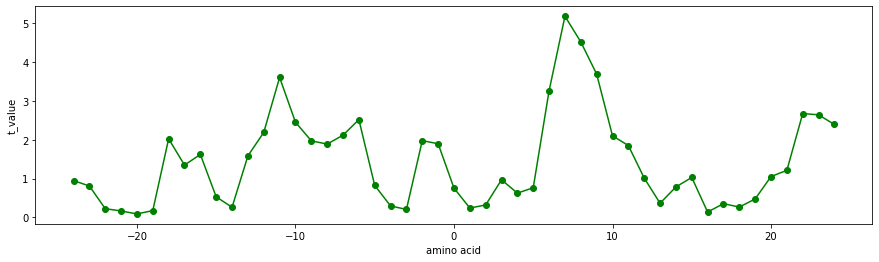

KARS160119
Weighted maximum eigenvalue based on the atomic numbers


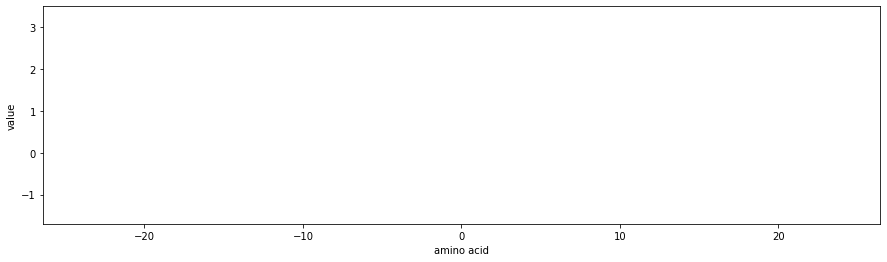

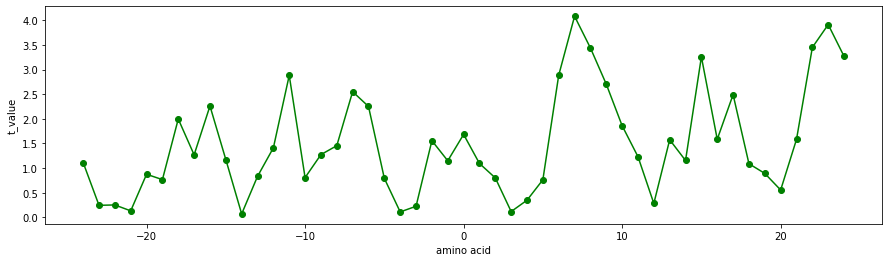

KARS160121
Weighted average eigenvalue based on the atomic numbers


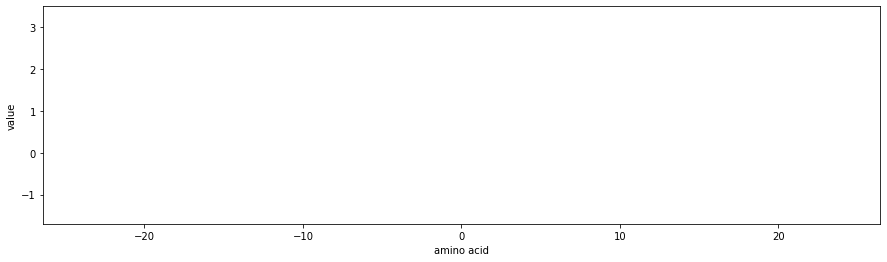

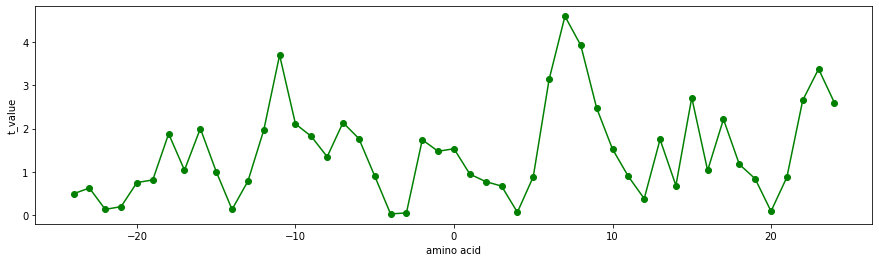

554


In [18]:
import matplotlib.pyplot as plt

i=0
frag=0
list=[]

for index_pm, row_pm in pmave.iterrows():
    for index_npm, row_npm in npmave.iterrows():
        if index_pm==index_npm:
            j=0
            while j<49:
                if ALLtvalue[i][j]=="null":
                    fragnul=0
                elif ALLtvalue[i][j]>t_boader_list[j]:
                    list.append(j-24)
                    frag=1
                j=j+1
                
            if frag==1:
                frag=0
                print (index_pm)
                print (title_array[i])
                plt.figure(figsize=(15,4))
                plt.ylim(-1.7, 3.5)
                plt.plot(columns , row_pm  , color = 'red'  , marker = 'o' )
                plt.plot(columns , row_npm , color = 'blue' , marker = 'v' )
                if len(list)!=0:
                    k=0
                    max_y=max(max(row_pm),max(row_npm))
                    min_y=min(min(row_pm),min(row_npm))
                    while k<len(list):
                        plt.plot([list[k], list[k]],[min_y, max_y], "green", linestyle='dashed')
                        k=k+1
                plt.xlabel('amino acid')                    
                plt.ylabel('value')
                plt.show()
#                 print (list)
#                 print ("\n")
                list=[]
                
#                 plt.figure(figsize=(15,4))
#                 plt.plot(columns , deference_array[i+1]  , color = 'green'  , marker = 'o' )                
#                 plt.xlabel('amino acid')                    
#                 plt.ylabel('deference')
#                 plt.show()
    
                plt.figure(figsize=(15,4))
                plt.plot(columns , ALLtvalue[i]  , color = 'green'  , marker = 'o' )                
                plt.xlabel('amino acid')                    
                plt.ylabel('t_value')
                plt.show()
                
                
                
            i=i+1
            
print (i)